# CRISP-DM Data LHKPN

## 1. Import Dependency

In [1]:
from tqdm import tqdm
import copy
import json
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
import scipy.stats as stats
from mpl_toolkits.mplot3d import Axes3D
from itertools import combinations
from scipy.stats import gaussian_kde

from sklearn.metrics import (
    confusion_matrix,
    roc_curve,
    auc,
    roc_auc_score,
    accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    precision_recall_curve,
    average_precision_score,
)

In [2]:
!pip install sdv

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.1/137.1 kB 2.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 14.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.9/11.9 MB 62.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.6/54.6 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.8/74.8 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 170.7/170.7 kB 20.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 60.8 MB/s eta 0:00:00


In [3]:
from sdv.metadata import SingleTableMetadata
from sdv.single_table import GaussianCopulaSynthesizer
from sdv.evaluation.single_table import run_diagnostic, evaluate_quality
from sdv.evaluation.single_table import get_column_plot
from sdv.evaluation.single_table import get_column_pair_plot

In [4]:
from __future__ import division
from __future__ import print_function

from numpy import percentile
from scipy import stats
import matplotlib.font_manager
from sklearn.ensemble import IsolationForest

!pip install pyod
!pip install --upgrade pyod

# Import semua model pyOD
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.mad import MAD
from pyod.models.hbos import HBOS
from pyod.models.pca import PCA
from pyod.models.kde import KDE
from pyod.models.vae import VAE


# Import fungsi-fungsi yang berguna (seperti generating data, visualization, dll)
from pyod.utils.data import generate_data, generate_data_clusters, generate_data_categorical, get_outliers_inliers
from pyod.utils.data import evaluate_print
from pyod.utils.example import visualize

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 160.5/160.5 kB 3.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyod: filename=pyod-1.1.2-py3-none-any.whl size=190292 sha256=728946de4004164563006baf2b91de67d816259a293b3b994582f198bb2c8ec9
  Stored in directory: /root/.cache/pip/wheels/81/1b/61/aa85b78c3c0c8871f4231e3f4a03bb23cecb7db829498380ee
Successfully built pyod


## Utility Function

### Visualize Data

In [5]:
def visualize_data_1d(dataframe, types = 'kde_scatter', feature = None, outlier_column = 'is_outlier', shuffle=False, bins = 20, density=False, no_legend = False, title = "Scatter Plot with Outliers Highlighted"):

  dataframe = dataframe.sample(frac=1).reset_index(drop=True) if shuffle else dataframe
  feature_in = feature if feature is not None else 'feature_0'

  # Create separate DataFrames for outliers and non-outliers
  outliers = dataframe[dataframe[outlier_column] == 1]
  non_outliers = dataframe[dataframe[outlier_column] == 0]

  if types == 'index':
    # Scatter plot for non-outliers (black)
    plt.scatter(non_outliers.index, non_outliers[feature_in], c='black', label='Inlier')
    # Scatter plot for outliers (red)
    plt.scatter(outliers.index, outliers[feature_in], c='red', label='Outliers')

    # Add labels and title
    plt.xlabel('Index')
    plt.ylabel(feature_in)

  elif types == 'diagonal':
    # Scatter plot for non-outliers (black)
    plt.scatter(non_outliers[feature_in], non_outliers[feature_in], c='black', label='Inlier')
    # Scatter plot for outliers (red)
    plt.scatter(outliers[feature_in], outliers[feature_in], c='red', label='Outliers')

    # Add labels and title
    plt.xlabel(feature_in)
    plt.ylabel(feature_in)

  elif types == 'horizontal':
    # Scatter plot for non-outliers (black)
    plt.scatter(non_outliers[feature_in], [0] * len(non_outliers), c='black', label='Inlier')
    # Scatter plot for outliers (red)
    plt.scatter(outliers[feature_in], [0] * len(outliers), c='red', label='Outliers')

    # Add labels and title
    plt.xlabel(feature_in)
    plt.ylabel(feature_in)

  elif types == 'boxplot':
    plt.boxplot(dataframe[feature_in], vert=False,)

    # Add labels and title
    plt.xlabel('Category')
    plt.ylabel(feature_in)

  elif types == 'histogram':
    # Create histograms for both categories
    plt.hist(dataframe[feature_in], bins=bins, alpha=0.5, color='black', label=feature_in)

    # Add labels and title
    plt.xlabel(feature_in)
    plt.ylabel('Frequency')

  elif types == 'kdeplot':
    sns.kdeplot(dataframe[feature_in], label=feature_in, fill=True, color='black')

    # Add labels and title
    plt.xlabel(feature_in)
    plt.ylabel('Density')

  elif types == 'kde_scatter':
    # Create a figure with subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, gridspec_kw={'height_ratios': [1.5, 1]})

    # Create a KDE plot for inliers and outliers above
    sns.kdeplot(dataframe[feature_in], label='data points', fill=True, color='black', ax=ax1)
    # Create a scatter plot for inliers and outliers below
    ax2.scatter(non_outliers[feature_in], [0] * len(non_outliers), c='black', label='Inliers')
    ax2.scatter(outliers[feature_in], [0] * len(outliers), c='red', label='Outliers')

    # Add labels and title for the scatter plot
    ax2.set_xlabel(feature_in)
    ax2.set_ylabel('')

    # Add labels and title for the KDE plot
    ax1.set_ylabel('Density')
    ax1.set_title(title)

    # Show legend for the KDE plot
    ax1.legend()

    # Show legend for the scatter plot
    if not no_legend:
      ax2.legend(loc='best', fontsize='small')

    # Adjust spacing between subplots
    plt.tight_layout()

  elif types == 'histogram_scatter':
    # Create a figure with subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True, gridspec_kw={'height_ratios': [1.5, 1]})

    # Create a histogram for inliers and outliers above
    ax1.hist(dataframe[feature_in], bins=bins, density=density, color='black', label='Data Points', alpha=0.7)

    # Create a scatter plot for inliers and outliers below
    if no_legend:
      ax2.scatter(non_outliers[feature_in], [0] * len(non_outliers), c='black')
      ax2.scatter(outliers[feature_in], [0] * len(outliers))
    else:
      ax2.scatter(non_outliers[feature_in], [0] * len(non_outliers), c='black', label='Inliers')
      ax2.scatter(outliers[feature_in], [0] * len(outliers), c='red', label='Outliers')

    # Add labels and title for the scatter plot
    ax2.set_xlabel(feature_in)
    ax2.set_ylabel('')

    # Add labels and title for the histogram plot
    ax1.set_ylabel('Frequency')
    ax1.set_title(title)

    # Show legend for the histogram plot
    ax1.legend()

    # Show legend for the scatter plot
    if no_legend == False:
      ax2.legend(loc='best', fontsize='small')

    # Adjust spacing between subplots
    plt.tight_layout()

  else:
    raise ValueError("types must be in one of the following ['index', 'diagonal', 'horizontal', 'boxplot', 'histogram', 'kdeplot', 'kde_scatter', 'histogram_scatter']")

  if types not in ['kde_scatter', 'histogram_scatter']: plt.title(title)

  # Show legend
  if (types not in ['boxplot', 'kdeplot', 'kde_scatter']): plt.legend()

  # Show the plot
  plt.show()



def visualize_data_2d(dataframe, feature = ['feature_0', 'feature_1'], outlier_column = 'is_outlier', shuffle=False, interactive = False, no_legend = False, hover= 'is_outlier', title="Scatter Plot with Outliers Highlighted"):
    dataframe = dataframe.sample(frac=1).reset_index(drop=True) if shuffle else dataframe

    # Separate DataFrames for outliers and non-outliers
    outliers = dataframe[dataframe[outlier_column] == 1]
    non_outliers = dataframe[dataframe[outlier_column] == 0]

    # Extract the feature columns (assuming you have columns 'feature_x' and 'feature_y')
    feature_x = feature[0]
    feature_y = feature[1]

    if interactive:
      # Create an interactive 2D scatter plot using Plotly
      fig = px.scatter(dataframe, x=feature_x, y=feature_y, color=dataframe[outlier_column].astype(str),
                       color_discrete_sequence=["black", "red"],
                       hover_data=[hover] + [feature_x, feature_y, outlier_column])
      fig.update_layout(title=title)
      fig.update_traces(marker=dict(size=5))
      fig.show()

    else:
      # Scatter plot for non-outliers (black)
      plt.scatter(non_outliers[feature_x], non_outliers[feature_y], c='black', label='Inliers')
      # Scatter plot for outliers (red)
      plt.scatter(outliers[feature_x], outliers[feature_y], c='red', label='Outliers')

      # Add labels and title
      plt.xlabel(feature_x)
      plt.ylabel(feature_y)
      plt.title(title)

      # Show legend
      if not no_legend:
        plt.legend()

      # Show the plot
      plt.show()


def visualize_data_3d(dataframe, feature=['feature_0', 'feature_1', 'feature_2'], outlier_column = 'is_outlier', shuffle=False, no_legend = False, title="3D Scatter Plot with Outliers Highlighted", interactive=True, hover = 'is_outlier', viewing_angle = [30, 30]):
    dataframe = dataframe.sample(frac=1).reset_index(drop=True) if shuffle else dataframe

    # Separate DataFrames for outliers and non-outliers
    outliers = dataframe[dataframe[outlier_column] == 1]
    non_outliers = dataframe[dataframe[outlier_column] == 0]

    # Extract the feature columns (assuming you have columns 'feature_x', 'feature_y', and 'feature_z')
    feature_x = feature[0]
    feature_y = feature[1]
    feature_z = feature[2]

    if interactive:
        # Create an interactive 3D scatter plot using Plotly
        fig = px.scatter_3d(dataframe, x=feature_x, y=feature_y, z=feature_z, color=dataframe[outlier_column].astype(str), color_discrete_sequence=["black", "red"],
                            hover_data=[hover] + [feature_x, feature_y, feature_y, outlier_column])
        fig.update_layout(title=title)
        fig.update_traces(marker=dict(size=5))
        fig.show()
    else:
        # Create a static 3D scatter plot
        fig = plt.figure(figsize=(8, 6))
        ax = fig.add_subplot(111, projection='3d')

        # Scatter plot for non-outliers (black)
        ax.scatter(non_outliers[feature_x], non_outliers[feature_y], non_outliers[feature_z], c='black', label='Inliers')
        # Scatter plot for outliers (red)
        ax.scatter(outliers[feature_x], outliers[feature_y], outliers[feature_z], c='red', label='Outliers')

        # Add labels and title
        ax.set_xlabel(feature_x)
        ax.set_ylabel(feature_y)
        ax.set_zlabel(feature_z)
        ax.set_title(title)

        # Show legend
        if not no_legend:
          ax.legend()

        # Set the viewing angle (elevation and azimuth)
        ax.view_init(elev=viewing_angle[0], azim=viewing_angle[1])

        # Show the plot
        plt.show()

### Creating Outliers

In [6]:
def add_outliers_to_dataframe(dataframe, real_dataframe, num_outliers):
    """
    Add synthetic integer outliers to a DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the original data.
    - num_outliers: Number of synthetic outliers to add for each column.

    Returns:
    - Modified DataFrame with synthetic integer outliers and an 'is_outlier' column.
    """
    # Determine the column names in the original DataFrame
    column_names = dataframe.columns

    # Create a copy of the original DataFrame
    df_with_outliers = dataframe.copy()

    # Create a DataFrame to store the synthetic outliers
    outliers_df = pd.DataFrame()

    for col_name in column_names:
        # Generate synthetic outliers with a uniform distribution as integers
        outliers = np.random.randint(
            low=real_dataframe[col_name].min(),
            high=real_dataframe[col_name].max(),
            size=num_outliers
        )

        # Append the synthetic outliers to the outliers DataFrame
        outliers_df[col_name] = outliers

    # Add an 'is_outlier' column with 0 for non-outliers and 1 for outliers
    outliers_df['is_outlier'] = 1

    # Concatenate the original DataFrame and the outliers DataFrame
    df_with_outliers = pd.concat([df_with_outliers, outliers_df], ignore_index=True)

    # Fill NaN values in the 'is_outlier' column with 0 for non-outliers
    df_with_outliers['is_outlier'].fillna(0, inplace=True)

    return df_with_outliers

### Helpful Function

#### Numerical Features Function

In [7]:
def get_numerical_feature_pairs(numerical_features):

    # Generate all unique pairs of numerical feature names
    pairs = list(combinations(numerical_features, 2))

    return pairs

def get_numerical_feature_pairs_3d(numerical_features):

    # Generate all unique pairs of numerical feature names
    pairs = list(combinations(numerical_features, 3))

    return pairs

#### KS Test and Gaussian KDE Plot

In [8]:
def kstest_with_gaussian_kde(dataframe, column_name):
    # Extract the column data from the dataframe
    column_data = dataframe[column_name].values

    # Fit a Gaussian KDE to the data
    kde = gaussian_kde(column_data)

    # Generate random samples from the KDE
    samples = kde.resample(len(column_data), 40)[0]
    #print(column_data, samples)

    # Perform a K-S test between the original data and the generated samples
    ks_statistic, ks_p_value = stats.kstest(column_data, samples)

    return ks_statistic, ks_p_value

def KS_test(df, distribution_list):
  list_fit = []
  for column in df.columns:
      print(column)

      data = df[column]

      # Fit different distributions
      best_fit_name, best_fit_params, best_fit_error = None, None, float('-inf')

      p_value_list = []
      for distribution in distribution_list:
          if distribution != 'gaussian_kde':
            try:
              # Fit the distribution to the data
              params = distribution.fit(data, method="mle")

              # Calculate the Kolmogorov-Smirnov test statistic for goodness of fit
              _, p_value = stats.kstest(data, distribution.cdf, params, method = 'exact')
              fit_error = p_value #np.abs(p_value - 0.5)  # Measure of how well the distribution fits (closer to 0.5 is better)
              print(f'COLUMN: {column} P_VALUE: {distribution.name}, {p_value}')
              p_value_list.append([distribution.name, p_value])

              # Update if this distribution is the best fit so far
              if fit_error > best_fit_error:
                  best_fit_name, best_fit_params, best_fit_error = distribution.name, params, fit_error
            except:
              pass
          else:
            _, p_value = kstest_with_gaussian_kde(df, column)
            fit_error = p_value #np.abs(p_value - 0.5)  # Measure of how well the distribution fits (closer to 0.5 is better)
            print(f'COLUMN: {column} P_VALUE: gaussian_kde, {p_value}')
            p_value_list.append([distribution, p_value])
            if fit_error > best_fit_error:
                best_fit_name, best_fit_params, best_fit_error = 'gaussian_kde', 'params', 'fit_error'

      # Print the best-fit distribution for the column
      print(f"Best fit for {column}: {best_fit_name} with parameters {best_fit_params}")
      list_fit.append([column, best_fit_name, best_fit_params])
  return list_fit

def plot_pdf_with_kde(dataframe, column_name, figsize=(10, 6)):
    data = dataframe[column_name]

    # Create a plot with specified figsize
    plt.figure(figsize=figsize)

    # Plot a histogram with Kernel Density Estimation (KDE)
    sns.histplot(data, kde=True, bins=100, color='green', label='KDE')

    plt.xlabel(column_name)
    plt.ylabel('Probability Density')
    plt.legend()
    plt.title('Probability Density Function (PDF) with KDE')
    plt.show()

def visualize_best_fit_distributions(dataframe, distribution_info_list, figsize=(10, 6)):
    """
    Visualize the best-fit distribution for each column in a dataframe.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - distribution_info_list: List of tuples with column names, best-fit distribution names, and parameters.
    - figsize: Tuple specifying the size of the figure (width, height).
    """
    for column, best_fit_name, best_fit_params in distribution_info_list:
        print(column)
        data = dataframe[column]
        best_fit_distribution = getattr(stats, best_fit_name)

        # Create a plot with specified figsize
        plt.figure(figsize=figsize)

        # Calculate the PDF of the best-fit distribution
        if best_fit_name != 'gaussian_kde':
            # Create a histogram of the data
            sns.histplot(data, bins=100, color='g', label='Data')

            # Generate x values for the PDF plot
            x = np.linspace(data.min(), data.max(), 100)
            print(best_fit_params)
            pdf = best_fit_distribution.pdf(x, *best_fit_params)

            # Plot the PDF of the best-fit distribution
            plt.plot(x, pdf, 'r-', linewidth=2, label='Best Fit')

            plt.title(f'{column} - Best Fit Distribution ({best_fit_name})')
            plt.legend()
            plt.xlabel('Values')
            plt.ylabel('Probability Density')
            plt.show()
        else:
            plot_pdf_with_kde(dataframe, column, figsize=figsize)


#### Set Seeds

In [9]:
np.random.seed(2023)

## Data Understanding

In [10]:
df_lhkpn = pd.read_csv("/content/dataset_lhkpn_2022.csv")
df_lhkpn

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,-,9631220000
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,-,645000000,-,4559120000,-,4559120000
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,-,260000000,-,14725723072,-,23283464072,-,23283464072
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,-,203513890532,10352000000,193161890532
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,-,22530000000,870000000,21660000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,-,260000000,765000000,152736175,-,12177736175,1926577662,10251158513
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,-,-,461773291,-,6415273291,3664800952,2750472339
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,-,1851590750,-,13532845250,1000000000,12532845250
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,-,4509180256,-,4509180256


In [11]:
df_lhkpn.describe(include='all')

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan
count,150,150,150.0,150,150,150,150,150,150.000000,150,150,150,150,1.500000e+02,150,1.500000e+02,150,1.500000e+02
unique,63,3,NaN,2,18,84,149,70,NaN,144,128,122,52,NaN,47,NaN,73,NaN
top,31 Maret 2023,Periodik,NaN,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,SEKRETARIAT JENDERAL,IWAN KURNIAWAN,DIREKTUR JENDERAL,NaN,3000000000,-,-,-,NaN,-,NaN,-,NaN
freq,10,140,NaN,149,15,21,2,37,NaN,4,16,24,96,NaN,104,NaN,76,NaN
mean,NaN,NaN,2022.0,NaN,NaN,NaN,NaN,NaN,382298.653333,NaN,NaN,NaN,NaN,3.914972e+09,NaN,6.963416e+10,NaN,6.370076e+10
std,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,280310.191925,NaN,NaN,NaN,NaN,7.829969e+09,NaN,4.898658e+11,NaN,4.296069e+11
min,NaN,NaN,2022.0,NaN,NaN,NaN,NaN,NaN,474.000000,NaN,NaN,NaN,NaN,3.313045e+06,NaN,5.323130e+08,NaN,3.605416e+08
25%,NaN,NaN,2022.0,NaN,NaN,NaN,NaN,NaN,143183.500000,NaN,NaN,NaN,NaN,5.413753e+08,NaN,4.521665e+09,NaN,3.961641e+09
50%,NaN,NaN,2022.0,NaN,NaN,NaN,NaN,NaN,278230.500000,NaN,NaN,NaN,NaN,1.338641e+09,NaN,7.604151e+09,NaN,7.450741e+09
75%,NaN,NaN,2022.0,NaN,NaN,NaN,NaN,NaN,634725.250000,NaN,NaN,NaN,NaN,3.795542e+09,NaN,1.656616e+10,NaN,1.649116e+10


### Dealing with Missing Values
- Ubah menjadi nol (*0*)

In [12]:
# Count missing values ('-') in each feature
missing_counts = df_lhkpn.apply(lambda x: (x == '-').sum())

# Print the missing value counts for each feature
print(missing_counts)

tanggal_penyampaian                    0
jenis_laporan                          0
tahun_laporan                          0
bidang                                 0
lembaga                                0
unit_kerja                             0
nama                                   0
jabatan                                0
nhk                                    0
harta_tanah_dan_bangunan               2
harta_alat_transportasi_dan_mesin     16
harta_bergerak_lainnya                24
surat_berharga                        96
harta_kas_dan_setara_kas               0
harta_lainnya                        104
sub_total                              0
hutang                                76
total_harta_kekayaan                   0
dtype: int64


In [13]:
df_replace_missing_value = df_lhkpn.replace('-', 0)
filtered_df = df_replace_missing_value[df_replace_missing_value['tahun_laporan'] == 2022]
clean_df = filtered_df
clean_df['tahun_laporan'] = clean_df['tahun_laporan'].apply(str)
clean_df['nhk'] = clean_df['nhk'].apply(str)
# Convert multiple columns to integer type at once
clean_df = clean_df.astype({"harta_tanah_dan_bangunan": int, "harta_alat_transportasi_dan_mesin": int, "harta_bergerak_lainnya": int, "surat_berharga": int, "harta_kas_dan_setara_kas": int, "harta_lainnya": int, "sub_total": int, "hutang": int}).reset_index(drop=True)

clean_df

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256


In [14]:
clean_df.describe(include="all")

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan
count,150,150,150,150,150,150,150,150,150,1.500000e+02,1.500000e+02,1.500000e+02,1.500000e+02,1.500000e+02,1.500000e+02,1.500000e+02,1.500000e+02,1.500000e+02
unique,63,3,1,2,18,84,149,70,150,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,SEKRETARIAT JENDERAL,IWAN KURNIAWAN,DIREKTUR JENDERAL,210766,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,10,140,150,149,15,21,2,37,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.231020e+10,5.298561e+08,6.545283e+08,5.164850e+10,3.914972e+09,5.761029e+08,6.963416e+10,5.933397e+09,6.370076e+10
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.975679e+10,8.174769e+08,1.707302e+09,4.762065e+11,7.829969e+09,3.762864e+09,4.898658e+11,6.453455e+10,4.296069e+11
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,3.313045e+06,0.000000e+00,5.323130e+08,0.000000e+00,3.605416e+08
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2.534296e+09,1.150000e+08,3.207500e+07,0.000000e+00,5.413753e+08,0.000000e+00,4.521665e+09,0.000000e+00,3.961641e+09
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.349848e+09,2.500000e+08,1.573000e+08,0.000000e+00,1.338641e+09,0.000000e+00,7.604151e+09,0.000000e+00,7.450741e+09
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.050652e+10,6.738750e+08,4.387490e+08,4.130040e+08,3.795542e+09,7.612500e+07,1.656616e+10,4.937500e+08,1.649116e+10


#### Some Interesting Observation
- tanggal_penyampaian:
- jenis_laporan
- tahun_laporan
- bidang
- lembaga
- unit_kerja
- nama
- jabatan
- harta_tanah_dan_bangunan
- harta_alat_transportasi_dan_mesin
- harta_bergerak_lainnya
- surat_berharga
- harta_kas_dan_setara_kas
- harta_lainnya
- sub_total: harta_tanah_dan_bangunan + harta_alat_transportasi_dan_mesin + harta_bergerak_lainnya + surat_berharga	+ harta_kas_dan_setara_kas + harta_lainnya
- hutang
- total_harta_kekayaan: sub_total + hutang

### Visualizing Data

#### Visualizing Every Feature (1D Data)

In [15]:
clean_df_1d_vis = copy.deepcopy(clean_df)
clean_df_1d_vis['zeroes'] = 0

cleans_df_col_list = list(clean_df_1d_vis.columns)
clean_df_col_list = cleans_df_col_list[9:-1]
remove_df_col_list = cleans_df_col_list[:9]

# Show only numerical features.
clean_df_col_list

['harta_tanah_dan_bangunan',
 'harta_alat_transportasi_dan_mesin',
 'harta_bergerak_lainnya',
 'surat_berharga',
 'harta_kas_dan_setara_kas',
 'harta_lainnya',
 'sub_total',
 'hutang',
 'total_harta_kekayaan']

harta_tanah_dan_bangunan


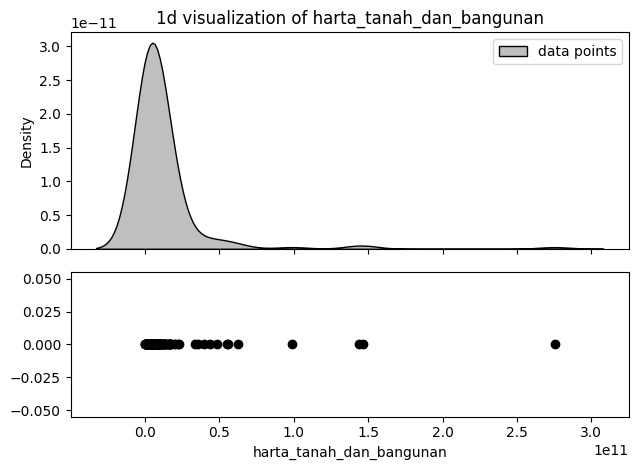

harta_alat_transportasi_dan_mesin


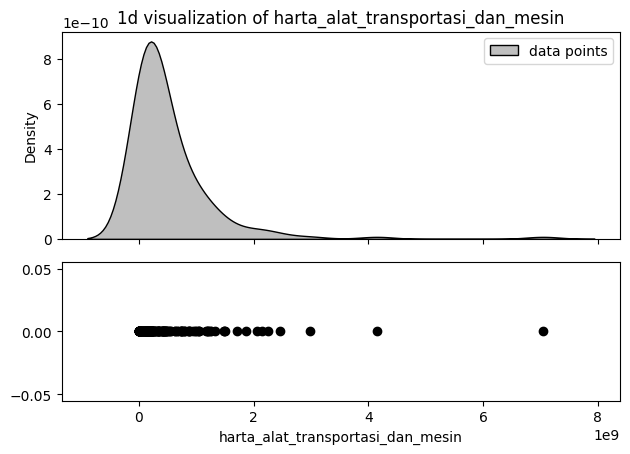

harta_bergerak_lainnya


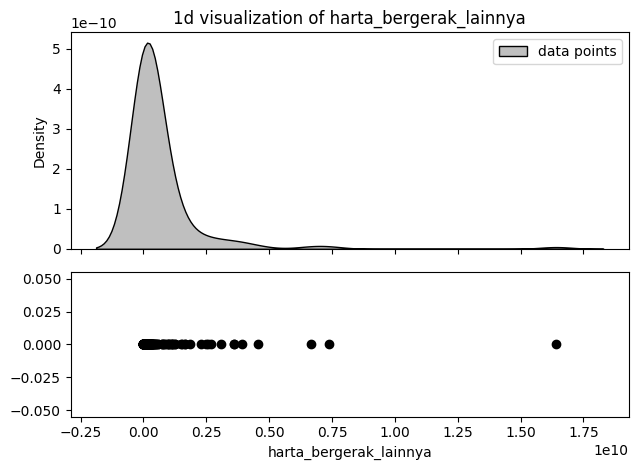

surat_berharga


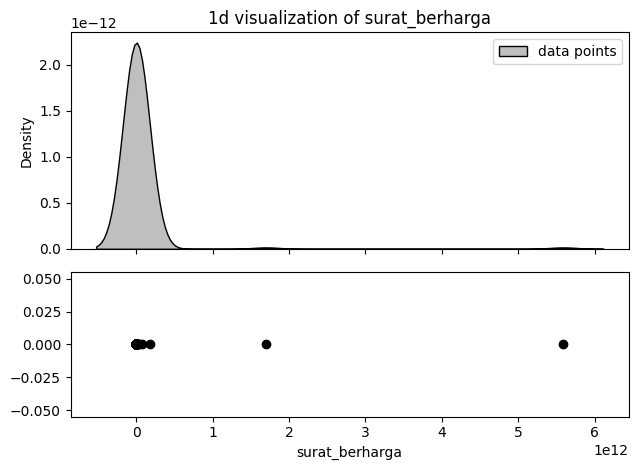

harta_kas_dan_setara_kas


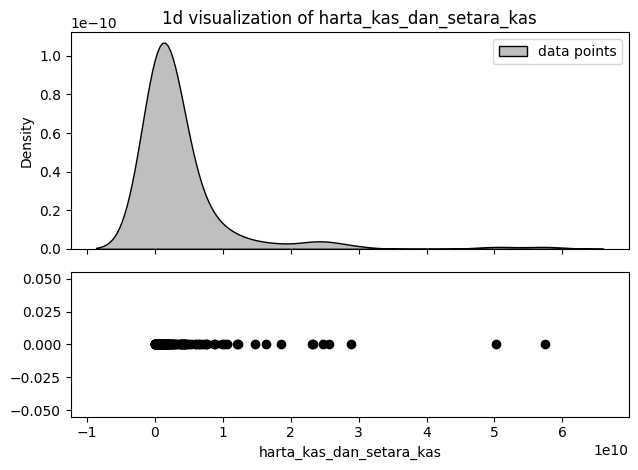

harta_lainnya


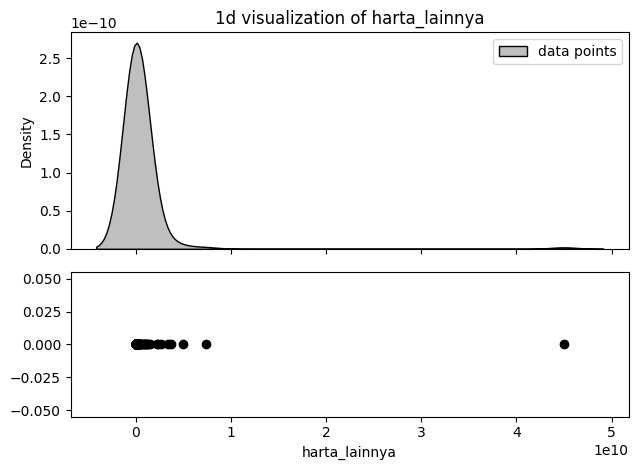

sub_total


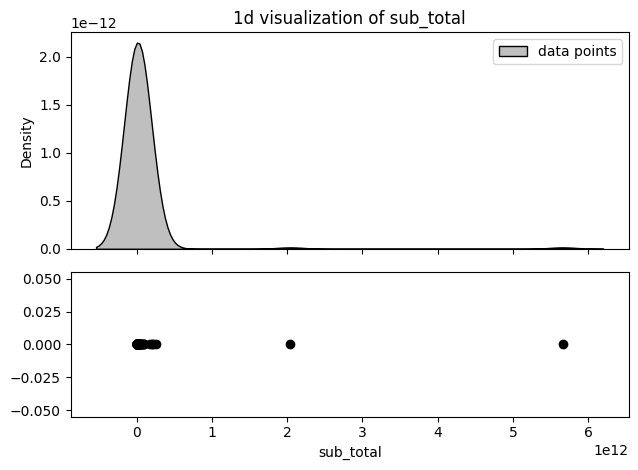

hutang


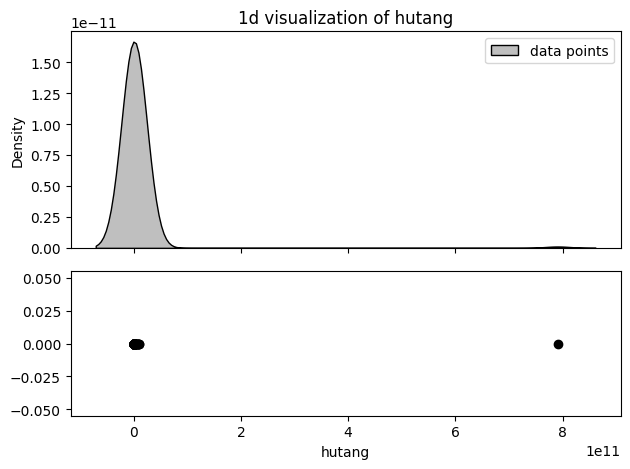

total_harta_kekayaan


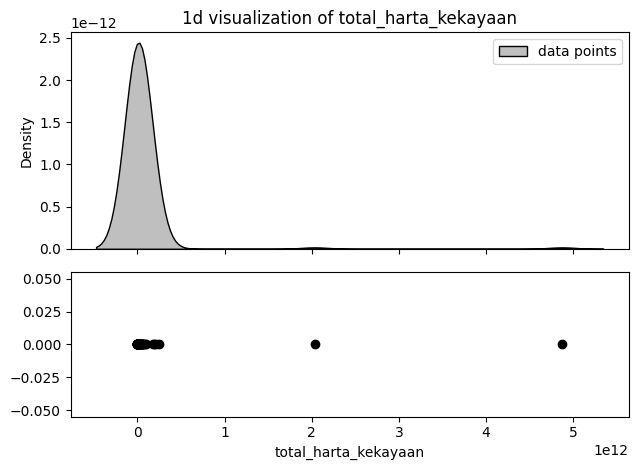

In [16]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(clean_df_1d_vis, feature=i, outlier_column= 'zeroes', no_legend=True, title = f"1d visualization of {i}")

harta_tanah_dan_bangunan


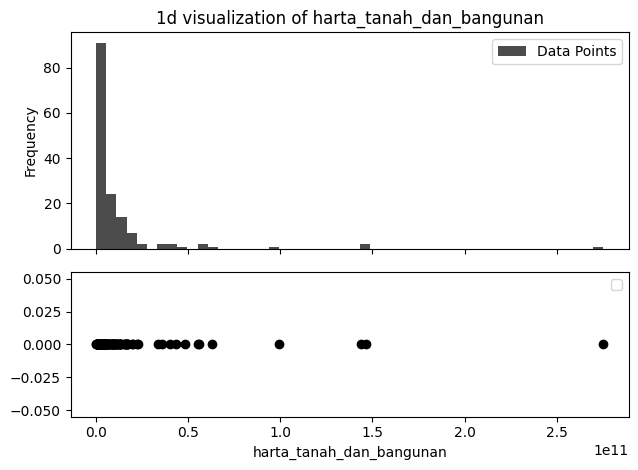

harta_alat_transportasi_dan_mesin


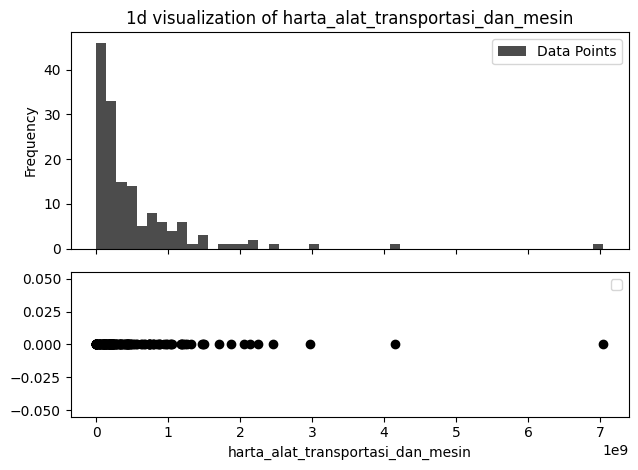

harta_bergerak_lainnya


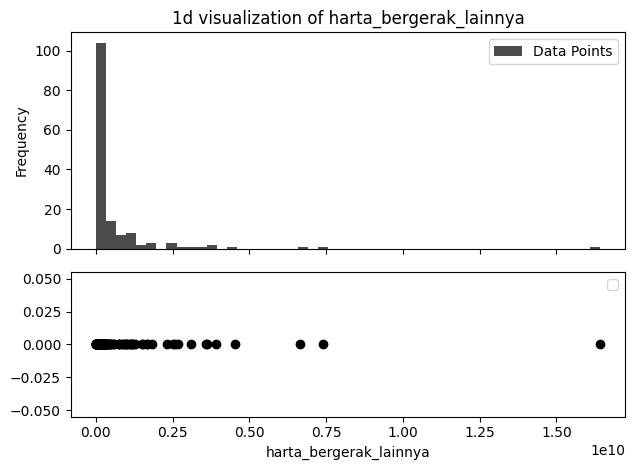

surat_berharga


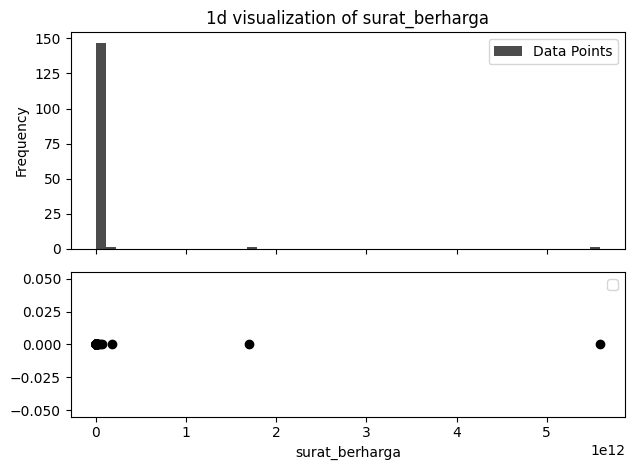

harta_kas_dan_setara_kas


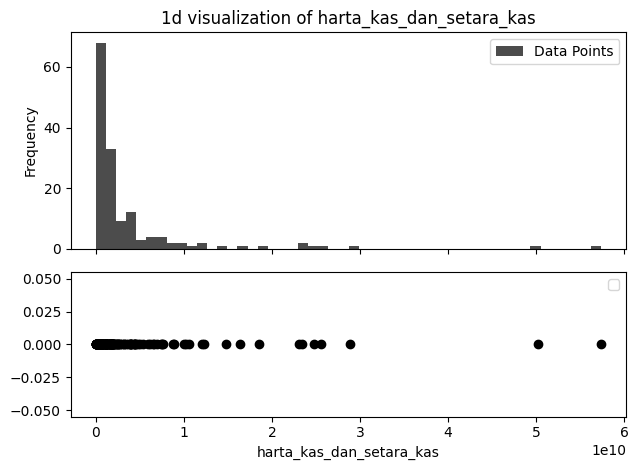

harta_lainnya


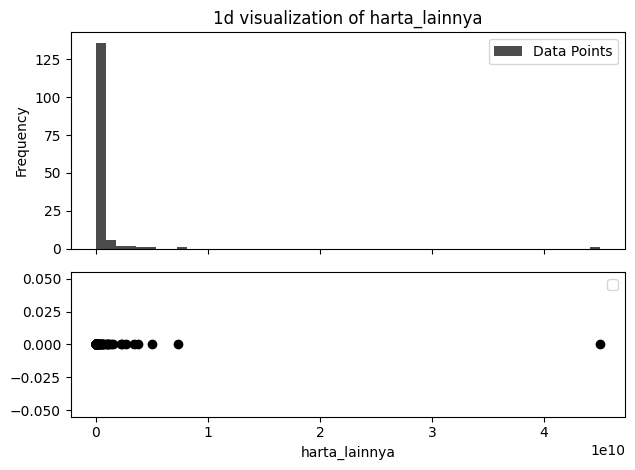

sub_total


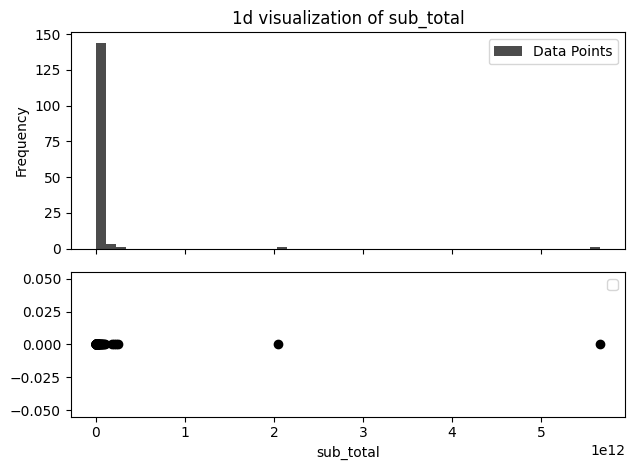

hutang


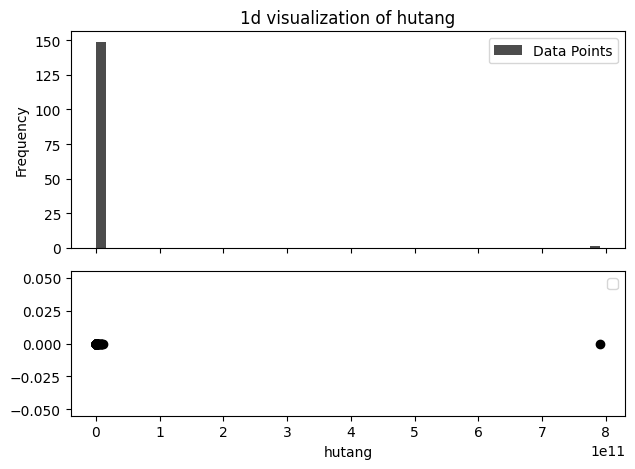

total_harta_kekayaan


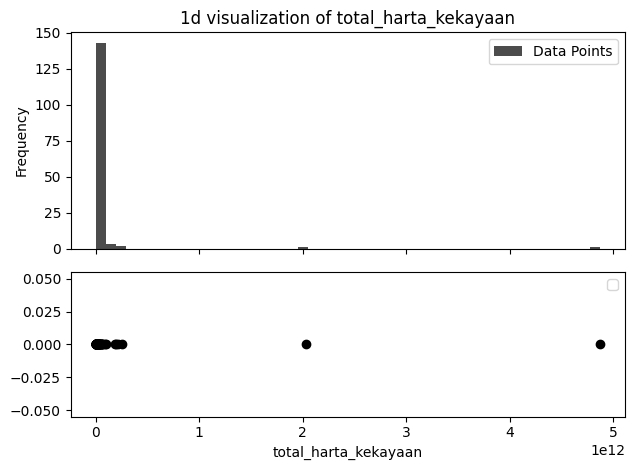

In [17]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(clean_df_1d_vis, types='histogram_scatter', bins= 50, feature=i, outlier_column= 'zeroes', no_legend=True, title = f"1d visualization of {i}")

#### Visualizing Every 2 Pair Features (2D Data)

In [18]:
clean_df_2d_vis = copy.deepcopy(clean_df)
copy_2d_df_numerical_column = list(clean_df_2d_vis.columns)
copy_2d_df_numerical_column = copy_2d_df_numerical_column[9:]

print("Column:")
print(copy_2d_df_numerical_column)
print(" ")

print(get_numerical_feature_pairs(copy_2d_df_numerical_column))
print(f'Count Pair: {len(get_numerical_feature_pairs(copy_2d_df_numerical_column))}')

Column:
['harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'surat_berharga', 'harta_kas_dan_setara_kas', 'harta_lainnya', 'sub_total', 'hutang', 'total_harta_kekayaan']
 
[('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin'), ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya'), ('harta_tanah_dan_bangunan', 'surat_berharga'), ('harta_tanah_dan_bangunan', 'harta_kas_dan_setara_kas'), ('harta_tanah_dan_bangunan', 'harta_lainnya'), ('harta_tanah_dan_bangunan', 'sub_total'), ('harta_tanah_dan_bangunan', 'hutang'), ('harta_tanah_dan_bangunan', 'total_harta_kekayaan'), ('harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya'), ('harta_alat_transportasi_dan_mesin', 'surat_berharga'), ('harta_alat_transportasi_dan_mesin', 'harta_kas_dan_setara_kas'), ('harta_alat_transportasi_dan_mesin', 'harta_lainnya'), ('harta_alat_transportasi_dan_mesin', 'sub_total'), ('harta_alat_transportasi_dan_mesin', 'hutang'), ('harta_alat_transportasi_da

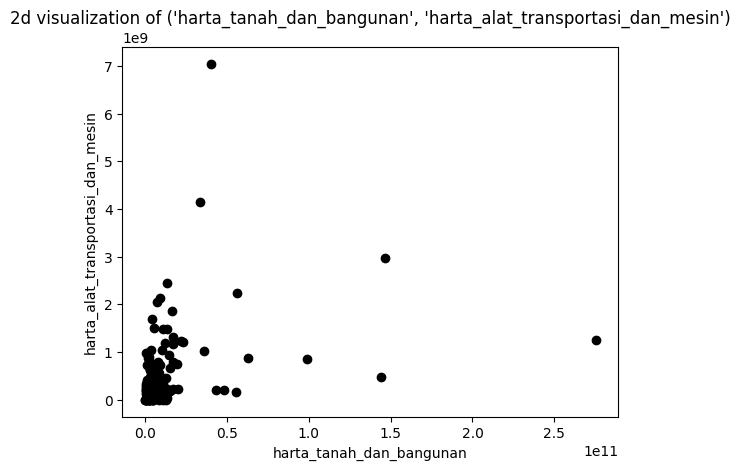

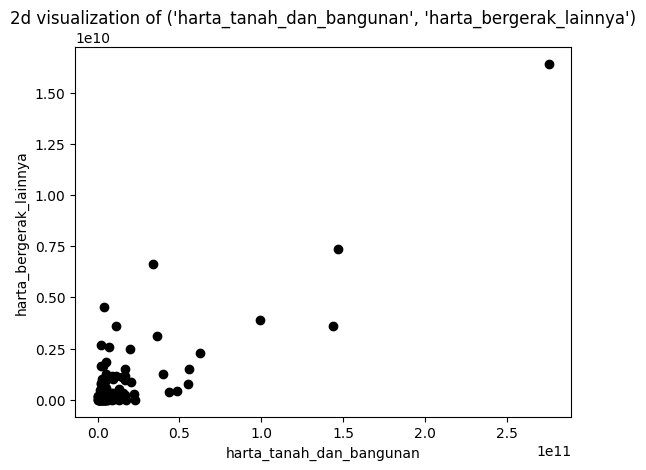

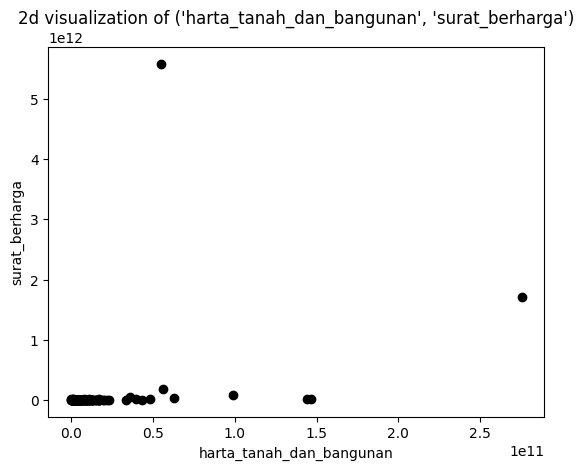

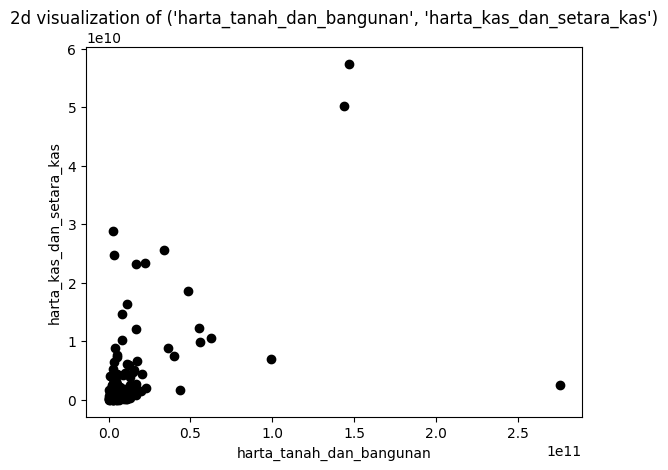

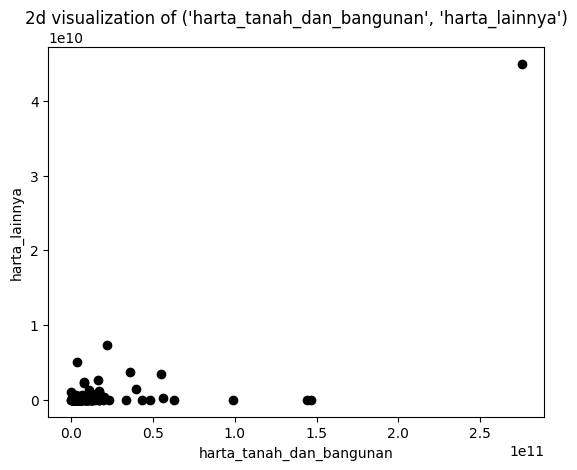

...

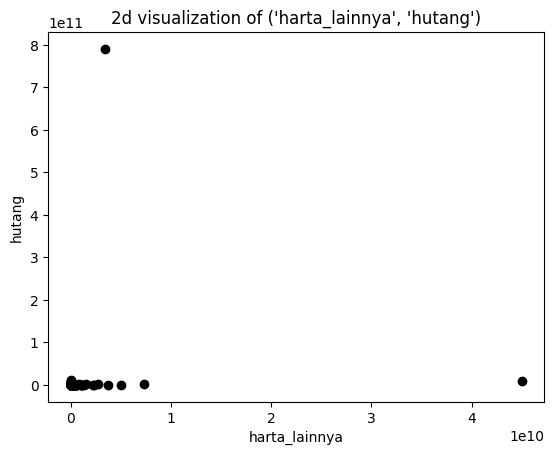

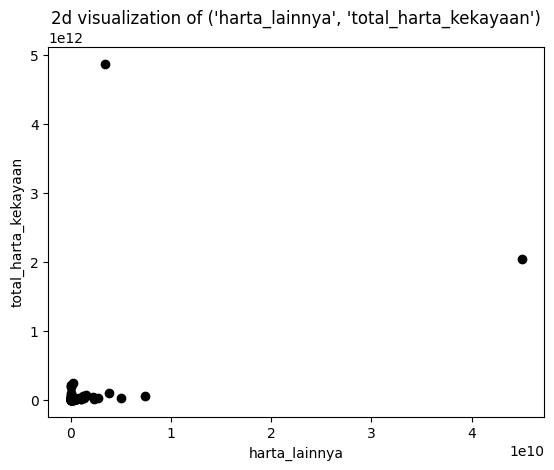

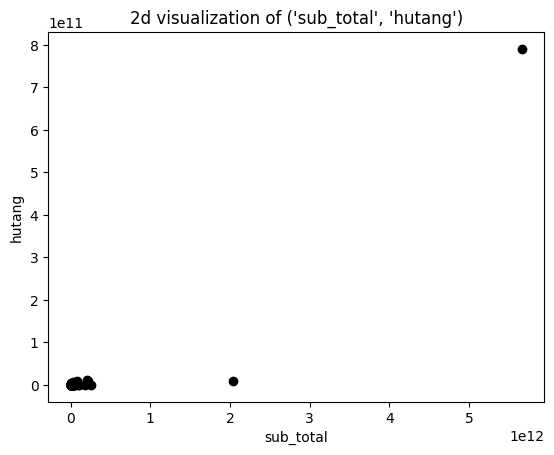

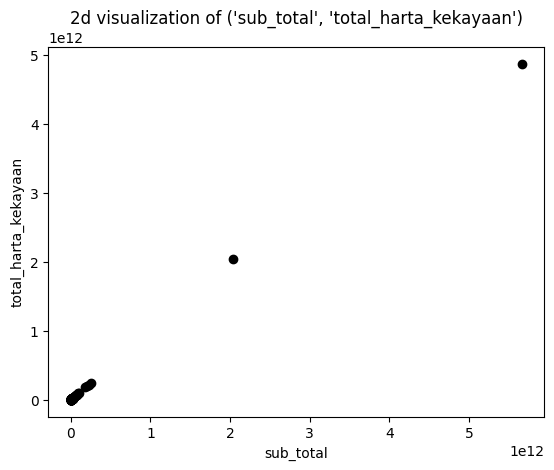

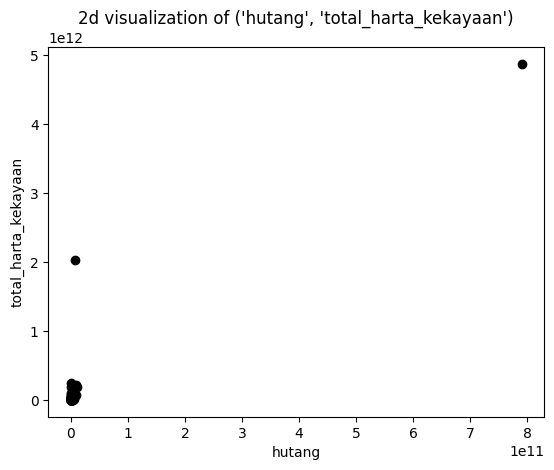

In [19]:
clean_df_2d_vis['zeroes'] = 0
pairing_2d = get_numerical_feature_pairs(copy_2d_df_numerical_column)
for i in pairing_2d:
  visualize_data_2d(clean_df_2d_vis, feature=i, outlier_column= 'zeroes', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### Visualizing Every 3 Features Combination (3D Data)

In [20]:
clean_df_3d_vis = copy.deepcopy(clean_df)
copy_3d_df_numerical_column = list(clean_df_3d_vis.columns)
copy_3d_df_numerical_column = copy_3d_df_numerical_column[9:]

print('Column')
print(copy_3d_df_numerical_column)
print(" ")

print(get_numerical_feature_pairs_3d(copy_3d_df_numerical_column))
print(f'Count pair: {len(get_numerical_feature_pairs_3d(copy_3d_df_numerical_column))}')

Column
['harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'surat_berharga', 'harta_kas_dan_setara_kas', 'harta_lainnya', 'sub_total', 'hutang', 'total_harta_kekayaan']
 
[('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya'), ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'surat_berharga'), ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_kas_dan_setara_kas'), ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_lainnya'), ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'sub_total'), ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'hutang'), ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'total_harta_kekayaan'), ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'surat_berharga'), ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'harta_kas_dan_setara_kas'), ('harta_tanah_dan_banguna

0 ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya')


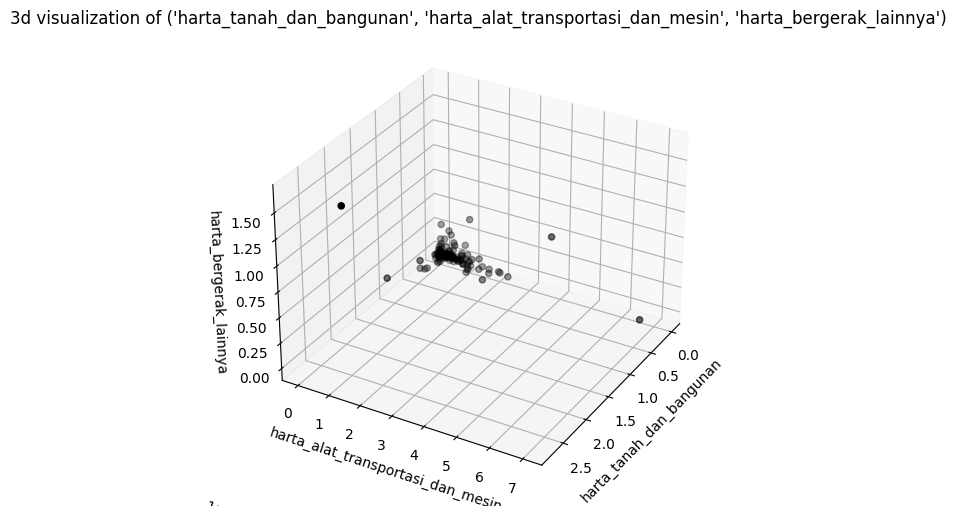

1 ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'surat_berharga')


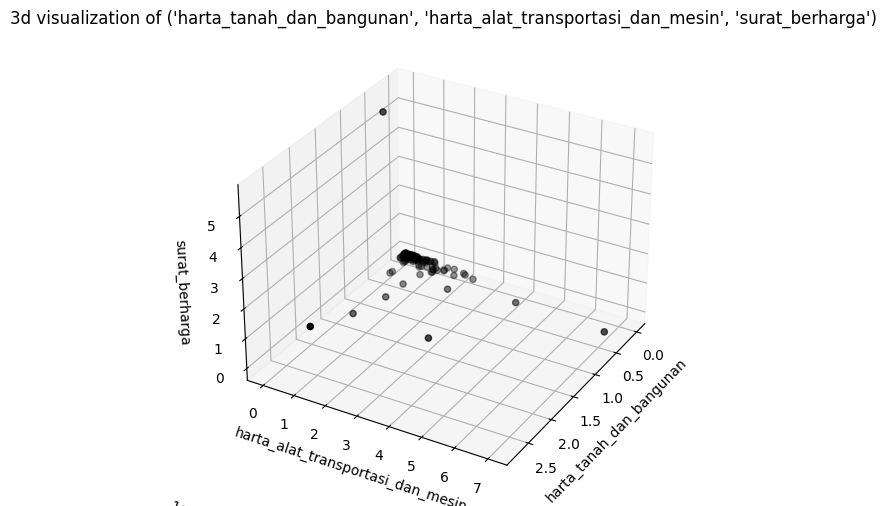

2 ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_kas_dan_setara_kas')


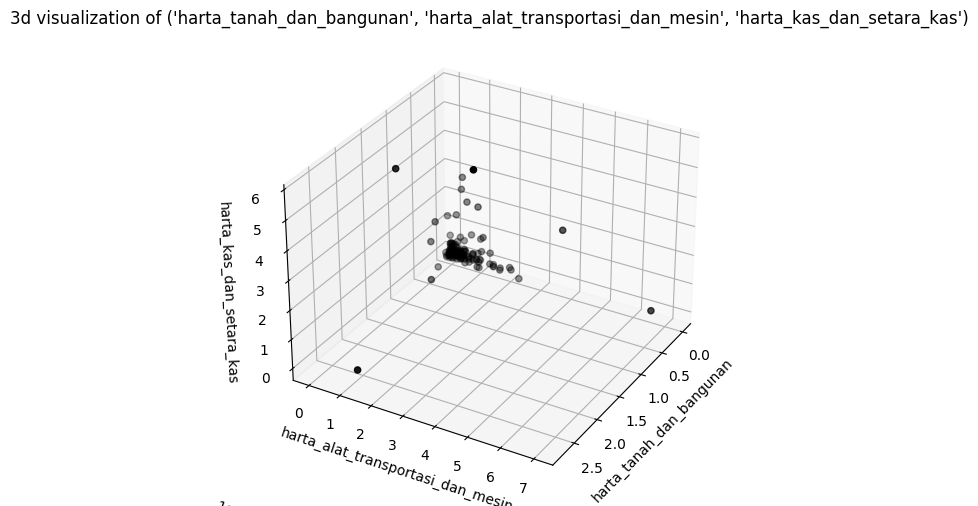

3 ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'harta_lainnya')


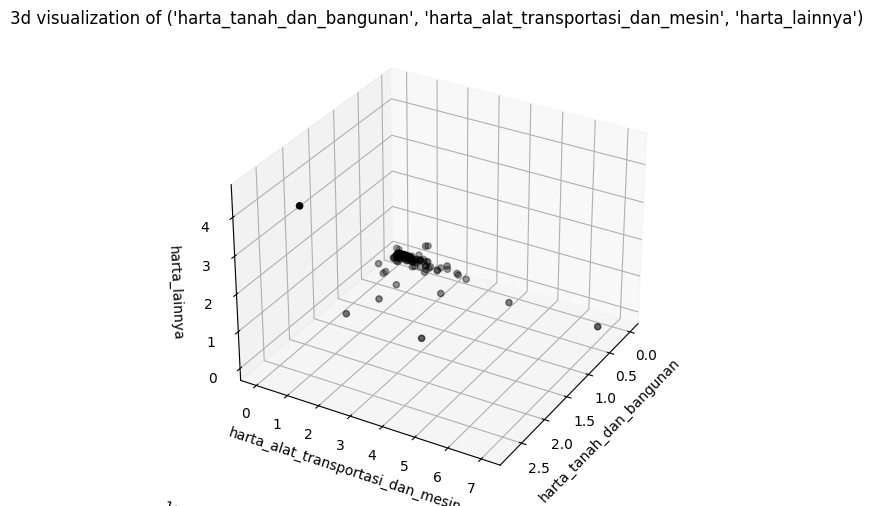

4 ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'sub_total')


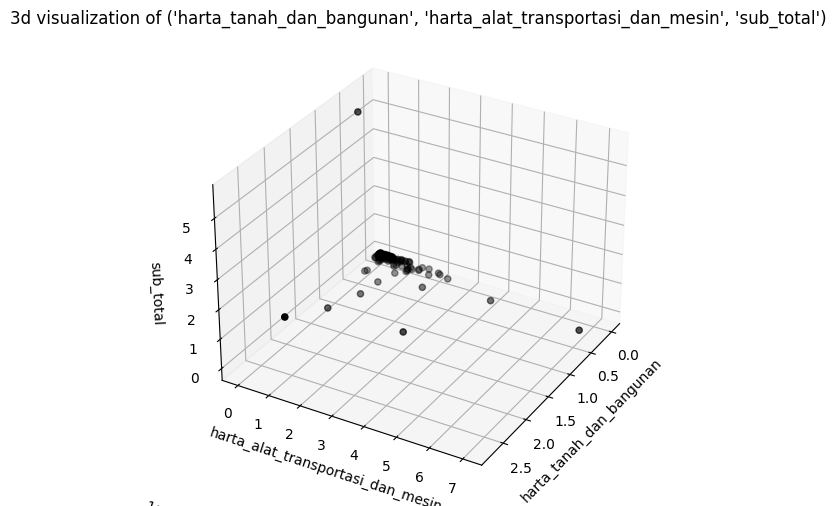

5 ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'hutang')


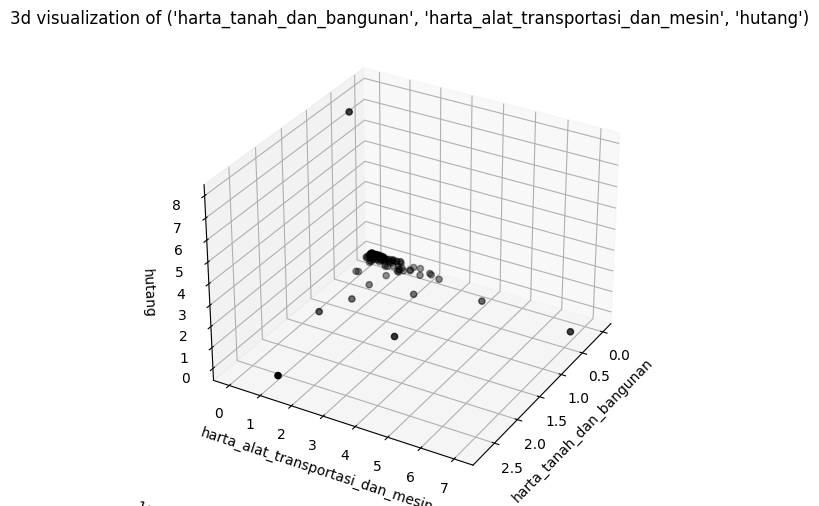

6 ('harta_tanah_dan_bangunan', 'harta_alat_transportasi_dan_mesin', 'total_harta_kekayaan')


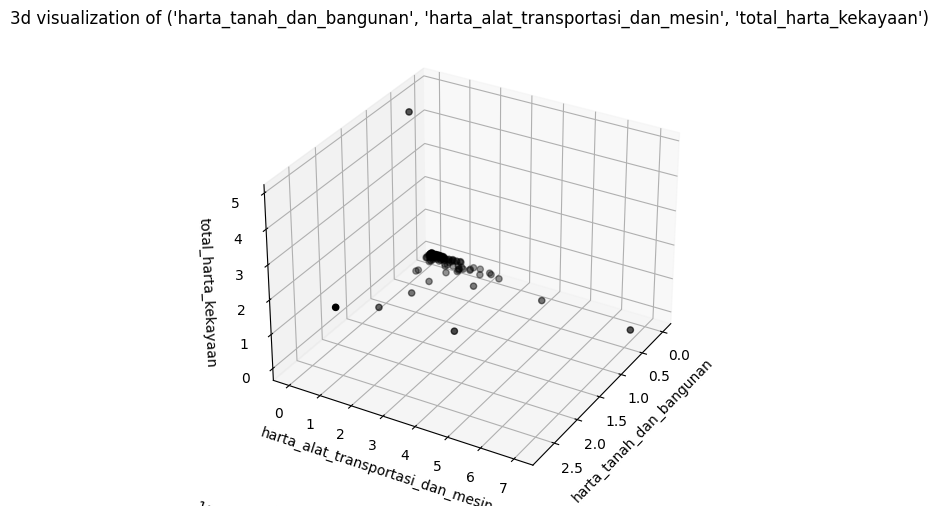

7 ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'surat_berharga')


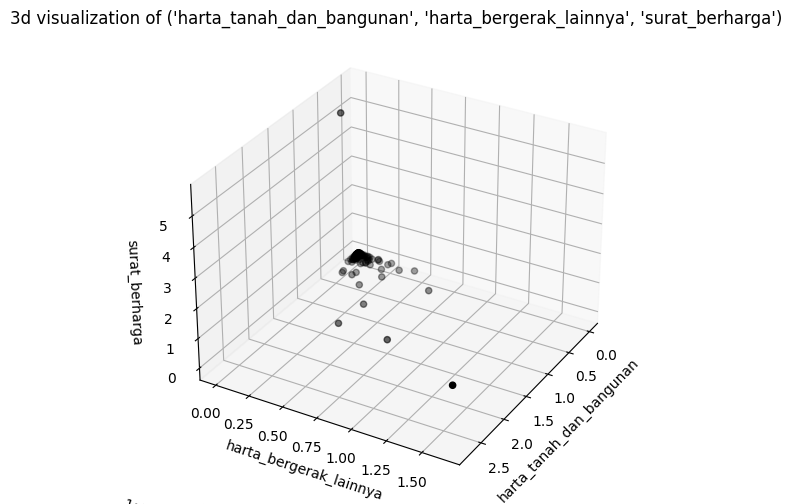

8 ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'harta_kas_dan_setara_kas')


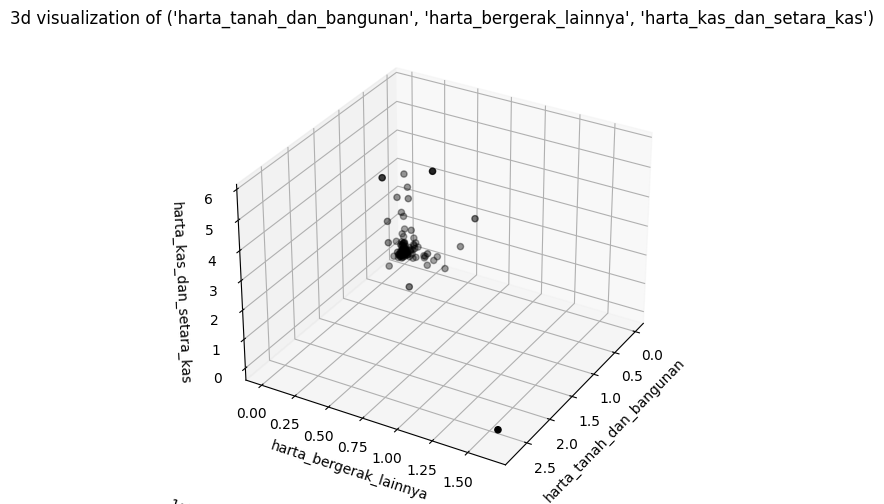

9 ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'harta_lainnya')


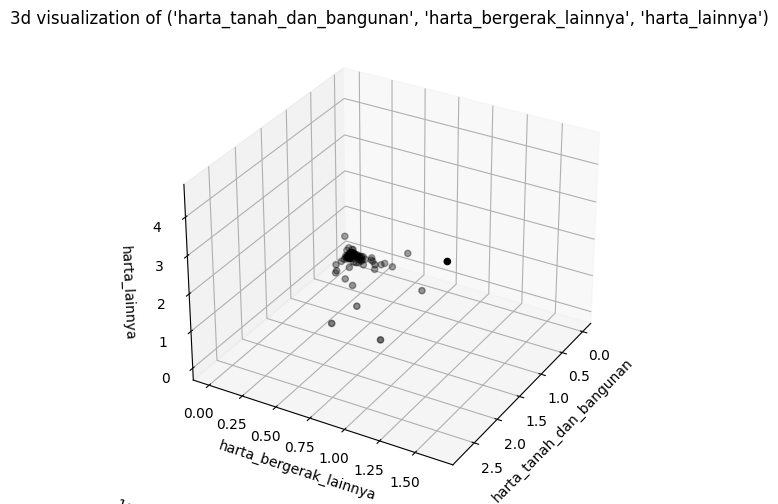

10 ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'sub_total')


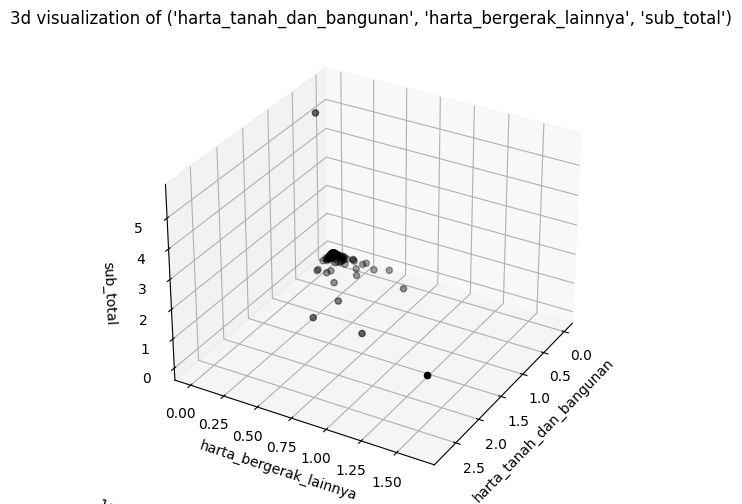

11 ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'hutang')


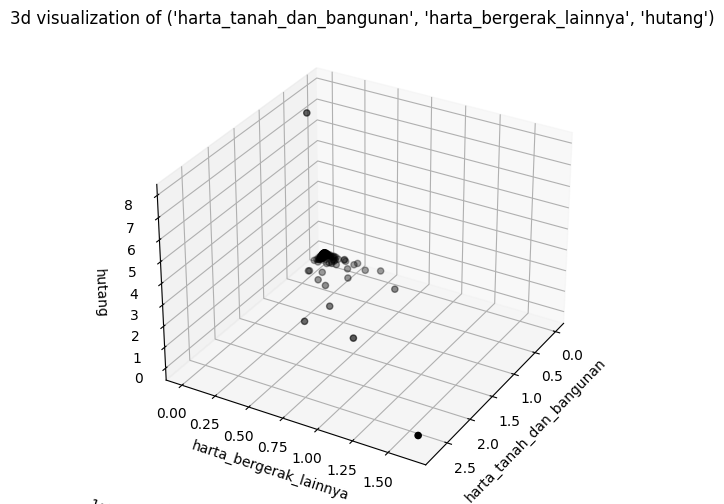

12 ('harta_tanah_dan_bangunan', 'harta_bergerak_lainnya', 'total_harta_kekayaan')


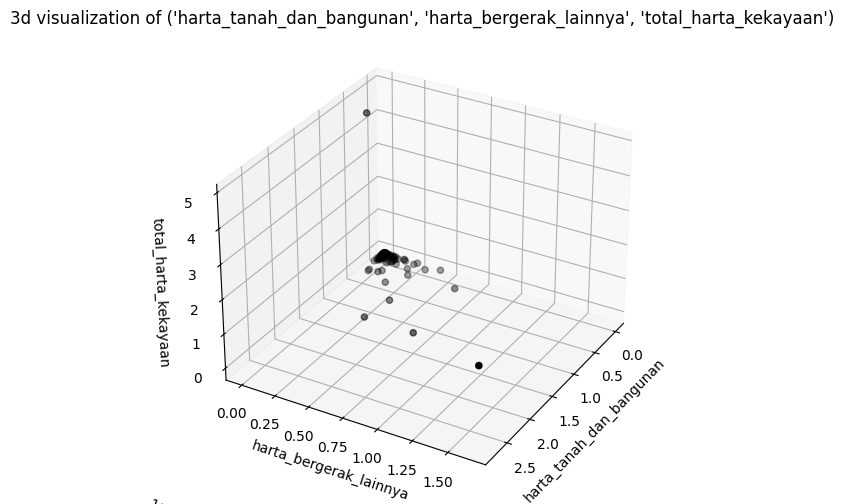

13 ('harta_tanah_dan_bangunan', 'surat_berharga', 'harta_kas_dan_setara_kas')


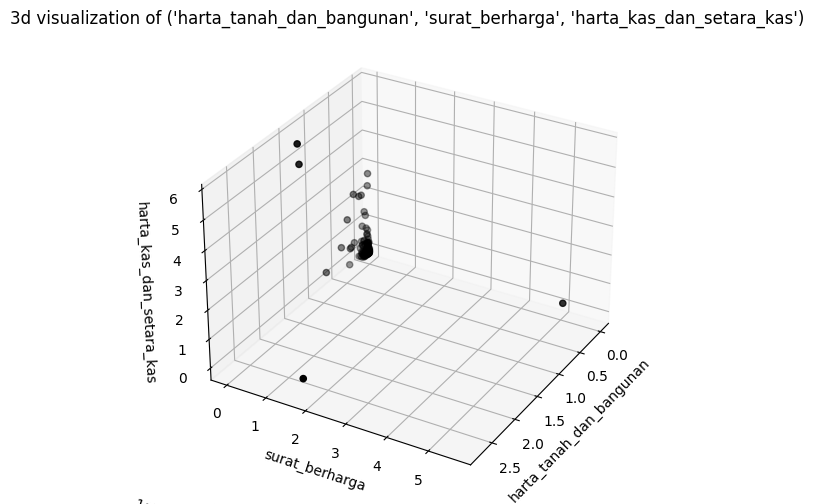

14 ('harta_tanah_dan_bangunan', 'surat_berharga', 'harta_lainnya')


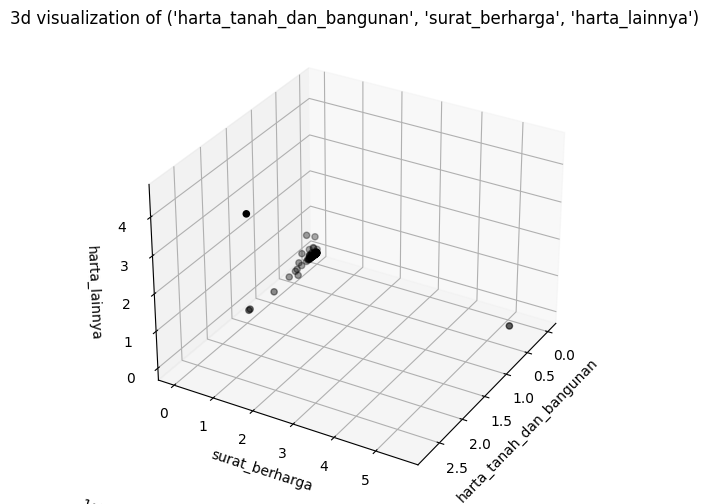

15 ('harta_tanah_dan_bangunan', 'surat_berharga', 'sub_total')


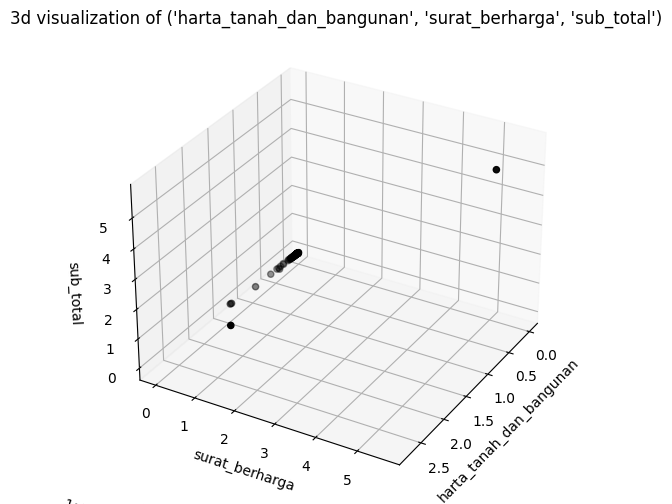

16 ('harta_tanah_dan_bangunan', 'surat_berharga', 'hutang')


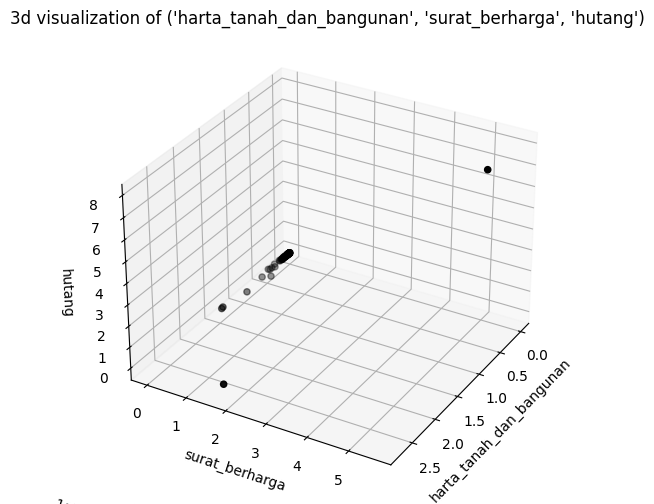

17 ('harta_tanah_dan_bangunan', 'surat_berharga', 'total_harta_kekayaan')


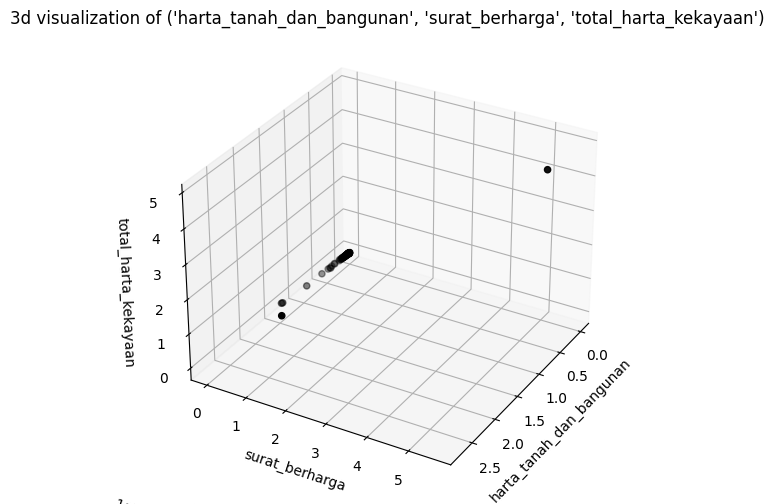

18 ('harta_tanah_dan_bangunan', 'harta_kas_dan_setara_kas', 'harta_lainnya')


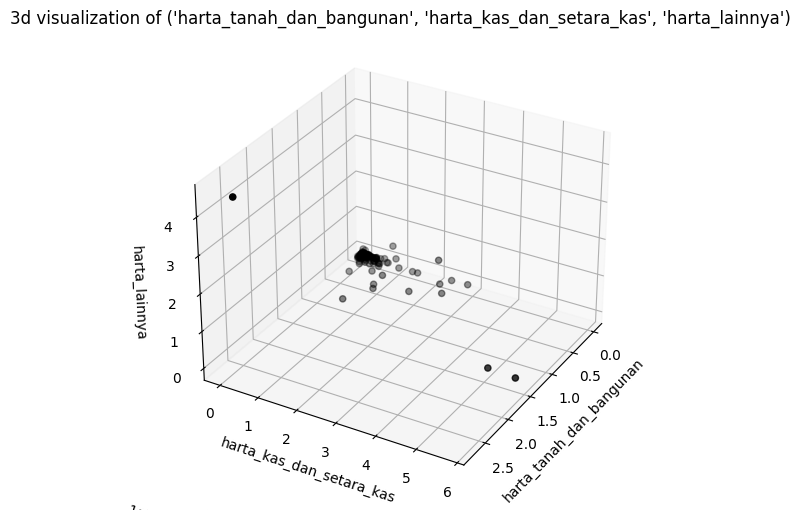

19 ('harta_tanah_dan_bangunan', 'harta_kas_dan_setara_kas', 'sub_total')


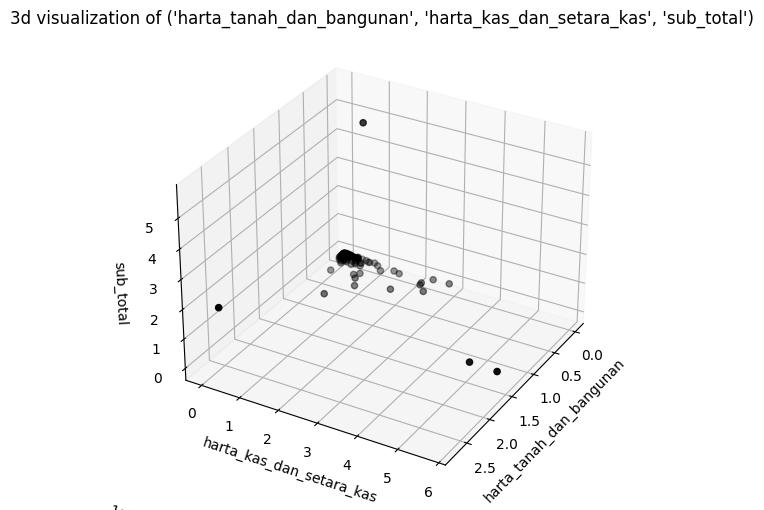

20 ('harta_tanah_dan_bangunan', 'harta_kas_dan_setara_kas', 'hutang')


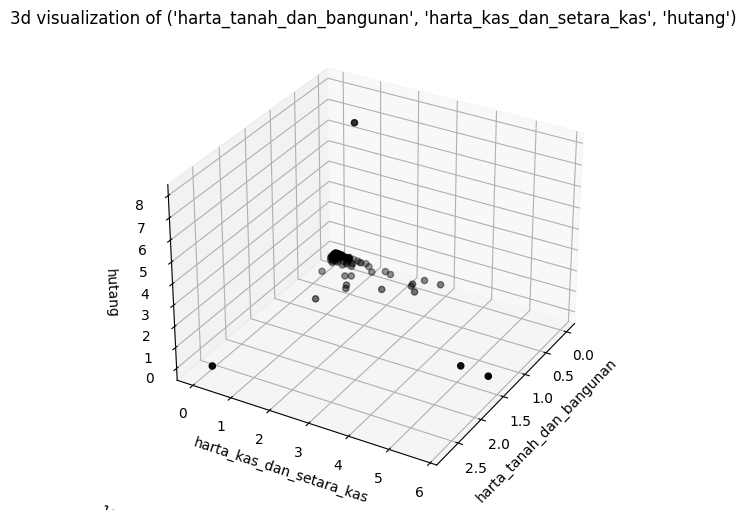

21 ('harta_tanah_dan_bangunan', 'harta_kas_dan_setara_kas', 'total_harta_kekayaan')


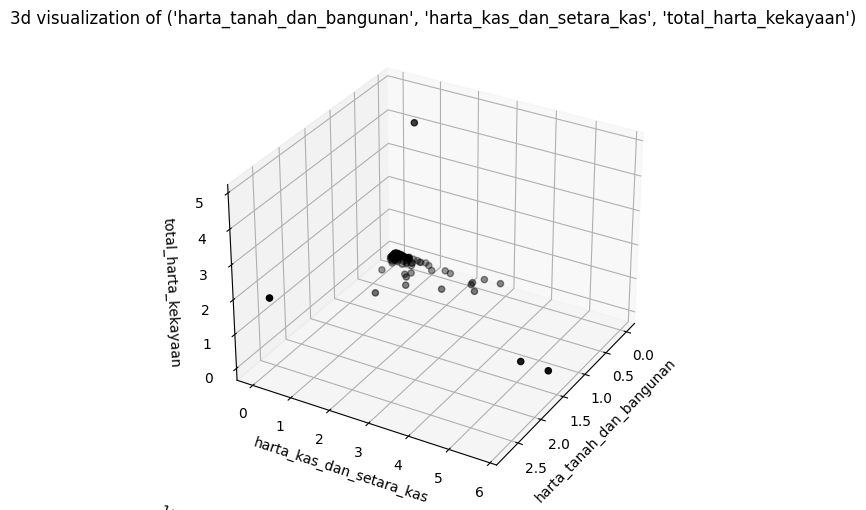

22 ('harta_tanah_dan_bangunan', 'harta_lainnya', 'sub_total')


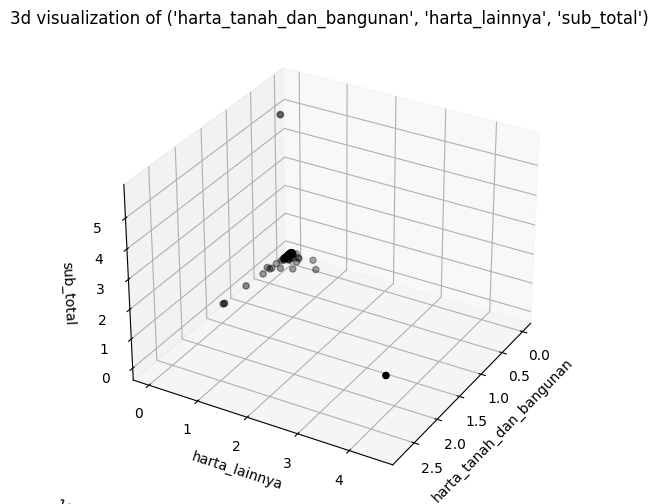

23 ('harta_tanah_dan_bangunan', 'harta_lainnya', 'hutang')


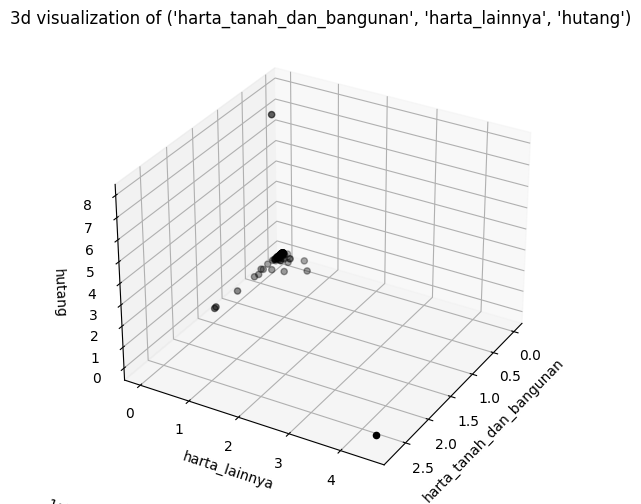

24 ('harta_tanah_dan_bangunan', 'harta_lainnya', 'total_harta_kekayaan')


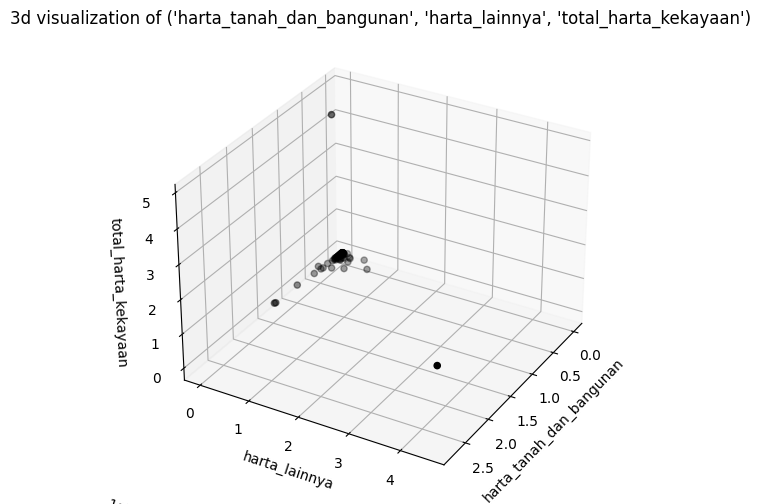

25 ('harta_tanah_dan_bangunan', 'sub_total', 'hutang')


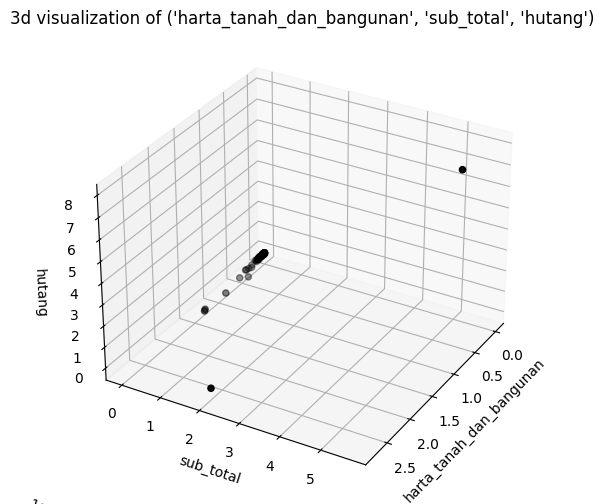

26 ('harta_tanah_dan_bangunan', 'sub_total', 'total_harta_kekayaan')


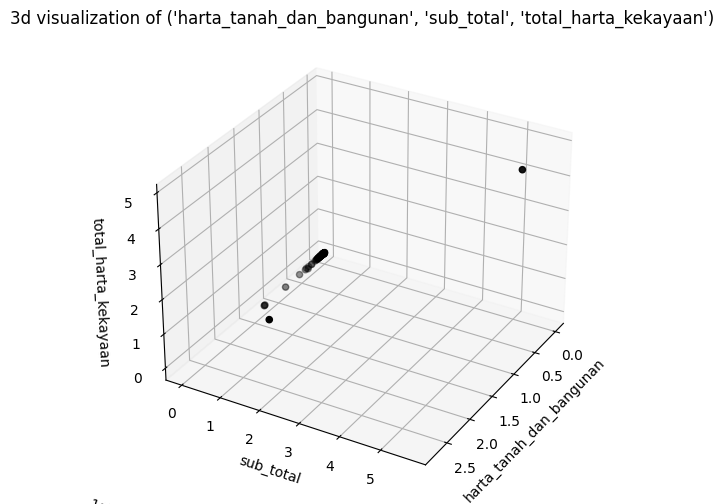

27 ('harta_tanah_dan_bangunan', 'hutang', 'total_harta_kekayaan')


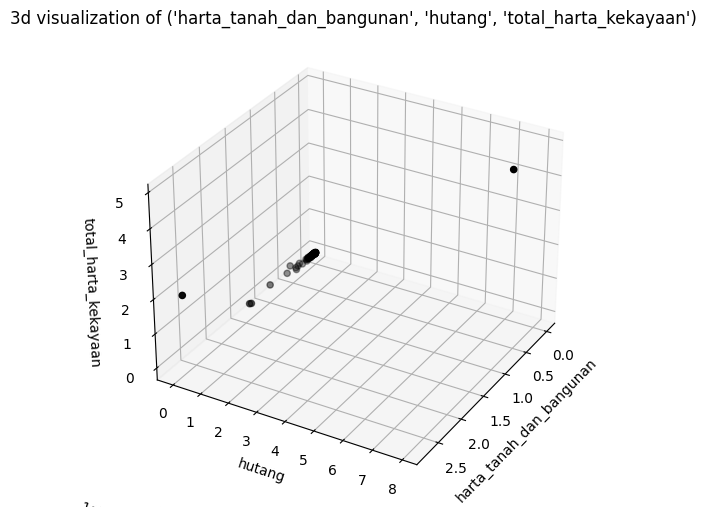

28 ('harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'surat_berharga')


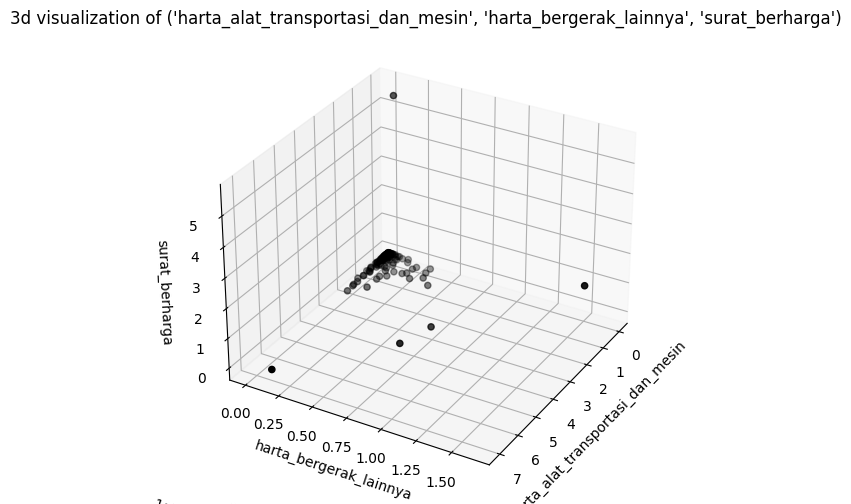

29 ('harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'harta_kas_dan_setara_kas')


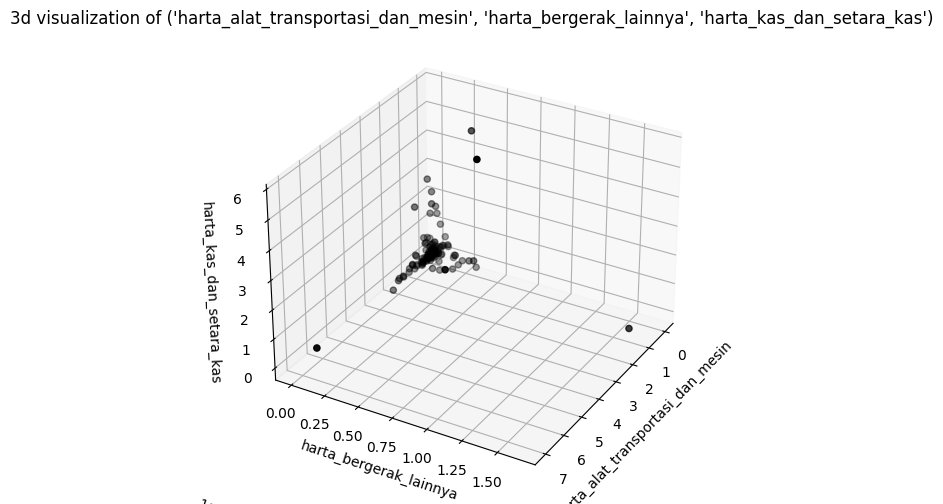

30 ('harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'harta_lainnya')


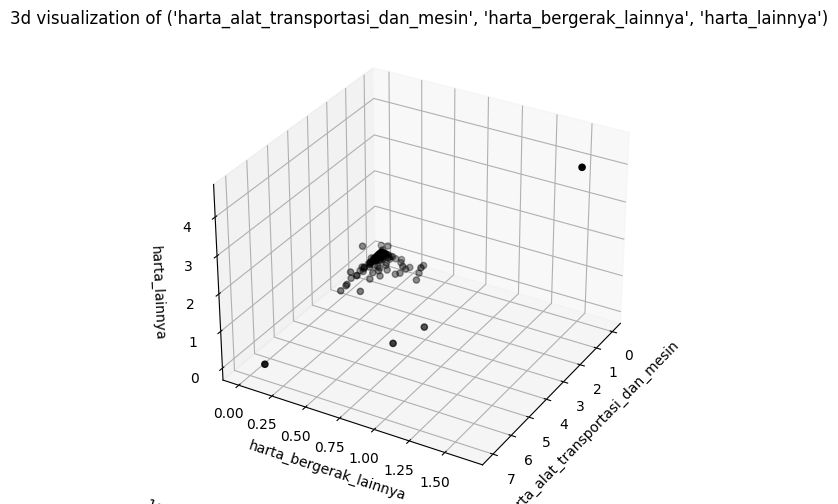

31 ('harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'sub_total')


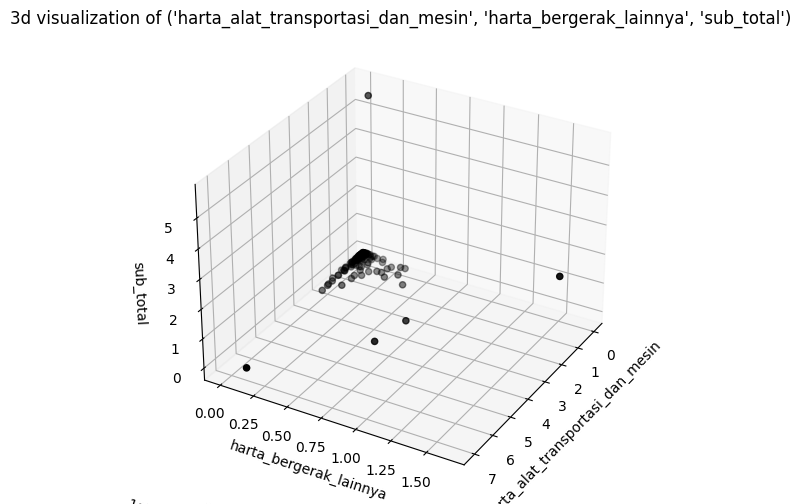

32 ('harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'hutang')


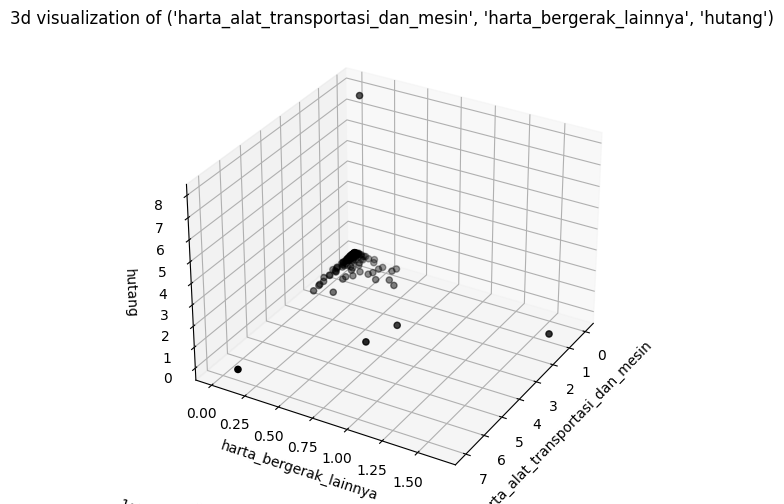

33 ('harta_alat_transportasi_dan_mesin', 'harta_bergerak_lainnya', 'total_harta_kekayaan')


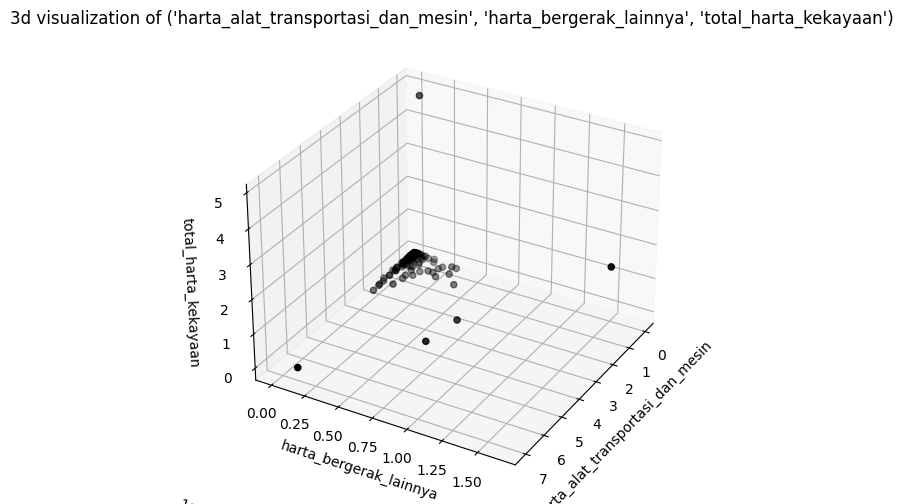

34 ('harta_alat_transportasi_dan_mesin', 'surat_berharga', 'harta_kas_dan_setara_kas')


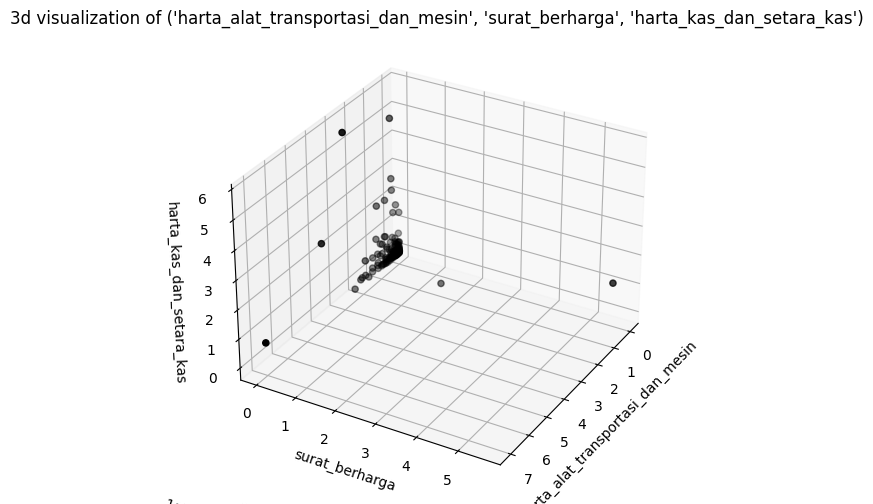

35 ('harta_alat_transportasi_dan_mesin', 'surat_berharga', 'harta_lainnya')


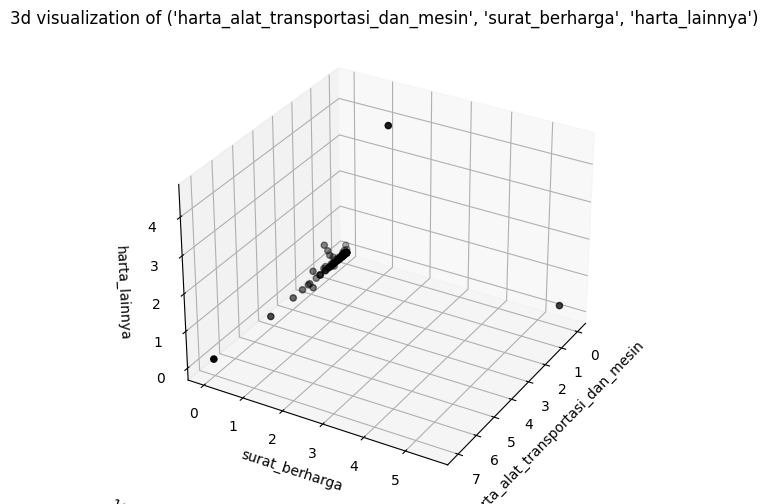

36 ('harta_alat_transportasi_dan_mesin', 'surat_berharga', 'sub_total')


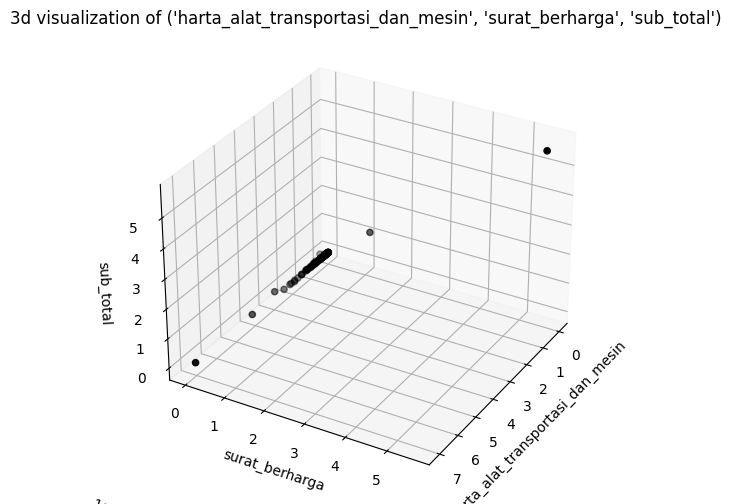

37 ('harta_alat_transportasi_dan_mesin', 'surat_berharga', 'hutang')


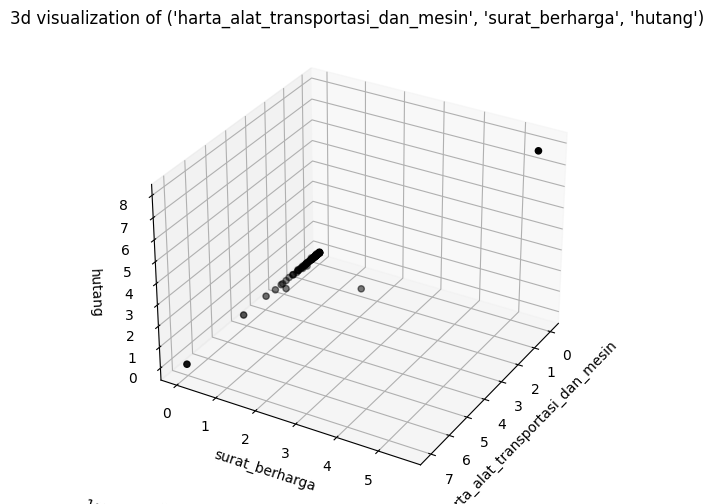

38 ('harta_alat_transportasi_dan_mesin', 'surat_berharga', 'total_harta_kekayaan')


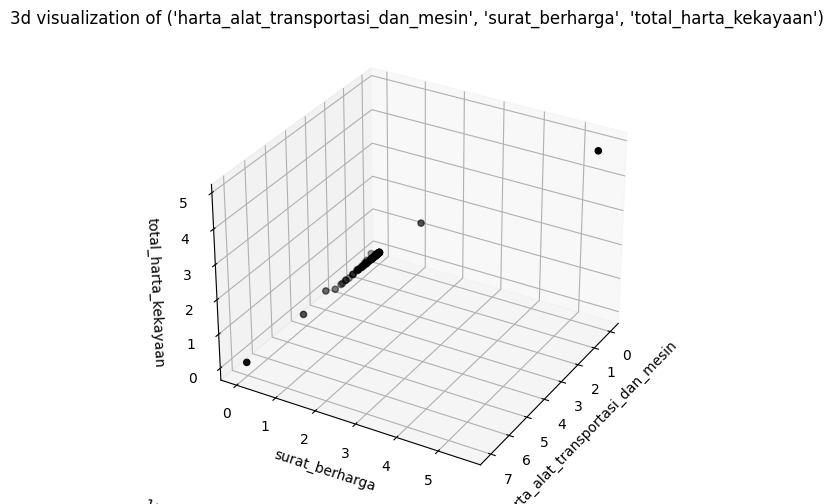

39 ('harta_alat_transportasi_dan_mesin', 'harta_kas_dan_setara_kas', 'harta_lainnya')


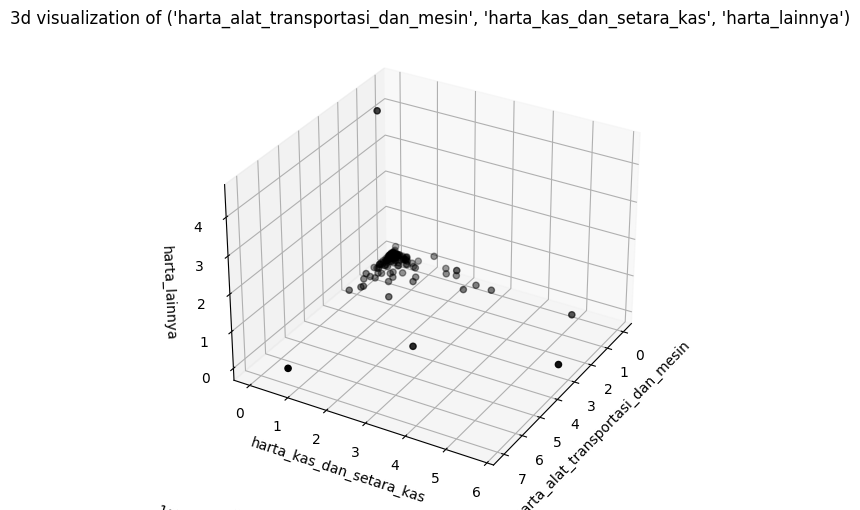

40 ('harta_alat_transportasi_dan_mesin', 'harta_kas_dan_setara_kas', 'sub_total')


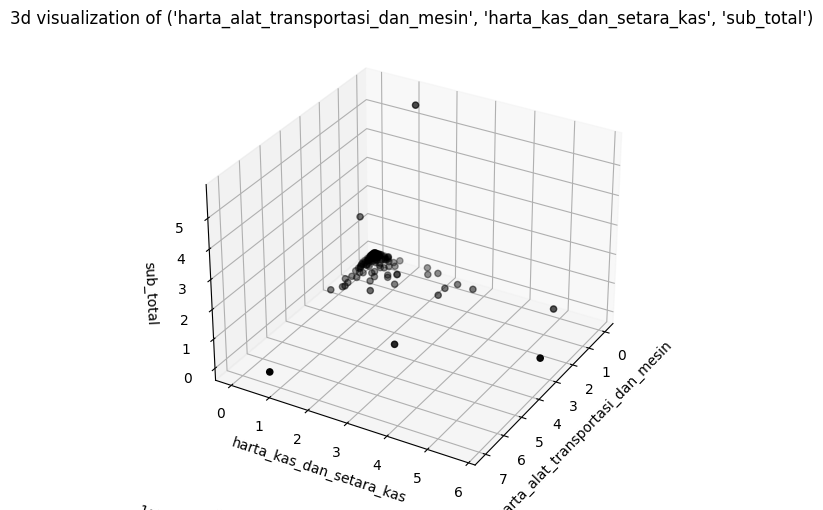

41 ('harta_alat_transportasi_dan_mesin', 'harta_kas_dan_setara_kas', 'hutang')


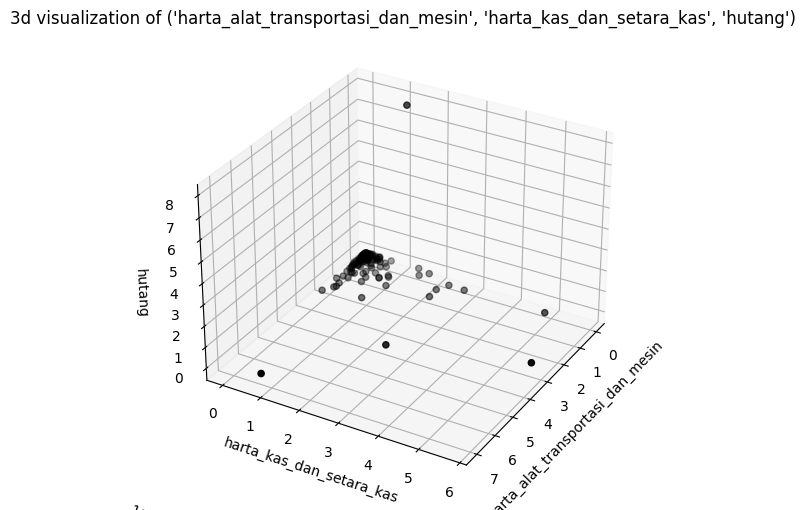

42 ('harta_alat_transportasi_dan_mesin', 'harta_kas_dan_setara_kas', 'total_harta_kekayaan')


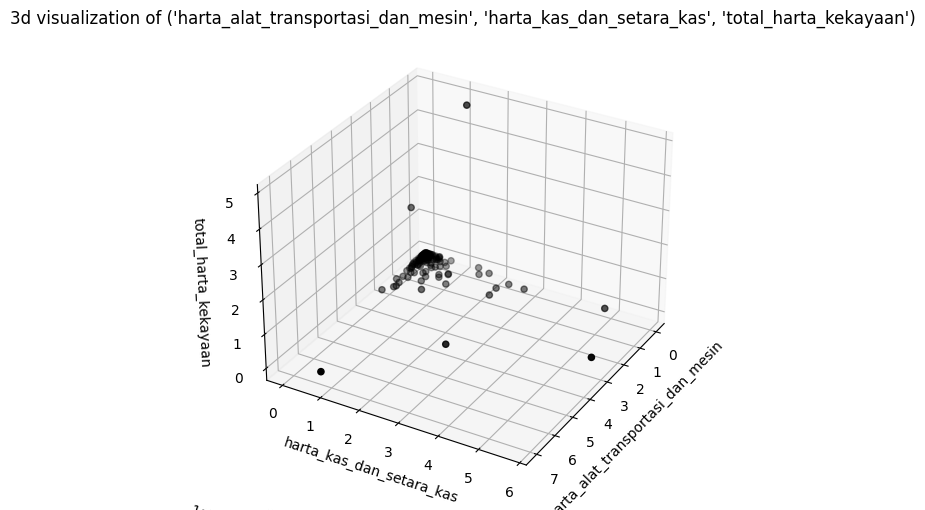

43 ('harta_alat_transportasi_dan_mesin', 'harta_lainnya', 'sub_total')


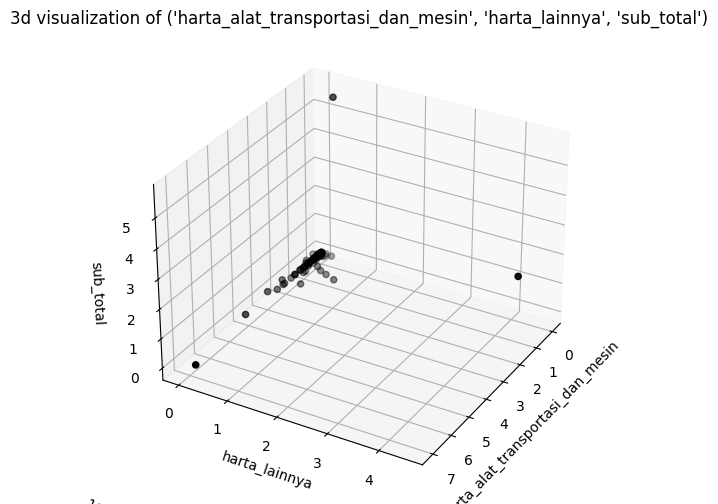

44 ('harta_alat_transportasi_dan_mesin', 'harta_lainnya', 'hutang')


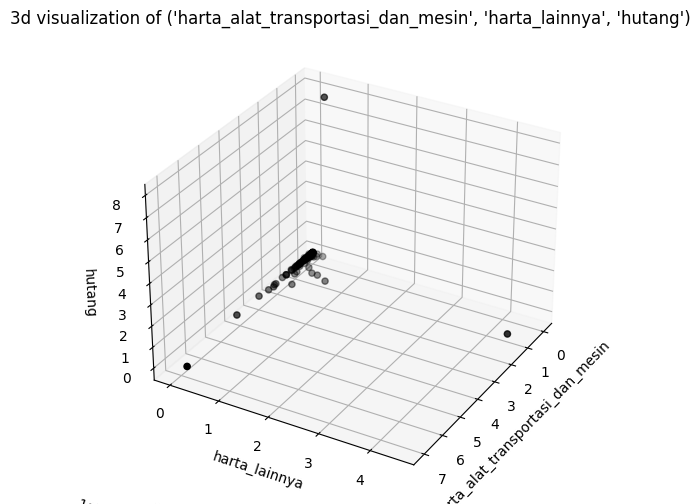

45 ('harta_alat_transportasi_dan_mesin', 'harta_lainnya', 'total_harta_kekayaan')


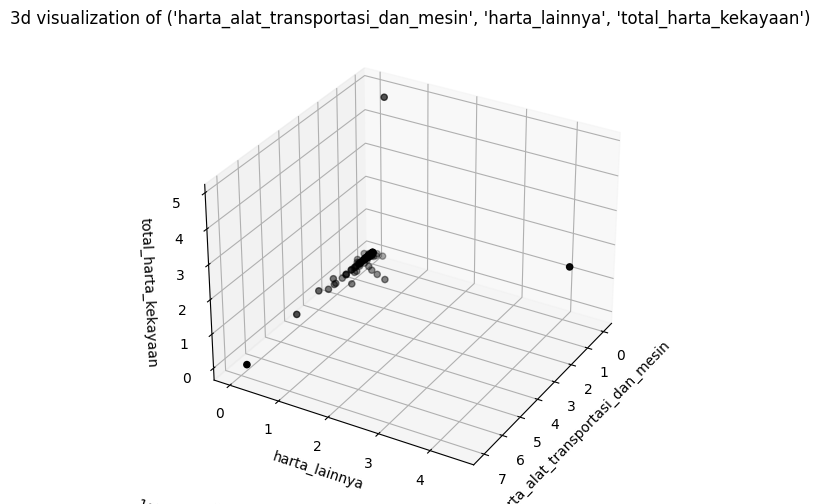

46 ('harta_alat_transportasi_dan_mesin', 'sub_total', 'hutang')


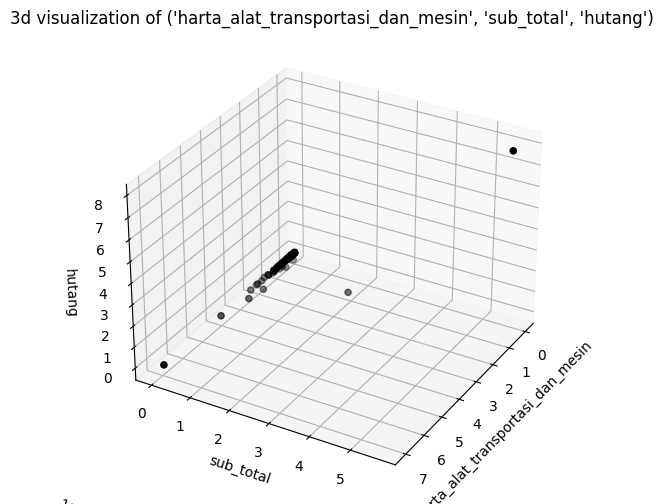

47 ('harta_alat_transportasi_dan_mesin', 'sub_total', 'total_harta_kekayaan')


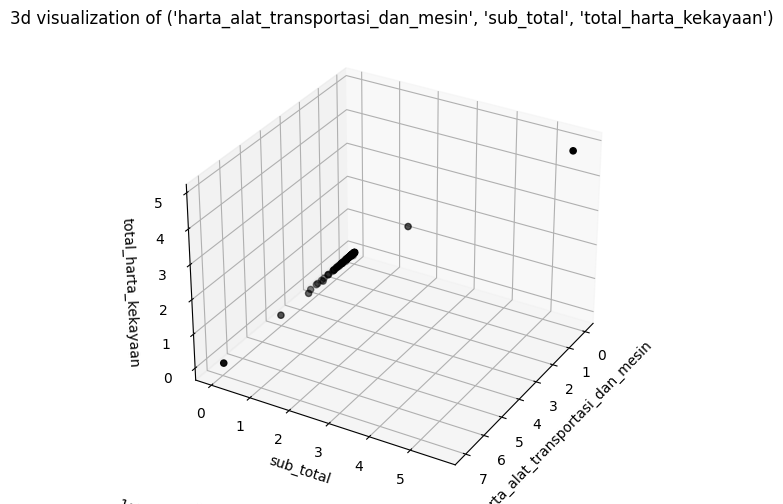

48 ('harta_alat_transportasi_dan_mesin', 'hutang', 'total_harta_kekayaan')


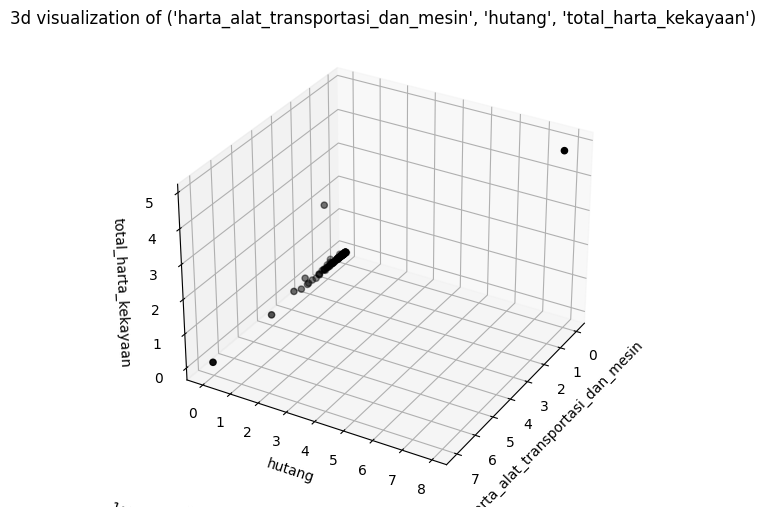

49 ('harta_bergerak_lainnya', 'surat_berharga', 'harta_kas_dan_setara_kas')


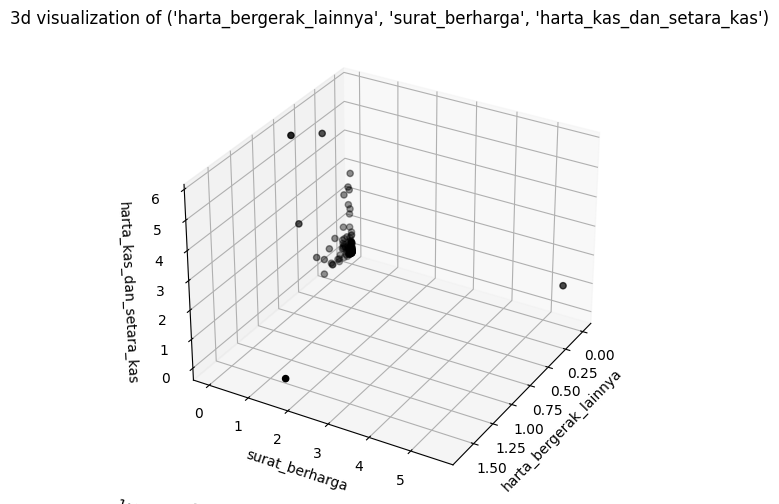

50 ('harta_bergerak_lainnya', 'surat_berharga', 'harta_lainnya')


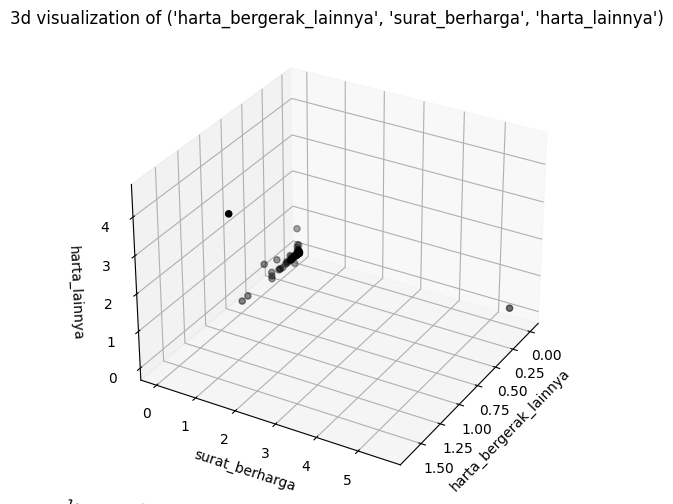

51 ('harta_bergerak_lainnya', 'surat_berharga', 'sub_total')


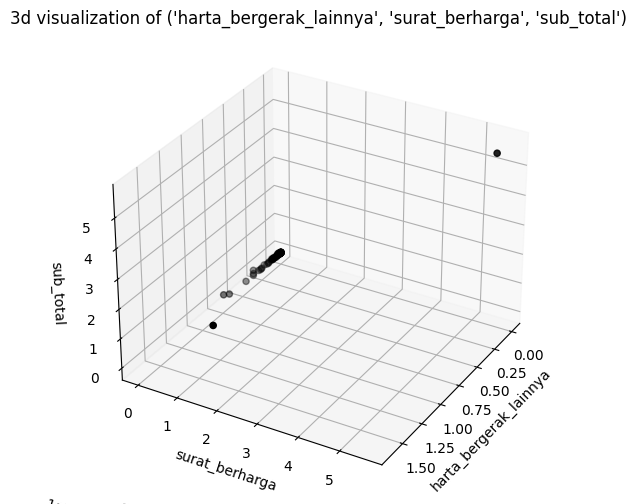

52 ('harta_bergerak_lainnya', 'surat_berharga', 'hutang')


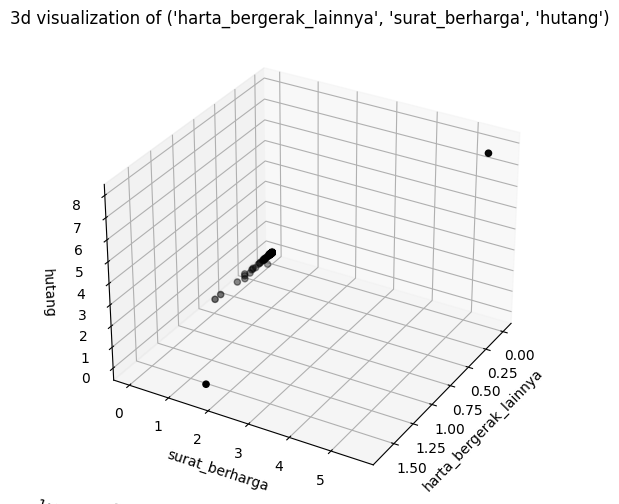

53 ('harta_bergerak_lainnya', 'surat_berharga', 'total_harta_kekayaan')


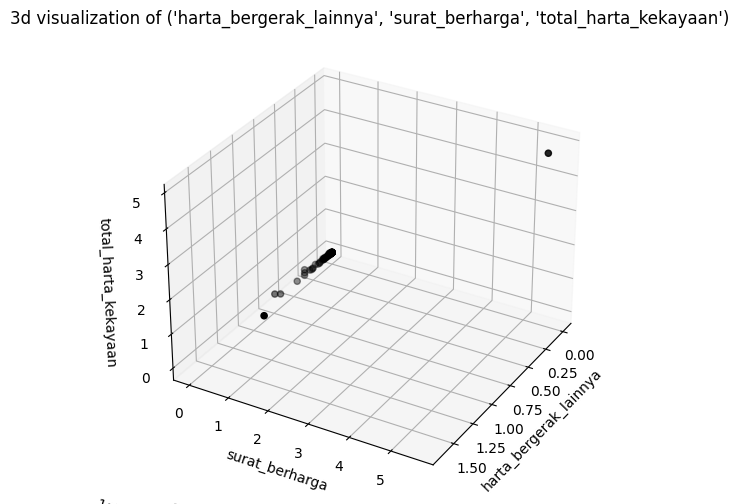

54 ('harta_bergerak_lainnya', 'harta_kas_dan_setara_kas', 'harta_lainnya')


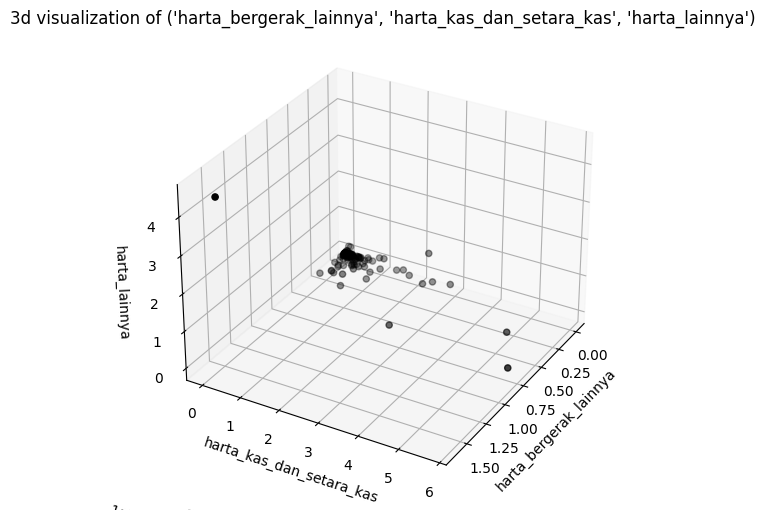

55 ('harta_bergerak_lainnya', 'harta_kas_dan_setara_kas', 'sub_total')


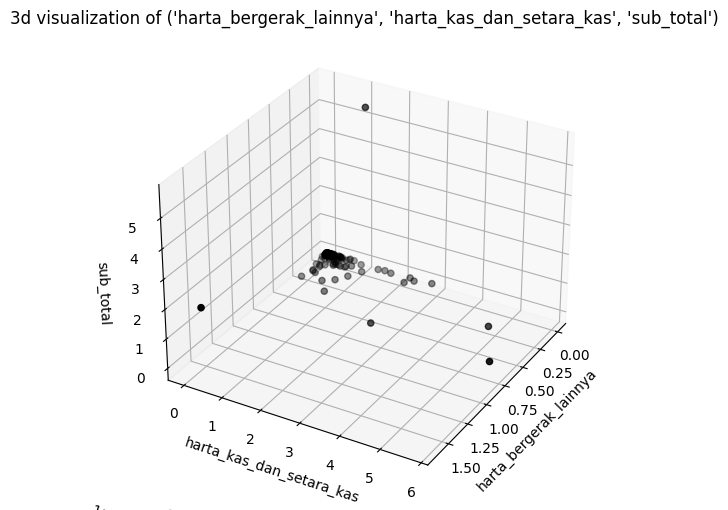

56 ('harta_bergerak_lainnya', 'harta_kas_dan_setara_kas', 'hutang')


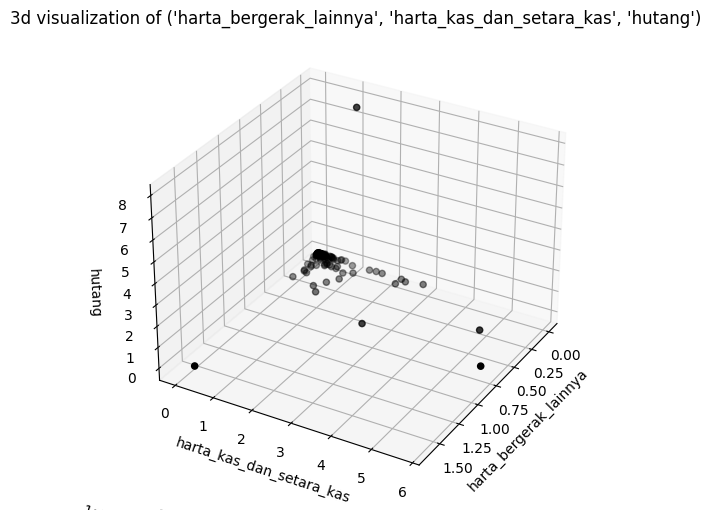

57 ('harta_bergerak_lainnya', 'harta_kas_dan_setara_kas', 'total_harta_kekayaan')


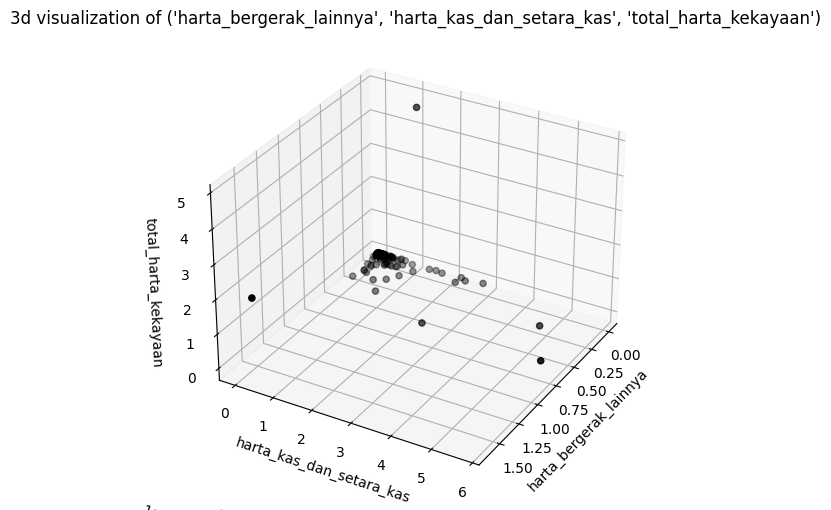

58 ('harta_bergerak_lainnya', 'harta_lainnya', 'sub_total')


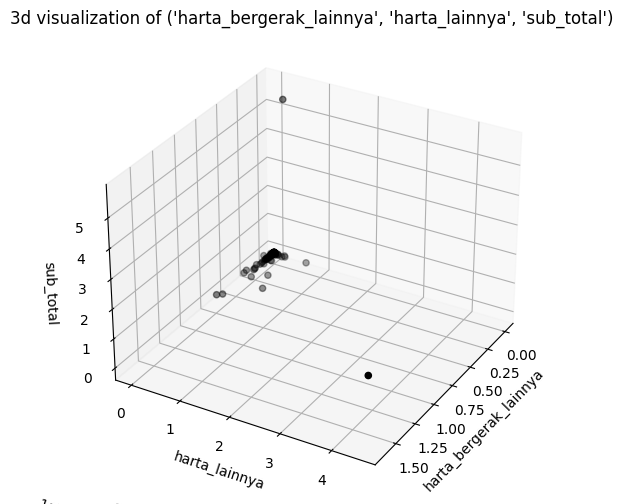

59 ('harta_bergerak_lainnya', 'harta_lainnya', 'hutang')


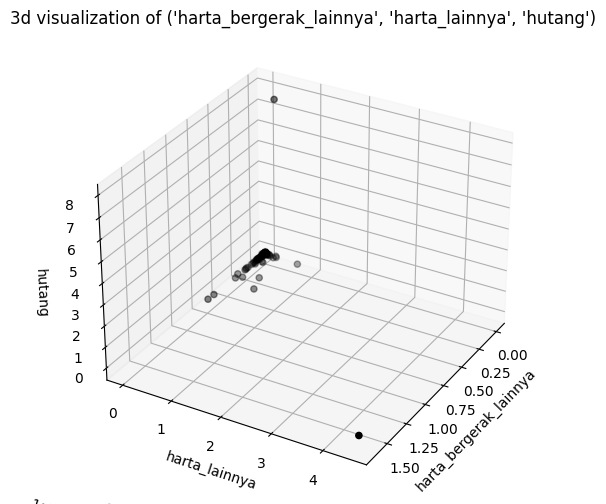

60 ('harta_bergerak_lainnya', 'harta_lainnya', 'total_harta_kekayaan')


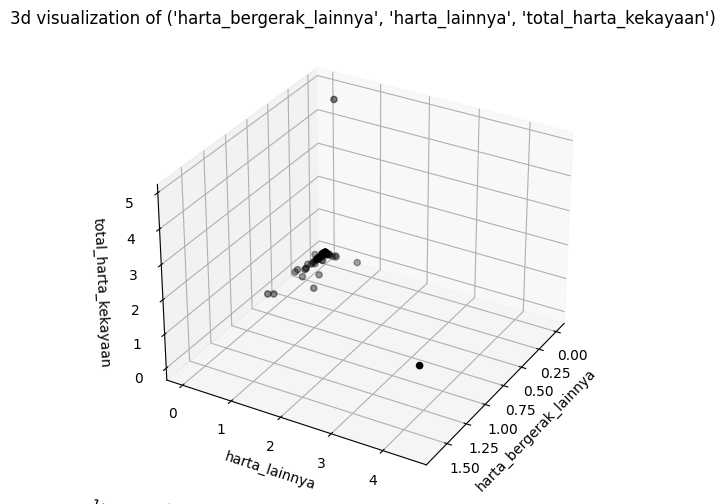

61 ('harta_bergerak_lainnya', 'sub_total', 'hutang')


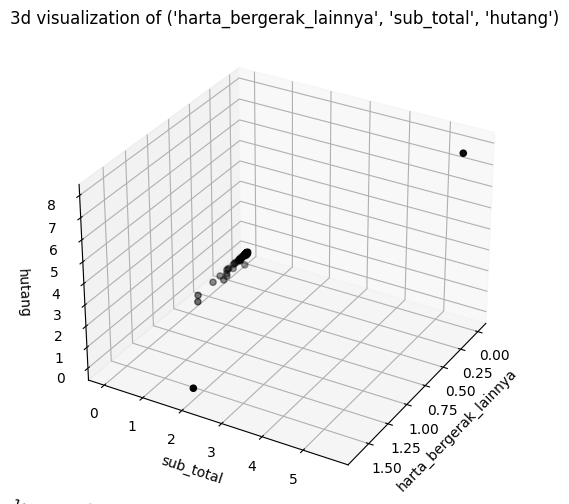

62 ('harta_bergerak_lainnya', 'sub_total', 'total_harta_kekayaan')


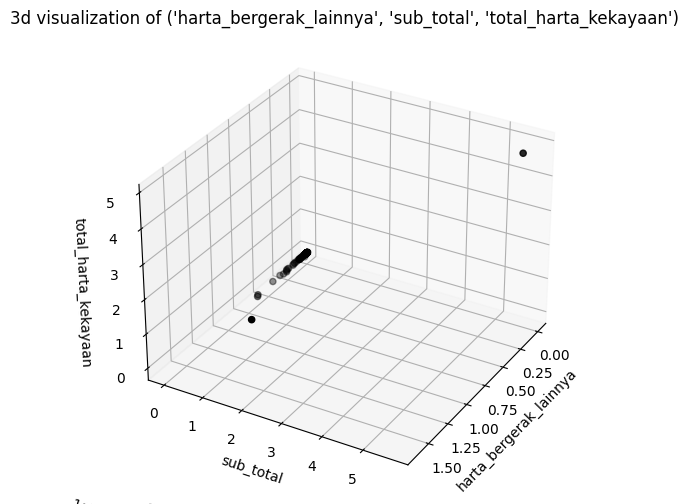

63 ('harta_bergerak_lainnya', 'hutang', 'total_harta_kekayaan')


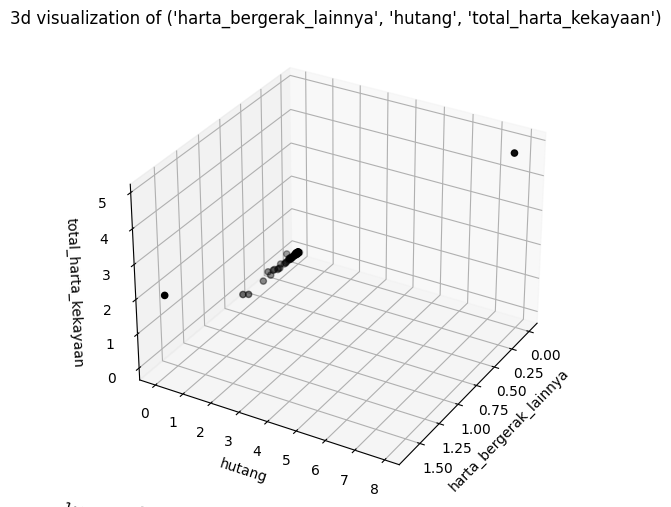

64 ('surat_berharga', 'harta_kas_dan_setara_kas', 'harta_lainnya')


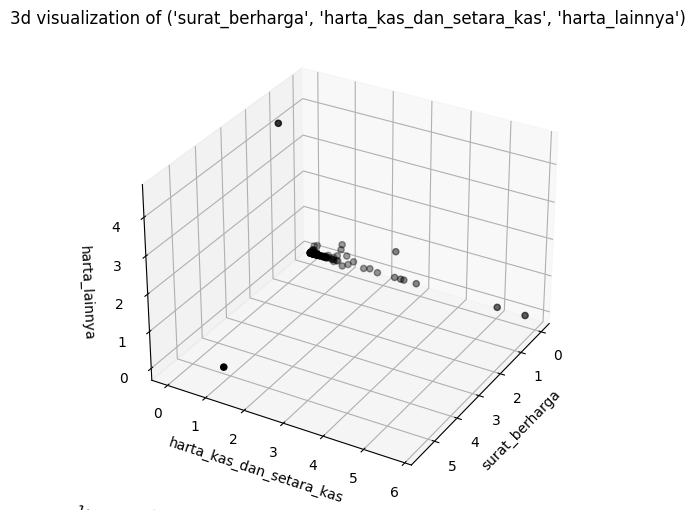

65 ('surat_berharga', 'harta_kas_dan_setara_kas', 'sub_total')


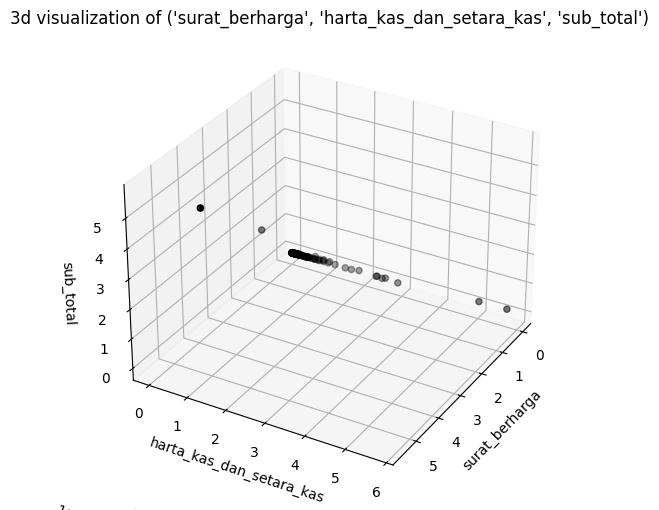

66 ('surat_berharga', 'harta_kas_dan_setara_kas', 'hutang')


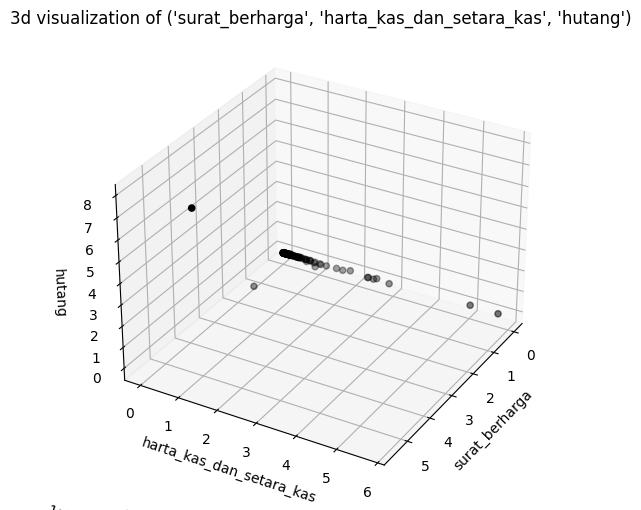

67 ('surat_berharga', 'harta_kas_dan_setara_kas', 'total_harta_kekayaan')


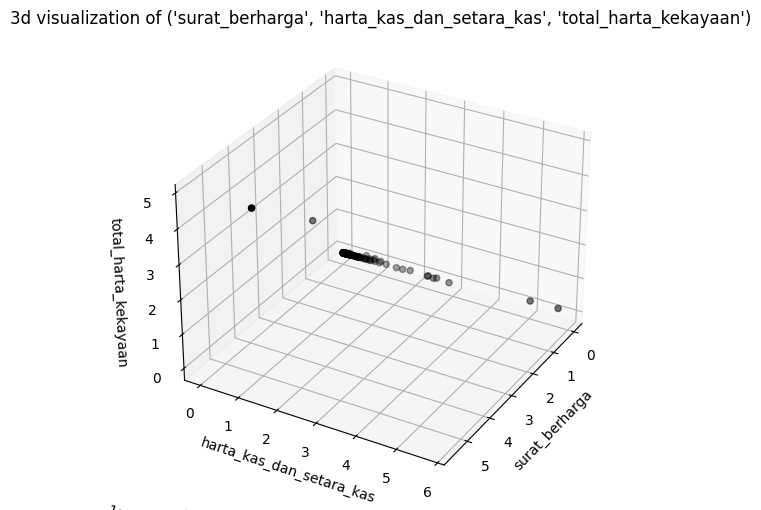

68 ('surat_berharga', 'harta_lainnya', 'sub_total')


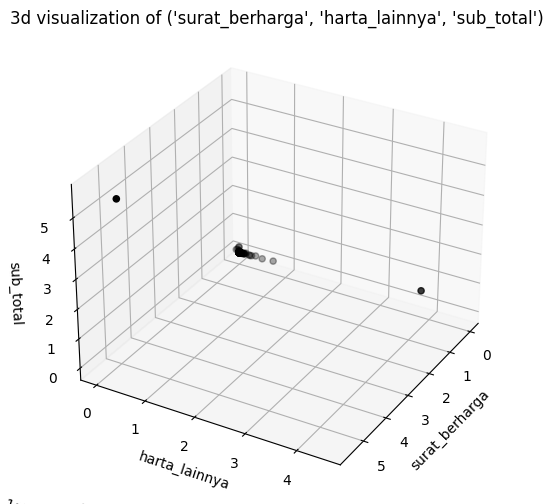

69 ('surat_berharga', 'harta_lainnya', 'hutang')


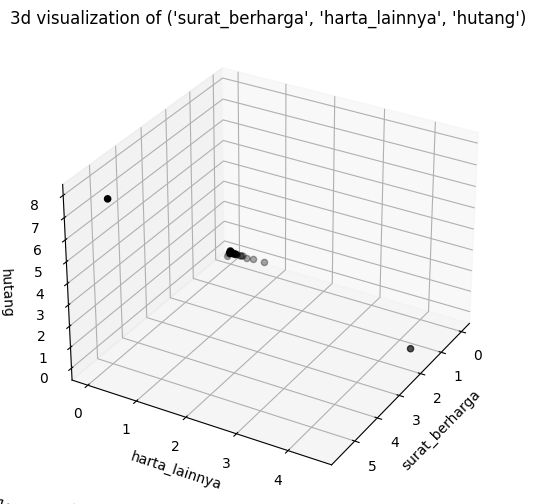

70 ('surat_berharga', 'harta_lainnya', 'total_harta_kekayaan')


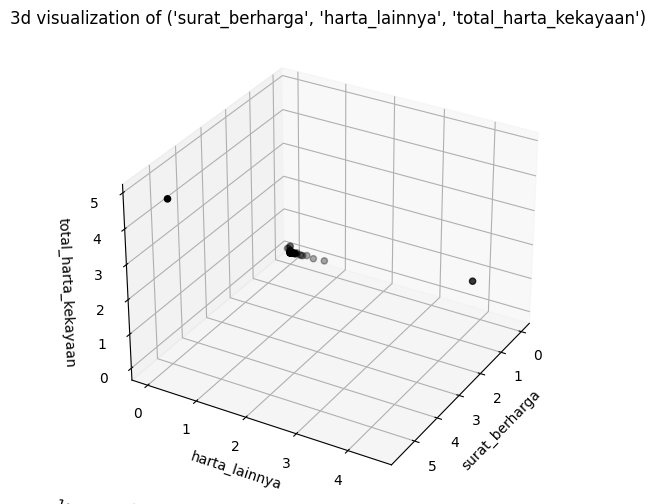

71 ('surat_berharga', 'sub_total', 'hutang')


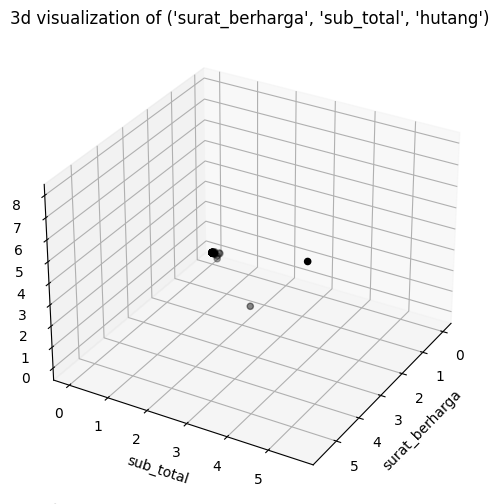

72 ('surat_berharga', 'sub_total', 'total_harta_kekayaan')


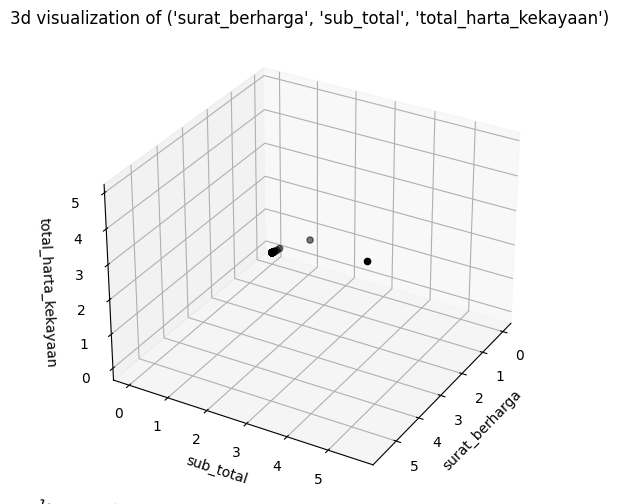

73 ('surat_berharga', 'hutang', 'total_harta_kekayaan')


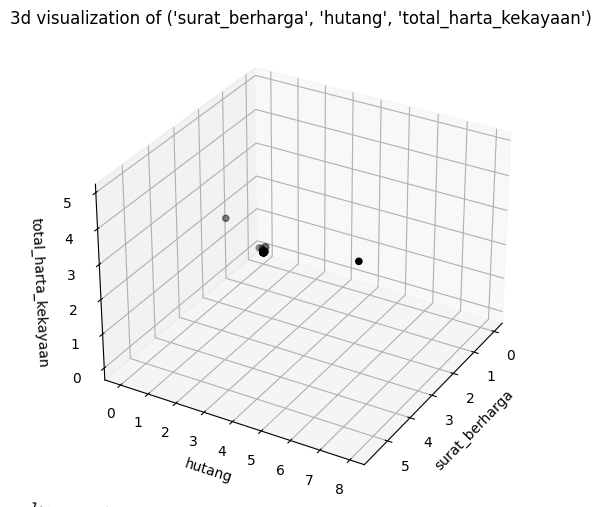

74 ('harta_kas_dan_setara_kas', 'harta_lainnya', 'sub_total')


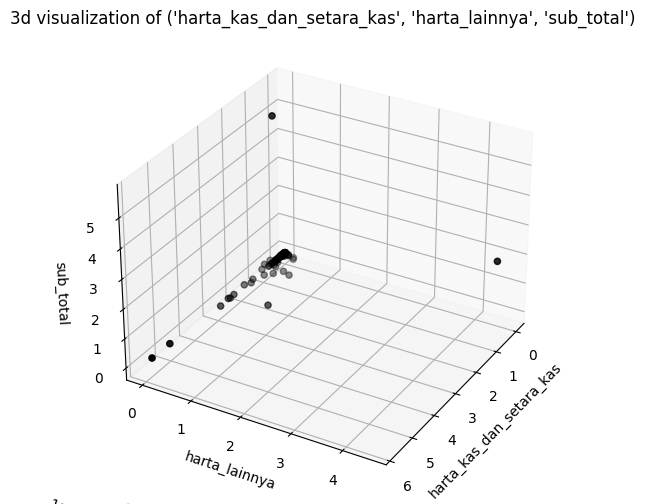

75 ('harta_kas_dan_setara_kas', 'harta_lainnya', 'hutang')


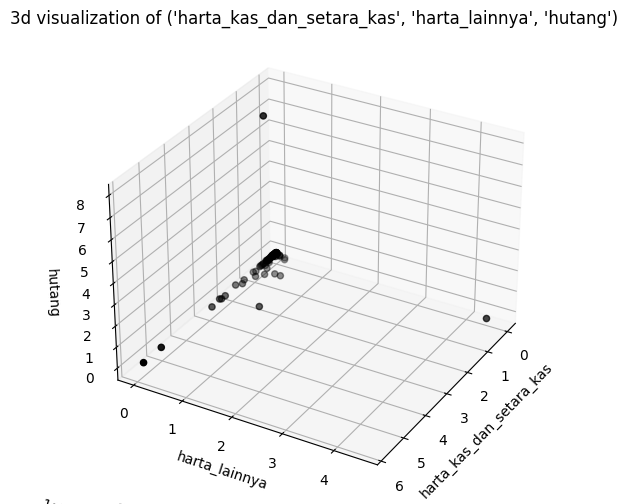

76 ('harta_kas_dan_setara_kas', 'harta_lainnya', 'total_harta_kekayaan')


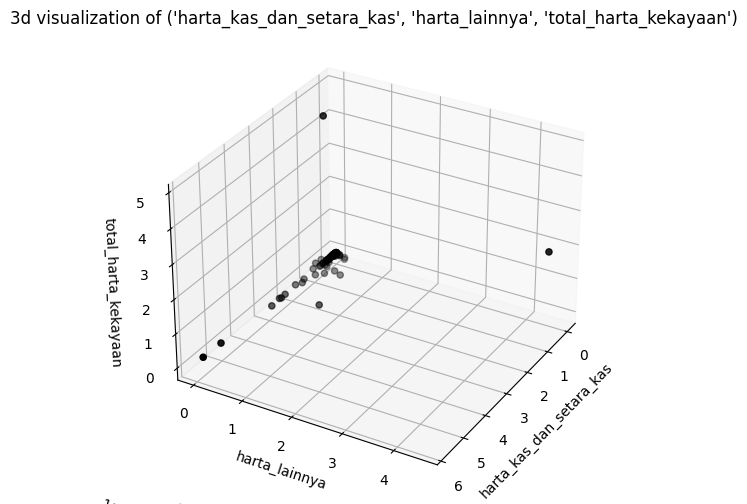

77 ('harta_kas_dan_setara_kas', 'sub_total', 'hutang')


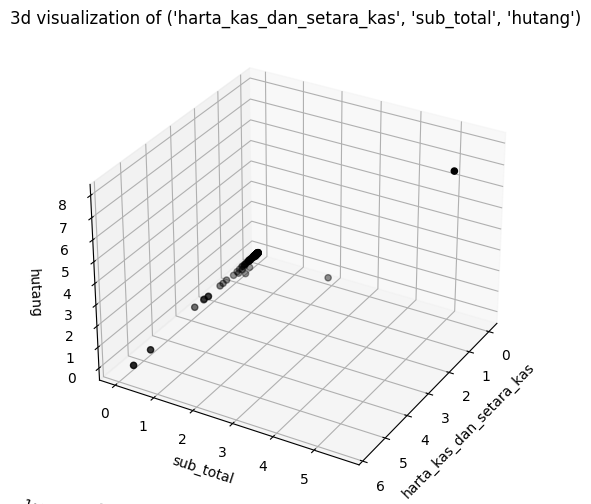

78 ('harta_kas_dan_setara_kas', 'sub_total', 'total_harta_kekayaan')


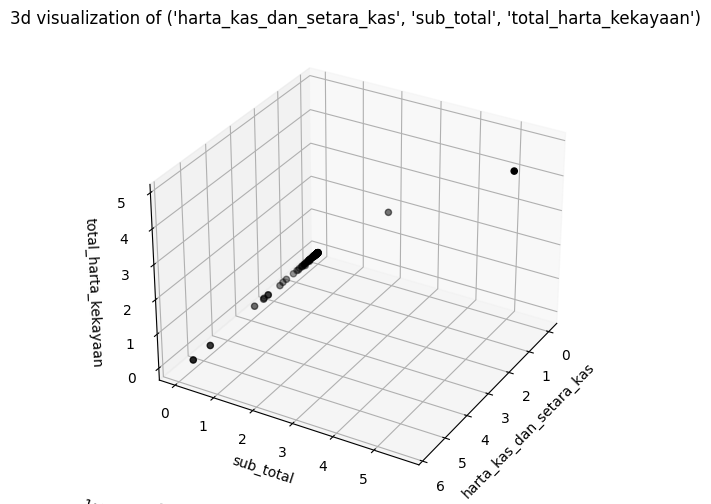

79 ('harta_kas_dan_setara_kas', 'hutang', 'total_harta_kekayaan')


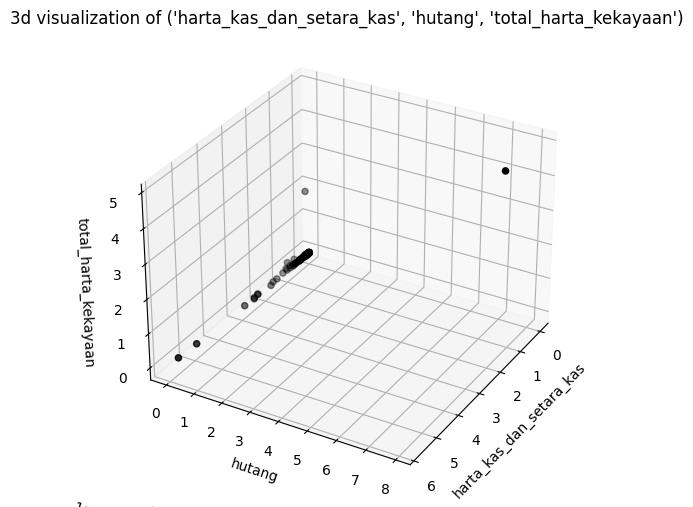

80 ('harta_lainnya', 'sub_total', 'hutang')


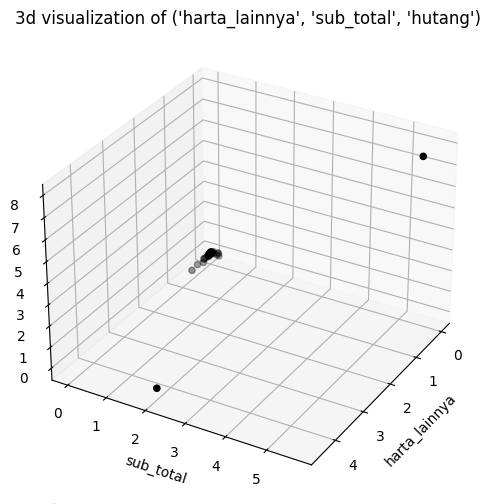

81 ('harta_lainnya', 'sub_total', 'total_harta_kekayaan')


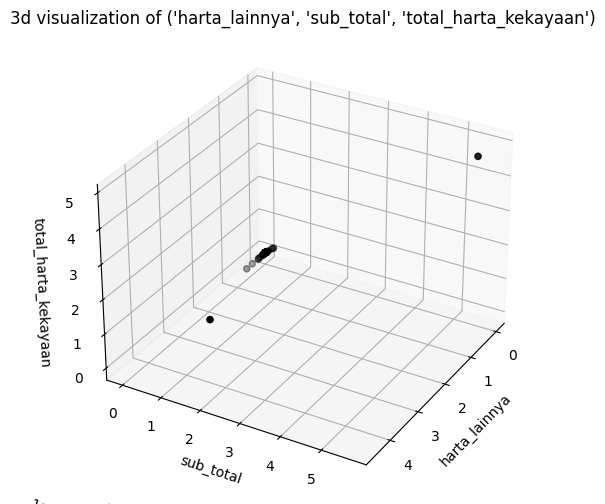

82 ('harta_lainnya', 'hutang', 'total_harta_kekayaan')


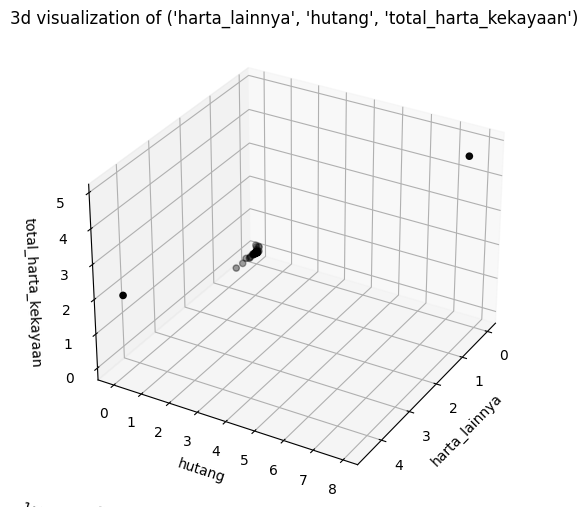

83 ('sub_total', 'hutang', 'total_harta_kekayaan')


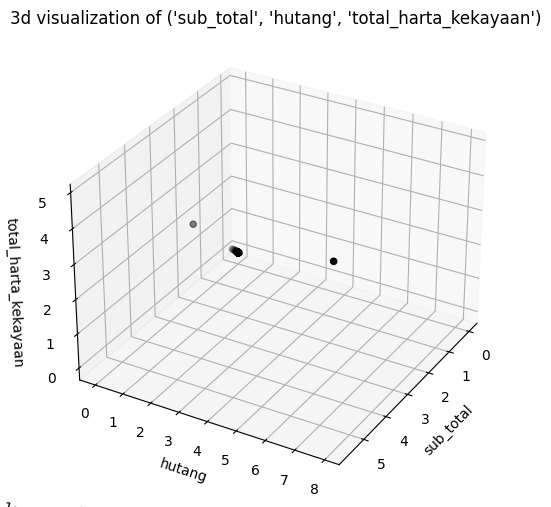

In [21]:
clean_df_3d_vis['zeroes'] = 0
pairing_3d = get_numerical_feature_pairs_3d(copy_3d_df_numerical_column)
count = 0
for i in pairing_3d:
  print(count, i)
  visualize_data_3d(clean_df_3d_vis, feature=i, outlier_column= 'zeroes', interactive = False, no_legend = True, hover = 'nama',  title = f"3d visualization of {i}")
  count = count + 1

## Syntetic Data Generation

Data Sintetis akan dibuat dengan 3 langkah utama:
1. Mengambil distribusi data pada tiap kolom dengan menggunakan fit data pada distribusi tertentu menggunakan scipy.stats untuk mendapatkan parameter terbaik distribusi tersebut dan mengetes distribusi dengan parameter terbaik tersebut dengan Kolmogorov-Smirnov test. Distribusi dengan nilai P-Value tertinggi akan dipakai untuk membuat data sintetis sebagai data normal (inliers). Data distribusi yang akan dites ialah normal/gaussian, beta, gamma, skewnorm, uniform dan gaussian_kde. Dipilihnya distribusi tersebut adalah karena distribusi tersebut merupakan parameter untuk synthetizer Gaussian Copula pada library Synthetic Data Vault (SDV).
2. Melakukan sintetis data normal dengan menggunakan library Synthetic Data Vauld. Digunakan gaussian copula synthetizer yang mana akan membuat model data generation dengan melihat distribusi data input (sebagai parameter) dan Covariance Matrixnya.
3. Melakukan sintetis data outlier dengan menggunaan distribusi data uniform pada setiap kolom kecuali subtotal dan total_harta_kekayaan yang nantinya akan dihitung berdasarkan jumlah kolom lainnya.

### Testing Data Distribution Type for Every Column

Disini akan di tes distribusi data untuk setiap fitur numerik kecuali kolom sub_total dan total_harta_kekayaan karena kedua kolom dapat dihitung dari kolom lain

harta_tanah_dan_bangunan


/usr/local/lib/python3.10/dist-packages/scipy/stats/_continuous_distns.py:719: RuntimeWarning: invalid value encountered in sqrt
  sk = 2*(b-a)*np.sqrt(a + b + 1) / (a + b + 2) / np.sqrt(a*b)
/usr/local/lib/python3.10/dist-packages/scipy/optimize/_minpack_py.py:177: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


COLUMN: harta_tanah_dan_bangunan P_VALUE: beta, 0.000934447221284085
COLUMN: harta_tanah_dan_bangunan P_VALUE: norm, 6.894128427026e-16
COLUMN: harta_tanah_dan_bangunan P_VALUE: truncnorm, 2.021873671670031e-36
COLUMN: harta_tanah_dan_bangunan P_VALUE: gamma, 0.0
COLUMN: harta_tanah_dan_bangunan P_VALUE: uniform, 8.889652210390623e-118
COLUMN: harta_tanah_dan_bangunan P_VALUE: gaussian_kde, 1.247805517679719e-06
Best fit for harta_tanah_dan_bangunan: beta with parameters (0.5673356627841937, 23.050264455958704, -1.1084728361500486e-12, 544152405748.29944)
harta_alat_transportasi_dan_mesin
COLUMN: harta_alat_transportasi_dan_mesin P_VALUE: beta, 0.0012318290697708324
COLUMN: harta_alat_transportasi_dan_mesin P_VALUE: norm, 2.8231988658574953e-09
COLUMN: harta_alat_transportasi_dan_mesin P_VALUE: truncnorm, 0.00015357589347577368
COLUMN: harta_alat_transportasi_dan_mesin P_VALUE: gamma, 0.0
COLUMN: harta_alat_transportasi_dan_mesin P_VALUE: uniform, 2.001362455428658e-83
COLUMN: harta_al

/usr/local/lib/python3.10/dist-packages/scipy/stats/_continuous_distns.py:9369: RuntimeWarning: invalid value encountered in power
  g1 = mu3 / np.power(mu2, 1.5)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_distn_infrastructure.py:2752: RuntimeWarning: invalid value encountered in sqrt
  Shat = sqrt(mu2hat / mu2)


COLUMN: harta_kas_dan_setara_kas P_VALUE: gamma, 0.0
COLUMN: harta_kas_dan_setara_kas P_VALUE: uniform, 8.556711009645248e-89
COLUMN: harta_kas_dan_setara_kas P_VALUE: gaussian_kde, 4.284917060711488e-06
Best fit for harta_kas_dan_setara_kas: beta with parameters (0.5420271635104901, 68.5416577502705, 3313044.9999999995, 554771508772.6316)
harta_lainnya
COLUMN: harta_lainnya P_VALUE: beta, 1.5611767672428506e-72
COLUMN: harta_lainnya P_VALUE: norm, 7.955712528971222e-27
COLUMN: harta_lainnya P_VALUE: truncnorm, 5.10895042813914e-102
COLUMN: harta_lainnya P_VALUE: gamma, 2.0917825888998686e-66
COLUMN: harta_lainnya P_VALUE: uniform, 7.621367503696304e-160
COLUMN: harta_lainnya P_VALUE: gaussian_kde, 1.0848188296747393e-14
Best fit for harta_lainnya: gaussian_kde with parameters params
hutang
COLUMN: hutang P_VALUE: beta, 3.352838255794631e-36
COLUMN: hutang P_VALUE: norm, 2.324011081600397e-30
COLUMN: hutang P_VALUE: truncnorm, 4.0264033320597366e-151
COLUMN: hutang P_VALUE: gamma, 4.93

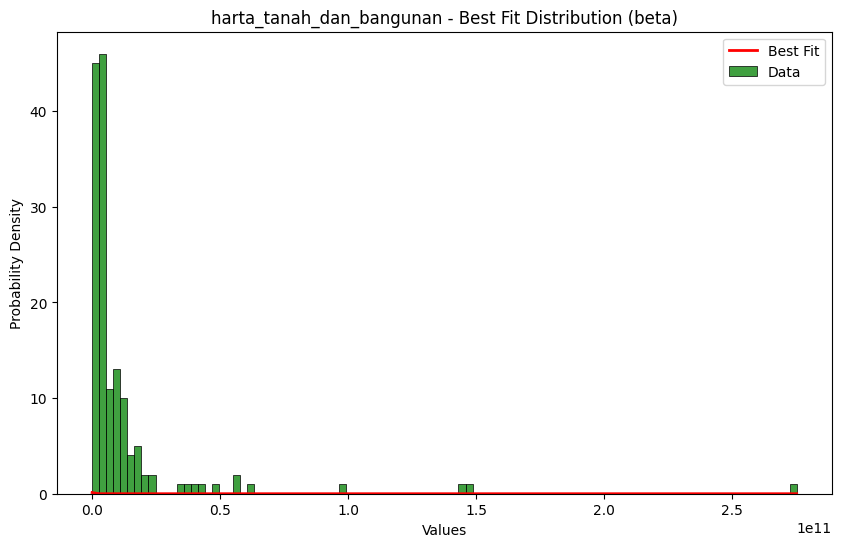

harta_alat_transportasi_dan_mesin


<Figure size 1000x600 with 0 Axes>

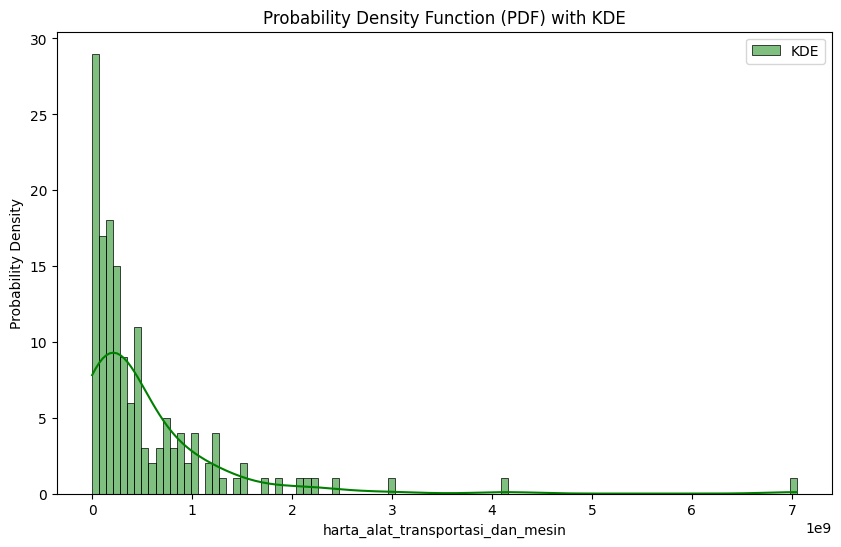

harta_bergerak_lainnya
(0.7783332172424653, 907.3018095420907, -7.93895474978735e-18, 201659464266.98557)


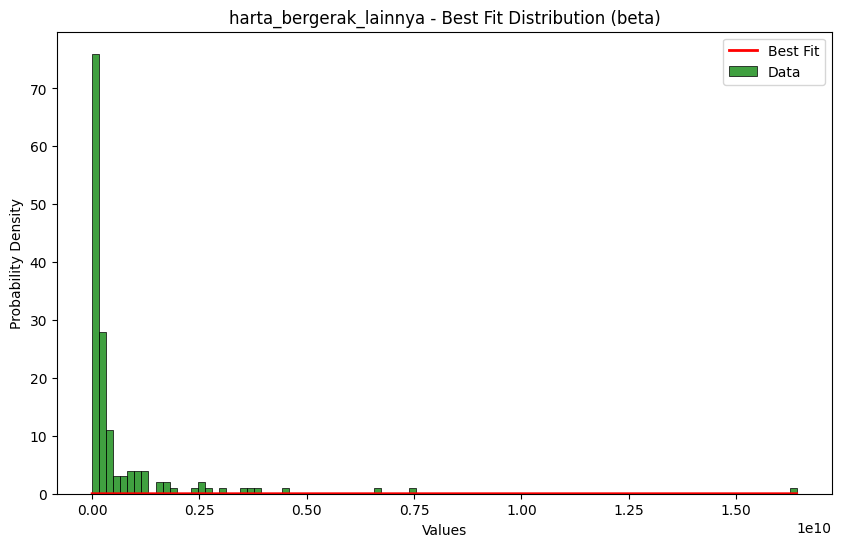

surat_berharga


<Figure size 1000x600 with 0 Axes>

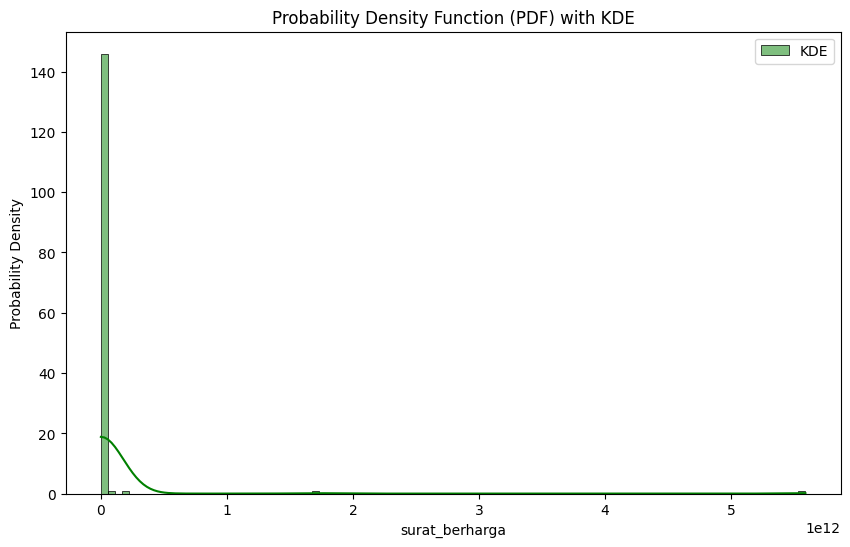

harta_kas_dan_setara_kas
(0.5420271635104901, 68.5416577502705, 3313044.9999999995, 554771508772.6316)


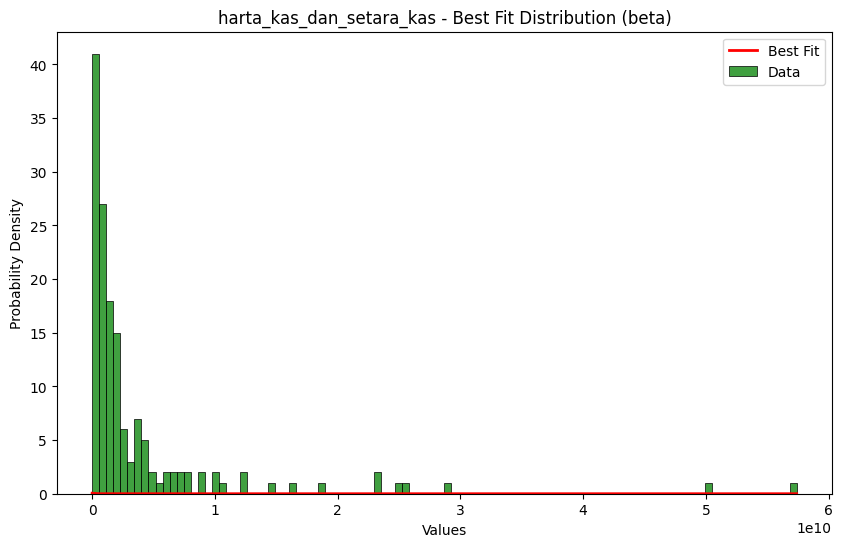

harta_lainnya


<Figure size 1000x600 with 0 Axes>

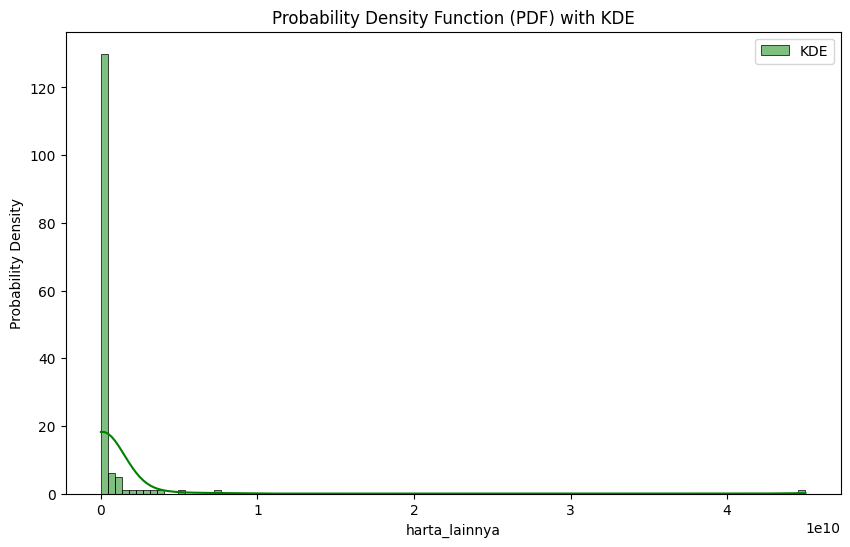

hutang


<Figure size 1000x600 with 0 Axes>

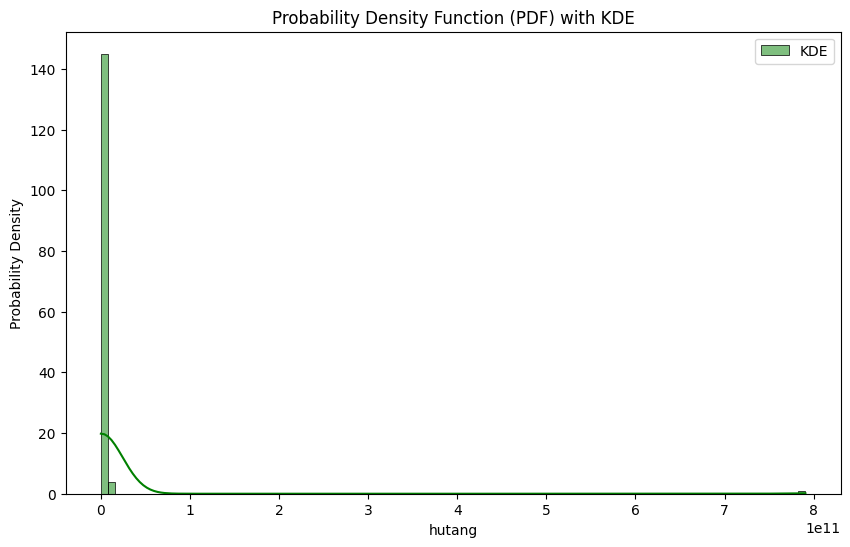

Fitur: harta_tanah_dan_bangunan, Best Dist: beta, param:(0.5673356627841937, 23.050264455958704, -1.1084728361500486e-12, 544152405748.29944)
Fitur: harta_alat_transportasi_dan_mesin, Best Dist: gaussian_kde, param:params
Fitur: harta_bergerak_lainnya, Best Dist: beta, param:(0.7783332172424653, 907.3018095420907, -7.93895474978735e-18, 201659464266.98557)
Fitur: surat_berharga, Best Dist: gaussian_kde, param:params
Fitur: harta_kas_dan_setara_kas, Best Dist: beta, param:(0.5420271635104901, 68.5416577502705, 3313044.9999999995, 554771508772.6316)
Fitur: harta_lainnya, Best Dist: gaussian_kde, param:params
Fitur: hutang, Best Dist: gaussian_kde, param:params


In [22]:
multivariate_data = copy.deepcopy(clean_df)
multivariate_data = multivariate_data.drop(remove_df_col_list, axis=1)
multivariate_data = multivariate_data.drop(['sub_total', 'total_harta_kekayaan'], axis=1)

multivariate_data
distribution_list = [stats.beta, stats.norm, stats.truncnorm, stats.gamma, stats.uniform, 'gaussian_kde'] #stats.beta,  there is also gaussian kde but is not here.

best_distribution_fit = KS_test(multivariate_data, distribution_list)

visualize_best_fit_distributions(multivariate_data, best_distribution_fit)

for i in best_distribution_fit:
  print(f'Fitur: {i[0]}, Best Dist: {i[1]}, param:{i[2]}')


### Syntetize Normal Data by Using SDV


{'columns': {'harta_tanah_dan_bangunan': {'sdtype': 'numerical'},
  'harta_alat_transportasi_dan_mesin': {'sdtype': 'numerical'},
  'harta_bergerak_lainnya': {'sdtype': 'numerical'},
  'surat_berharga': {'sdtype': 'numerical'},
  'harta_kas_dan_setara_kas': {'sdtype': 'id'},
  'harta_lainnya': {'sdtype': 'numerical'},
  'hutang': {'sdtype': 'numerical'},
  'index': {'sdtype': 'unknown', 'pii': True}},
 'METADATA_SPEC_VERSION': 'SINGLE_TABLE_V1',
 'primary_key': 'harta_kas_dan_setara_kas'}

/usr/local/lib/python3.10/dist-packages/sdv/metadata/single_table.py:504: UserWarning: There is an existing primary key 'harta_kas_dan_setara_kas'. This key will be removed.
  warnings.warn(


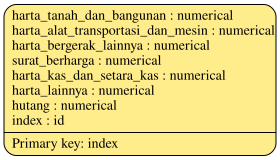

In [23]:
df_prep_syn = copy.deepcopy(multivariate_data)
df_prep_syn['index'] = range(len(df_prep_syn))

metadata = SingleTableMetadata()

metadata.detect_from_dataframe(data=df_prep_syn)

python_dict_abc = metadata.to_dict()
display(python_dict_abc)

metadata.update_column(
    column_name='index',
    sdtype='id',
    regex_format='[0-9]*')
metadata.set_primary_key(column_name='index')

metadata.update_column(
    column_name='harta_kas_dan_setara_kas',
    sdtype='numerical',
    computer_representation='Int64')

metadata.visualize()

In [24]:
synthesizer = GaussianCopulaSynthesizer(metadata, numerical_distributions={
        'harta_tanah_dan_bangunan': 'beta',
        'harta_alat_transportasi_dan_mesin': 'gaussian_kde',
        'harta_bergerak_lainnya': 'beta',
        'surat_berharga': 'gaussian_kde',
        'harta_kas_dan_setara_kas': 'beta',
        'harta_lainnya': 'gaussian_kde',
        'hutang': 'gaussian_kde',
    }, default_distribution='gaussian_kde')
synthesizer.fit(df_prep_syn)

synthetic_data = synthesizer.sample(num_rows=len(df_prep_syn))

In [25]:
# 1. perform basic validity checks
diagnostic = run_diagnostic(df_prep_syn, synthetic_data, metadata)

# 2. measure the statistical similarity
quality_report = evaluate_quality(df_prep_syn, synthetic_data, metadata)

display(quality_report.get_details(property_name='Column Shapes'))

# 3. plot the data
for i in list(df_prep_syn.columns):
  if i == 'index': continue
  fig = get_column_plot(
      real_data=df_prep_syn,
      synthetic_data=synthetic_data,
      metadata=metadata,
      column_name=i
  )

  fig.show()

Generating report ...
(2/2) Evaluating Data Structure: : 100%|██████████| 1/1 [00:00<00:00, 86.63it/s]

Overall Score: 97.92%

Properties:
- Data Validity: 95.83%
- Data Structure: 100.0%
Generating report ...
(2/2) Evaluating Column Pair Trends: : 100%|██████████| 28/28 [00:00<00:00, 52.75it/s]

Overall Score: 80.61%

Properties:
- Column Shapes: 73.14%
- Column Pair Trends: 88.07%


,Column,Metric,Score
0,harta_tanah_dan_bangunan,KSComplement,0.800000
1,harta_alat_transportasi_dan_mesin,KSComplement,0.886667
2,harta_bergerak_lainnya,KSComplement,0.800000
3,surat_berharga,KSComplement,0.493333
4,harta_kas_dan_setara_kas,KSComplement,0.860000
5,harta_lainnya,KSComplement,0.673333
6,hutang,KSComplement,0.606667


In [26]:
feature_pairs = get_numerical_feature_pairs(list(df_prep_syn.columns))
for i in feature_pairs:
  if i[0] == 'index' or i[1] == 'index': continue
  fig = get_column_pair_plot(
      real_data=df_prep_syn,
      synthetic_data=synthetic_data,
      metadata=metadata,
      column_names=list(i)
  )

  fig.show()

In [27]:
synthetic_data['sub_total'] = (synthetic_data['harta_tanah_dan_bangunan']
                               + synthetic_data['harta_alat_transportasi_dan_mesin']
                               + synthetic_data['harta_bergerak_lainnya']
                               + synthetic_data['surat_berharga']
                               + synthetic_data['harta_kas_dan_setara_kas']
                               + synthetic_data['harta_lainnya'])
synthetic_data['total_harta_kekayaan'] = synthetic_data['sub_total'] - synthetic_data['hutang']

In [28]:
synthetic_data

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,index,sub_total,total_harta_kekayaan
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,0,78378025388,71037836756
1,23521972280,664482985,102081724,0,377192380,0,0,1,24665729369,24665729369
2,4838560268,0,358116888,0,1537818804,0,0,2,6734495960,6734495960
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,3,36566313804,28059014173
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,4,202341959717,198891458924
...,...,...,...,...,...,...,...,...,...,...
145,5065585197,0,80557,75648247294,35685297,1711003929,0,35,82460602274,82460602274
146,12726805751,461494761,734497149,81644916221,1317205407,0,33220730756,36,96884919289,63664188533
147,6259959326,1052235132,76328006,0,1773138495,0,0,37,9161660959,9161660959
148,3209766171,100862215,440339063,9517681787,1976646461,123636925,0,38,15368932622,15368932622


In [29]:
normal_synthetic_data = copy.deepcopy(synthetic_data)
normal_synthetic_data = normal_synthetic_data.drop('index', axis=1)
normal_synthetic_data

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924
...,...,...,...,...,...,...,...,...,...
145,5065585197,0,80557,75648247294,35685297,1711003929,0,82460602274,82460602274
146,12726805751,461494761,734497149,81644916221,1317205407,0,33220730756,96884919289,63664188533
147,6259959326,1052235132,76328006,0,1773138495,0,0,9161660959,9161660959
148,3209766171,100862215,440339063,9517681787,1976646461,123636925,0,15368932622,15368932622


In [30]:
real_numerical_data = copy.deepcopy(clean_df)
real_numerical_data = real_numerical_data.drop(remove_df_col_list, axis=1)
real_numerical_data

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan
0,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000
1,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000
2,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072
3,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532
4,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000
...,...,...,...,...,...,...,...,...,...
145,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513
146,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339
147,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250
148,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256


##### Visualize Data

In [31]:
data_real = copy.deepcopy(real_numerical_data)
data_synthetic = copy.deepcopy(normal_synthetic_data)
data_real['is_outlier'] = 0
data_synthetic['is_outlier'] = 1

data_combine = pd.concat([data_real, data_synthetic], axis=0, ignore_index=True)
data_combine

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,is_outlier
0,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,0
4,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...
295,5065585197,0,80557,75648247294,35685297,1711003929,82460602274,0,82460602274,1
296,12726805751,461494761,734497149,81644916221,1317205407,0,96884919289,33220730756,63664188533,1
297,6259959326,1052235132,76328006,0,1773138495,0,9161660959,0,9161660959,1
298,3209766171,100862215,440339063,9517681787,1976646461,123636925,15368932622,0,15368932622,1


harta_tanah_dan_bangunan


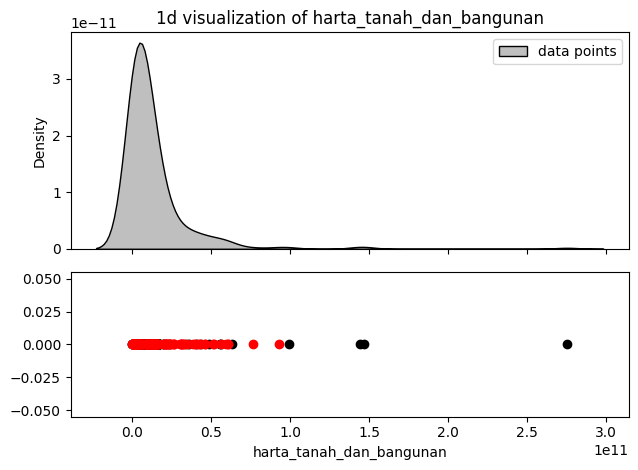

harta_alat_transportasi_dan_mesin


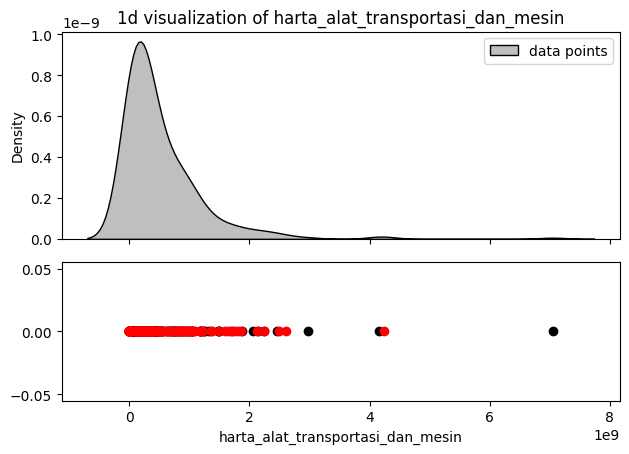

harta_bergerak_lainnya


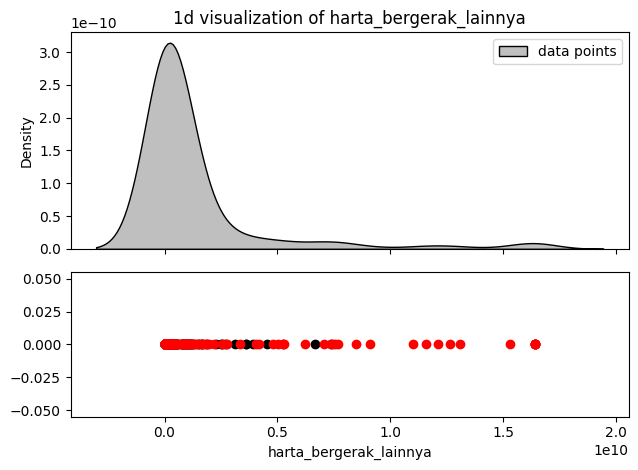

surat_berharga


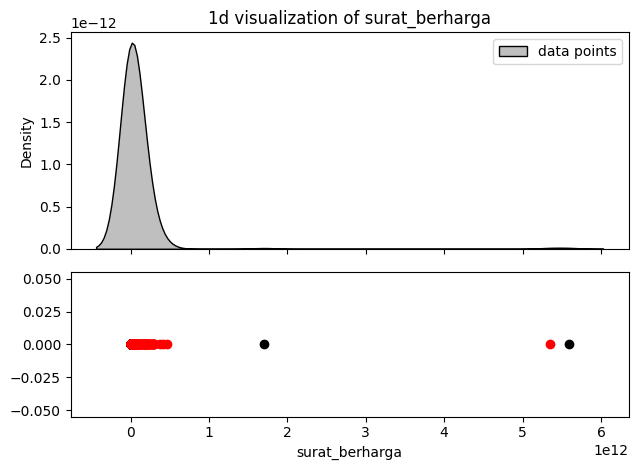

harta_kas_dan_setara_kas


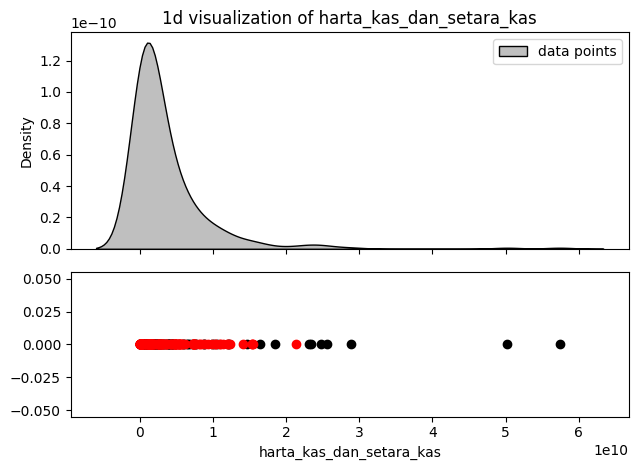

harta_lainnya


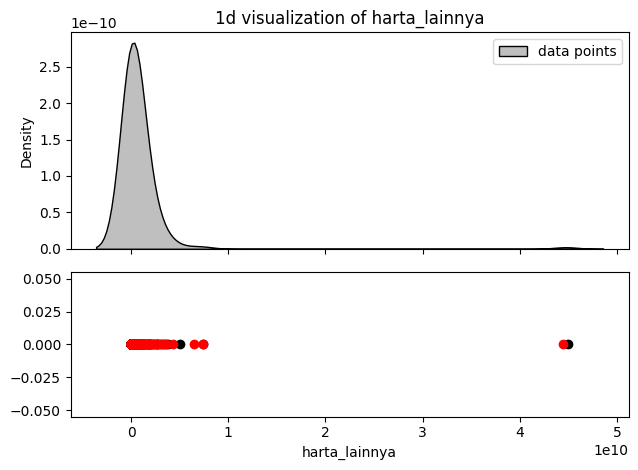

sub_total


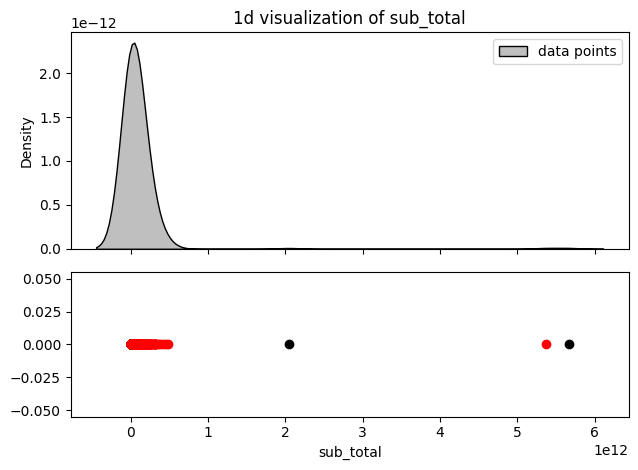

hutang


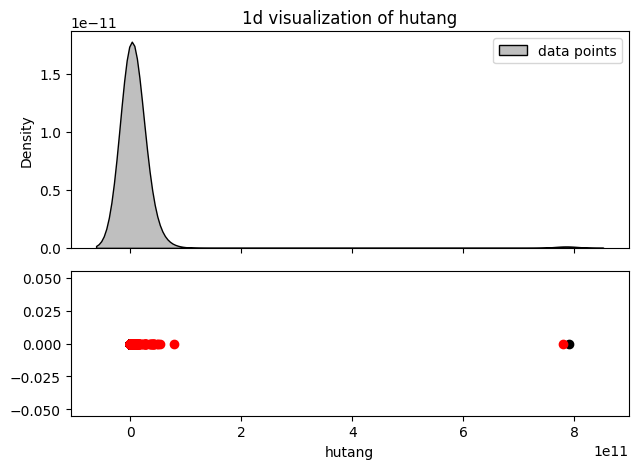

total_harta_kekayaan


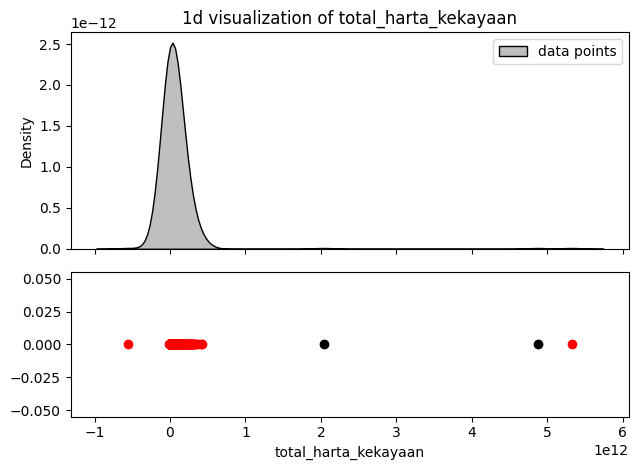

In [32]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(data_combine, feature=i, no_legend=True, title = f"1d visualization of {i}")

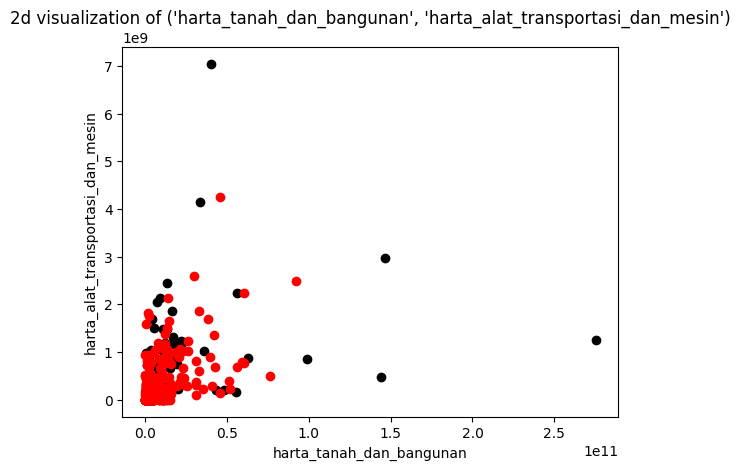

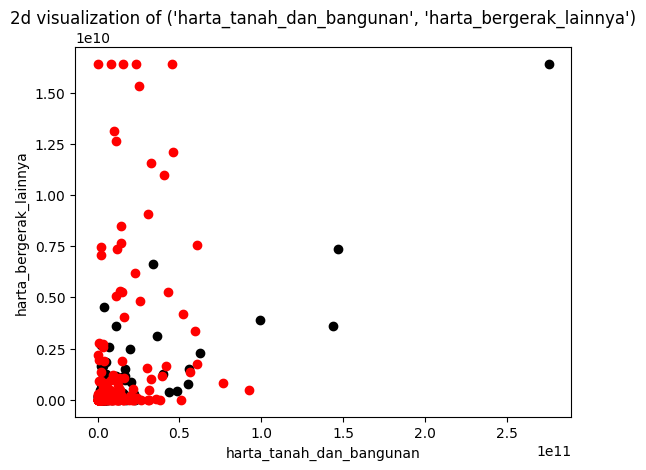

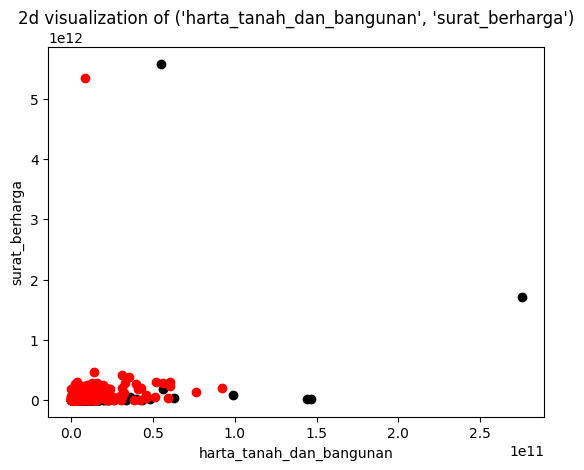

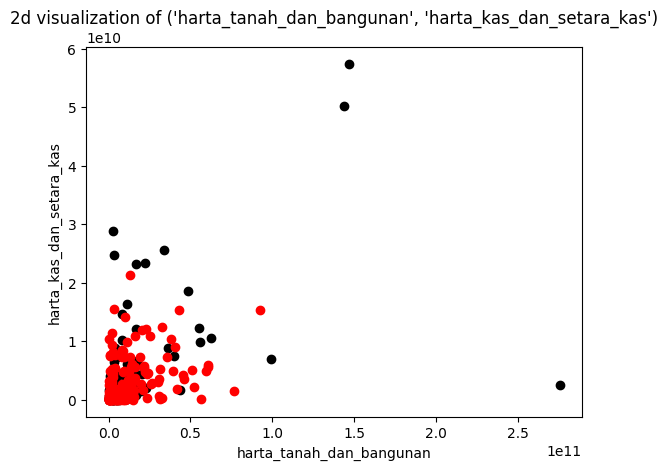

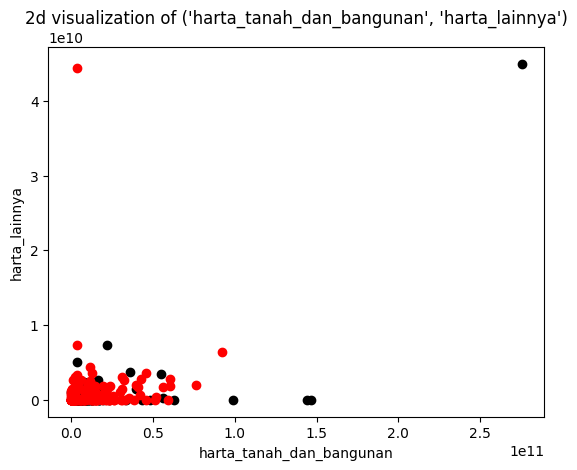

...

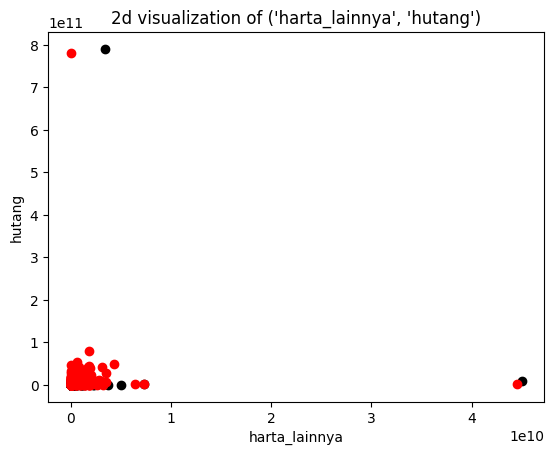

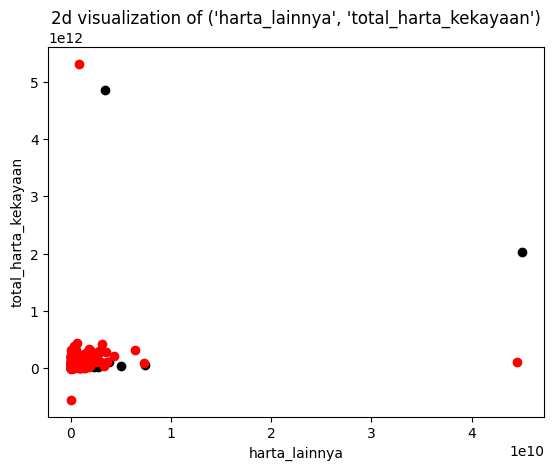

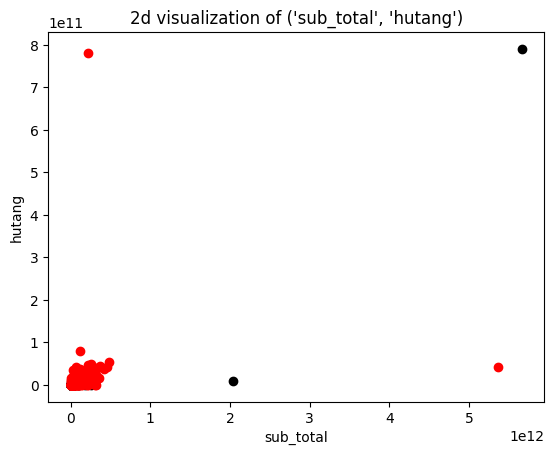

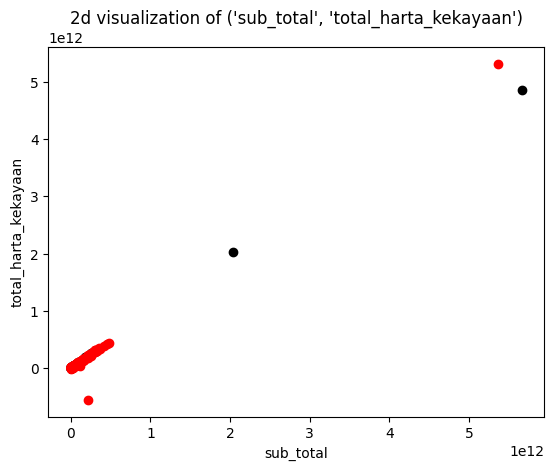

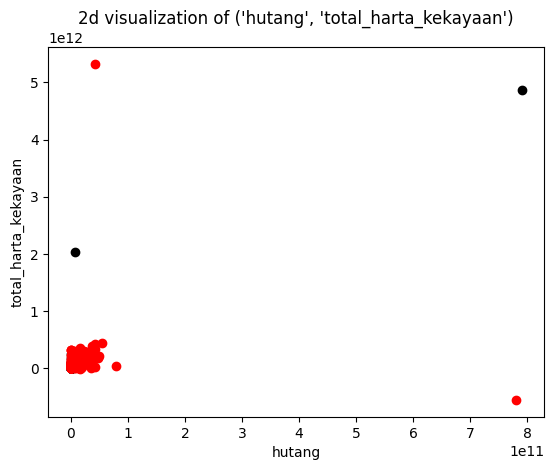

In [33]:
pairing_2d = get_numerical_feature_pairs(copy_2d_df_numerical_column)
for i in pairing_2d:
  visualize_data_2d(data_combine, feature=i, interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

### Synthesize Outlier Data Using Uniform Distribution

In [34]:
from scipy.stats import ks_2samp
def ks_similarity(control_df, synthetic_dfs):
    """
    Calculate the average Kolmogorov-Smirnov (KS) statistic between the control
    DataFrame and a list of synthetic DataFrames for each column.

    Parameters:
    control_df (pd.DataFrame): The control DataFrame.
    synthetic_dfs (list of pd.DataFrame): List of synthetic DataFrames to compare.

    Returns:
    ks_scores (list of float): Average KS statistics for each synthetic DataFrame.
    """

    ks_scores = []

    for synthetic_df in synthetic_dfs:
        # Ensure that both DataFrames have the same columns
        common_columns = control_df.columns.intersection(synthetic_df.columns)
        control_data = control_df[common_columns]
        synthetic_data = synthetic_df[common_columns]

        # Calculate KS statistic for each column
        column_ks_scores = [ks_2samp(control_data[col], synthetic_data[col]).pvalue for col in common_columns]

        # Average KS statistic across all columns
        avg_ks_score = np.mean(column_ks_scores)
        ks_scores.append(avg_ks_score)

    return ks_scores

In [35]:
outlier_percentage = [0.01, 0.05, 0.1, 0.3, 0.5]

lst_data_syn = []
for i in outlier_percentage:
  temp_data = add_outliers_to_dataframe(normal_synthetic_data, real_numerical_data, int(i*len(normal_synthetic_data)))
  lst_data_syn.append(temp_data)

ks_scores = ks_similarity(real_numerical_data, lst_data_syn)

print("KS Similarity Scores:")
for i, score in enumerate(ks_scores):
    print(f"Synthetic DataFrame with Outlier Proportion {outlier_percentage[i]}: {score}")

KS Similarity Scores:
Synthetic DataFrame with Outlier Proportion 0.01: 0.03866829678399553
Synthetic DataFrame with Outlier Proportion 0.05: 0.031300747592757555
Synthetic DataFrame with Outlier Proportion 0.1: 0.009327481686657828
Synthetic DataFrame with Outlier Proportion 0.3: 4.291880701951165e-05
Synthetic DataFrame with Outlier Proportion 0.5: 4.884191888569811e-08


In [36]:
outliers_synthetic_data = lst_data_syn[1]
outliers_synthetic_data

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,is_outlier
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0.0
...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1.0


harta_tanah_dan_bangunan


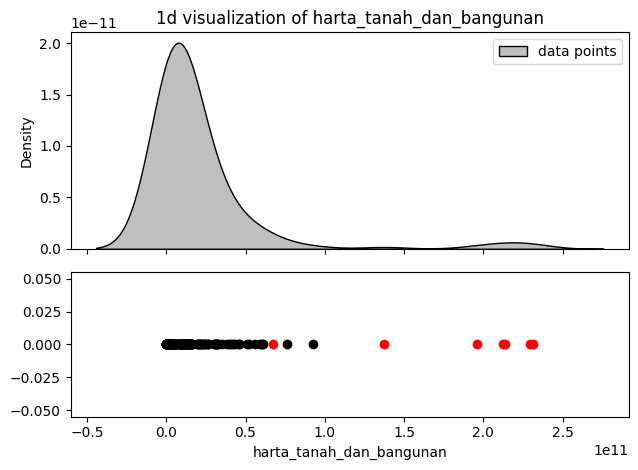

harta_alat_transportasi_dan_mesin


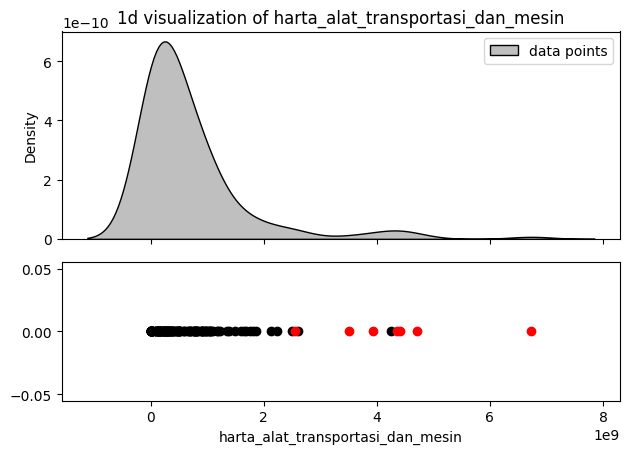

harta_bergerak_lainnya


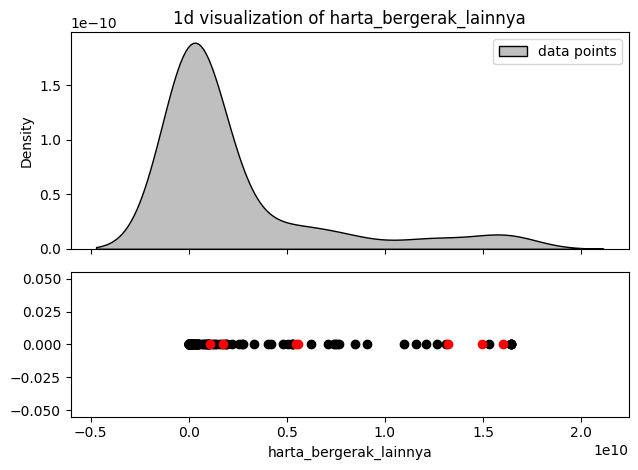

surat_berharga


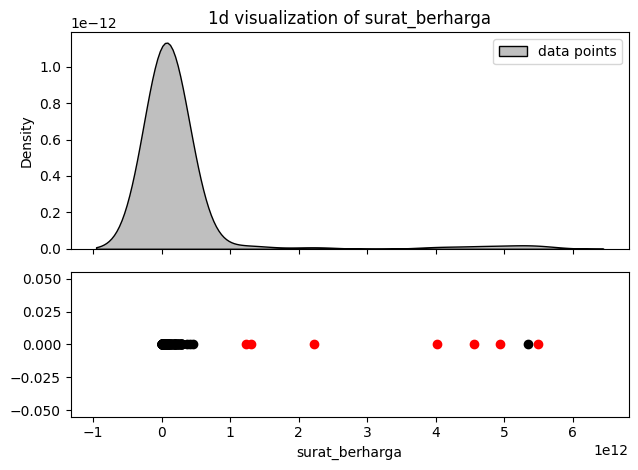

harta_kas_dan_setara_kas


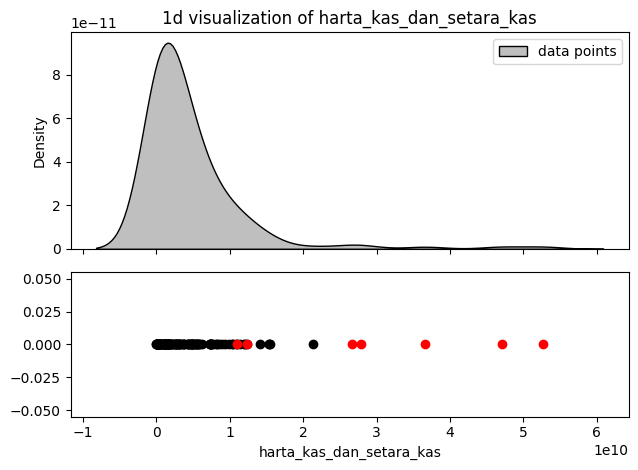

harta_lainnya


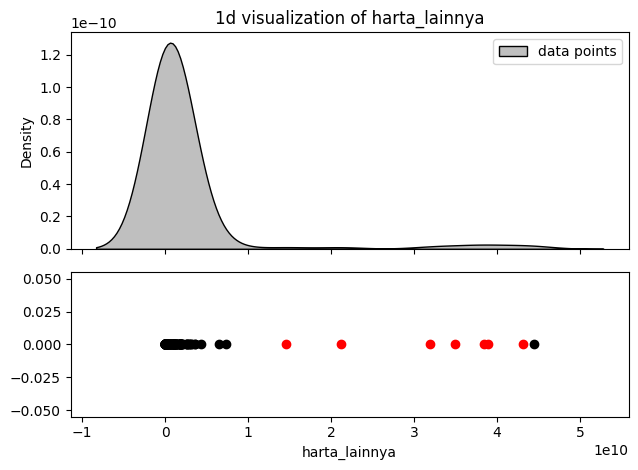

sub_total


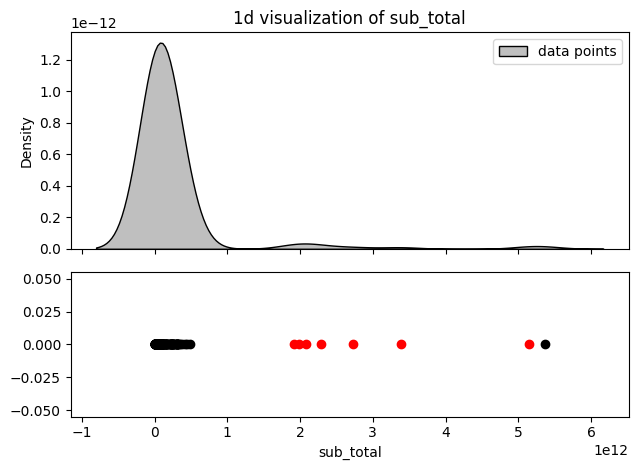

hutang


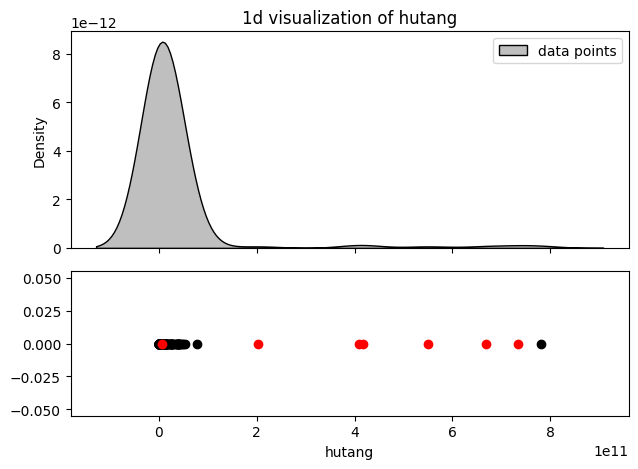

total_harta_kekayaan


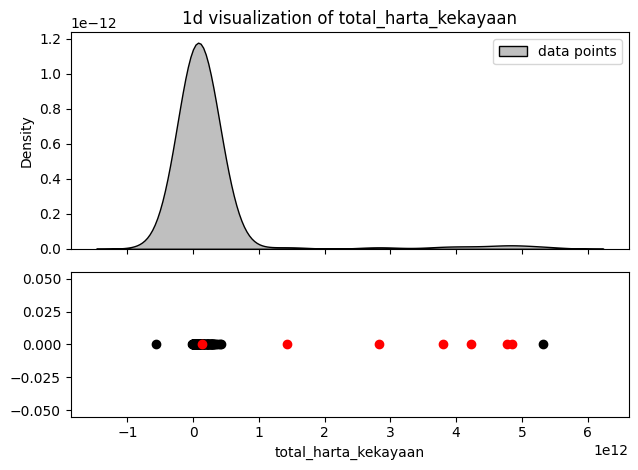

In [37]:
outliers_synthetic_data
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(outliers_synthetic_data, feature=i, no_legend=True, title = f"1d visualization of {i}")

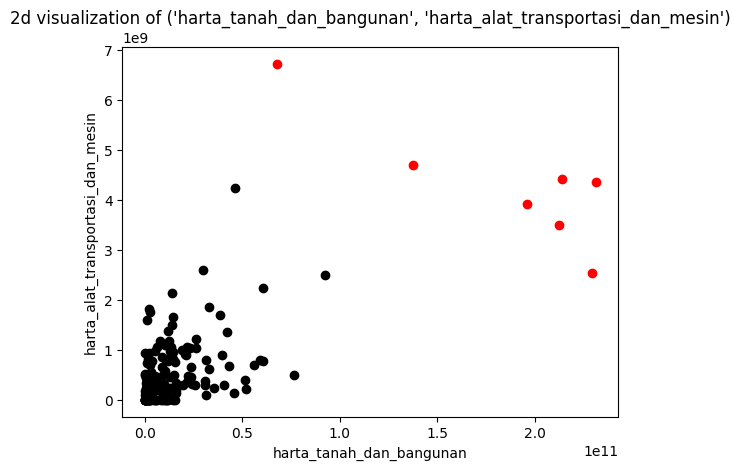

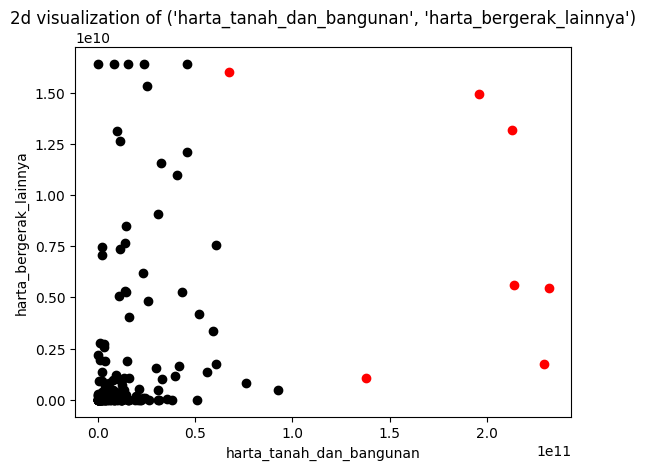

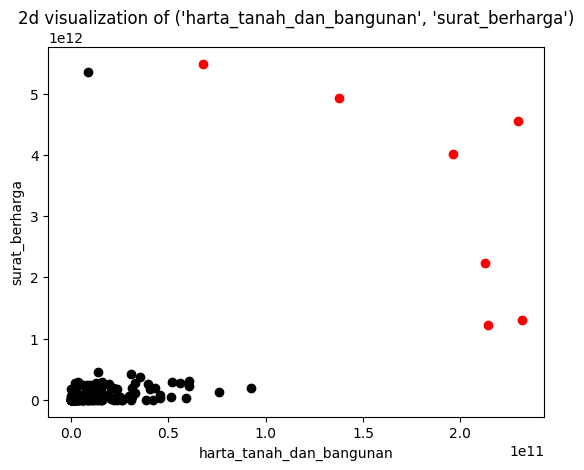

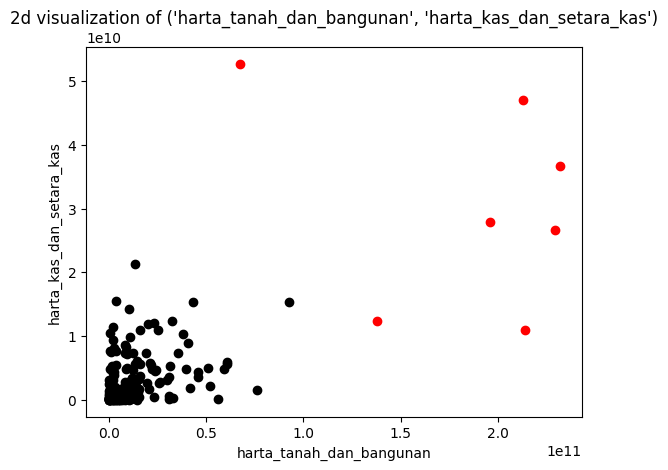

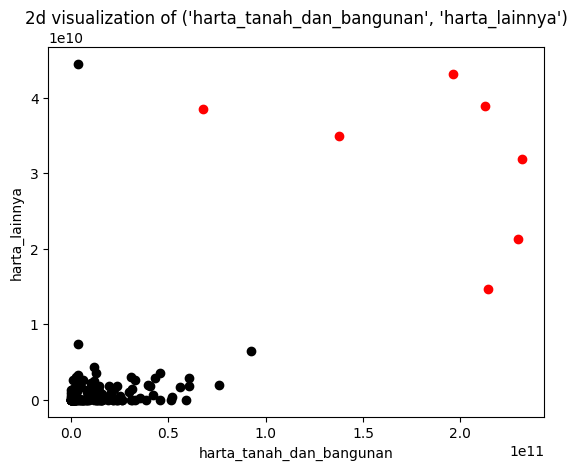

...

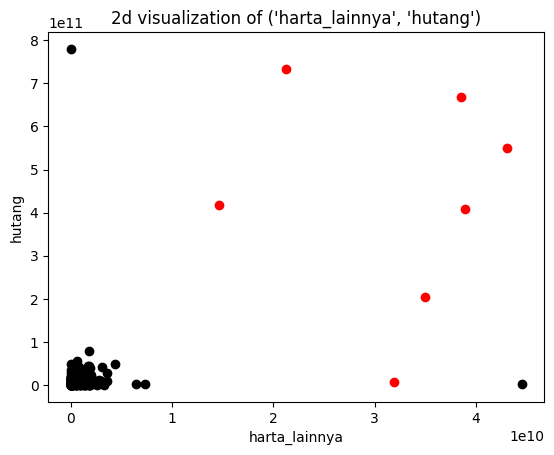

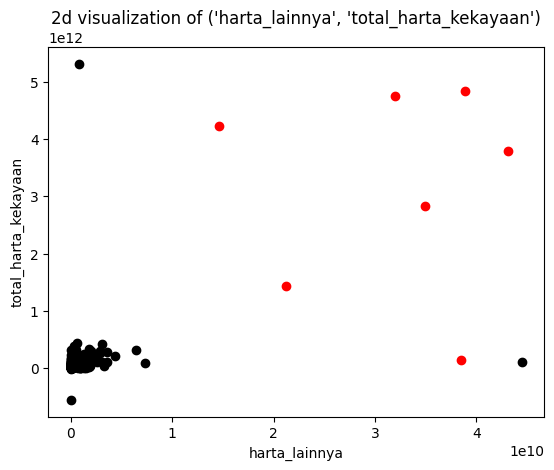

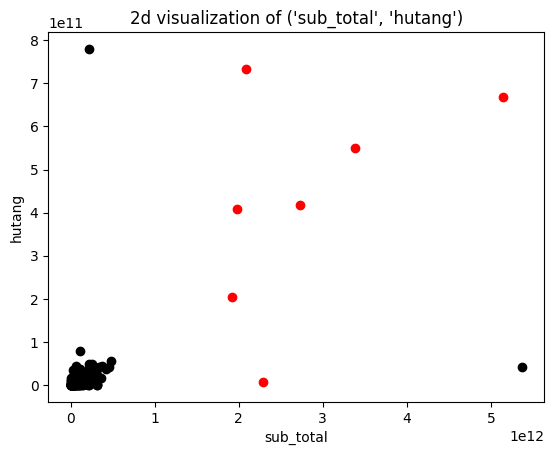

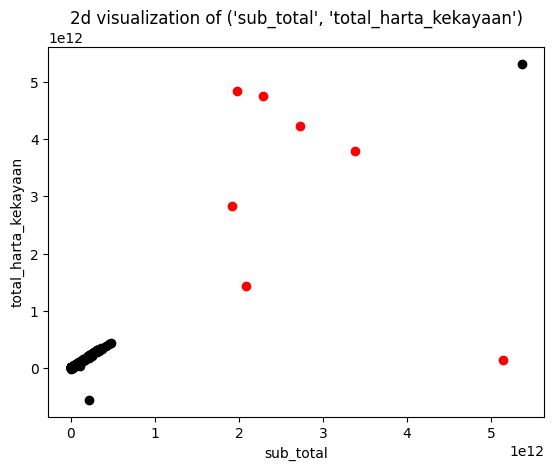

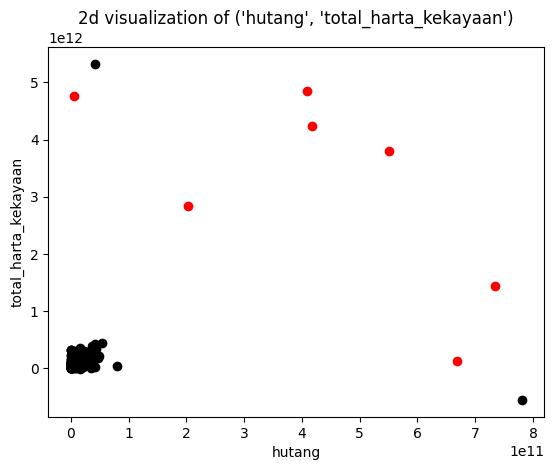

In [38]:
pairing_2d = get_numerical_feature_pairs(copy_2d_df_numerical_column)
for i in pairing_2d:
  visualize_data_2d(outliers_synthetic_data, feature=i, interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

In [39]:
data_real = copy.deepcopy(real_numerical_data)
data_synthetic_all = copy.deepcopy(outliers_synthetic_data)
data_real['is_synthetic'] = 0
data_synthetic_all['is_synthetic'] = 1

data_combine_all = pd.concat([data_real, data_synthetic_all], axis=0, ignore_index=True)
data_combine_all

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,is_synthetic,is_outlier
0,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0,NaN
1,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0,NaN
2,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0,NaN
3,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,0,NaN
4,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...
302,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,2726663319476,416684497096,4233680900532,1,1.0
303,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,2287265733400,5808744620,4767683360696,1,1.0
304,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,5140103890318,668523606218,127837083919,1,1.0
305,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,2083709351737,733806126520,1432621878796,1,1.0


In [40]:
def replace_missing_with_zero(dataframe):
    """
    Replace missing values (NaN) with 0 in a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data with missing values.

    Returns:
    - DataFrame with missing values replaced by 0.
    """
    # Use the fillna method to replace NaN values with 0
    dataframe_filled = dataframe.fillna(0)

    return dataframe_filled

data_combine_all = replace_missing_with_zero(data_combine_all)
data_combine_all

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,is_synthetic,is_outlier
0,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0,0.0
1,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0,0.0
2,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0,0.0
3,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,0,0.0
4,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
302,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,2726663319476,416684497096,4233680900532,1,1.0
303,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,2287265733400,5808744620,4767683360696,1,1.0
304,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,5140103890318,668523606218,127837083919,1,1.0
305,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,2083709351737,733806126520,1432621878796,1,1.0


harta_tanah_dan_bangunan


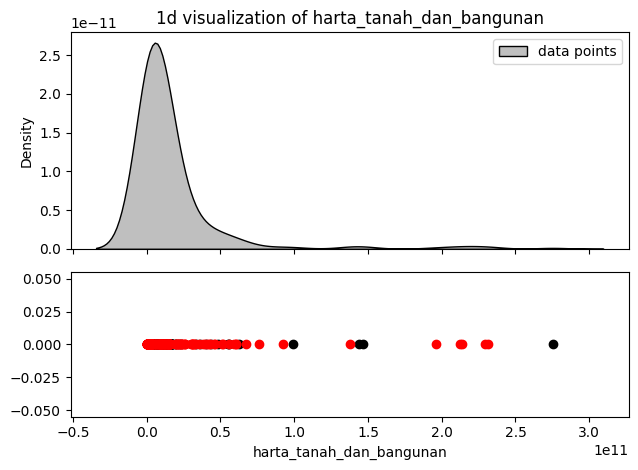

harta_alat_transportasi_dan_mesin


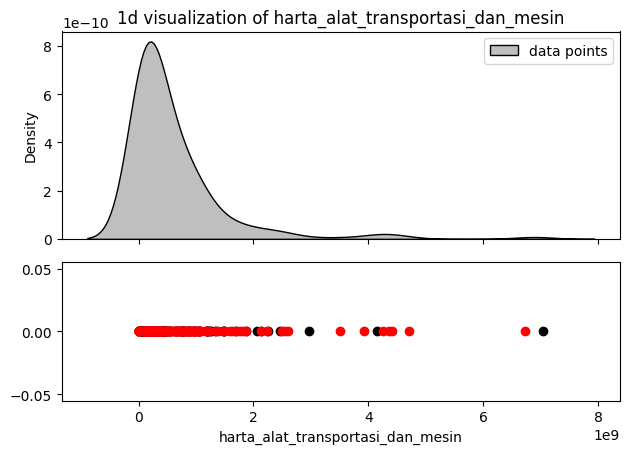

harta_bergerak_lainnya


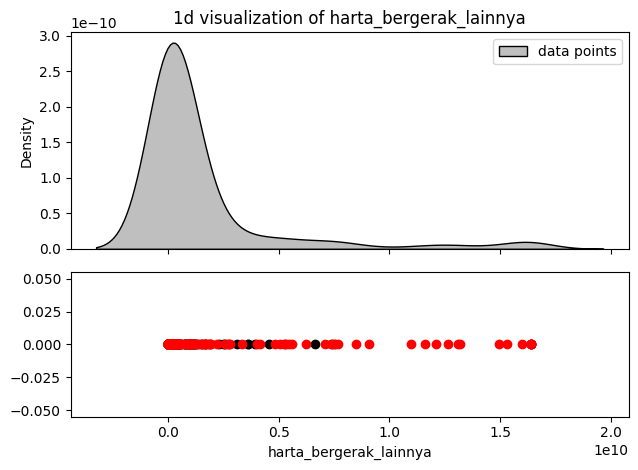

surat_berharga


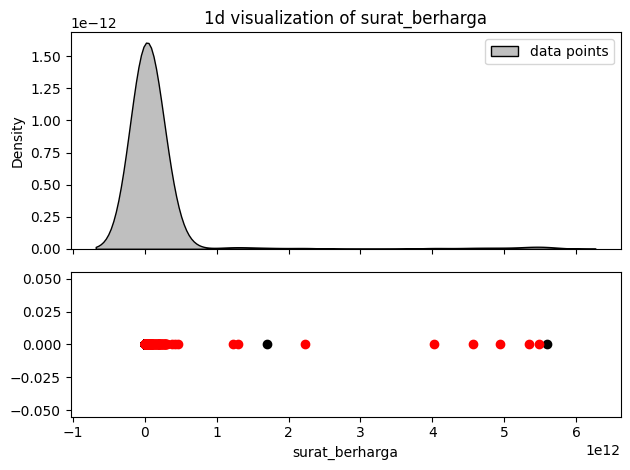

harta_kas_dan_setara_kas


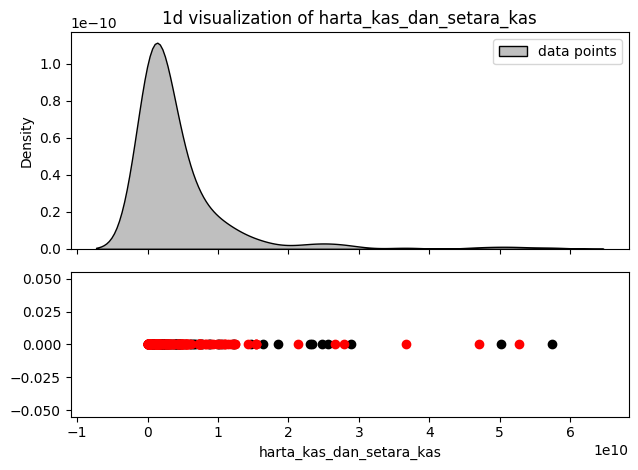

harta_lainnya


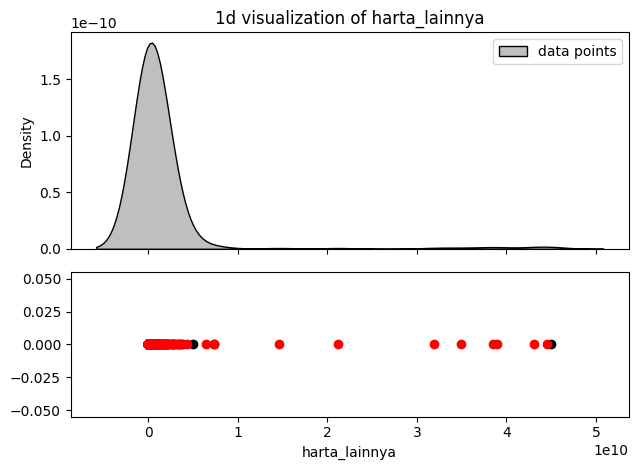

sub_total


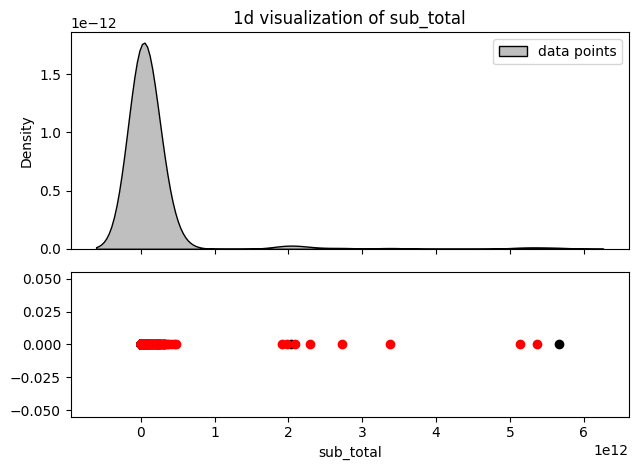

hutang


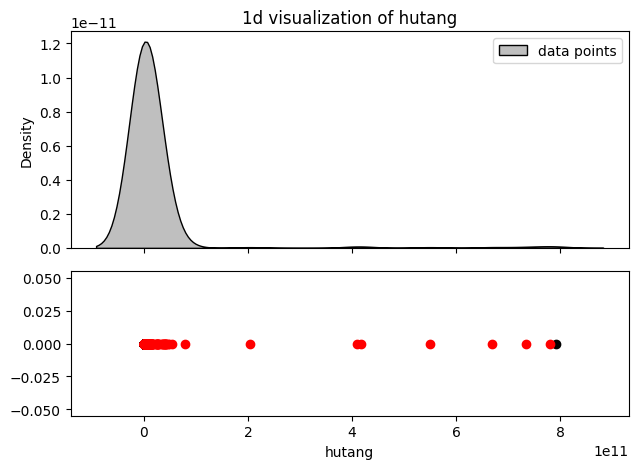

total_harta_kekayaan


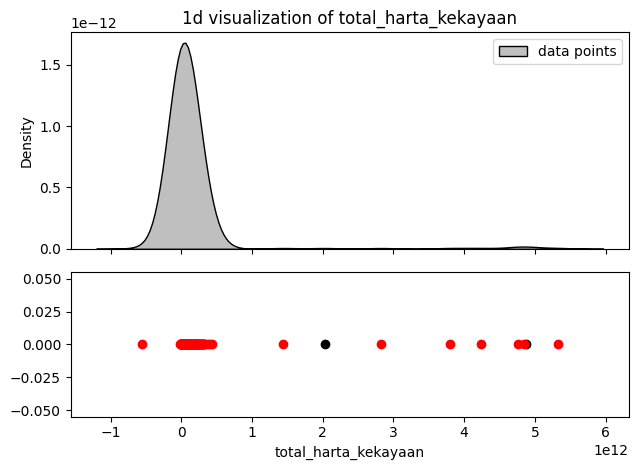

In [41]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(data_combine_all, feature=i, no_legend=True, outlier_column = 'is_synthetic', title = f"1d visualization of {i}")

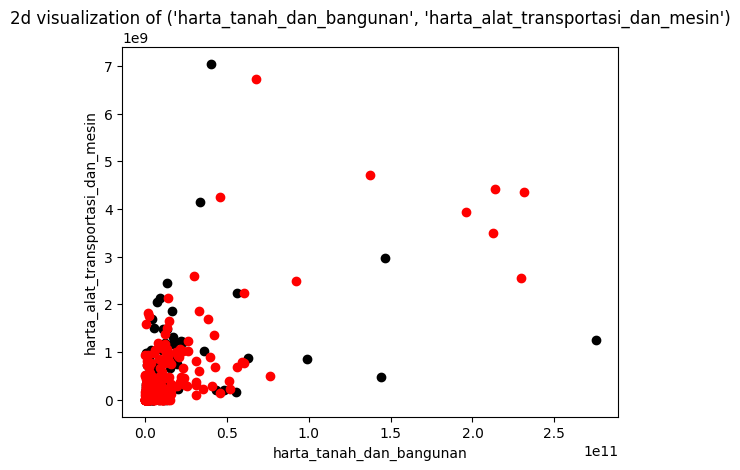

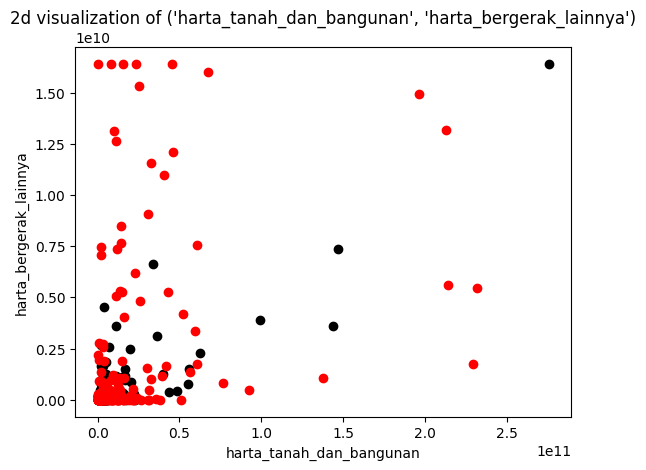

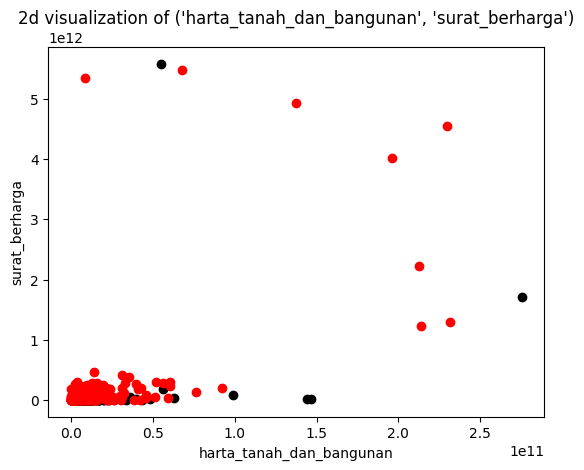

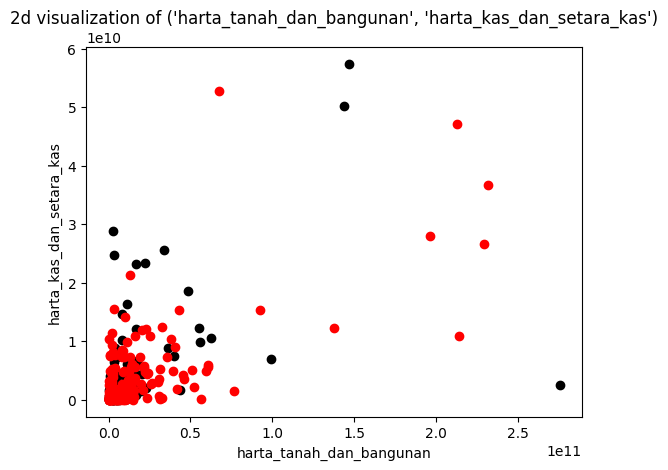

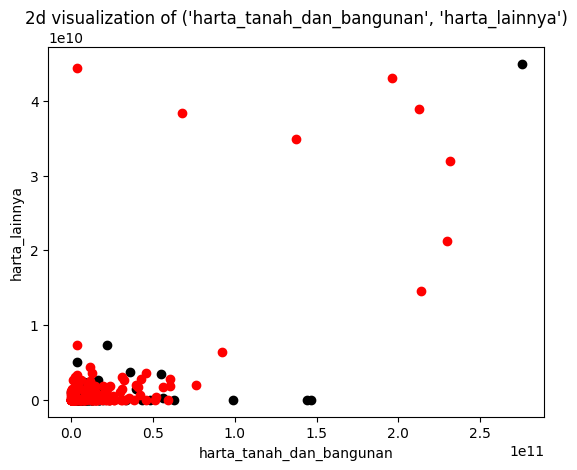

...

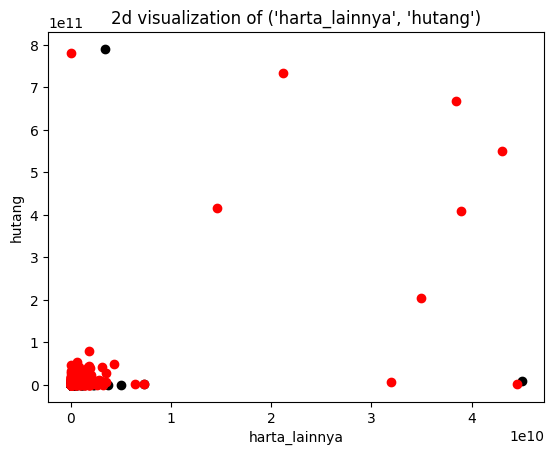

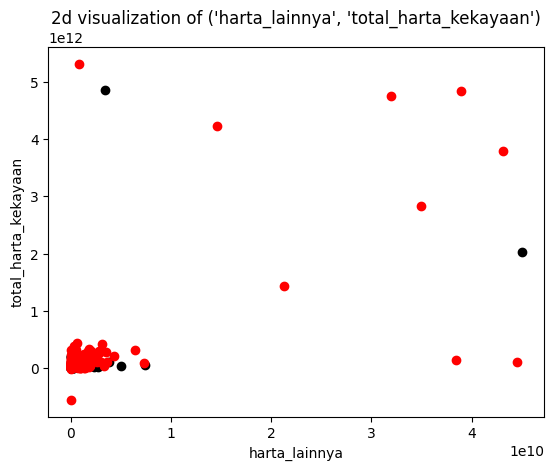

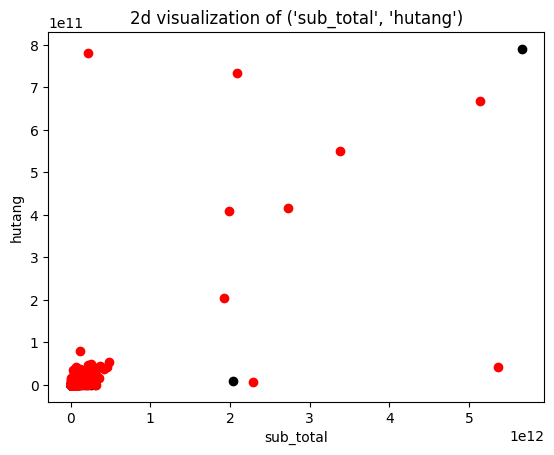

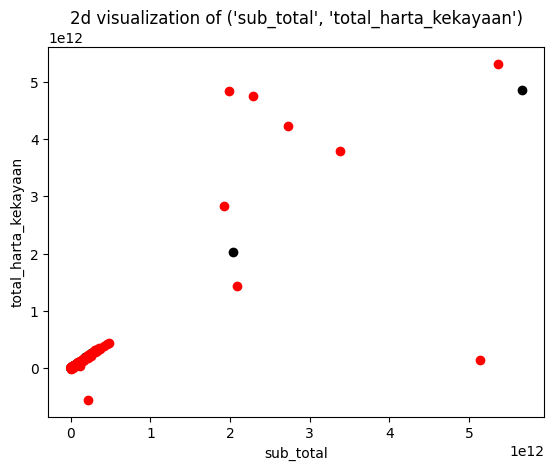

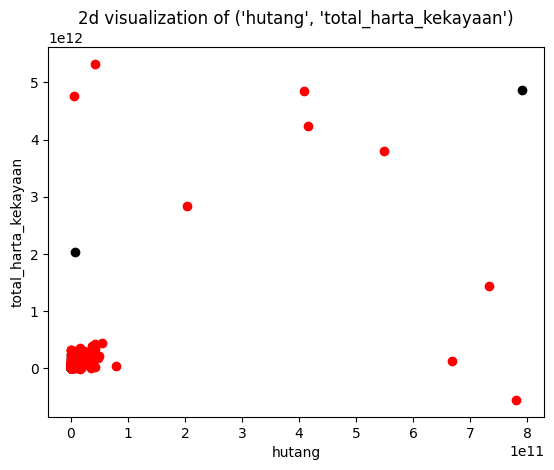

In [42]:
pairing_2d = get_numerical_feature_pairs(copy_2d_df_numerical_column)
for i in pairing_2d:
  visualize_data_2d(data_combine_all, feature=i, interactive = False, outlier_column = 'is_synthetic', no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

##### Check Outlier

harta_tanah_dan_bangunan


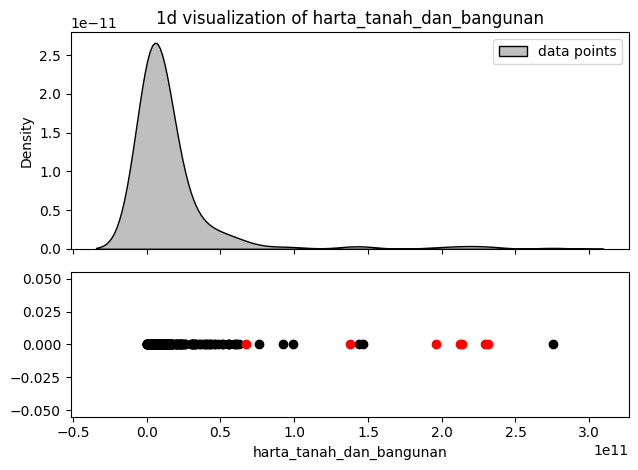

harta_alat_transportasi_dan_mesin


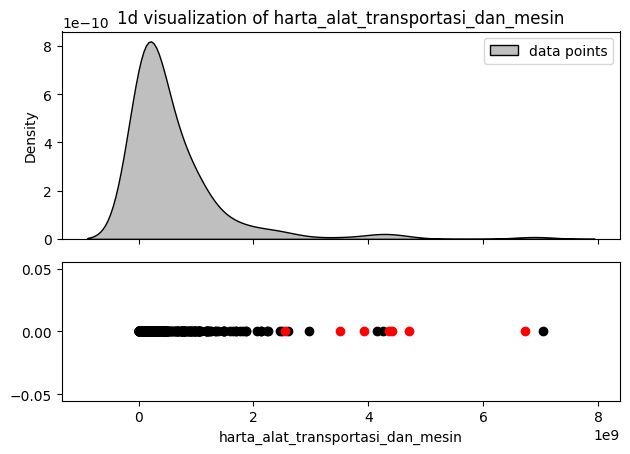

harta_bergerak_lainnya


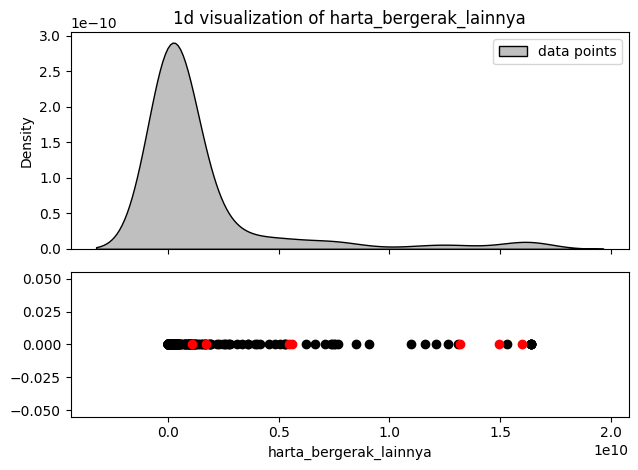

surat_berharga


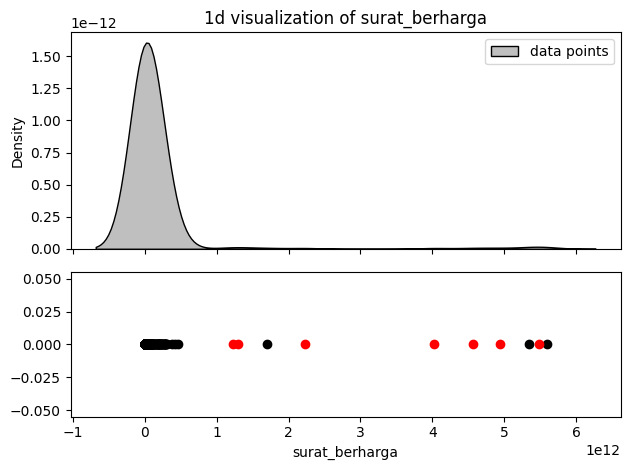

harta_kas_dan_setara_kas


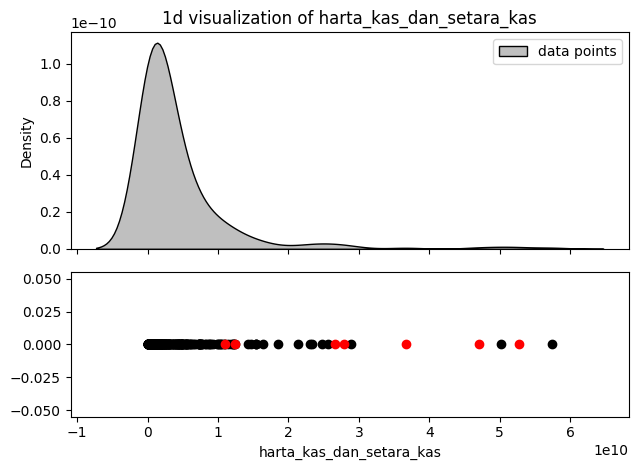

harta_lainnya


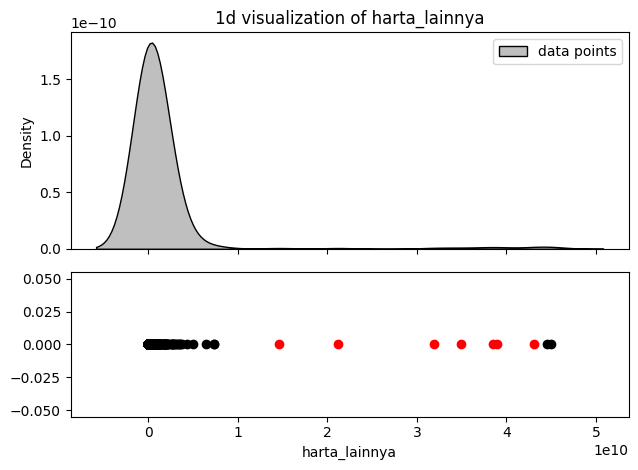

sub_total


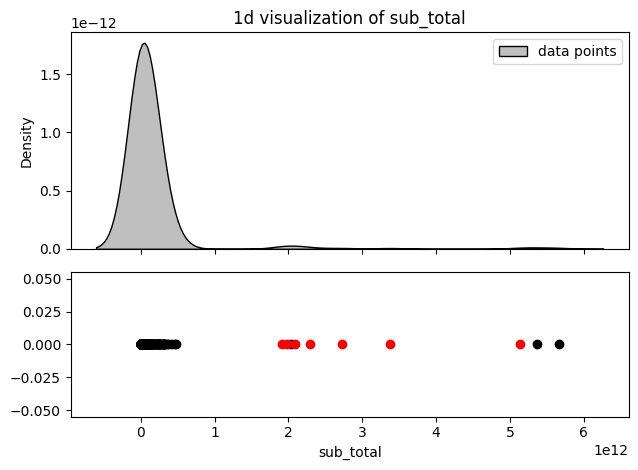

hutang


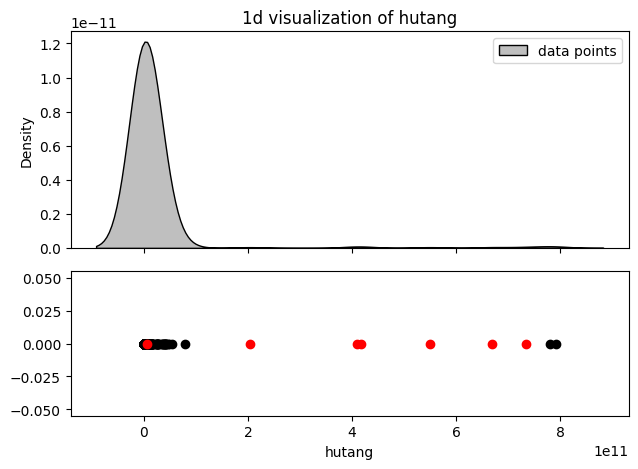

total_harta_kekayaan


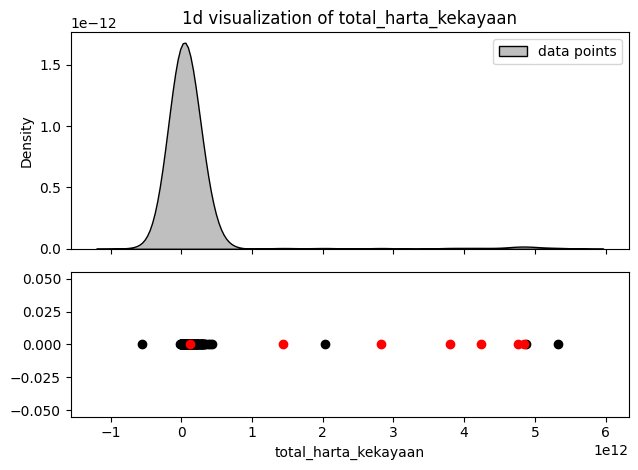

In [43]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(data_combine_all, feature=i, no_legend=True, outlier_column = 'is_outlier', title = f"1d visualization of {i}")

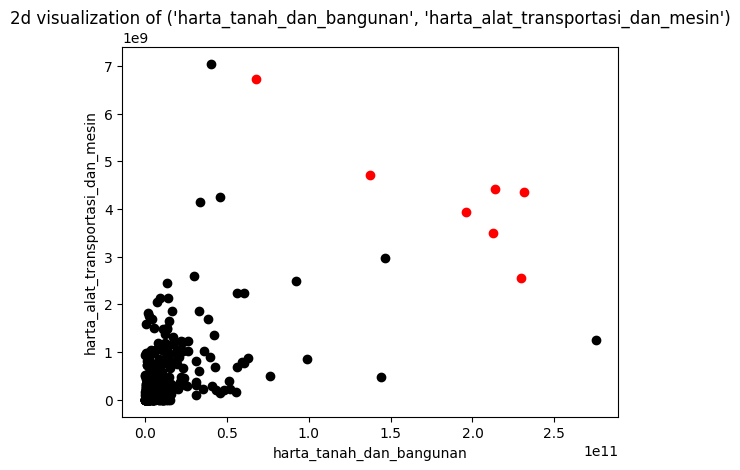

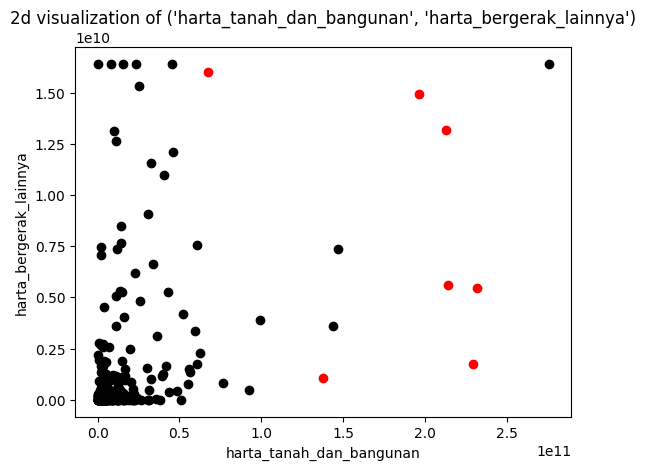

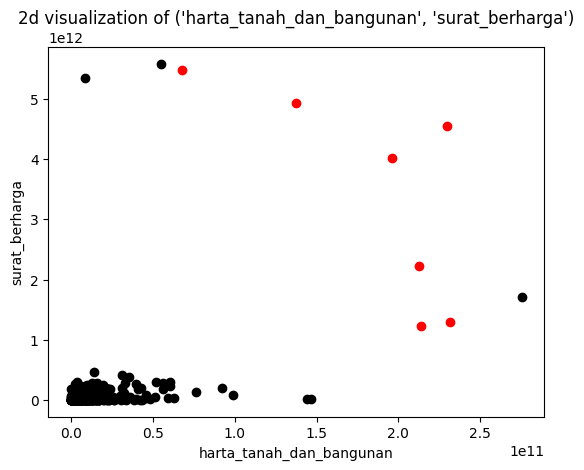

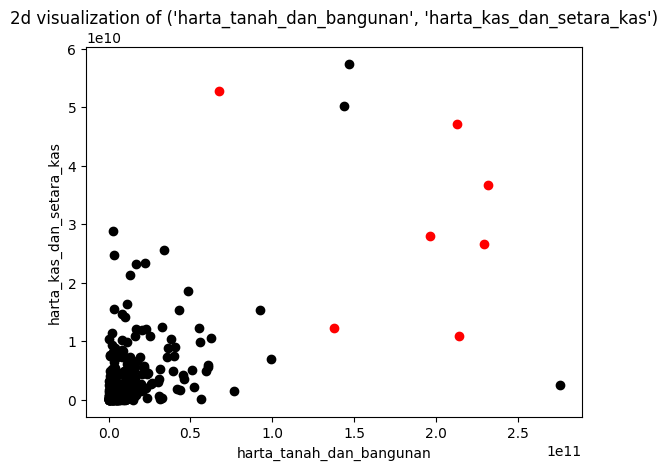

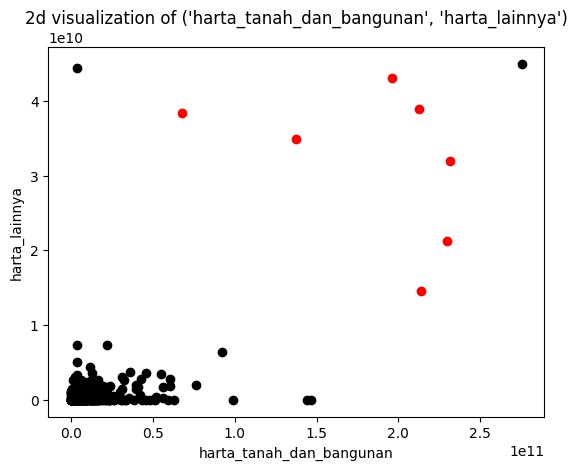

...

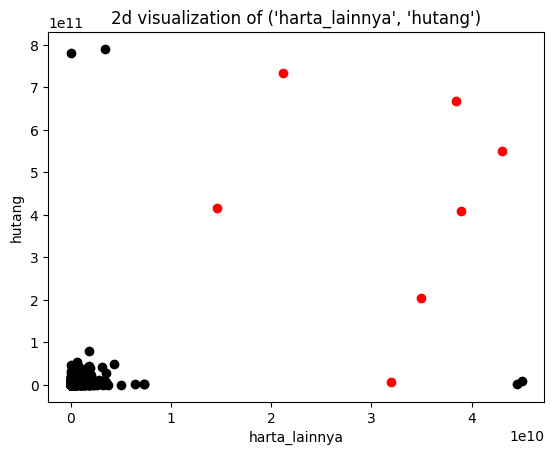

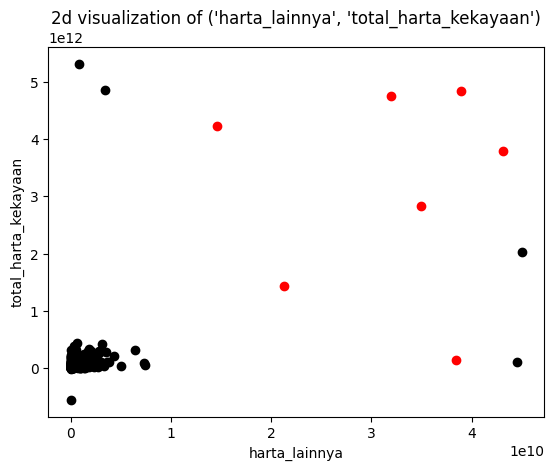

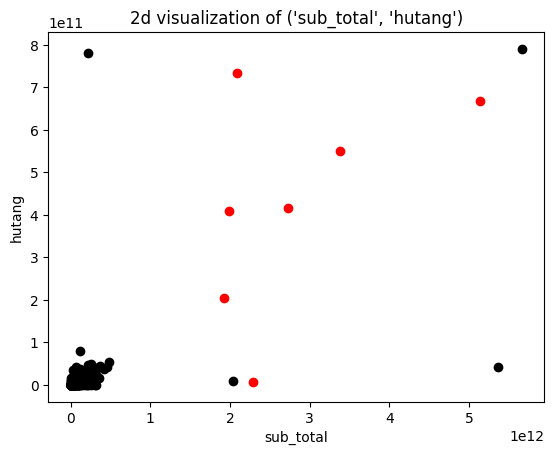

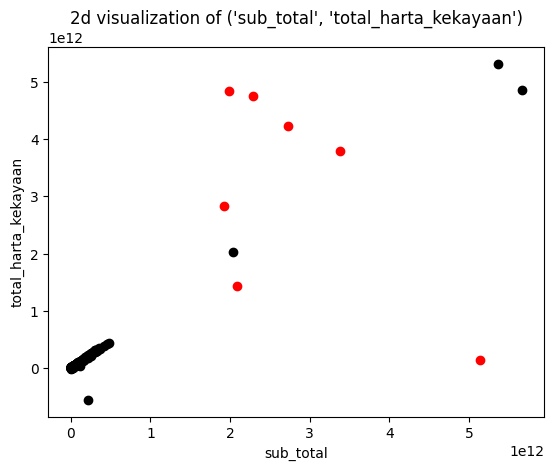

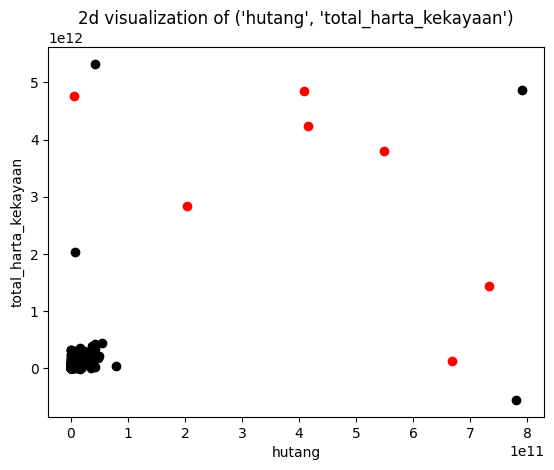

In [44]:
pairing_2d = get_numerical_feature_pairs(copy_2d_df_numerical_column)
for i in pairing_2d:
  visualize_data_2d(data_combine_all, feature=i, interactive = False, outlier_column = 'is_outlier', no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

only real data


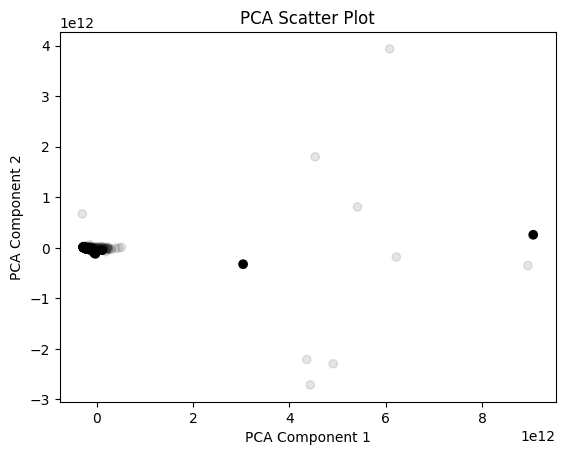

only synthetic data


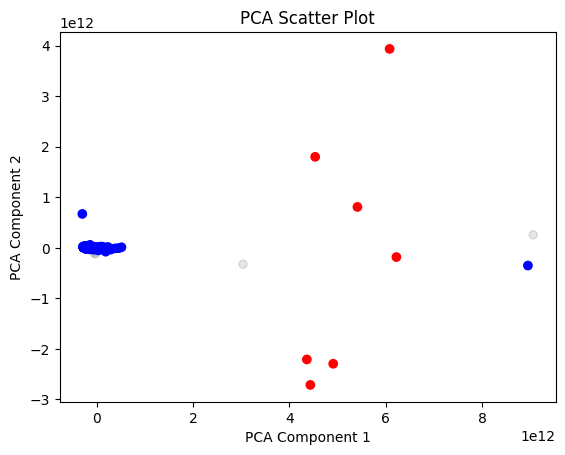

only synthetic outlier data


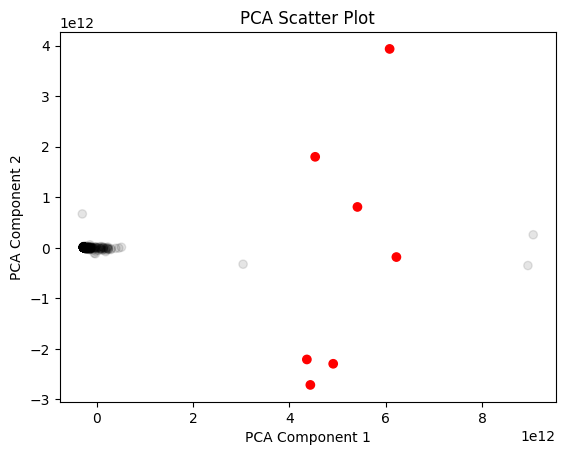

In [45]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA as PCAs

def perform_pca(dataframe, exclude_columns=['is_outlier', 'is_synthetic'], n_components=2):
    """
    Perform PCA on selected columns of a pandas DataFrame, excluding specified columns.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - exclude_columns: List of column names to exclude from PCA.
    - n_components: Number of principal components to retain.

    Returns:
    - DataFrame with PCA components for selected columns.
    """
    # Exclude specified columns from PCA
    pca_data = dataframe.drop(exclude_columns, axis=1)

    # Perform PCA
    pca = PCAs(n_components=n_components)
    pca_result = pca.fit_transform(pca_data)

    # Create a DataFrame with PCA results
    pca_df = pd.DataFrame(data=pca_result, columns=[f'PCA_{i+1}' for i in range(n_components)])

    # Concatenate PCA results with the excluded columns
    pca_df = pd.concat([pca_df, dataframe[exclude_columns]], axis=1)

    return pca_df

def plot_pca_with_colors(dataframe, transparent_colors=[]):
    """
    Create a scatter plot of PCA components with colors based on "is_synthetic" and "is_outlier" columns.

    Parameters:
    - dataframe: pandas DataFrame containing PCA components and "is_synthetic" and "is_outlier" columns.
    """
    # Create a dictionary to map colors
    color_mapping = {0: 'blue', 1: 'red'}

    # Assign colors based on "is_synthetic" and "is_outlier" columns
    colors = dataframe.apply(lambda row: color_mapping[row['is_outlier']] if row['is_outlier'] == 1
                              else ('black' if row['is_synthetic'] == 0 else 'blue'), axis=1)

    for idx in transparent_colors:
        colors[idx] = (0, 0, 0, 0.1)  # RGBA tuple

    # Scatter plot of PCA components
    plt.scatter(dataframe['PCA_1'], dataframe['PCA_2'], c=colors)
    plt.xlabel('PCA Component 1')
    plt.ylabel('PCA Component 2')
    plt.title('PCA Scatter Plot')
    plt.show()

# Example usage:
# Assuming 'df' is your DataFrame
# Perform PCA on selected columns (excluding "is_outlier" and "is_synthetic")
pca_result_df = perform_pca(data_combine_all, exclude_columns=['is_outlier', 'is_synthetic'])

print("only real data")
black_points_indices = pca_result_df[(pca_result_df['is_synthetic'] == 1)].index
plot_pca_with_colors(pca_result_df, transparent_colors=black_points_indices)

print("only synthetic data")
blue_points_indices = pca_result_df[(pca_result_df['is_synthetic'] == 0)].index
plot_pca_with_colors(pca_result_df, transparent_colors=blue_points_indices)

print("only synthetic outlier data")
red_points_indices = pca_result_df[(pca_result_df['is_outlier'] == 0)].index
plot_pca_with_colors(pca_result_df, transparent_colors=red_points_indices)

only real data


,PCA_1,PCA_2,PCA_3,is_outlier,is_synthetic
0,-2.666364e+11,6.349166e+09,6.602300e+09,0.0,0
1,-2.724606e+11,9.342036e+09,9.575120e+09,0.0,0
2,-2.515352e+11,-2.474176e+09,-1.826525e+09,0.0,0
3,-5.064356e+10,-1.063272e+11,-1.080264e+11,0.0,0
4,-2.525974e+11,-1.407884e+09,-1.193732e+09,0.0,0
...,...,...,...,...,...
302,4.364182e+12,-2.209054e+12,-6.913914e+11,1.0,1
303,4.436512e+12,-2.713189e+12,-1.912821e+11,1.0,1
304,6.082771e+12,3.936419e+12,-1.060257e+12,1.0,1
305,4.536746e+12,1.801144e+12,1.147856e+12,1.0,1


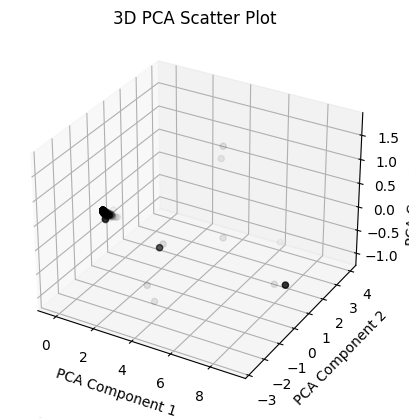

only synthetic data


,PCA_1,PCA_2,PCA_3,is_outlier,is_synthetic
0,-2.666364e+11,6.349166e+09,6.602300e+09,0.0,0
1,-2.724606e+11,9.342036e+09,9.575120e+09,0.0,0
2,-2.515352e+11,-2.474176e+09,-1.826525e+09,0.0,0
3,-5.064356e+10,-1.063272e+11,-1.080264e+11,0.0,0
4,-2.525974e+11,-1.407884e+09,-1.193732e+09,0.0,0
...,...,...,...,...,...
302,4.364182e+12,-2.209054e+12,-6.913914e+11,1.0,1
303,4.436512e+12,-2.713189e+12,-1.912821e+11,1.0,1
304,6.082771e+12,3.936419e+12,-1.060257e+12,1.0,1
305,4.536746e+12,1.801144e+12,1.147856e+12,1.0,1


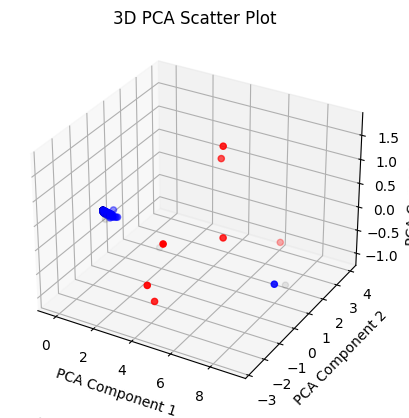

only synthetic outlier data


,PCA_1,PCA_2,PCA_3,is_outlier,is_synthetic
0,-2.666364e+11,6.349166e+09,6.602300e+09,0.0,0
1,-2.724606e+11,9.342036e+09,9.575120e+09,0.0,0
2,-2.515352e+11,-2.474176e+09,-1.826525e+09,0.0,0
3,-5.064356e+10,-1.063272e+11,-1.080264e+11,0.0,0
4,-2.525974e+11,-1.407884e+09,-1.193732e+09,0.0,0
...,...,...,...,...,...
302,4.364182e+12,-2.209054e+12,-6.913914e+11,1.0,1
303,4.436512e+12,-2.713189e+12,-1.912821e+11,1.0,1
304,6.082771e+12,3.936419e+12,-1.060257e+12,1.0,1
305,4.536746e+12,1.801144e+12,1.147856e+12,1.0,1


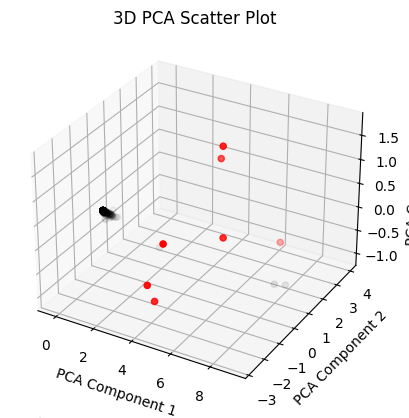

In [46]:
def plot_pca_with_colors_3d(dataframe, transparent_colors=[]):
    # Create a dictionary to map colors
    color_mapping = {0: 'blue', 1: 'red'}

    # Assign colors based on "is_synthetic" and "is_outlier" columns
    colors = dataframe.apply(lambda row: color_mapping[row['is_outlier']] if row['is_outlier'] == 1
                              else ('black' if row['is_synthetic'] == 0 else 'blue'), axis=1)

    for idx in transparent_colors:
        colors[idx] = (0, 0, 0, 0.1)  # RGBA tuple

    # Create a 3D scatter plot
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    display(dataframe)
    ax.scatter(dataframe['PCA_1'], dataframe['PCA_2'], dataframe['PCA_3'], c=colors)
    ax.set_xlabel('PCA Component 1')
    ax.set_ylabel('PCA Component 2')
    ax.set_zlabel('PCA Component 3')
    plt.title('3D PCA Scatter Plot')
    plt.show()

# Example usage:
# Assuming 'df' is your DataFrame
# Perform PCA on selected columns (excluding "is_outlier" and "is_synthetic")
pca_result_df_3 = perform_pca(data_combine_all, exclude_columns=['is_outlier', 'is_synthetic'], n_components=3)

print("only real data")
black_points_indices_3 = pca_result_df_3[(pca_result_df_3['is_synthetic'] == 1)].index
plot_pca_with_colors_3d(pca_result_df_3, transparent_colors=black_points_indices_3)

print("only synthetic data")
blue_points_indices_3 = pca_result_df_3[(pca_result_df_3['is_synthetic'] == 0)].index
plot_pca_with_colors_3d(pca_result_df_3, transparent_colors=blue_points_indices_3)

print("only synthetic outlier data")
red_points_indices_3 = pca_result_df_3[(pca_result_df_3['is_outlier'] == 0)].index
plot_pca_with_colors_3d(pca_result_df_3, transparent_colors=red_points_indices_3)


#### Show Histogram

harta_tanah_dan_bangunan


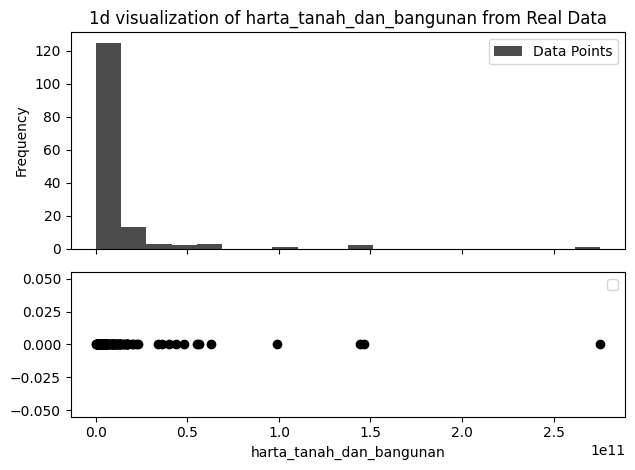

harta_alat_transportasi_dan_mesin


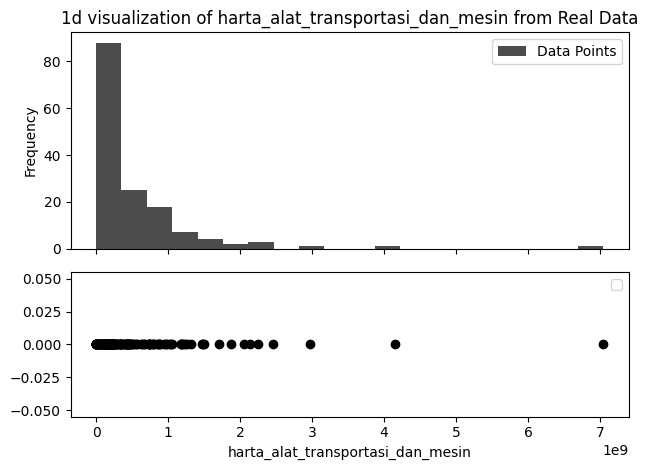

harta_bergerak_lainnya


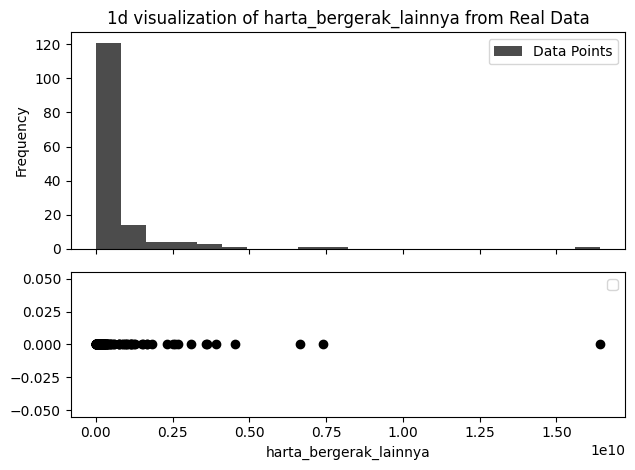

surat_berharga


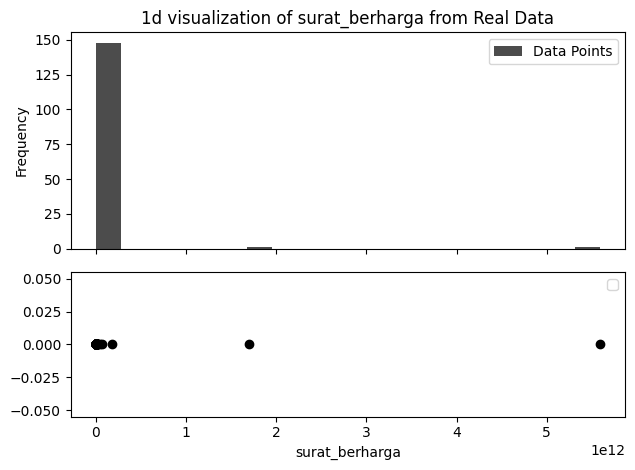

harta_kas_dan_setara_kas


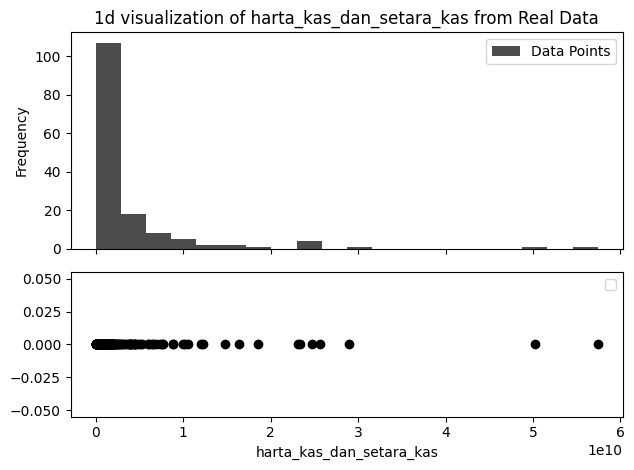

harta_lainnya


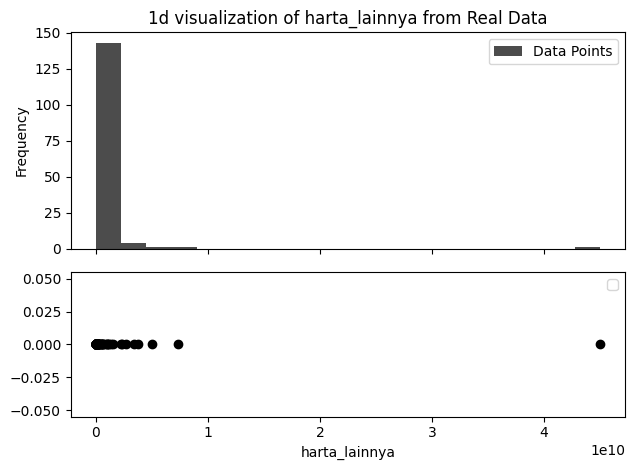

sub_total


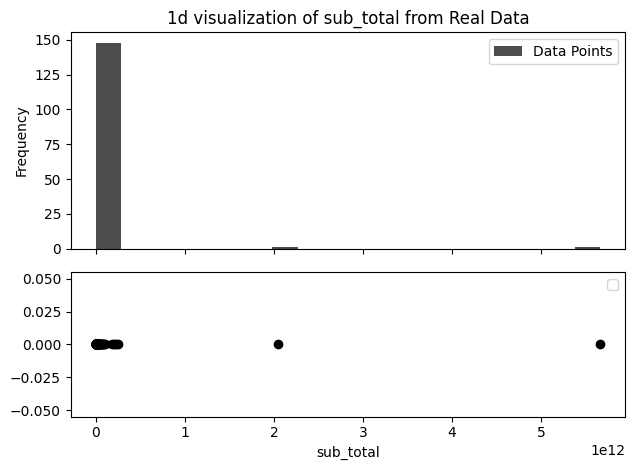

hutang


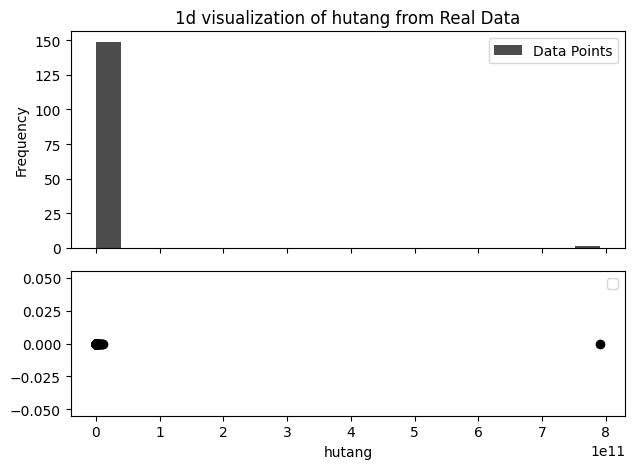

total_harta_kekayaan


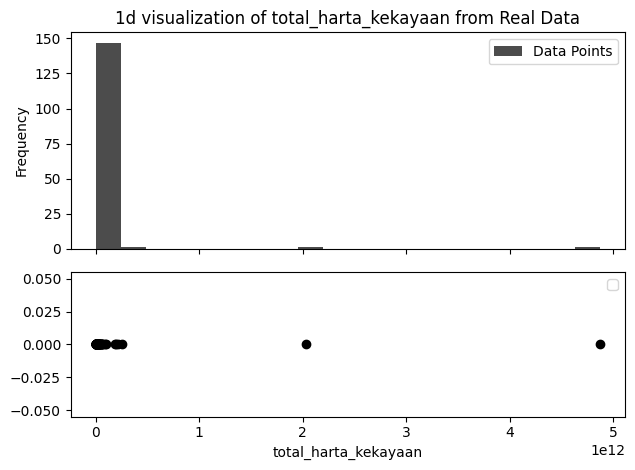

In [47]:
data_real_zeros = copy.deepcopy(data_real)
data_real_zeros['is_outlier'] = 0
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(data_real_zeros, feature=i, types = 'histogram_scatter', no_legend=True, outlier_column = 'is_outlier', title = f"1d visualization of {i} from Real Data")

harta_tanah_dan_bangunan


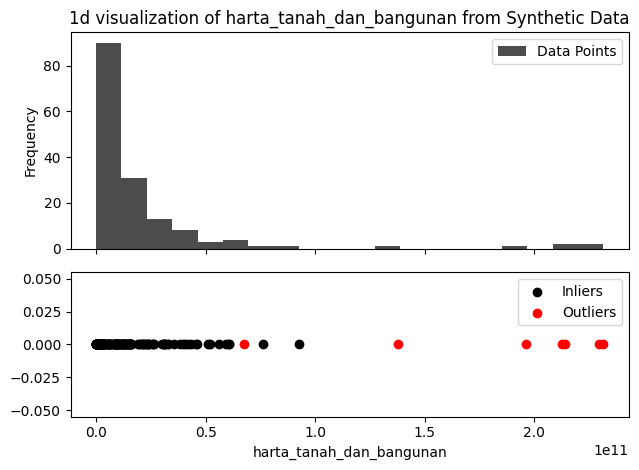

harta_alat_transportasi_dan_mesin


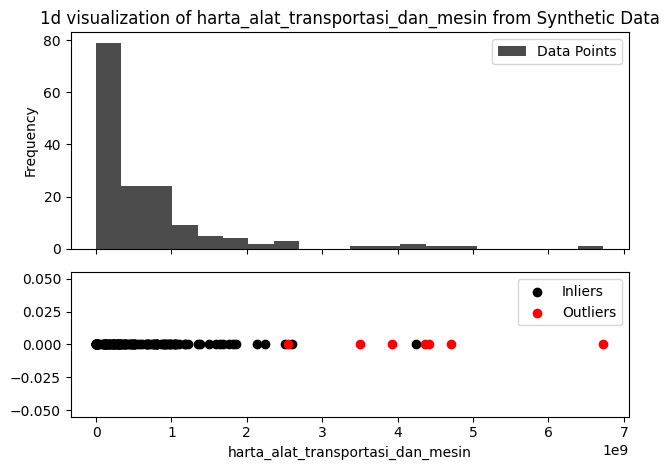

harta_bergerak_lainnya


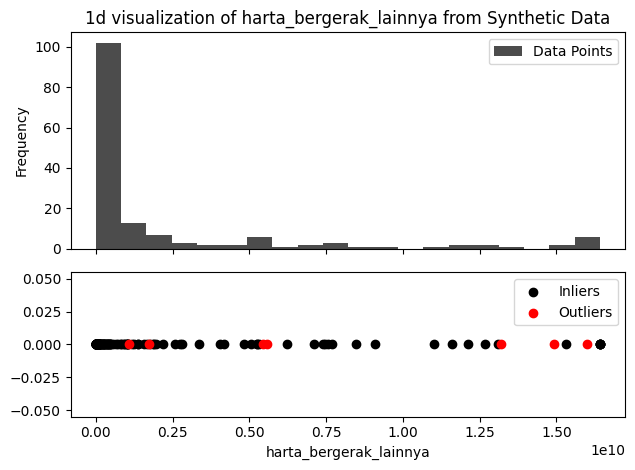

surat_berharga


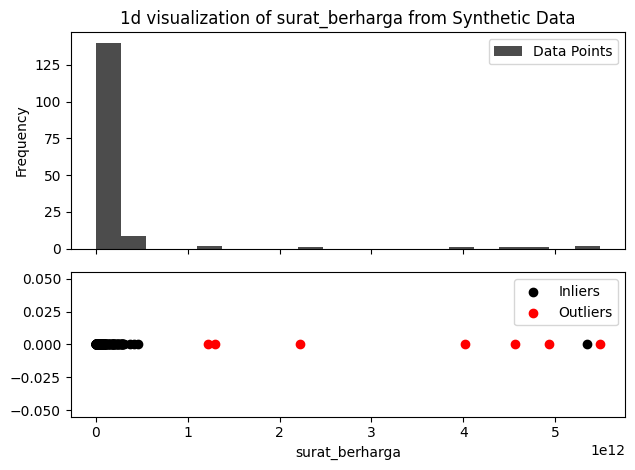

harta_kas_dan_setara_kas


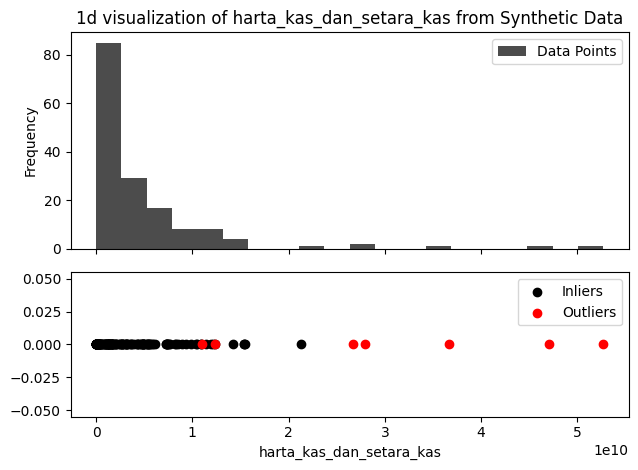

harta_lainnya


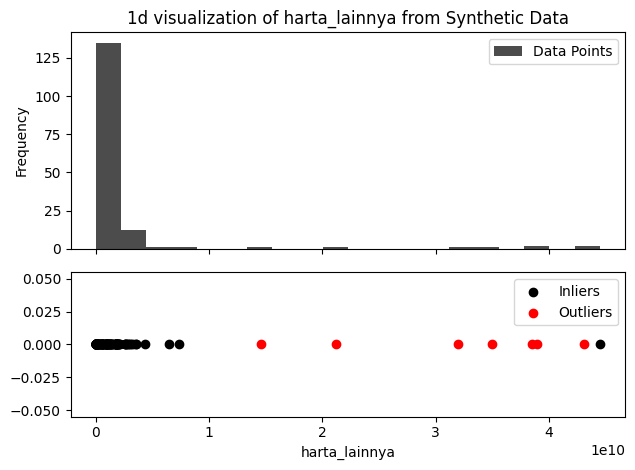

sub_total


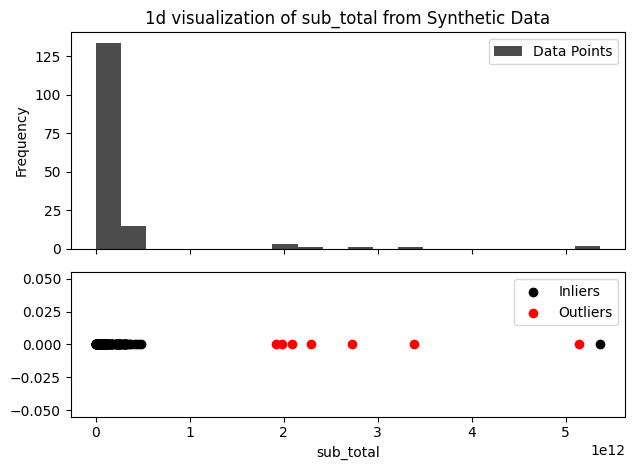

hutang


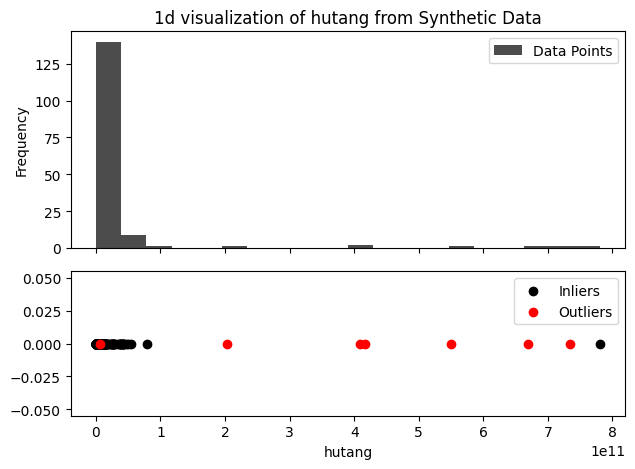

total_harta_kekayaan


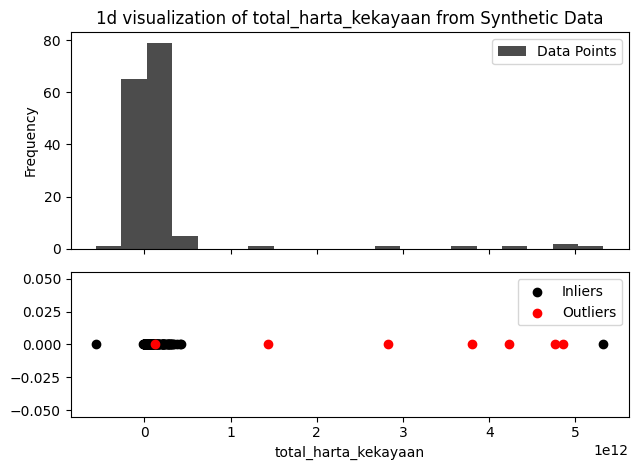

In [48]:
data_synthetic_all_zeros = copy.deepcopy(data_synthetic_all)

for i in clean_df_col_list:
  print(i)
  visualize_data_1d(data_synthetic_all_zeros, feature=i, types = 'histogram_scatter', no_legend=False, outlier_column = 'is_outlier', title = f"1d visualization of {i} from Synthetic Data")

#### Correlation matrix

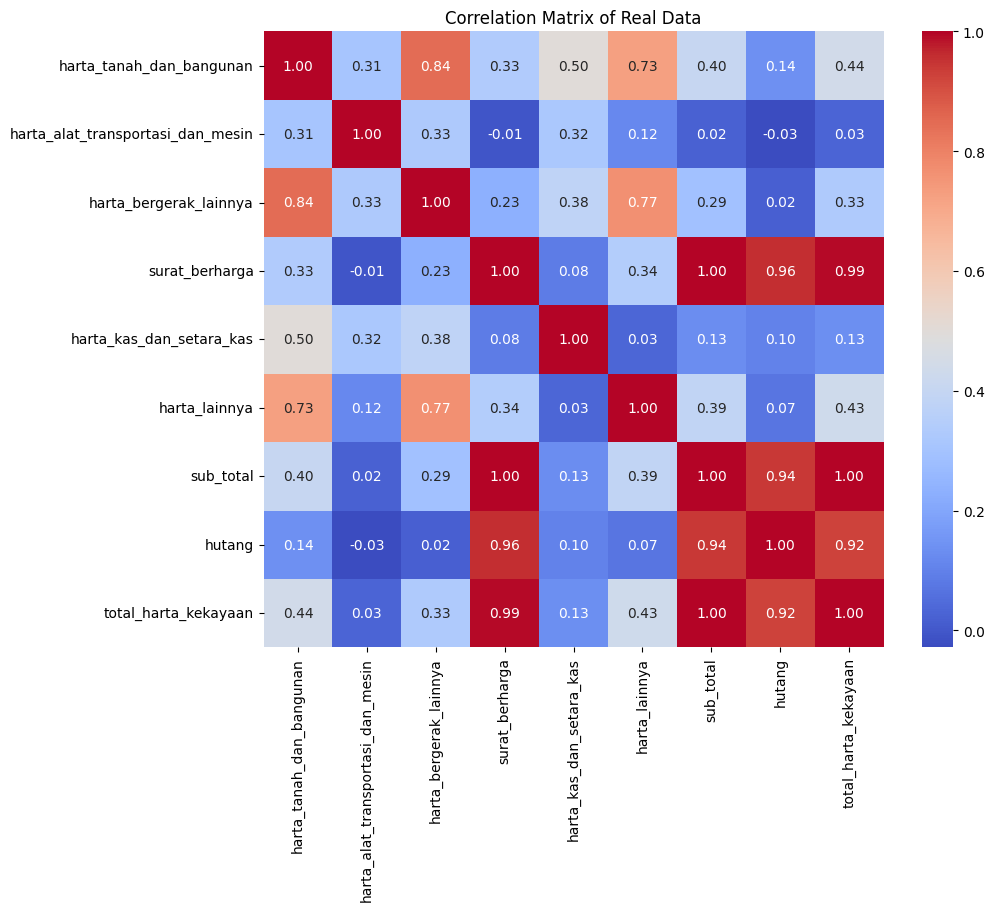

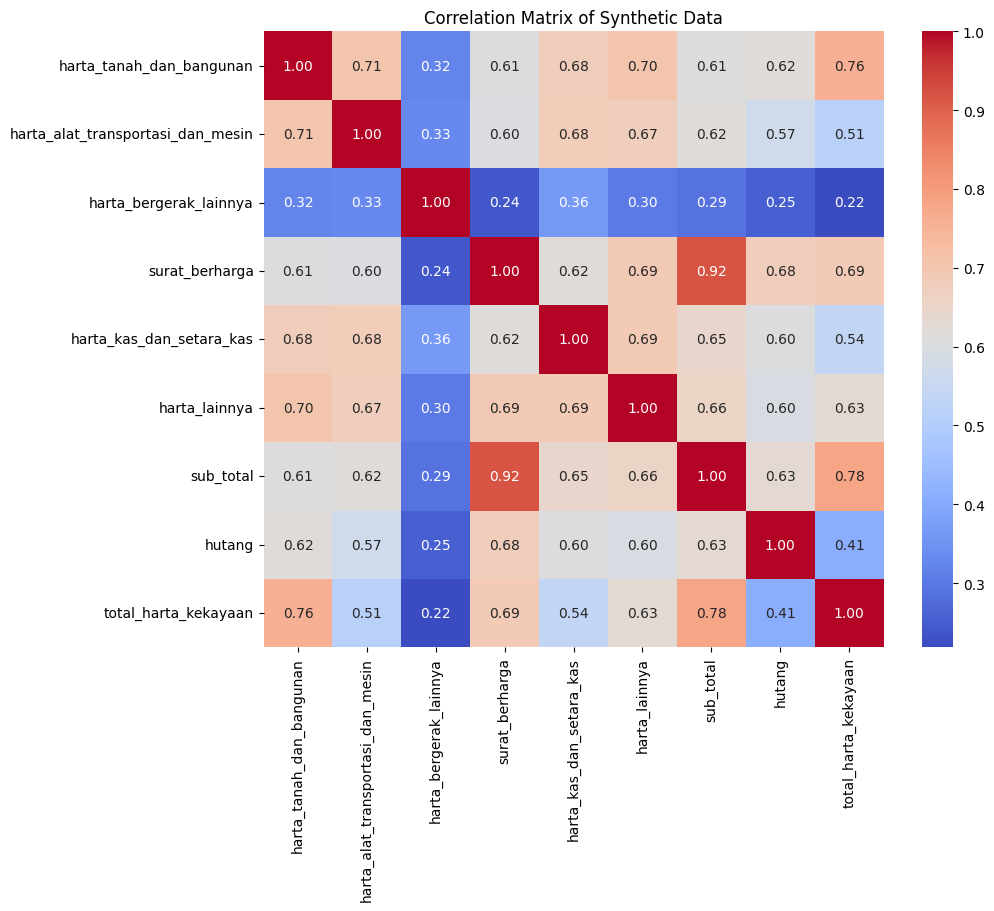

In [49]:
def show_correlation_matrix_ordered(dataframe, title = "Data", column_order=None):
    if column_order is not None:
        # Reorder the columns based on the specified order
        dataframe = dataframe[column_order]

    # Calculate the correlation matrix
    corr_matrix = dataframe.corr()

    # Set up the matplotlib figure
    plt.figure(figsize=(10, 8))

    # Create a heatmap using seaborn
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f")

    # Add a title
    plt.title(f"Correlation Matrix of {title}")

    # Show the plot
    plt.show()

df_r = copy.deepcopy(data_real)
df_s = copy.deepcopy(data_synthetic_all)
df_r = df_r.drop(['is_synthetic'], axis = 1)
df_s = df_s.drop(['is_outlier', 'is_synthetic'], axis = 1)

show_correlation_matrix_ordered(df_r, title = "Real Data", column_order = clean_df_col_list)
show_correlation_matrix_ordered(df_s, title = "Synthetic Data", column_order = clean_df_col_list)

## Syntetic Data Outlier Detection

In [50]:
#comment if already got data
#outliers_synthetic_data = pd.read_csv('/content/synthetic_data.csv')

In [51]:
outliers_synthetic_data

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,is_outlier
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0.0
...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1.0


In [52]:
outliers_synthetic_data_try = copy.deepcopy(outliers_synthetic_data)
outliers_synthetic_data_try = outliers_synthetic_data_try.drop('is_outlier', axis = 1)
outliers_synthetic_data_try

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924
...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796


In [53]:
display(outliers_synthetic_data_try)
display(outliers_synthetic_data[['is_outlier']])
display(outliers_synthetic_data)

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924
...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796


,is_outlier
0,0.0
1,0.0
2,0.0
3,0.0
4,0.0
...,...
152,1.0
153,1.0
154,1.0
155,1.0


,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,is_outlier
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0.0
...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1.0


#### Z-Score

In [75]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from scipy.spatial import distance
from scipy.stats import zscore

from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_zscore(dataframe, y_truth, model_name='Zscore'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics using Z-score method.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters (e.g., threshold)
    param_grid = {
        'threshold': np.arange(1.0, 10.0, 0.1)
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'average_precision', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        threshold = params['threshold']

        # Calculate Z-scores for the data
        z_scores = np.abs(zscore(dataframe))

        # Calculate Euclidean distances for each data point
        #euclidean_distances = np.linalg.norm(z_scores, axis=1)

        # Apply the threshold to classify outliers
        #y_pred = (euclidean_distances > threshold).astype(int)
        y_pred = (z_scores > threshold).any(axis=1).astype(int)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': threshold,
            'cm': cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = None  # Z-score doesn't have a model to update

            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:

original_df_zscore, results_df_zscore = perform_grid_search_and_metrics_zscore(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])


  0%|          | 0/90 [00:00<?, ?it/s]<ipython-input-75-37fd779359e8>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-75-37fd779359e8>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-75-37fd779359e8>:75: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 2/90 [00:00<00:08, 10.63it/s]<ipython-input-75-37fd779359e8>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-75-37fd779359e8>:75: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bo

In [82]:
original_df_zscore

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [83]:
results_df_zscore

,model_name,hyperparameter1,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,average_precision,is_best_model,cm
0,Zscore,1.0,0.802548,0.184211,1.0,0.311111,"[0.0, 1.0, 1.0]","[0.0, 0.20666666666666667, 1.0]",0.896667,0.592105,0.184211,True,"[[119, 31], [0, 7]]"
1,Zscore,1.1,0.815287,0.194444,1.0,0.325581,"[0.0, 1.0, 1.0]","[0.0, 0.19333333333333333, 1.0]",0.903333,0.597222,0.194444,True,"[[121, 29], [0, 7]]"
2,Zscore,1.2,0.828025,0.205882,1.0,0.341463,"[0.0, 1.0, 1.0]","[0.0, 0.18, 1.0]",0.910000,0.602941,0.205882,True,"[[123, 27], [0, 7]]"
3,Zscore,1.3,0.847134,0.225806,1.0,0.368421,"[0.0, 1.0, 1.0]","[0.0, 0.16, 1.0]",0.920000,0.612903,0.225806,True,"[[126, 24], [0, 7]]"
4,Zscore,1.4,0.853503,0.233333,1.0,0.378378,"[0.0, 1.0, 1.0]","[0.0, 0.15333333333333332, 1.0]",0.923333,0.616667,0.233333,True,"[[127, 23], [0, 7]]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,Zscore,9.5,0.955414,0.000000,0.0,0.000000,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[150, 0], [7, 0]]"
86,Zscore,9.6,0.955414,0.000000,0.0,0.000000,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[150, 0], [7, 0]]"
87,Zscore,9.7,0.955414,0.000000,0.0,0.000000,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[150, 0], [7, 0]]"
88,Zscore,9.8,0.955414,0.000000,0.0,0.000000,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[150, 0], [7, 0]]"


#### IQR Distance

In [76]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from scipy.stats import iqr
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_iqr_distance(dataframe, y_truth, model_name='IQR Distance'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics using IQR Distance method.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters (e.g., threshold multiplier)
    param_grid = {
        'threshold_multiplier': np.arange(1.0, 10.0, 0.1)
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'average_precision', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        threshold_multiplier = params['threshold_multiplier']

        # Calculate the first quartile (Q1) and third quartile (Q3) for each column
        Q1 = dataframe.quantile(0.25)
        Q3 = dataframe.quantile(0.75)

        # Calculate the IQR (Interquartile Range) for each column
        IQR = Q3 - Q1

        # Define the lower and upper bounds for each column based on the IQR
        lower_bound = Q1 - threshold_multiplier * IQR
        upper_bound = Q3 + threshold_multiplier * IQR


        # Calculate IQR (Interquartile Range) for each feature
        #iqr_values = iqr(dataframe, axis=0)

        # Calculate the IQR Distance for each data point
        #iqr_distances = np.linalg.norm((dataframe - np.median(dataframe, axis=0)) / iqr_values, axis=1)

        # Apply the threshold to classify outliers
        #y_pred = (iqr_distances > threshold_multiplier).astype(int)
        y_pred = (((dataframe < lower_bound) | (dataframe > upper_bound)).any(axis=1)).astype(int)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': threshold_multiplier,
            'cm': cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = None  # IQR Distance doesn't have a model to update

            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:
original_df_iqr_distance, results_df_iqr_distance = perform_grid_search_and_metrics_iqr_distance(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])


  0%|          | 0/90 [00:00<?, ?it/s]<ipython-input-76-6433f194fe25>:85: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-76-6433f194fe25>:85: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-76-6433f194fe25>:85: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 2/90 [00:00<00:06, 14.03it/s]<ipython-input-76-6433f194fe25>:85: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-76-6433f194fe25>:85: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bo

In [84]:
original_df_iqr_distance

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [85]:
results_df_iqr_distance

,model_name,hyperparameter1,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,average_precision,is_best_model,cm
0,IQR Distance,1.0,0.656051,0.114754,1.0,0.205882,"[0.0, 1.0, 1.0]","[0.0, 0.36, 1.0]",0.820000,0.557377,0.114754,True,"[[96, 54], [0, 7]]"
1,IQR Distance,1.1,0.681529,0.122807,1.0,0.218750,"[0.0, 1.0, 1.0]","[0.0, 0.3333333333333333, 1.0]",0.833333,0.561404,0.122807,True,"[[100, 50], [0, 7]]"
2,IQR Distance,1.2,0.694268,0.127273,1.0,0.225806,"[0.0, 1.0, 1.0]","[0.0, 0.32, 1.0]",0.840000,0.563636,0.127273,True,"[[102, 48], [0, 7]]"
3,IQR Distance,1.3,0.719745,0.137255,1.0,0.241379,"[0.0, 1.0, 1.0]","[0.0, 0.29333333333333333, 1.0]",0.853333,0.568627,0.137255,True,"[[106, 44], [0, 7]]"
4,IQR Distance,1.4,0.719745,0.137255,1.0,0.241379,"[0.0, 1.0, 1.0]","[0.0, 0.29333333333333333, 1.0]",0.853333,0.568627,0.137255,False,"[[106, 44], [0, 7]]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,IQR Distance,9.5,0.980892,0.700000,1.0,0.823529,"[0.0, 1.0, 1.0]","[0.0, 0.02, 1.0]",0.990000,0.850000,0.700000,False,"[[147, 3], [0, 7]]"
86,IQR Distance,9.6,0.980892,0.700000,1.0,0.823529,"[0.0, 1.0, 1.0]","[0.0, 0.02, 1.0]",0.990000,0.850000,0.700000,False,"[[147, 3], [0, 7]]"
87,IQR Distance,9.7,0.980892,0.700000,1.0,0.823529,"[0.0, 1.0, 1.0]","[0.0, 0.02, 1.0]",0.990000,0.850000,0.700000,False,"[[147, 3], [0, 7]]"
88,IQR Distance,9.8,0.980892,0.700000,1.0,0.823529,"[0.0, 1.0, 1.0]","[0.0, 0.02, 1.0]",0.990000,0.850000,0.700000,False,"[[147, 3], [0, 7]]"


#### MAD

In [77]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_mad(dataframe, y_truth, model_name='MAD'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics using Median Absolute Deviation (MAD) method.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters (e.g., threshold multiplier)
    param_grid = {
        'threshold_multiplier': np.arange(1.0, 10.0, 0.1)
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'average_precision', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        threshold_multiplier = params['threshold_multiplier']

        # Calculate the median of each feature
        median_values = np.median(dataframe, axis=0)

        # Calculate the MAD (Median Absolute Deviation) for each feature
        mad_values = np.median(np.abs(dataframe - median_values), axis=0)

        # Calculate the MAD-based anomaly scores for each data point
        mad_scores = np.median(np.abs(dataframe - median_values) / mad_values, axis=1)

        # Apply the threshold to classify outliers
        y_pred = (mad_scores > threshold_multiplier).astype(int)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': threshold_multiplier,
            'cm': cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = None  # MAD doesn't have a model to update

            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:
original_df_mad, results_df_mad = perform_grid_search_and_metrics_mad(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])



  0%|          | 0/90 [00:00<?, ?it/s]<ipython-input-77-fdfc18715d79>:74: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-77-fdfc18715d79>:74: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-77-fdfc18715d79>:74: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 2/90 [00:00<00:05, 17.58it/s]<ipython-input-77-fdfc18715d79>:74: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-77-fdfc18715d79>:74: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bo

In [86]:
original_df_mad

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [87]:
results_df_mad

,model_name,hyperparameter1,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,average_precision,is_best_model,cm
0,MAD,1.0,0.656051,0.114754,1.0,0.205882,"[0.0, 1.0, 1.0]","[0.0, 0.36, 1.0]",0.820000,0.557377,0.114754,True,"[[96, 54], [0, 7]]"
1,MAD,1.1,0.707006,0.132075,1.0,0.233333,"[0.0, 1.0, 1.0]","[0.0, 0.30666666666666664, 1.0]",0.846667,0.566038,0.132075,True,"[[104, 46], [0, 7]]"
2,MAD,1.2,0.732484,0.142857,1.0,0.250000,"[0.0, 1.0, 1.0]","[0.0, 0.28, 1.0]",0.860000,0.571429,0.142857,True,"[[108, 42], [0, 7]]"
3,MAD,1.3,0.745223,0.148936,1.0,0.259259,"[0.0, 1.0, 1.0]","[0.0, 0.26666666666666666, 1.0]",0.866667,0.574468,0.148936,True,"[[110, 40], [0, 7]]"
4,MAD,1.4,0.764331,0.159091,1.0,0.274510,"[0.0, 1.0, 1.0]","[0.0, 0.24666666666666667, 1.0]",0.876667,0.579545,0.159091,True,"[[113, 37], [0, 7]]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...
85,MAD,9.5,1.000000,1.000000,1.0,1.000000,"[0.0, 1.0, 1.0]","[0.0, 0.0, 1.0]",1.000000,1.000000,1.000000,False,"[[150, 0], [0, 7]]"
86,MAD,9.6,1.000000,1.000000,1.0,1.000000,"[0.0, 1.0, 1.0]","[0.0, 0.0, 1.0]",1.000000,1.000000,1.000000,False,"[[150, 0], [0, 7]]"
87,MAD,9.7,1.000000,1.000000,1.0,1.000000,"[0.0, 1.0, 1.0]","[0.0, 0.0, 1.0]",1.000000,1.000000,1.000000,False,"[[150, 0], [0, 7]]"
88,MAD,9.8,1.000000,1.000000,1.0,1.000000,"[0.0, 1.0, 1.0]","[0.0, 0.0, 1.0]",1.000000,1.000000,1.000000,False,"[[150, 0], [0, 7]]"


#### Isolation Forest

In [78]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from pyod.models.iforest import IForest
from sklearn.model_selection import ParameterGrid


def perform_grid_search_and_metrics(dataframe, y_truth, model_name='IForest'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters n_estimators, max_features, and contamination
    param_grid = {
        'n_estimators': [10, 20, 30, 40, 50, 75, 100, 150, 200],
        'max_features': [0.1, 0.2, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9],
        'contamination': [0.01, 0.05, 0.1, 0.3, 0.5]
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'hyperparameter2', 'hyperparameter3',
                                       'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth


    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        n_estimators = params['n_estimators']
        max_features = params['max_features']
        contamination = params['contamination']

        # Create and train the Isolation Forest model
        model = IForest(n_estimators=n_estimators, max_features=max_features, contamination=contamination, random_state=0)
        model.fit(dataframe.values)

        # Get predicted labels (y_pred) from the model
        y_pred = model.predict(dataframe.values)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': n_estimators,
            'hyperparameter2': max_features,
            'hyperparameter3': contamination,
            'cm':cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = model
            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:
original_df_iforest, results_df_iforest = perform_grid_search_and_metrics(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])



  0%|          | 0/360 [00:00<?, ?it/s]<ipython-input-78-2a3e010ae9e2>:76: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

  0%|          | 1/360 [00:00<00:37,  9.65it/s]<ipython-input-78-2a3e010ae9e2>:76: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-78-2a3e010ae9e2>:76: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 2/360 [00:00<00:39,  9.04it/s]<ipython-input-78-2a3e010ae9e2>:76: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-78-2a3e010ae9e2>:76: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in redu

In [88]:
display(original_df_iforest)

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [89]:
display(results_df_iforest)

,model_name,hyperparameter1,hyperparameter2,hyperparameter3,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,is_best_model,cm,average_precision
0,IForest,10,0.1,0.01,0.961783,1.000000,0.142857,0.250000,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.0, 1.0]",0.571429,0.590537,True,"[[150, 0], [6, 1]]",0.181074
1,IForest,20,0.1,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,True,"[[150, 0], [5, 2]]",0.317561
2,IForest,30,0.1,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,False,"[[150, 0], [5, 2]]",0.317561
3,IForest,40,0.1,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,False,"[[150, 0], [5, 2]]",0.317561
4,IForest,50,0.1,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,False,"[[150, 0], [5, 2]]",0.317561
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355,IForest,50,0.9,0.50,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,False,"[[79, 71], [0, 7]]",0.089744
356,IForest,75,0.9,0.50,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,False,"[[79, 71], [0, 7]]",0.089744
357,IForest,100,0.9,0.50,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,False,"[[79, 71], [0, 7]]",0.089744
358,IForest,150,0.9,0.50,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,False,"[[79, 71], [0, 7]]",0.089744


#### LOF

In [79]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from pyod.models.lof import LOF
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_lof(dataframe, y_truth, model_name='LOF'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters n_neighbors, contamination, and metric
    param_grid = {
        'n_neighbors': [1] + [i for i in range(5, 101, 5)],
        'contamination': [0.01, 0.05, 0.1, 0.3, 0.5],
        'metric': ['manhattan', 'euclidean', 'minkowski']
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'hyperparameter2', 'hyperparameter3',
                                       'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        n_neighbors = params['n_neighbors']
        contamination = params['contamination']
        metric = params['metric']

        # Create and train the LOF model
        model = LOF(n_neighbors=n_neighbors, contamination=contamination, metric=metric)
        model.fit(dataframe.values)

        # Get predicted labels (y_pred) from the model
        y_pred = model.predict(dataframe.values)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': n_neighbors,
            'hyperparameter2': contamination,
            'hyperparameter3': metric,
            'cm':cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model

        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = model
            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

original_df_lof, results_df_lof = perform_grid_search_and_metrics_lof(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])


  0%|          | 0/315 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-79-db1dfc4fae27>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-79-db1dfc4fae27>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-79-db1dfc4fae27>:75: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 2/315 [00:00<00:19, 16.36it/s]<ipython-input-79-db1dfc4fae27>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas i

In [93]:
original_df_lof

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [94]:
results_df_lof

,model_name,hyperparameter1,hyperparameter2,hyperparameter3,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,is_best_model,cm,average_precision
0,LOF,1,0.01,manhattan,0.955414,0.000000,0.000000,0.000000,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,True,"[[150, 0], [7, 0]]",0.044586
1,LOF,5,0.01,manhattan,0.949045,0.000000,0.000000,0.000000,"[0.0, 0.0, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.496667,0.022293,False,"[[149, 1], [7, 0]]",0.044586
2,LOF,10,0.01,manhattan,0.961783,1.000000,0.142857,0.250000,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.0, 1.0]",0.571429,0.590537,True,"[[150, 0], [6, 1]]",0.181074
3,LOF,15,0.01,manhattan,0.961783,1.000000,0.142857,0.250000,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.0, 1.0]",0.571429,0.590537,False,"[[150, 0], [6, 1]]",0.181074
4,LOF,20,0.01,manhattan,0.955414,0.500000,0.142857,0.222222,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.568095,0.340537,False,"[[149, 1], [6, 1]]",0.109645
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
310,LOF,80,0.50,minkowski,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,False,"[[79, 71], [0, 7]]",0.089744
311,LOF,85,0.50,minkowski,0.541401,0.088608,1.000000,0.162791,"[0.0, 1.0, 1.0]","[0.0, 0.48, 1.0]",0.760000,0.544304,False,"[[78, 72], [0, 7]]",0.088608
312,LOF,90,0.50,minkowski,0.528662,0.086420,1.000000,0.159091,"[0.0, 1.0, 1.0]","[0.0, 0.49333333333333335, 1.0]",0.753333,0.543210,False,"[[76, 74], [0, 7]]",0.086420
313,LOF,95,0.50,minkowski,0.560510,0.092105,1.000000,0.168675,"[0.0, 1.0, 1.0]","[0.0, 0.46, 1.0]",0.770000,0.546053,False,"[[81, 69], [0, 7]]",0.092105


#### KNN

In [80]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from pyod.models.knn import KNN
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_knn(dataframe, y_truth, model_name='KNN'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters n_neighbors, method, and contamination
    param_grid = {
        'n_neighbors': [1] + [i for i in range(5, 101, 5)],
        'method': ['largest', 'mean', 'median'],
        'contamination': [0.01, 0.05, 0.1, 0.3, 0.5]
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'hyperparameter2', 'hyperparameter3',
                                       'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        n_neighbors = params['n_neighbors']
        method = params['method']
        contamination = params['contamination']

        # Create and train the KNN model
        model = KNN(n_neighbors=n_neighbors, method=method, contamination=contamination)
        model.fit(dataframe.values)

        # Get predicted labels (y_pred) from the model
        y_pred = model.predict(dataframe.values)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': n_neighbors,
            'hyperparameter2': method,
            'hyperparameter3': contamination,
            'cm':cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = model
            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:
original_df_knn, results_df_knn = perform_grid_search_and_metrics_knn(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])


  0%|          | 0/315 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-80-c57fc5e1edec>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

  0%|          | 1/315 [00:00<00:33,  9.42it/s]<ipython-input-80-c57fc5e1edec>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-80-c57fc5e1edec>:75: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-80-c57fc5e1edec>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas i

In [91]:
original_df_knn

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [92]:
results_df_knn

,model_name,hyperparameter1,hyperparameter2,hyperparameter3,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,is_best_model,cm,average_precision
0,KNN,1,largest,0.01,0.955414,0.000000,0.000000,0.000000,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,True,"[[150, 0], [7, 0]]",0.044586
1,KNN,5,largest,0.01,0.955414,0.500000,0.142857,0.222222,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.568095,0.340537,True,"[[149, 1], [6, 1]]",0.109645
2,KNN,10,largest,0.01,0.955414,0.500000,0.142857,0.222222,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.568095,0.340537,False,"[[149, 1], [6, 1]]",0.109645
3,KNN,15,largest,0.01,0.955414,0.500000,0.142857,0.222222,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.568095,0.340537,False,"[[149, 1], [6, 1]]",0.109645
4,KNN,20,largest,0.01,0.955414,0.500000,0.142857,0.222222,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.568095,0.340537,False,"[[149, 1], [6, 1]]",0.109645
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
310,KNN,80,median,0.50,0.554140,0.090909,1.000000,0.166667,"[0.0, 1.0, 1.0]","[0.0, 0.4666666666666667, 1.0]",0.766667,0.545455,False,"[[80, 70], [0, 7]]",0.090909
311,KNN,85,median,0.50,0.554140,0.090909,1.000000,0.166667,"[0.0, 1.0, 1.0]","[0.0, 0.4666666666666667, 1.0]",0.766667,0.545455,False,"[[80, 70], [0, 7]]",0.090909
312,KNN,90,median,0.50,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,False,"[[79, 71], [0, 7]]",0.089744
313,KNN,95,median,0.50,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,False,"[[79, 71], [0, 7]]",0.089744


In [ ]:
X_train = outliers_synthetic_data_try.values
y_truth = outliers_synthetic_data[['is_outlier']].values

# Define a range of values for the hyperparameters n_neighbors and method (matching KNN)
param_grid = {
    'n_neighbors': [1] + [i for i in range(5, 101, 5)],
    'method': ['largest', 'mean', 'median'],
    'contamination': [0.01, 0.05, 0.1, 0.3, 0.5]
}

# Create a grid of hyperparameter combinations
param_combinations = list(ParameterGrid(param_grid))

# Perform grid search
best_model = None
best_score = float('-inf')

for params in param_combinations:
    n_neighbors = params['n_neighbors']
    method = params['method']

    # Create and train the KNN model
    model = KNN(n_neighbors=n_neighbors, method=method)
    model.fit(X_train)

    # Get predicted labels (y_pred) from the model
    y_pred = model.predict(X_train)

    # Calculate confusion matrix
    cm = confusion_matrix(y_truth, y_pred)

    # Calculate accuracy
    accuracy = accuracy_score(y_truth, y_pred)

    # Calculate precision, recall, and F1-score
    precision = precision_score(y_truth, y_pred)
    recall = recall_score(y_truth, y_pred)
    f1 = f1_score(y_truth, y_pred)

    # Calculate ROC curve and AUC
    fpr, tpr, _ = roc_curve(y_truth, y_pred)
    roc_auc = auc(fpr, tpr)

    # Calculate precision-recall curve and AUC PR Curve
    precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
    pr_auc = auc(recall_curve, precision_curve)

    print()
    print()
    print(f"n_neighbors: {n_neighbors}, method: {method}")
    print()
    print(f'confusion matrix: {cm}')
    print(f'accuracy, precision, recall, f1: {accuracy, precision, recall, f1}')
    print(f'fpr, tpr: {fpr, tpr}')
    print(f'roc_auc: {roc_auc}')
    print(f'pr_auc: {pr_auc}')

    # Update the best model if this combination has a higher AUC score
    if roc_auc > best_score:
        best_score = roc_auc
        best_model = model
        best_params = params

# Print the best hyperparameters and model
print("Best Hyperparameters:", best_params)
print("Best AUC ROC Score:", best_score)
print("Best Model:", best_model)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 1, method: largest

confusion matrix: [[150   0]
 [  7   0]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.0, 0.0, 0.0)
fpr, tpr: (array([0., 1.]), array([0., 1.]))
roc_auc: 0.5
pr_auc: 0.5222929936305732


n_neighbors: 5, method: largest

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 10, method: largest

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 15, method: largest

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 1, method: mean

confusion matrix: [[150   0]
 [  7   0]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.0, 0.0, 0.0)
fpr, tpr: (array([0., 1.]), array([0., 1.]))
roc_auc: 0.5
pr_auc: 0.5222929936305732


n_neighbors: 5, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 10, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 15, method: mean

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]),

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 15, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 20, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 25, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 30, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (arr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 10, method: largest

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 15, method: largest

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 20, method: largest

confusion matrix: [[143   7]
 [  0   7]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.5, 1.0, 0.6666666666666666)
fpr, tpr: (array([0.        , 0.04666667, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9766666666666667
pr_auc: 0.75


n_neighbors: 25, method: largest

confusion matrix: [[143   7]
 [  0   7]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.5, 1.0, 0.6666666666666666)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 1, method: mean

confusion matrix: [[150   0]
 [  7   0]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.0, 0.0, 0.0)
fpr, tpr: (array([0., 1.]), array([0., 1.]))
roc_auc: 0.5
pr_auc: 0.5222929936305732


n_neighbors: 5, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 10, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 15, method: mean

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]),

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 10, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 15, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 20, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 25, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (arr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 1, method: largest

confusion matrix: [[150   0]
 [  7   0]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.0, 0.0, 0.0)
fpr, tpr: (array([0., 1.]), array([0., 1.]))
roc_auc: 0.5
pr_auc: 0.5222929936305732


n_neighbors: 5, method: largest

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 10, method: largest

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 15, method: largest

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 1, method: mean

confusion matrix: [[150   0]
 [  7   0]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.0, 0.0, 0.0)
fpr, tpr: (array([0., 1.]), array([0., 1.]))
roc_auc: 0.5
pr_auc: 0.5222929936305732


n_neighbors: 5, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 10, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 15, method: mean

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]),

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 10, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 15, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 20, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 25, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (arr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 10, method: largest

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 15, method: largest

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 20, method: largest

confusion matrix: [[143   7]
 [  0   7]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.5, 1.0, 0.6666666666666666)
fpr, tpr: (array([0.        , 0.04666667, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9766666666666667
pr_auc: 0.75


n_neighbors: 25, method: largest

confusion matrix: [[143   7]
 [  0   7]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.5, 1.0, 0.6666666666666666)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 5, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 10, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 15, method: mean

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 20, method: mean

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 15, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 20, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 25, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 30, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (arr

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 10, method: largest

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 15, method: largest

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 20, method: largest

confusion matrix: [[143   7]
 [  0   7]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.5, 1.0, 0.6666666666666666)
fpr, tpr: (array([0.        , 0.04666667, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9766666666666667
pr_auc: 0.75


n_neighbors: 25, method: largest

confusion matrix: [[143   7]
 [  0   7]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.5, 1.0, 0.6666666666666666)

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 1, method: mean

confusion matrix: [[150   0]
 [  7   0]]
accuracy, precision, recall, f1: (0.9554140127388535, 0.0, 0.0, 0.0)
fpr, tpr: (array([0., 1.]), array([0., 1.]))
roc_auc: 0.5
pr_auc: 0.5222929936305732


n_neighbors: 5, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 10, method: mean

confusion matrix: [[144   6]
 [  0   7]]
accuracy, precision, recall, f1: (0.9617834394904459, 0.5384615384615384, 1.0, 0.7000000000000001)
fpr, tpr: (array([0.  , 0.04, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.98
pr_auc: 0.7692307692307692


n_neighbors: 15, method: mean

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]),

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.





n_neighbors: 15, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 20, method: median

confusion matrix: [[141   9]
 [  0   7]]
accuracy, precision, recall, f1: (0.9426751592356688, 0.4375, 1.0, 0.6086956521739131)
fpr, tpr: (array([0.  , 0.06, 1.  ]), array([0., 1., 1.]))
roc_auc: 0.97
pr_auc: 0.71875


n_neighbors: 25, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (array([0.        , 0.05333333, 1.        ]), array([0., 1., 1.]))
roc_auc: 0.9733333333333333
pr_auc: 0.7333333333333334


n_neighbors: 30, method: median

confusion matrix: [[142   8]
 [  0   7]]
accuracy, precision, recall, f1: (0.9490445859872612, 0.4666666666666667, 1.0, 0.6363636363636364)
fpr, tpr: (arr

#### PCA

In [81]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from pyod.models.pca import PCA
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_pca(dataframe, y_truth, model_name='PCA'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters n_components and contamination
    param_grid = {
        'n_components': [i for i in range(1, len(list(dataframe.columns)))],
        'svd_solver': ['full', 'arpack', 'randomized'],
        'contamination': [0.01, 0.05, 0.1, 0.3, 0.5]
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'hyperparameter2','hyperparameter3',
                                       'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'average_precision', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        n_components = params['n_components']
        contamination = params['contamination']
        svd_solver = params['svd_solver']


        # Create and train the PCA model
        model = PCA(n_components=n_components, contamination=contamination, svd_solver=svd_solver)
        model.fit(dataframe.values)

        # Get predicted labels (y_pred) from the model
        y_pred = model.predict(dataframe.values)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': n_components,
            'hyperparameter2': contamination,
            'hyperparameter3': svd_solver,
            'cm': cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = model
            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

original_df_pca, results_df_pca = perform_grid_search_and_metrics_pca(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])



  0%|          | 0/120 [00:00<?, ?it/s]<ipython-input-81-302bc6e0d202>:76: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-81-302bc6e0d202>:76: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-81-302bc6e0d202>:76: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 2/120 [00:00<00:06, 18.04it/s]<ipython-input-81-302bc6e0d202>:76: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-81-302bc6e0d202>:76: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to 

In [90]:
original_df_pca

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [95]:
results_df_pca

,model_name,hyperparameter1,hyperparameter2,hyperparameter3,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,average_precision,is_best_model,cm
0,PCA,1,0.01,full,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,True,"[[150, 0], [5, 2]]"
1,PCA,1,0.01,arpack,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
2,PCA,1,0.01,randomized,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
3,PCA,2,0.01,full,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
4,PCA,2,0.01,arpack,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,PCA,7,0.50,arpack,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,0.089744,False,"[[79, 71], [0, 7]]"
116,PCA,7,0.50,randomized,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,0.089744,False,"[[79, 71], [0, 7]]"
117,PCA,8,0.50,full,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,0.089744,False,"[[79, 71], [0, 7]]"
118,PCA,8,0.50,arpack,0.547771,0.089744,1.000000,0.164706,"[0.0, 1.0, 1.0]","[0.0, 0.47333333333333333, 1.0]",0.763333,0.544872,0.089744,False,"[[79, 71], [0, 7]]"


#### DBSCAN

In [96]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from sklearn.cluster import DBSCAN
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_dbscan(dataframe, y_truth, model_name='DBSCAN'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters eps and min_samples
    param_grid = {
        'eps': np.arange(0.1, 10.0, 0.1),
        'min_samples': [1] + [i for i in range(5, 101, 5)],
        'metric': ['manhattan', 'euclidean']

    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'hyperparameter2','hyperparameter3',
                                       'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'average_precision', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        eps = params['eps']
        min_samples = params['min_samples']
        metric = params['metric']

        print(eps,min_samples,metric)
        # Create and train the DBSCAN model
        model = DBSCAN(eps=eps, min_samples=min_samples, metric=metric)
        model.fit(dataframe.values)

        # DBSCAN assigns cluster labels (-1 for outliers)
        y_pred = (model.labels_ == -1).astype(int)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': eps,
            'hyperparameter2': min_samples,
            'hyperparameter3': metric,
            'cm': cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = model
            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:

original_df_dbscan, results_df_dbscan = perform_grid_search_and_metrics_dbscan(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])



  0%|          | 0/4158 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

  0%|          | 1/4158 [00:00<07:29,  9.26it/s]

0.1 1 manhattan
0.1 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 2/4158 [00:00<09:15,  7.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 3/4158 [00:00<08:28,  8.17it/s]

0.1 10 manhattan
0.1 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 4/4158 [00:00<08:56,  7.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 5/4158 [00:00<09:38,  7.18it/s]

0.1 20 manhattan
0.1 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 6/4158 [00:00<09:04,  7.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 7/4158 [00:00<09:23,  7.37it/s]

0.1 30 manhattan
0.1 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 8/4158 [00:01<08:54,  7.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 9/4158 [00:01<08:30,  8.13it/s]

0.1 40 manhattan
0.1 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 10/4158 [00:01<10:43,  6.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 11/4158 [00:01<10:49,  6.39it/s]

0.1 50 manhattan
0.1 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 12/4158 [00:01<13:35,  5.09it/s]

0.1 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 13/4158 [00:02<16:55,  4.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 14/4158 [00:02<16:12,  4.26it/s]

0.1 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 15/4158 [00:02<15:28,  4.46it/s]

0.1 70 manhattan
0.1 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 16/4158 [00:02<14:21,  4.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 17/4158 [00:02<14:19,  4.82it/s]

0.1 80 manhattan
0.1 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 18/4158 [00:03<14:49,  4.66it/s]

0.1 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 19/4158 [00:03<19:35,  3.52it/s]

0.1 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  0%|          | 20/4158 [00:03<19:40,  3.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 21/4158 [00:04<18:34,  3.71it/s]

0.1 100 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 22/4158 [00:04<18:47,  3.67it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_

0.1 1 euclidean
0.1 5 euclidean
0.1 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 24/4158 [00:04<17:16,  3.99it/s]

0.1 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 25/4158 [00:05<17:02,  4.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 26/4158 [00:05<14:18,  4.81it/s]

0.1 20 euclidean
0.1 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 27/4158 [00:05<15:01,  4.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 28/4158 [00:05<12:45,  5.39it/s]

0.1 30 euclidean
0.1 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 29/4158 [00:05<11:32,  5.96it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 30/4158 [00:05<10:31,  6.53it/s]

0.1 40 euclidean
0.1 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 31/4158 [00:06<10:53,  6.31it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 32/4158 [00:06<11:24,  6.03it/s]

0.1 50 euclidean
0.1 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 33/4158 [00:06<10:20,  6.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 34/4158 [00:06<10:03,  6.84it/s]

0.1 60 euclidean
0.1 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 35/4158 [00:06<10:24,  6.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



0.1 70 euclidean
0.1 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 37/4158 [00:06<09:07,  7.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 38/4158 [00:06<08:45,  7.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future vers

0.1 80 euclidean
0.1 85 euclidean
0.1 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 40/4158 [00:07<09:02,  7.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast 

0.1 95 euclidean
0.1 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 42/4158 [00:07<08:23,  8.18it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_

0.2 1 manhattan
0.2 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 45/4158 [00:07<08:21,  8.20it/s]

0.2 10 manhattan
0.2 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 46/4158 [00:07<08:13,  8.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 47/4158 [00:08<08:15,  8.30it/s]

0.2 20 manhattan
0.2 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 48/4158 [00:08<08:34,  7.99it/s]

0.2 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 49/4158 [00:08<12:07,  5.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 50/4158 [00:08<11:27,  5.97it/s]

0.2 35 manhattan
0.2 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 51/4158 [00:08<10:47,  6.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 52/4158 [00:08<10:42,  6.39it/s]

0.2 45 manhattan
0.2 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 53/4158 [00:09<10:12,  6.70it/s]

0.2 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 54/4158 [00:09<11:47,  5.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 55/4158 [00:09<11:10,  6.12it/s]

0.2 60 manhattan
0.2 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 56/4158 [00:09<10:19,  6.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 57/4158 [00:09<09:39,  7.07it/s]

0.2 70 manhattan
0.2 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 58/4158 [00:09<10:53,  6.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 59/4158 [00:10<10:46,  6.34it/s]

0.2 80 manhattan
0.2 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 60/4158 [00:10<12:41,  5.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 61/4158 [00:10<11:36,  5.89it/s]

0.2 90 manhattan
0.2 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|▏         | 62/4158 [00:10<10:14,  6.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 63/4158 [00:10<09:45,  6.99it/s]

0.2 100 manhattan
0.2 1 euclidean


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 64/4158 [00:10<11:59,  5.69it/s]

0.2 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 65/4158 [00:11<14:38,  4.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 66/4158 [00:11<14:19,  4.76it/s]

0.2 10 euclidean
0.2 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 67/4158 [00:11<12:17,  5.55it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 68/4158 [00:11<10:42,  6.36it/s]

0.2 20 euclidean
0.2 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 69/4158 [00:11<12:00,  5.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



0.2 30 euclidean
0.2 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 71/4158 [00:12<10:32,  6.46it/s]

0.2 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 72/4158 [00:12<12:19,  5.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 73/4158 [00:12<12:47,  5.32it/s]

0.2 45 euclidean
0.2 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 74/4158 [00:12<14:40,  4.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-9

0.2 55 euclidean
0.2 60 euclidean
0.2

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 77/4158 [00:13<10:21,  6.56it/s]

 65 euclidean
0.2 70 euclidean
0.2 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 79/4158 [00:13<09:07,  7.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-9

0.2 80 euclidean
0.2 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 81/4158 [00:13<09:00,  7.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 82/4158 [00:13<09:01,  7.53it/s]

0.2 90 euclidean
0.2 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 83/4158 [00:13<09:03,  7.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 84/4158 [00:14<08:53,  7.64it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and bei

0.2 100 euclidean
0.30000000000000004 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 85/4158 [00:14<10:34,  6.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 86/4158 [00:14<10:23,  6.53it/s]

0.30000000000000004 5 manhattan
0.30000000000000004 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 87/4158 [00:14<11:33,  5.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 88/4158 [00:14<10:25,  6.51it/s]

0.30000000000000004 15 manhattan
0.30000000000000004 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 89/4158 [00:14<09:25,  7.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 90/4158 [00:14<09:03,  7.49it/s]

0.30000000000000004 25 manhattan
0.30000000000000004 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 91/4158 [00:15<08:55,  7.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 92/4158 [00:15<09:14,  7.33it/s]

0.30000000000000004 35 manhattan
0.30000000000000004 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 93/4158 [00:15<10:15,  6.61it/s]

0.30000000000000004 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 94/4158 [00:15<14:17,  4.74it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 95/4158 [00:15<12:58,  5.22it/s]

0.30000000000000004 50 manhattan
0.30000000000000004 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 97/4158 [00:16<09:26,  7.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-9

0.30000000000000004 60 manhattan
0.30000000000000004 65 manhattan
0.30000000000000004 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 99/4158 [00:16<07:48,  8.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-9

0.30000000000000004 75 manhattan
0.30000000000000004 80 manhattan
0.30000000000000004 85 manhattan
0.30000000000000004 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  2%|▏         | 103/4158 [00:16<05:58, 11.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.30000000000000004 95 manhattan
0.30000000000000004 100 manhattan
0.30000000000000004 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 107/4158 [00:16<05:17, 12.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.30000000000000004 5 euclidean
0.30000000000000004 10 euclidean
0.30000000000000004 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 109/4158 [00:16<05:02, 13.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.30000000000000004 20 euclidean
0.30000000000000004 25 euclidean
0.30000000000000004 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 113/4158 [00:17<05:09, 13.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.30000000000000004 35 euclidean
0.30000000000000004 40 euclidean
0.30000000000000004 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 115/4158 [00:17<05:01, 13.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.30000000000000004 50 euclidean
0.30000000000000004 55 euclidean
0.30000000000000004 60 euclidean
0.30000000000000004 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 119/4158 [00:17<04:41, 14.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.30000000000000004 70 euclidean
0.30000000000000004 75 euclidean
0.30000000000000004 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 123/4158 [00:17<04:46, 14.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast

0.30000000000000004 85 euclidean
0.30000000000000004 90 euclidean
0.30000000000000004 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 125/4158 [00:18<04:51, 13.82it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

0.30000000000000004 100 euclidean
0.4 1 manhattan
0.4 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 129/4158 [00:18<05:02, 13.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 10 manhattan
0.4 15 manhattan
0.4 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 131/4158 [00:18<05:15, 12.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 25 manhattan
0.4 30 manhattan
0.4 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 135/4158 [00:18<05:35, 11.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 40 manhattan
0.4 45 manhattan
0.4 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 137/4158 [00:19<05:30, 12.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 55 manhattan
0.4 60 manhattan
0.4 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 141/4158 [00:19<05:41, 11.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 70 manhattan
0.4 75 manhattan
0.4 80 manhattan
0.4 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  3%|▎         | 144/4158 [00:19<04:51, 13.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 90 manhattan
0.4 95 manhattan
0.4 100 manhattan
0.4 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▎         | 148/4158 [00:19<04:22, 15.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 5 euclidean
0.4 10 euclidean
0.4 15 euclidean
0.4 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▎         | 152/4158 [00:20<04:09, 16.09it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 25 euclidean
0.4 30 euclidean
0.4 35 euclidean
0.4 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 156/4158 [00:20<04:09, 16.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 45 euclidean
0.4 50 euclidean
0.4 55 euclidean
0.4 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 160/4158 [00:20<04:04, 16.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 65 euclidean
0.4 70 euclidean
0.4 75 euclidean
0.4 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 164/4158 [00:20<03:49, 17.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.4 85 euclidean
0.4 90 euclidean
0.4 95 euclidean
0.4 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 168/4158 [00:20<03:55, 16.93it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

0.5 1 manhattan
0.5 5 manhattan
0.5 10 manhattan
0.5 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 172/4158 [00:21<03:59, 16.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 20 manhattan
0.5 25 manhattan
0.5 30 manhattan
0.5 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 176/4158 [00:21<04:07, 16.09it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 40 manhattan
0.5 45 manhattan
0.5 50 manhattan
0.5 55 manhattan
0.5 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 181/4158 [00:21<03:43, 17.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 65 manhattan
0.5 70 manhattan
0.5 75 manhattan
0.5 80 manhattan
0.5 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  4%|▍         | 186/4158 [00:21<03:33, 18.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 90 manhattan
0.5 95 manhattan
0.5 100 manhattan
0.5 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▍         | 190/4158 [00:22<03:34, 18.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 5 euclidean
0.5 10 euclidean
0.5 15 euclidean
0.5 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▍         | 194/4158 [00:22<03:39, 18.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 25 euclidean
0.5 30 euclidean
0.5 35 euclidean
0.5 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▍         | 200/4158 [00:22<03:45, 17.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 45 euclidean
0.5 50 euclidean
0.5 55 euclidean
0.5 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▍         | 202/4158 [00:22<03:48, 17.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 65 euclidean
0.5 70 euclidean
0.5 75 euclidean
0.5 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▍         | 206/4158 [00:23<03:39, 17.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.5 85 euclidean
0.5 90 euclidean
0.5 95 euclidean
0.5 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▌         | 210/4158 [00:23<03:52, 16.96it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

0.6 1 manhattan
0.6 5 manhattan
0.6 10 manhattan
0.6 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▌         | 214/4158 [00:23<03:47, 17.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 20 manhattan
0.6 25 manhattan
0.6 30 manhattan
0.6 35 manhattan
0.6 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▌         | 219/4158 [00:23<03:31, 18.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 45 manhattan
0.6 50 manhattan
0.6 55 manhattan
0.6 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▌         | 223/4158 [00:24<03:33, 18.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 65 manhattan
0.6 70 manhattan
0.6 75 manhattan
0.6 80 manhattan
0.6 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  5%|▌         | 228/4158 [00:24<03:30, 18.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 90 manhattan
0.6 95 manhattan
0.6 100 manhattan
0.6 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▌         | 232/4158 [00:24<03:29, 18.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 5 euclidean
0.6 10 euclidean
0.6 15 euclidean
0.6 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▌         | 236/4158 [00:24<03:39, 17.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 25 euclidean
0.6 30 euclidean
0.6 35 euclidean
0.6 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▌         | 240/4158 [00:25<03:57, 16.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 45 euclidean
0.6 50 euclidean
0.6 55 euclidean
0.6 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▌         | 244/4158 [00:25<03:57, 16.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 65 euclidean
0.6 70 euclidean
0.6 75 euclidean
0.6 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▌         | 248/4158 [00:25<04:04, 15.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.6 85 euclidean
0.6 90 euclidean
0.6 95 euclidean
0.6 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▌         | 252/4158 [00:25<03:56, 16.49it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

0.7000000000000001 1 manhattan
0.7000000000000001 5 manhattan
0.7000000000000001 10 manhattan
0.7000000000000001 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▌         | 256/4158 [00:25<03:58, 16.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 20 manhattan
0.7000000000000001 25 manhattan
0.7000000000000001 30 manhattan
0.7000000000000001 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▋         | 260/4158 [00:26<04:03, 16.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 40 manhattan
0.7000000000000001 45 manhattan
0.7000000000000001 50 manhattan
0.7000000000000001 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▋         | 264/4158 [00:26<04:05, 15.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 60 manhattan
0.7000000000000001 65 manhattan
0.7000000000000001 70 manhattan
0.7000000000000001 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  6%|▋         | 268/4158 [00:26<03:51, 16.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 80 manhattan
0.7000000000000001 85 manhattan
0.7000000000000001 90 manhattan
0.7000000000000001 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 272/4158 [00:26<03:47, 17.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

0.7000000000000001 100 manhattan
0.7000000000000001 1 euclidean
0.7000000000000001 5 euclidean
0.7000000000000001 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 276/4158 [00:27<03:46, 17.11it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 15 euclidean
0.7000000000000001 20 euclidean
0.7000000000000001 25 euclidean
0.7000000000000001 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 280/4158 [00:27<03:51, 16.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 35 euclidean
0.7000000000000001 40 euclidean
0.7000000000000001 45 euclidean
0.7000000000000001 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 284/4158 [00:27<03:49, 16.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 55 euclidean
0.7000000000000001 60 euclidean
0.7000000000000001 65 euclidean
0.7000000000000001 70 euclidean
0.7000000000000001 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 289/4158 [00:27<03:30, 18.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.7000000000000001 80 euclidean
0.7000000000000001 85 euclidean
0.7000000000000001 90 euclidean
0.7000000000000001 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

0.7000000000000001 100 euclidean
0.8 1 manhattan
0.8 5 manhattan
0.8 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 297/4158 [00:28<03:31, 18.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 15 manhattan
0.8 20 manhattan
0.8 25 manhattan
0.8 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 301/4158 [00:28<03:32, 18.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 35 manhattan
0.8 40 manhattan
0.8 45 manhattan
0.8 50 manhattan
0.8 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 306/4158 [00:28<03:25, 18.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 60 manhattan
0.8 65 manhattan
0.8 70 manhattan
0.8 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 311/4158 [00:29<03:25, 18.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast

0.8 80 manhattan
0.8 85 manhattan
0.8 90 manhattan
0.8 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 315/4158 [00:29<03:31, 18.17it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

0.8 100 manhattan
0.8 1 euclidean
0.8 5 euclidean
0.8

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 319/4158 [00:29<04:23, 14.59it/s]

 10 euclidean
0.8 15 euclidean
0.8 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 321/4158 [00:29<04:35, 13.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 25 euclidean
0.8 30 euclidean
0.8 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 323/4158 [00:29<04:38, 13.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 40 euclidean
0.8 45 euclidean
0.8 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 327/4158 [00:30<04:50, 13.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 55 euclidean
0.8 60 euclidean
0.8 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 329/4158 [00:30<04:49, 13.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 70 euclidean
0.8 75 euclidean
0.8 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 333/4158 [00:30<05:00, 12.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.8 85 euclidean
0.8 90 euclidean
0.8 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 335/4158 [00:30<04:52, 13.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

0.8 100 euclidean
0.9 1 manhattan
0.9 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 339/4158 [00:31<04:41, 13.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 10 manhattan
0.9 15 manhattan
0.9 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 341/4158 [00:31<04:39, 13.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 25 manhattan
0.9 30 manhattan
0.9 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 345/4158 [00:31<04:28, 14.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 40 manhattan
0.9 45 manhattan
0.9 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 347/4158 [00:31<04:42, 13.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 55 manhattan
0.9 60 manhattan
0.9 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 351/4158 [00:32<04:46, 13.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 70 manhattan
0.9 75 manhattan
0.9 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  8%|▊         | 353/4158 [00:32<04:47, 13.25it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 85 manhattan
0.9 90 manhattan
0.9 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▊         | 357/4158 [00:32<05:02, 12.55it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

0.9 100 manhattan
0.9 1 euclidean
0.9 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▊         | 359/4158 [00:32<05:02, 12.55it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 10 euclidean
0.9 15 euclidean
0.9 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▊         | 363/4158 [00:33<05:22, 11.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 25 euclidean
0.9 30 euclidean
0.9 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▉         | 365/4158 [00:33<05:22, 11.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 40 euclidean
0.9 45 euclidean
0.9 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▉         | 369/4158 [00:33<04:51, 13.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 55 euclidean
0.9 60 euclidean
0.9 65 euclidean
0.9 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▉         | 373/4158 [00:33<04:12, 15.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 75 euclidean
0.9 80 euclidean
0.9 85 euclidean
0.9 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▉         | 377/4158 [00:33<03:53, 16.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

0.9 95 euclidean
0.9 100 euclidean
1.0 1 manhattan
1.0 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▉         | 381/4158 [00:34<03:35, 17.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 10 manhattan
1.0 15 manhattan
1.0 20 manhattan
1.0 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▉         | 385/4158 [00:34<03:24, 18.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 30 manhattan
1.0 35 manhattan
1.0 40 manhattan
1.0 45 manhattan
1.0 50

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future v

 manhattan
1.0 55 manhattan
1.0 60 manhattan
1.0 65 manhattan
1.0 70 

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  9%|▉         | 394/4158 [00:34<03:14, 19.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

manhattan
1.0 75 manhattan
1.0 80 manhattan
1.0 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|▉         | 396/4158 [00:34<03:26, 18.18it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 90 manhattan
1.0 95 manhattan
1.0 100 manhattan
1.0 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|▉         | 400/4158 [00:35<03:26, 18.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 5 euclidean
1.0 10 euclidean
1.0 15 euclidean
1.0 20 euclidean
1.0 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|▉         | 405/4158 [00:35<03:18, 18.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 30 euclidean
1.0 35 euclidean
1.0 40 euclidean
1.0 45 euclidean
1.0 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|▉         | 410/4158 [00:35<03:16, 19.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 55 euclidean
1.0 60 euclidean
1.0 65 euclidean
1.0 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|▉         | 415/4158 [00:35<03:31, 17.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 75 euclidean
1.0 80 euclidean
1.0 85 euclidean
1.0 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|█         | 419/4158 [00:36<03:38, 17.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.0 95 euclidean
1.0 100 euclidean
1.1 1 manhattan
1.1 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|█         | 423/4158 [00:36<03:50, 16.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 10 manhattan
1.1 15 manhattan
1.1 20 manhattan
1.1 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|█         | 427/4158 [00:36<03:50, 16.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 30 manhattan
1.1 35 manhattan
1.1 40 manhattan
1.1 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|█         | 431/4158 [00:36<03:56, 15.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 50 manhattan
1.1 55 manhattan
1.1 60 manhattan
1.1 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|█         | 435/4158 [00:37<03:57, 15.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 70 manhattan
1.1 75 manhattan
1.1 80 manhattan
1.1 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█         | 439/4158 [00:37<03:53, 15.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 90 manhattan
1.1 95 manhattan
1.1 100 manhattan
1.1 1 euclidean


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

1.1 5 euclidean
1.1 10 euclidean
1.1 15 euclidean
1.1 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█         | 447/4158 [00:38<04:04, 15.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 25 euclidean
1.1 30 euclidean
1.1 35 euclidean
1.1 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█         | 451/4158 [00:38<03:53, 15.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 45 euclidean
1.1 50 euclidean
1.1 55 euclidean
1.1 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█         | 455/4158 [00:38<03:50, 16.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 65 euclidean
1.1 70 euclidean
1.1 75 euclidean
1.1 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█         | 459/4158 [00:38<03:44, 16.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.1 85 euclidean
1.1 90 euclidean
1.1 95 euclidean
1.1 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

1.2000000000000002 1 manhattan
1.2000000000000002 5 manhattan
1.2000000000000002 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█         | 465/4158 [00:39<03:53, 15.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast

1.2000000000000002 15 manhattan
1.2000000000000002 20 manhattan
1.2000000000000002 25 manhattan
1.2000000000000002 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█▏        | 469/4158 [00:39<04:03, 15.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 35 manhattan
1.2000000000000002 40 manhattan
1.2000000000000002 45 manhattan
1.2000000000000002 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█▏        | 473/4158 [00:39<03:55, 15.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 55 manhattan
1.2000000000000002 60 manhattan
1.2000000000000002 65 manhattan
1.2000000000000002 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 11%|█▏        | 477/4158 [00:39<03:50, 15.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 75 manhattan
1.2000000000000002 80 manhattan
1.2000000000000002 85 manhattan
1.2000000000000002 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 481/4158 [00:40<03:48, 16.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 95 manhattan
1.2000000000000002 100 manhattan
1.2000000000000002 1 euclidean
1.2000000000000002 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 485/4158 [00:40<03:45, 16.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 10 euclidean
1.2000000000000002 15 euclidean
1.2000000000000002 20 euclidean
1.2000000000000002 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 489/4158 [00:40<03:31, 17.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 30 euclidean
1.2000000000000002 35 euclidean
1.2000000000000002 40 euclidean
1.2000000000000002 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 493/4158 [00:40<03:28, 17.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 50 euclidean
1.2000000000000002 55 euclidean
1.2000000000000002 60 euclidean
1.2000000000000002 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 497/4158 [00:41<03:24, 17.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 70 euclidean
1.2000000000000002 75 euclidean
1.2000000000000002 80 euclidean
1.2000000000000002 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 501/4158 [00:41<03:25, 17.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.2000000000000002 90 euclidean
1.2000000000000002 95 euclidean
1.2000000000000002 100 euclidean
1.3000000000000003 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 505/4158 [00:41<03:26, 17.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 5 manhattan
1.3000000000000003 10 manhattan
1.3000000000000003 15 manhattan
1.3000000000000003 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 509/4158 [00:41<03:27, 17.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 25 manhattan
1.3000000000000003 30 manhattan
1.3000000000000003 35 manhattan
1.3000000000000003 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 513/4158 [00:41<03:23, 17.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 45 manhattan
1.3000000000000003 50 manhattan
1.3000000000000003 55 manhattan
1.3000000000000003 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 12%|█▏        | 517/4158 [00:42<03:46, 16.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 65 manhattan
1.3000000000000003 70 manhattan
1.3000000000000003 75 manhattan
1.3000000000000003 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 521/4158 [00:42<03:48, 15.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 85 manhattan
1.3000000000000003 90 manhattan
1.3000000000000003 95 manhattan
1.3000000000000003 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 525/4158 [00:42<03:39, 16.52it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

1.3000000000000003 1 euclidean
1.3000000000000003 5 euclidean
1.3000000000000003 10 euclidean
1.3000000000000003 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 529/4158 [00:42<03:40, 16.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 20 euclidean
1.3000000000000003 25 euclidean
1.3000000000000003 30 euclidean
1.3000000000000003 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 533/4158 [00:43<03:54, 15.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 40 euclidean
1.3000000000000003 45 euclidean
1.3000000000000003 50 euclidean
1.3000000000000003 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 537/4158 [00:43<04:06, 14.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 60 euclidean
1.3000000000000003 65 euclidean
1.3000000000000003 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 541/4158 [00:43<04:44, 12.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 75 euclidean
1.3000000000000003 80 euclidean
1.3000000000000003 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 543/4158 [00:43<04:48, 12.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.3000000000000003 90 euclidean
1.3000000000000003 95 euclidean
1.3000000000000003 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

1.4000000000000001 1 manhattan
1.4000000000000001 5 manhattan
1.4000000000000001 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 549/4158 [00:44<04:40, 12.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 15 manhattan
1.4000000000000001 20 manhattan
1.4000000000000001 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 553/4158 [00:44<04:36, 13.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 30 manhattan
1.4000000000000001 35 manhattan
1.4000000000000001 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 555/4158 [00:44<04:43, 12.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 45 manhattan
1.4000000000000001 50 manhattan
1.4000000000000001 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 559/4158 [00:45<04:59, 12.00it/s]

1.4000000000000001 60 manhattan
1.4000000000000001 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 561/4158 [00:45<05:18, 11.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 70 manhattan
1.4000000000000001 75 manhattan
1.4000000000000001 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▎        | 563/4158 [00:45<05:24, 11.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 85 manhattan
1.4000000000000001 90 manhattan
1.4000000000000001 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▎        | 567/4158 [00:45<05:18, 11.28it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

1.4000000000000001 100 manhattan
1.4000000000000001 1 euclidean
1.4000000000000001 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▎        | 569/4158 [00:46<05:09, 11.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 10 euclidean
1.4000000000000001 15 euclidean
1.4000000000000001 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 573/4158 [00:46<05:11, 11.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 25 euclidean
1.4000000000000001 30 euclidean
1.4000000000000001 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 575/4158 [00:46<05:13, 11.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 40 euclidean
1.4000000000000001 45 euclidean
1.4000000000000001 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 579/4158 [00:47<05:26, 10.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



1.4000000000000001 55 euclidean
1.4000000000000001 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 581/4158 [00:47<05:23, 11.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast

1.4000000000000001 65 euclidean
1.4000000000000001 70 euclidean
1.4000000000000001 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 583/4158 [00:47<05:32, 10.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



1.4000000000000001 80 euclidean
1.4000000000000001 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 585/4158 [00:47<05:51, 10.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.4000000000000001 90 euclidean
1.4000000000000001 95 euclidean
1.4000000000000001 100 euclidean
1.5000000000000002 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 589/4158 [00:47<04:52, 12.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

1.5000000000000002 5 manhattan
1.5000000000000002 10 manhattan
1.5000000000000002 15 manhattan
1.5000000000000002 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 593/4158 [00:48<06:00,  9.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.5000000000000002 25 manhattan
1.5000000000000002 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 595/4158 [00:48<07:47,  7.62it/s]

1.5000000000000002 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 596/4158 [00:49<09:11,  6.45it/s]

1.5000000000000002 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 597/4158 [00:49<10:22,  5.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 598/4158 [00:49<09:49,  6.04it/s]

1.5000000000000002 45 manhattan
1.5000000000000002 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 599/4158 [00:49<09:36,  6.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 600/4158 [00:49<10:09,  5.84it/s]

1.5000000000000002 55 manhattan
1.5000000000000002 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 14%|█▍        | 602/4158 [00:49<07:08,  8.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.5000000000000002 65 manhattan
1.5000000000000002 70 manhattan
1.5000000000000002 75 manhattan
1.5000000000000002 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▍        | 606/4158 [00:50<04:51, 12.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.5000000000000002 85 manhattan
1.5000000000000002 90 manhattan
1.5000000000000002 95 manhattan
1.5000000000000002 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

1.5000000000000002 1 euclidean
1.5000000000000002 5 euclidean
1.5000000000000002 10 euclidean
1.5000000000000002 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▍        | 614/4158 [00:50<03:49, 15.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.5000000000000002 20 euclidean
1.5000000000000002 25 euclidean
1.5000000000000002 30 euclidean
1.5000000000000002 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▍        | 618/4158 [00:50<03:47, 15.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.5000000000000002 40 euclidean
1.5000000000000002 45 euclidean
1.5000000000000002 50 euclidean
1.5000000000000002 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▍        | 622/4158 [00:51<03:38, 16.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.5000000000000002 60 euclidean
1.5000000000000002 65 euclidean
1.5000000000000002 70 euclidean
1.5000000000000002 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▌        | 626/4158 [00:51<03:31, 16.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.5000000000000002 80 euclidean
1.5000000000000002 85 euclidean
1.5000000000000002 90 euclidean
1.5000000000000002 95 euclidean
1.5000000000000002 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

1.6 1 manhattan
1.6 5 manhattan
1.6 10 manhattan
1.6 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▌        | 635/4158 [00:51<03:13, 18.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.6 20 manhattan
1.6 25 manhattan
1.6 30 manhattan
1.6 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▌        | 639/4158 [00:51<03:14, 18.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast

1.6 40 manhattan
1.6 45 manhattan
1.6 50 manhattan
1.6 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 15%|█▌        | 643/4158 [00:52<03:11, 18.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.6 60 manhattan
1.6 65 manhattan
1.6 70 manhattan
1.6 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▌        | 647/4158 [00:52<03:18, 17.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.6 80 manhattan
1.6 85 manhattan
1.6 90 manhattan
1.6 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▌        | 651/4158 [00:52<03:28, 16.80it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

1.6 100 manhattan
1.6 1 euclidean
1.6 5 euclidean
1.6 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▌        | 655/4158 [00:52<03:41, 15.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.6 15 euclidean
1.6 20 euclidean
1.6 25 euclidean
1.6 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▌        | 659/4158 [00:53<03:40, 15.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.6 35 euclidean
1.6 40 euclidean
1.6 45 euclidean
1.6 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▌        | 663/4158 [00:53<03:34, 16.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.6 55 euclidean
1.6 60 euclidean
1.6 65 euclidean
1.6 70 euclidean
1.6 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▌        | 668/4158 [00:53<03:17, 17.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.6 80 euclidean
1.6 85 euclidean
1.6 90 euclidean
1.6 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▌        | 672/4158 [00:53<03:17, 17.62it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

1.6 100 euclidean
1.7000000000000002 1 manhattan
1.7000000000000002 5 manhattan
1.7000000000000002 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▋        | 676/4158 [00:54<03:20, 17.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 15 manhattan
1.7000000000000002 20 manhattan
1.7000000000000002 25 manhattan
1.7000000000000002 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▋        | 679/4158 [00:54<03:15, 17.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 35 manhattan
1.7000000000000002 40 manhattan
1.7000000000000002 45 manhattan
1.7000000000000002 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 16%|█▋        | 683/4158 [00:54<03:16, 17.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 55 manhattan
1.7000000000000002 60 manhattan
1.7000000000000002 65 manhattan
1.7000000000000002 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 687/4158 [00:54<03:21, 17.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 75 manhattan
1.7000000000000002 80 manhattan
1.7000000000000002 85 manhattan
1.7000000000000002 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 691/4158 [00:54<03:30, 16.49it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 95 manhattan
1.7000000000000002 100 manhattan
1.7000000000000002 1 euclidean
1.7000000000000002 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 695/4158 [00:55<03:21, 17.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 10 euclidean
1.7000000000000002 15 euclidean
1.7000000000000002 20 euclidean
1.7000000000000002 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 699/4158 [00:55<03:18, 17.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 30 euclidean
1.7000000000000002 35 euclidean
1.7000000000000002 40 euclidean
1.7000000000000002 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 703/4158 [00:55<03:20, 17.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 50 euclidean
1.7000000000000002 55 euclidean
1.7000000000000002 60 euclidean
1.7000000000000002 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 707/4158 [00:55<03:22, 17.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 70 euclidean
1.7000000000000002 75 euclidean
1.7000000000000002 80 euclidean
1.7000000000000002 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 711/4158 [00:56<03:17, 17.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.7000000000000002 90 euclidean
1.7000000000000002 95 euclidean
1.7000000000000002 100 euclidean
1.8000000000000003 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 715/4158 [00:56<03:17, 17.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 5 manhattan
1.8000000000000003 10 manhattan
1.8000000000000003 15 manhattan
1.8000000000000003 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 719/4158 [00:56<03:08, 18.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 25 manhattan
1.8000000000000003 30 manhattan
1.8000000000000003 35 manhattan
1.8000000000000003 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 723/4158 [00:56<03:18, 17.31it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 45 manhattan
1.8000000000000003 50 manhattan
1.8000000000000003 55 manhattan
1.8000000000000003 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 727/4158 [00:57<03:25, 16.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 65 manhattan
1.8000000000000003 70 manhattan
1.8000000000000003 75 manhattan
1.8000000000000003 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 731/4158 [00:57<03:15, 17.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 85 manhattan
1.8000000000000003 90 manhattan
1.8000000000000003 95 manhattan
1.8000000000000003 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 735/4158 [00:57<03:29, 16.32it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

1.8000000000000003 1 euclidean
1.8000000000000003 5 euclidean
1.8000000000000003 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 739/4158 [00:57<04:32, 12.56it/s]

1.8000000000000003 15 euclidean
1.8000000000000003 20 euclidean
1.8000000000000003 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 741/4158 [00:58<04:58, 11.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 30 euclidean
1.8000000000000003 35 euclidean
1.8000000000000003 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 745/4158 [00:58<05:07, 11.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 45 euclidean
1.8000000000000003 50 euclidean
1.8000000000000003 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 747/4158 [00:58<05:05, 11.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 60 euclidean
1.8000000000000003 65 euclidean
1.8000000000000003 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 751/4158 [00:59<05:02, 11.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 75 euclidean
1.8000000000000003 80 euclidean
1.8000000000000003 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 753/4158 [00:59<04:56, 11.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.8000000000000003 90 euclidean
1.8000000000000003 95 euclidean
1.8000000000000003 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

1.9000000000000001 1 manhattan
1.9000000000000001 5 manhattan
1.9000000000000001 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 759/4158 [00:59<04:22, 12.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 15 manhattan
1.9000000000000001 20 manhattan
1.9000000000000001 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 763/4158 [00:59<04:16, 13.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 30 manhattan
1.9000000000000001 35 manhattan
1.9000000000000001 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 765/4158 [01:00<04:15, 13.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 45 manhattan
1.9000000000000001 50 manhattan
1.9000000000000001 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 18%|█▊        | 769/4158 [01:00<04:02, 13.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 60 manhattan
1.9000000000000001 65 manhattan
1.9000000000000001 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▊        | 771/4158 [01:00<04:01, 14.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 75 manhattan
1.9000000000000001 80 manhattan
1.9000000000000001 85 manhattan
1.9000000000000001 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▊        | 775/4158 [01:00<03:57, 14.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 95 manhattan
1.9000000000000001 100 manhattan
1.9000000000000001 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▊        | 779/4158 [01:01<04:02, 13.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 5 euclidean
1.9000000000000001 10 euclidean
1.9000000000000001 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 781/4158 [01:01<04:07, 13.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 20 euclidean
1.9000000000000001 25 euclidean
1.9000000000000001 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 785/4158 [01:01<04:23, 12.82it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 35 euclidean
1.9000000000000001 40 euclidean
1.9000000000000001 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 787/4158 [01:01<04:26, 12.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 50 euclidean
1.9000000000000001 55 euclidean
1.9000000000000001 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 791/4158 [01:02<04:43, 11.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 65 euclidean
1.9000000000000001 70 euclidean
1.9000000000000001 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 793/4158 [01:02<04:54, 11.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 80 euclidean
1.9000000000000001 85 euclidean
1.9000000000000001 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 797/4158 [01:02<04:50, 11.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

1.9000000000000001 95 euclidean
1.9000000000000001 100 euclidean
2.0 1 manhattan
2.0 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 801/4158 [01:02<04:09, 13.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 10 manhattan
2.0 15 manhattan
2.0 20 manhattan
2.0 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 805/4158 [01:03<03:49, 14.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 30 manhattan
2.0 35 manhattan
2.0 40 manhattan
2.0 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 19%|█▉        | 809/4158 [01:03<03:48, 14.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 50 manhattan
2.0 55 manhattan
2.0 60 manhattan
2.0 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|█▉        | 813/4158 [01:03<03:33, 15.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 70 manhattan
2.0 75 manhattan
2.0 80 manhattan
2.0 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|█▉        | 817/4158 [01:03<03:40, 15.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 90 manhattan
2.0 95 manhattan
2.0 100 manhattan
2.0 1 euclidean


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

2.0 5 euclidean
2.0 10 euclidean
2.0 15 euclidean
2.0 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|█▉        | 825/4158 [01:04<03:42, 14.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 25 euclidean
2.0 30 euclidean
2.0 35 euclidean
2.0 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|█▉        | 829/4158 [01:04<03:31, 15.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 45 euclidean
2.0 50 euclidean
2.0 55 euclidean
2.0 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|██        | 833/4158 [01:04<03:14, 17.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 65 euclidean
2.0 70 euclidean
2.0 75 euclidean
2.0 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|██        | 837/4158 [01:05<03:10, 17.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.0 85 euclidean
2.0 90 euclidean
2.0 95 euclidean
2.0 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

2.1 1 manhattan
2.1 5 manhattan
2.1 10 manhattan
2.1 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|██        | 845/4158 [01:05<03:10, 17.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 20 manhattan
2.1 25 manhattan
2.1 30 manhattan
2.1 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|██        | 849/4158 [01:05<03:08, 17.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 40 manhattan
2.1 45 manhattan
2.1 50 manhattan
2.1 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 854/4158 [01:06<03:03, 17.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 60 manhattan
2.1 65 manhattan
2.1 70 manhattan
2.1 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 856/4158 [01:06<03:08, 17.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 80 manhattan
2.1 85 manhattan
2.1 90 manhattan
2.1 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 860/4158 [01:06<03:09, 17.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

2.1 100 manhattan
2.1 1 euclidean
2.1 5 euclidean
2.1 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 864/4158 [01:06<03:17, 16.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 15 euclidean
2.1 20 euclidean
2.1 25 euclidean
2.1 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 868/4158 [01:06<03:24, 16.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 35 euclidean
2.1 40 euclidean
2.1 45 euclidean
2.1 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 872/4158 [01:07<03:34, 15.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 55 euclidean
2.1 60 euclidean
2.1 65 euclidean
2.1 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 876/4158 [01:07<03:41, 14.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.1 75 euclidean
2.1 80 euclidean
2.1 85 euclidean
2.1 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██        | 880/4158 [01:07<03:35, 15.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast

2.1 95 euclidean
2.1 100 euclidean
2.2 1 manhattan
2.2 5 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

2.2 10 manhattan
2.2 15 manhattan
2.2 20 manhattan
2.2 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██▏       | 888/4158 [01:08<03:15, 16.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 30 manhattan
2.2 35 manhattan
2.2 40 manhattan
2.2 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 21%|██▏       | 892/4158 [01:08<03:05, 17.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 50 manhattan
2.2 55 manhattan
2.2 60 manhattan
2.2 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 896/4158 [01:08<03:08, 17.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 70 manhattan
2.2 75 manhattan
2.2 80 manhattan
2.2 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 900/4158 [01:08<03:05, 17.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 90 manhattan
2.2 95 manhattan
2.2 100 manhattan
2.2 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

2.2 5 euclidean
2.2 10 euclidean
2.2 15 euclidean
2.2 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 908/4158 [01:09<03:06, 17.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 25 euclidean
2.2 30 euclidean
2.2 35 euclidean
2.2 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 912/4158 [01:09<03:06, 17.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 45 euclidean
2.2 50 euclidean
2.2 55 euclidean
2.2 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 916/4158 [01:09<03:05, 17.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 65 euclidean
2.2 70 euclidean
2.2 75 euclidean
2.2 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 920/4158 [01:09<03:01, 17.82it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.2 85 euclidean
2.2 90 euclidean
2.2 95 euclidean
2.2 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

2.3000000000000003 1 manhattan
2.3000000000000003 5 manhattan
2.3000000000000003 10 manhattan
2.3000000000000003 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 929/4158 [01:10<03:03, 17.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 20 manhattan
2.3000000000000003 25 manhattan
2.3000000000000003 30 manhattan
2.3000000000000003 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 22%|██▏       | 933/4158 [01:10<03:05, 17.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 40 manhattan
2.3000000000000003 45 manhattan
2.3000000000000003 50 manhattan
2.3000000000000003 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 937/4158 [01:10<03:07, 17.18it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 60 manhattan
2.3000000000000003 65 manhattan
2.3000000000000003 70 manhattan
2.3000000000000003 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 941/4158 [01:11<03:11, 16.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 80 manhattan
2.3000000000000003 85 manhattan
2.3000000000000003 90 manhattan
2.3000000000000003 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 945/4158 [01:11<03:13, 16.65it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `

2.3000000000000003 100 manhattan
2.3000000000000003 1 euclidean
2.3000000000000003 5 euclidean
2.3000000000000003 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 949/4158 [01:11<03:15, 16.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 15 euclidean
2.3000000000000003 20 euclidean
2.3000000000000003 25 euclidean
2.3000000000000003 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 953/4158 [01:11<03:12, 16.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 35 euclidean
2.3000000000000003 40 euclidean
2.3000000000000003 45 euclidean
2.3000000000000003 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 957/4158 [01:12<03:15, 16.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 55 euclidean
2.3000000000000003 60 euclidean
2.3000000000000003 65 euclidean
2.3000000000000003 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 961/4158 [01:12<03:11, 16.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 75 euclidean
2.3000000000000003 80 euclidean
2.3000000000000003 85 euclidean
2.3000000000000003 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 965/4158 [01:12<03:50, 13.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.3000000000000003 95 euclidean
2.3000000000000003 100 euclidean
2.4000000000000004 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 967/4158 [01:12<04:26, 11.96it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

2.4000000000000004 5 manhattan
2.4000000000000004 10 manhattan
2.4000000000000004 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 971/4158 [01:13<04:44, 11.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 20 manhattan
2.4000000000000004 25 manhattan
2.4000000000000004 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 973/4158 [01:13<04:40, 11.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 35 manhattan
2.4000000000000004 40 manhattan
2.4000000000000004 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 977/4158 [01:13<04:40, 11.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 50 manhattan
2.4000000000000004 55 manhattan
2.4000000000000004 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▎       | 979/4158 [01:13<04:42, 11.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 65 manhattan
2.4000000000000004 70 manhattan
2.4000000000000004 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▎       | 983/4158 [01:14<04:44, 11.17it/s]

2.4000000000000004 80 manhattan
2.4000000000000004 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▎       | 985/4158 [01:14<04:53, 10.82it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 90 manhattan
2.4000000000000004 95 manhattan
2.4000000000000004 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▎       | 987/4158 [01:14<05:04, 10.41it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool

2.4000000000000004 1 euclidean
2.4000000000000004 5 euclidean
2.4000000000000004 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 991/4158 [01:15<04:37, 11.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 15 euclidean
2.4000000000000004 20 euclidean
2.4000000000000004 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 993/4158 [01:15<04:22, 12.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 30 euclidean
2.4000000000000004 35 euclidean
2.4000000000000004 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 997/4158 [01:15<04:06, 12.84it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-

2.4000000000000004 45 euclidean
2.4000000000000004 50 euclidean
2.4000000000000004 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 999/4158 [01:15<03:54, 13.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast

2.4000000000000004 60 euclidean
2.4000000000000004 65 euclidean
2.4000000000000004 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 1003/4158 [01:15<04:13, 12.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.4000000000000004 75 euclidean
2.4000000000000004 80 euclidean
2.4000000000000004 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 1005/4158 [01:16<04:13, 12.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.4000000000000004 90 euclidean
2.4000000000000004 95 euclidean
2.4000000000000004 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

2.5000000000000004 1 manhattan
2.5000000000000004 5 manhattan
2.5000000000000004 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 1011/4158 [01:16<04:02, 12.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 15 manhattan
2.5000000000000004 20 manhattan
2.5000000000000004 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 1015/4158 [01:16<04:29, 11.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 30 manhattan
2.5000000000000004 35 manhattan
2.5000000000000004 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 24%|██▍       | 1017/4158 [01:17<04:34, 11.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 45 manhattan
2.5000000000000004 50 manhattan
2.5000000000000004 55 manhattan
2.5000000000000004 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▍       | 1021/4158 [01:17<03:50, 13.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 65 manhattan
2.5000000000000004 70 manhattan
2.5000000000000004 75 manhattan
2.5000000000000004 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▍       | 1025/4158 [01:17<03:34, 14.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 85 manhattan
2.5000000000000004 90 manhattan
2.5000000000000004 95 manhattan
2.5000000000000004 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▍       | 1029/4158 [01:17<03:34, 14.60it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

2.5000000000000004 1 euclidean
2.5000000000000004 5 euclidean
2.5000000000000004 10 euclidean
2.5000000000000004 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▍       | 1033/4158 [01:18<03:35, 14.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 20 euclidean
2.5000000000000004 25 euclidean
2.5000000000000004 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▍       | 1037/4158 [01:18<03:35, 14.49it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 35 euclidean
2.5000000000000004 40 euclidean
2.5000000000000004 45 euclidean
2.5000000000000004 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▌       | 1041/4158 [01:18<03:28, 14.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 55 euclidean
2.5000000000000004 60 euclidean
2.5000000000000004 65 euclidean
2.5000000000000004 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▌       | 1045/4158 [01:18<03:22, 15.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 75 euclidean
2.5000000000000004 80 euclidean
2.5000000000000004 85 euclidean
2.5000000000000004 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▌       | 1049/4158 [01:19<03:05, 16.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.5000000000000004 95 euclidean
2.5000000000000004 100 euclidean
2.6 1 manhattan
2.6 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▌       | 1053/4158 [01:19<02:59, 17.31it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 10 manhattan
2.6 15 manhattan
2.6 20 manhattan
2.6 25 manhattan
2.6 30

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 25%|██▌       | 1057/4158 [01:19<02:51, 18.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

 manhattan
2.6 35 manhattan
2.6 40 manhattan
2.6 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1061/4158 [01:19<02:50, 18.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 50 manhattan
2.6 55 manhattan
2.6 60 manhattan
2.6 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1065/4158 [01:20<02:57, 17.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 70 manhattan
2.6 75 manhattan
2.6 80 manhattan
2.6 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1069/4158 [01:20<02:54, 17.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 90 manhattan
2.6 95 manhattan
2.6 100 manhattan
2.6 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1073/4158 [01:20<02:57, 17.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 5 euclidean
2.6 10 euclidean
2.6 15 euclidean
2.6 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1077/4158 [01:20<02:56, 17.49it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 25 euclidean
2.6 30 euclidean
2.6 35 euclidean
2.6 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1081/4158 [01:21<03:04, 16.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 45 euclidean
2.6 50 euclidean
2.6 55 euclidean
2.6 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1085/4158 [01:21<03:05, 16.55it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 65 euclidean
2.6 70 euclidean
2.6 75 euclidean
2.6 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▌       | 1089/4158 [01:21<03:07, 16.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.6 85 euclidean
2.6 90 euclidean
2.6 95 euclidean
2.6 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

2.7 1 manhattan
2.7 5 manhattan
2.7 10 manhattan
2.7 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▋       | 1097/4158 [01:22<03:18, 15.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 20 manhattan
2.7 25 manhattan
2.7 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 26%|██▋       | 1101/4158 [01:22<03:20, 15.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 35 manhattan
2.7 40 manhattan
2.7 45 manhattan
2.7 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1103/4158 [01:22<03:21, 15.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 55 manhattan
2.7 60 manhattan
2.7 65 manhattan
2.7 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1107/4158 [01:22<03:16, 15.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 75 manhattan
2.7 80 manhattan
2.7 85 manhattan
2.7 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1111/4158 [01:22<03:20, 15.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 95 manhattan
2.7 100 manhattan
2.7 1 euclidean
2.7 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1115/4158 [01:23<03:16, 15.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 10 euclidean
2.7 15 euclidean
2.7 20 euclidean
2.7 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1119/4158 [01:23<03:10, 15.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 30 euclidean
2.7 35 euclidean
2.7 40 euclidean
2.7 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1123/4158 [01:23<03:00, 16.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 50 euclidean
2.7 55 euclidean
2.7 60 euclidean
2.7 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1127/4158 [01:23<02:59, 16.86it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 70 euclidean
2.7 75 euclidean
2.7 80 euclidean
2.7 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1131/4158 [01:24<03:03, 16.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.7 90 euclidean
2.7 95 euclidean
2.7 100 euclidean
2.8000000000000003 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1135/4158 [01:24<02:51, 17.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 5 manhattan
2.8000000000000003 10 manhattan
2.8000000000000003 15 manhattan
2.8000000000000003 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1139/4158 [01:24<02:54, 17.31it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 25 manhattan
2.8000000000000003 30 manhattan
2.8000000000000003 35 manhattan
2.8000000000000003 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 1143/4158 [01:24<02:53, 17.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 45 manhattan
2.8000000000000003 50 manhattan
2.8000000000000003 55 manhattan
2.8000000000000003 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1147/4158 [01:25<02:54, 17.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 65 manhattan
2.8000000000000003 70 manhattan
2.8000000000000003 75 manhattan
2.8000000000000003 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1151/4158 [01:25<03:00, 16.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 85 manhattan
2.8000000000000003 90 manhattan
2.8000000000000003 95 manhattan
2.8000000000000003 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1155/4158 [01:25<02:52, 17.44it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

2.8000000000000003 1 euclidean
2.8000000000000003 5 euclidean
2.8000000000000003 10 euclidean
2.8000000000000003 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1159/4158 [01:25<02:54, 17.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 20 euclidean
2.8000000000000003 25 euclidean
2.8000000000000003 30 euclidean
2.8000000000000003 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1163/4158 [01:25<02:55, 17.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 40 euclidean
2.8000000000000003 45 euclidean
2.8000000000000003 50 euclidean
2.8000000000000003 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1167/4158 [01:26<03:02, 16.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 60 euclidean
2.8000000000000003 65 euclidean
2.8000000000000003 70 euclidean
2.8000000000000003 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1171/4158 [01:26<02:55, 17.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.8000000000000003 80 euclidean
2.8000000000000003 85 euclidean
2.8000000000000003 90 euclidean
2.8000000000000003 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1175/4158 [01:26<02:54, 17.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

2.8000000000000003 100 euclidean
2.9000000000000004 1 manhattan
2.9000000000000004 5 manhattan
2.9000000000000004 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1179/4158 [01:26<02:56, 16.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 15 manhattan
2.9000000000000004 20 manhattan
2.9000000000000004 25 manhattan
2.9000000000000004 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 28%|██▊       | 1183/4158 [01:27<02:53, 17.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 35 manhattan
2.9000000000000004 40 manhattan
2.9000000000000004 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▊       | 1187/4158 [01:27<03:30, 14.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 50 manhattan
2.9000000000000004 55 manhattan
2.9000000000000004 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▊       | 1189/4158 [01:27<03:38, 13.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 65 manhattan
2.9000000000000004 70 manhattan
2.9000000000000004 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▊       | 1193/4158 [01:27<03:54, 12.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 80 manhattan
2.9000000000000004 85 manhattan
2.9000000000000004 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▊       | 1195/4158 [01:28<03:55, 12.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 95 manhattan
2.9000000000000004 100 manhattan
2.9000000000000004 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1199/4158 [01:28<03:53, 12.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 5 euclidean
2.9000000000000004 10 euclidean
2.9000000000000004 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1201/4158 [01:28<03:49, 12.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 20 euclidean
2.9000000000000004 25 euclidean
2.9000000000000004 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1205/4158 [01:28<03:39, 13.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 35 euclidean
2.9000000000000004 40 euclidean
2.9000000000000004 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1207/4158 [01:29<03:37, 13.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 50 euclidean
2.9000000000000004 55 euclidean
2.9000000000000004 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1211/4158 [01:29<03:35, 13.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 65 euclidean
2.9000000000000004 70 euclidean
2.9000000000000004 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1213/4158 [01:29<03:43, 13.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 80 euclidean
2.9000000000000004 85 euclidean
2.9000000000000004 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1217/4158 [01:29<03:33, 13.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

2.9000000000000004 95 euclidean
2.9000000000000004 100 euclidean
3.0000000000000004 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1219/4158 [01:29<03:37, 13.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 5 manhattan
3.0000000000000004 10 manhattan
3.0000000000000004 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1223/4158 [01:30<03:34, 13.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 20 manhattan
3.0000000000000004 25 manhattan
3.0000000000000004 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 29%|██▉       | 1225/4158 [01:30<03:30, 13.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 35 manhattan
3.0000000000000004 40 manhattan
3.0000000000000004 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|██▉       | 1229/4158 [01:30<03:35, 13.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 50 manhattan
3.0000000000000004 55 manhattan
3.0000000000000004 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|██▉       | 1231/4158 [01:30<03:33, 13.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 65 manhattan
3.0000000000000004 70 manhattan
3.0000000000000004 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|██▉       | 1235/4158 [01:31<03:42, 13.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 80 manhattan
3.0000000000000004 85 manhattan
3.0000000000000004 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|██▉       | 1237/4158 [01:31<03:44, 13.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 95 manhattan
3.0000000000000004 100 manhattan
3.0000000000000004 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|██▉       | 1241/4158 [01:31<03:52, 12.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 5 euclidean
3.0000000000000004 10 euclidean
3.0000000000000004 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|██▉       | 1243/4158 [01:31<03:45, 12.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 20 euclidean
3.0000000000000004 25 euclidean
3.0000000000000004 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|██▉       | 1247/4158 [01:32<03:51, 12.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 35 euclidean
3.0000000000000004 40 euclidean
3.0000000000000004 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|███       | 1249/4158 [01:32<03:57, 12.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 50 euclidean
3.0000000000000004 55 euclidean
3.0000000000000004 60 euclidean
3.0000000000000004 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|███       | 1254/4158 [01:32<03:13, 14.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 70 euclidean
3.0000000000000004 75 euclidean
3.0000000000000004 80 euclidean
3.0000000000000004 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|███       | 1258/4158 [01:32<03:05, 15.67it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.0000000000000004 90 euclidean
3.0000000000000004 95 euclidean
3.0000000000000004 100 euclidean
3.1 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|███       | 1262/4158 [01:33<03:00, 16.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 5 manhattan
3.1 10 manhattan
3.1 15 manhattan
3.1 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|███       | 1266/4158 [01:33<03:03, 15.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 25 manhattan
3.1 30 manhattan
3.1 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1270/4158 [01:33<03:05, 15.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 40 manhattan
3.1 45 manhattan
3.1 50 manhattan
3.1 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1272/4158 [01:33<03:12, 14.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 60 manhattan
3.1 65 manhattan
3.1 70 manhattan
3.1 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1276/4158 [01:33<03:15, 14.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 80 manhattan
3.1 85 manhattan
3.1 90 manhattan
3.1 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1280/4158 [01:34<03:16, 14.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

3.1 100 manhattan
3.1 1 euclidean
3.1 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1284/4158 [01:34<03:14, 14.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 10 euclidean
3.1 15 euclidean
3.1 20 euclidean
3.1 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1288/4158 [01:34<03:15, 14.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 30 euclidean
3.1 35 euclidean
3.1 40 euclidean
3.1 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1292/4158 [01:35<03:14, 14.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 50 euclidean
3.1 55 euclidean
3.1 60 euclidean
3.1 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███       | 1296/4158 [01:35<03:16, 14.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 70 euclidean
3.1 75 euclidean
3.1 80 euclidean
3.1 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███▏      | 1300/4158 [01:35<03:09, 15.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.1 90 euclidean
3.1 95 euclidean
3.1 100 euclidean
3.2 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

3.2 5 manhattan
3.2 10 manhattan
3.2 15 manhattan
3.2 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 31%|███▏      | 1308/4158 [01:36<03:11, 14.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 25 manhattan
3.2 30 manhattan
3.2 35 manhattan
3.2 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1312/4158 [01:36<03:11, 14.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 45 manhattan
3.2 50 manhattan
3.2 55 manhattan
3.2 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1316/4158 [01:36<03:04, 15.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 65 manhattan
3.2 70 manhattan
3.2 75 manhattan
3.2 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1320/4158 [01:36<03:23, 13.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 85 manhattan
3.2 90 manhattan
3.2 95 manhattan
3.2 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

3.2 1 euclidean
3.2 5 euclidean
3.2 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1326/4158 [01:37<03:24, 13.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 15 euclidean
3.2 20 euclidean
3.2 25 euclidean
3.2 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1330/4158 [01:37<03:09, 14.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 35 euclidean
3.2 40 euclidean
3.2 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1334/4158 [01:37<03:19, 14.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 50 euclidean
3.2 55 euclidean
3.2 60 euclidean
3.2 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1338/4158 [01:38<03:16, 14.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 70 euclidean
3.2 75 euclidean
3.2 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1340/4158 [01:38<03:23, 13.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.2 85 euclidean
3.2 90 euclidean
3.2 95 euclidean
3.2 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1344/4158 [01:38<03:11, 14.66it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

3.3000000000000003 1 manhattan
3.3000000000000003 5 manhattan
3.3000000000000003 10 manhattan
3.3000000000000003 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 32%|███▏      | 1348/4158 [01:38<03:19, 14.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

3.3000000000000003 20 manhattan
3.3000000000000003 25 manhattan
3.3000000000000003 30 manhattan
3.3000000000000003 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1352/4158 [01:39<03:12, 14.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 40 manhattan
3.3000000000000003 45 manhattan
3.3000000000000003 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1356/4158 [01:39<03:21, 13.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 55 manhattan
3.3000000000000003 60 manhattan
3.3000000000000003 65 manhattan
3.3000000000000003 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1360/4158 [01:39<03:15, 14.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 75 manhattan
3.3000000000000003 80 manhattan
3.3000000000000003 85 manhattan
3.3000000000000003 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1364/4158 [01:39<03:08, 14.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 95 manhattan
3.3000000000000003 100 manhattan
3.3000000000000003 1 euclidean
3.3000000000000003 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1368/4158 [01:40<03:11, 14.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 10 euclidean
3.3000000000000003 15 euclidean
3.3000000000000003 20 euclidean
3.3000000000000003 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1372/4158 [01:40<03:08, 14.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 30 euclidean
3.3000000000000003 35 euclidean
3.3000000000000003 40 euclidean
3.3000000000000003 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1376/4158 [01:40<03:07, 14.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 50 euclidean
3.3000000000000003 55 euclidean
3.3000000000000003 60 euclidean
3.3000000000000003 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1380/4158 [01:41<03:15, 14.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 70 euclidean
3.3000000000000003 75 euclidean
3.3000000000000003 80 euclidean
3.3000000000000003 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1384/4158 [01:41<03:07, 14.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.3000000000000003 90 euclidean
3.3000000000000003 95 euclidean
3.3000000000000003 100 euclidean
3.4000000000000004 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

3.4000000000000004 5 manhattan
3.4000000000000004 10 manhattan
3.4000000000000004 15 manhattan
3.4000000000000004 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 1392/4158 [01:41<03:04, 15.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 25 manhattan
3.4000000000000004 30 manhattan
3.4000000000000004 35 manhattan
3.4000000000000004 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▎      | 1396/4158 [01:42<03:04, 14.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 45 manhattan
3.4000000000000004 50 manhattan
3.4000000000000004 55 manhattan
3.4000000000000004 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▎      | 1400/4158 [01:42<03:28, 13.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 65 manhattan
3.4000000000000004 70 manhattan
3.4000000000000004 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▎      | 1402/4158 [01:42<03:45, 12.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 80 manhattan
3.4000000000000004 85 manhattan
3.4000000000000004 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1406/4158 [01:42<03:58, 11.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 95 manhattan
3.4000000000000004 100 manhattan
3.4000000000000004 1 euclidean


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1408/4158 [01:43<04:06, 11.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

3.4000000000000004 5 euclidean
3.4000000000000004 10 euclidean
3.4000000000000004 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1412/4158 [01:43<03:50, 11.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 20 euclidean
3.4000000000000004 25 euclidean
3.4000000000000004 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1414/4158 [01:43<03:43, 12.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 35 euclidean
3.4000000000000004 40 euclidean
3.4000000000000004 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1418/4158 [01:43<03:36, 12.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 50 euclidean
3.4000000000000004 55 euclidean
3.4000000000000004 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1420/4158 [01:44<03:35, 12.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 65 euclidean
3.4000000000000004 70 euclidean
3.4000000000000004 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1424/4158 [01:44<03:59, 11.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 80 euclidean
3.4000000000000004 85 euclidean
3.4000000000000004 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1426/4158 [01:44<03:46, 12.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.4000000000000004 95 euclidean
3.4000000000000004 100 euclidean
3.5000000000000004 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

3.5000000000000004 5 manhattan
3.5000000000000004 10 manhattan
3.5000000000000004 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1432/4158 [01:45<06:16,  7.25it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 34%|███▍      | 1433/4158 [01:45<06:31,  6.96it/s]

3.5000000000000004 20 manhattan
3.5000000000000004 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▍      | 1435/4158 [01:45<05:34,  8.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 30 manhattan
3.5000000000000004 35 manhattan
3.5000000000000004 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▍      | 1437/4158 [01:45<04:47,  9.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 45 manhattan
3.5000000000000004 50 manhattan
3.5000000000000004 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▍      | 1441/4158 [01:46<04:19, 10.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 60 manhattan
3.5000000000000004 65 manhattan
3.5000000000000004 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▍      | 1443/4158 [01:46<04:07, 10.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 75 manhattan
3.5000000000000004 80 manhattan
3.5000000000000004 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▍      | 1447/4158 [01:46<03:52, 11.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 90 manhattan
3.5000000000000004 95 manhattan
3.5000000000000004 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▍      | 1449/4158 [01:46<03:55, 11.50it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

3.5000000000000004 1 euclidean
3.5000000000000004 5 euclidean
3.5000000000000004 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▍      | 1453/4158 [01:47<03:48, 11.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 15 euclidean
3.5000000000000004 20 euclidean
3.5000000000000004 25 euclidean
3.5000000000000004 

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▌      | 1457/4158 [01:47<03:14, 13.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

30 euclidean
3.5000000000000004 35 euclidean
3.5000000000000004 40 euclidean
3.5000000000000004 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▌      | 1459/4158 [01:47<03:16, 13.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 50 euclidean
3.5000000000000004 55 euclidean
3.5000000000000004 60 euclidean
3.5000000000000004 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▌      | 1463/4158 [01:47<03:06, 14.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 70 euclidean
3.5000000000000004 75 euclidean
3.5000000000000004 80 euclidean
3.5000000000000004 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▌      | 1467/4158 [01:48<03:05, 14.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.5000000000000004 90 euclidean
3.5000000000000004 95 euclidean
3.5000000000000004 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

3.6 1 manhattan
3.6 5 manhattan
3.6 10 manhattan
3.6 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 35%|███▌      | 1475/4158 [01:48<02:59, 14.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 20 manhattan
3.6 25 manhattan
3.6 30 manhattan
3.6 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1479/4158 [01:48<02:51, 15.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 40 manhattan
3.6 45 manhattan
3.6 50 manhattan
3.6 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1483/4158 [01:49<02:46, 16.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 60 manhattan
3.6 65 manhattan
3.6 70 manhattan
3.6 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1487/4158 [01:49<02:45, 16.18it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 80 manhattan
3.6 85 manhattan
3.6 90 manhattan
3.6 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1491/4158 [01:49<02:46, 16.00it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

3.6 100 manhattan
3.6 1 euclidean
3.6 5 euclidean
3.6 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1495/4158 [01:49<02:52, 15.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 15 euclidean
3.6 20 euclidean
3.6 25 euclidean
3.6 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1499/4158 [01:50<02:54, 15.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 35 euclidean
3.6 40 euclidean
3.6 45 euclidean
3.6 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1503/4158 [01:50<03:00, 14.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 55 euclidean
3.6 60 euclidean
3.6 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▌      | 1505/4158 [01:50<03:01, 14.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 70 euclidean
3.6 75 euclidean
3.6 80 euclidean
3.6 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▋      | 1509/4158 [01:50<02:52, 15.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.6 90 euclidean
3.6 95 euclidean
3.6 100 euclidean
3.7 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▋      | 1513/4158 [01:51<02:41, 16.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 5 manhattan
3.7 10 manhattan
3.7 15 manhattan
3.7 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 36%|███▋      | 1517/4158 [01:51<02:35, 17.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 25 manhattan
3.7 30 manhattan
3.7 35 manhattan
3.7 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1521/4158 [01:51<02:40, 16.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 45 manhattan
3.7 50 manhattan
3.7 55 manhattan
3.7 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1525/4158 [01:51<02:45, 15.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 65 manhattan
3.7 70 manhattan
3.7 75 manhattan
3.7 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1529/4158 [01:52<02:59, 14.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 85 manhattan
3.7 90 manhattan
3.7 95 manhattan
3.7 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1533/4158 [01:52<02:59, 14.64it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pan

3.7 1 euclidean
3.7 5 euclidean
3.7 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1537/4158 [01:52<03:15, 13.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 15 euclidean
3.7 20 euclidean
3.7 25 euclidean
3.7 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1541/4158 [01:52<03:03, 14.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 35 euclidean
3.7 40 euclidean
3.7 45 euclidean
3.7 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1545/4158 [01:53<03:00, 14.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 55 euclidean
3.7 60 euclidean
3.7 65 euclidean
3.7 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1549/4158 [01:53<03:02, 14.28it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.7 75 euclidean
3.7 80 euclidean
3.7 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1553/4158 [01:53<03:03, 14.21it/s]

3.7 90 euclidean
3.7 95 euclidean
3.7 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

3.8000000000000003 1 manhattan
3.8000000000000003 5 manhattan
3.8000000000000003 10 manhattan
3.8000000000000003 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 1559/4158 [01:54<02:58, 14.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 20 manhattan
3.8000000000000003 25 manhattan
3.8000000000000003 30 manhattan
3.8000000000000003 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1563/4158 [01:54<02:50, 15.18it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 40 manhattan
3.8000000000000003 45 manhattan
3.8000000000000003 50 manhattan
3.8000000000000003 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1567/4158 [01:54<02:56, 14.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 60 manhattan
3.8000000000000003 65 manhattan
3.8000000000000003 70 manhattan
3.8000000000000003 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1571/4158 [01:55<03:03, 14.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 80 manhattan
3.8000000000000003 85 manhattan
3.8000000000000003 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1573/4158 [01:55<03:03, 14.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 95 manhattan
3.8000000000000003 100 manhattan
3.8000000000000003 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1577/4158 [01:55<03:09, 13.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 5 euclidean
3.8000000000000003 10 euclidean
3.8000000000000003 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1579/4158 [01:55<03:04, 13.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 20 euclidean
3.8000000000000003 25 euclidean
3.8000000000000003 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1583/4158 [01:55<03:09, 13.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 35 euclidean
3.8000000000000003 40 euclidean
3.8000000000000003 45 euclidean
3.8000000000000003 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1587/4158 [01:56<02:58, 14.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 55 euclidean
3.8000000000000003 60 euclidean
3.8000000000000003 65 euclidean
3.8000000000000003 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1591/4158 [01:56<02:51, 15.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 75 euclidean
3.8000000000000003 80 euclidean
3.8000000000000003 85 euclidean
3.8000000000000003 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1595/4158 [01:56<02:45, 15.49it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.8000000000000003 95 euclidean
3.8000000000000003 100 euclidean
3.9000000000000004 1 manhattan
3.9000000000000004 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 38%|███▊      | 1599/4158 [01:56<02:40, 15.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 10 manhattan
3.9000000000000004 15 manhattan
3.9000000000000004 20 manhattan
3.9000000000000004 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▊      | 1603/4158 [01:57<02:29, 17.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 30 manhattan
3.9000000000000004 35 manhattan
3.9000000000000004 40 manhattan
3.9000000000000004 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▊      | 1607/4158 [01:57<02:33, 16.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 50 manhattan
3.9000000000000004 55 manhattan
3.9000000000000004 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▊      | 1609/4158 [01:57<02:50, 14.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 65 manhattan
3.9000000000000004 70 manhattan
3.9000000000000004 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1613/4158 [01:57<03:11, 13.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 80 manhattan
3.9000000000000004 85 manhattan
3.9000000000000004 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1615/4158 [01:58<03:14, 13.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 95 manhattan
3.9000000000000004 100 manhattan
3.9000000000000004 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1619/4158 [01:58<03:24, 12.39it/s]

3.9000000000000004 5 euclidean
3.9000000000000004 10 euclidean
3.9000000000000004 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1621/4158 [01:58<03:19, 12.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 20 euclidean
3.9000000000000004 25 euclidean
3.9000000000000004 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1625/4158 [01:58<03:14, 13.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 35 euclidean
3.9000000000000004 40 euclidean
3.9000000000000004 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1627/4158 [01:58<03:14, 12.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 50 euclidean
3.9000000000000004 55 euclidean
3.9000000000000004 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1631/4158 [01:59<03:09, 13.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 65 euclidean
3.9000000000000004 70 euclidean
3.9000000000000004 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1633/4158 [01:59<03:06, 13.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

3.9000000000000004 80 euclidean
3.9000000000000004 85 euclidean
3.9000000000000004 90 euclidean
3.9000000000000004 95 euclidean

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1637/4158 [01:59<02:59, 14.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input


3.9000000000000004 100 euclidean
4.0 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 39%|███▉      | 1639/4158 [01:59<03:08, 13.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 5 manhattan
4.0 10 manhattan
4.0 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1643/4158 [02:00<03:18, 12.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 20 manhattan
4.0 25 manhattan
4.0 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1645/4158 [02:00<03:14, 12.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 35 manhattan
4.0 40 manhattan
4.0 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1649/4158 [02:00<03:18, 12.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 50 manhattan
4.0 55 manhattan
4.0 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1651/4158 [02:00<03:16, 12.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 65 manhattan
4.0 70 manhattan
4.0 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1655/4158 [02:01<03:11, 13.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 80 manhattan
4.0 85 manhattan
4.0 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1657/4158 [02:01<03:10, 13.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 95 manhattan
4.0 100 manhattan
4.0 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1661/4158 [02:01<03:13, 12.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 5 euclidean
4.0 10 euclidean
4.0 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|███▉      | 1663/4158 [02:01<03:18, 12.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 20 euclidean
4.0 25 euclidean
4.0 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|████      | 1667/4158 [02:02<03:26, 12.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 35 euclidean
4.0 40 euclidean
4.0 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|████      | 1669/4158 [02:02<03:27, 11.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 50 euclidean
4.0 55 euclidean
4.0 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|████      | 1673/4158 [02:02<03:21, 12.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 65 euclidean
4.0 70 euclidean
4.0 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|████      | 1675/4158 [02:02<03:18, 12.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 80 euclidean
4.0 85 euclidean
4.0 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|████      | 1679/4158 [02:02<03:00, 13.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.0 95 euclidean
4.0 100 euclidean
4.1 1 manhattan
4.1 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|████      | 1683/4158 [02:03<02:49, 14.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 10 manhattan
4.1 15 manhattan
4.1 20 manhattan
4.1 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1687/4158 [02:03<02:35, 15.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 30 manhattan
4.1 35 manhattan
4.1 40 manhattan
4.1 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1691/4158 [02:03<02:29, 16.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 50 manhattan
4.1 55 manhattan
4.1 60 manhattan
4.1 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1695/4158 [02:03<02:30, 16.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 70 manhattan
4.1 75 manhattan
4.1 80 manhattan
4.1 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1699/4158 [02:04<02:46, 14.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 90 manhattan
4.1 95 manhattan
4.1 100 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

4.1 1 euclidean
4.1 5 euclidean
4.1 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1705/4158 [02:04<02:48, 14.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 15 euclidean
4.1 20 euclidean
4.1 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1707/4158 [02:04<02:43, 15.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

4.1 30 euclidean
4.1 35 euclidean
4.1 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1711/4158 [02:05<02:55, 13.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 45 euclidean
4.1 50 euclidean
4.1 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████      | 1713/4158 [02:05<02:53, 14.11it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 60 euclidean
4.1 65 euclidean
4.1 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████▏     | 1717/4158 [02:05<02:59, 13.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 75 euclidean
4.1 80 euclidean
4.1 85 euclidean
4.1 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████▏     | 1721/4158 [02:05<02:57, 13.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.1 95 euclidean
4.1 100 euclidean
4.2 1 manhattan
4.2 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 41%|████▏     | 1725/4158 [02:06<02:45, 14.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 10 manhattan
4.2 15 manhattan
4.2 20 manhattan
4.2 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1729/4158 [02:06<02:29, 16.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 30 manhattan
4.2 35 manhattan
4.2 40 manhattan
4.2 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1733/4158 [02:06<02:21, 17.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 50 manhattan
4.2 55 manhattan
4.2 60 manhattan
4.2 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1737/4158 [02:06<02:16, 17.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 70 manhattan
4.2 75 manhattan
4.2 80 manhattan
4.2 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1741/4158 [02:06<02:16, 17.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 90 manhattan
4.2 95 manhattan
4.2 100 manhattan
4.2 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1745/4158 [02:07<02:30, 16.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 5 euclidean
4.2 10 euclidean
4.2 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1747/4158 [02:07<02:42, 14.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 20 euclidean
4.2 25 euclidean
4.2 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1751/4158 [02:07<02:44, 14.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 35 euclidean
4.2 40 euclidean
4.2 45 euclidean
4.2 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1755/4158 [02:07<02:41, 14.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 55 euclidean
4.2 60 euclidean
4.2 65 euclidean
4.2 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1759/4158 [02:08<02:30, 15.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 75 euclidean
4.2 80 euclidean
4.2 85 euclidean
4.2 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1763/4158 [02:08<02:21, 16.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.2 95 euclidean
4.2 100 euclidean
4.3 1 manhattan
4.3 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 42%|████▏     | 1767/4158 [02:08<02:19, 17.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 10 manhattan
4.3 15 manhattan
4.3 20 manhattan
4.3 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1771/4158 [02:08<02:19, 17.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 30 manhattan
4.3 35 manhattan
4.3 40 manhattan
4.3 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1775/4158 [02:09<02:18, 17.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 50 manhattan
4.3 55 manhattan
4.3 60 manhattan
4.3 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1779/4158 [02:09<02:14, 17.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 70 manhattan
4.3 75 manhattan
4.3 80 manhattan
4.3 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1783/4158 [02:09<02:17, 17.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 90 manhattan
4.3 95 manhattan
4.3 100 manhattan
4.3 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1787/4158 [02:09<02:23, 16.55it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 5 euclidean
4.3 10 euclidean
4.3 15 euclidean
4.3 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1791/4158 [02:09<02:23, 16.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 25 euclidean
4.3 30 euclidean
4.3 35 euclidean
4.3 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1795/4158 [02:10<02:20, 16.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 45 euclidean
4.3 50 euclidean
4.3 55 euclidean
4.3 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1799/4158 [02:10<02:17, 17.11it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 65 euclidean
4.3 70 euclidean
4.3 75 euclidean
4.3 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 1803/4158 [02:10<02:20, 16.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3 85 euclidean
4.3 90 euclidean
4.3 95 euclidean
4.3 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

4.3999999999999995 1 manhattan
4.3999999999999995 5 manhattan
4.3999999999999995 10 manhattan
4.3999999999999995 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▎     | 1811/4158 [02:11<02:20, 16.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 20 manhattan
4.3999999999999995 25 manhattan
4.3999999999999995 30 manhattan
4.3999999999999995 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▎     | 1815/4158 [02:11<02:17, 17.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 40 manhattan
4.3999999999999995 45 manhattan
4.3999999999999995 50 manhattan
4.3999999999999995 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▎     | 1819/4158 [02:11<02:18, 16.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 60 manhattan
4.3999999999999995 65 manhattan
4.3999999999999995 70 manhattan
4.3999999999999995 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1823/4158 [02:11<02:22, 16.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 80 manhattan
4.3999999999999995 85 manhattan
4.3999999999999995 90 manhattan
4.3999999999999995 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1827/4158 [02:12<02:19, 16.66it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

4.3999999999999995 100 manhattan
4.3999999999999995 1 euclidean
4.3999999999999995 5 euclidean
4.3999999999999995 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1831/4158 [02:12<02:22, 16.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 15 euclidean
4.3999999999999995 20 euclidean
4.3999999999999995 25 euclidean
4.3999999999999995 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1835/4158 [02:12<02:31, 15.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 35 euclidean
4.3999999999999995 40 euclidean
4.3999999999999995 45 euclidean
4.3999999999999995 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1839/4158 [02:12<02:37, 14.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 55 euclidean
4.3999999999999995 60 euclidean
4.3999999999999995 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1841/4158 [02:13<02:45, 14.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 70 euclidean
4.3999999999999995 75 euclidean
4.3999999999999995 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1845/4158 [02:13<03:10, 12.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.3999999999999995 85 euclidean
4.3999999999999995 90 euclidean
4.3999999999999995 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 44%|████▍     | 1847/4158 [02:13<03:11, 12.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

4.3999999999999995 100 euclidean
4.5 1 manhattan
4.5 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1851/4158 [02:13<03:25, 11.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 10 manhattan
4.5 15 manhattan
4.5 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1853/4158 [02:14<03:22, 11.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 25 manhattan
4.5 30 manhattan
4.5 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1857/4158 [02:14<03:27, 11.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 40 manhattan
4.5 45 manhattan
4.5 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1859/4158 [02:14<03:19, 11.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 55 manhattan
4.5 60 manhattan
4.5 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1863/4158 [02:15<03:23, 11.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 70 manhattan
4.5 75 manhattan
4.5 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1865/4158 [02:15<03:20, 11.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 85 manhattan
4.5 90 manhattan
4.5 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1869/4158 [02:15<03:24, 11.21it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

4.5 100 manhattan
4.5 1 euclidean
4.5 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▍     | 1871/4158 [02:15<03:27, 11.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 10 euclidean
4.5 15 euclidean
4.5 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1875/4158 [02:16<03:08, 12.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 25 euclidean
4.5 30 euclidean
4.5 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1877/4158 [02:16<03:10, 12.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.5 40 euclidean
4.5 45 euclidean
4.5 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1881/4158 [02:16<03:33, 10.66it/s]

4.5 55 euclidean
4.5 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1883/4158 [02:16<03:40, 10.31it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



4.5 65 euclidean
4.5 70 euclidean
4.5 75 euclidean

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1885/4158 [02:17<03:49,  9.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.




4.5 80 euclidean
4.5 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1887/4158 [02:17<03:50,  9.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

4.5 90 euclidean
4.5 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1889/4158 [02:17<03:53,  9.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 45%|████▌     | 1890/4158 [02:17<03:54,  9.68it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.appen

4.5 100 euclidean
4.6 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1893/4158 [02:17<03:45, 10.06it/s]

4.6 5 manhattan
4.6 10 manhattan
4.6 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1894/4158 [02:17<03:53,  9.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1895/4158 [02:18<04:01,  9.36it/s]

4.6 20 manhattan
4.6 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1896/4158 [02:18<03:58,  9.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1897/4158 [02:18<03:56,  9.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future 

4.6 30 manhattan
4.6 35 manhattan
4.6 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1899/4158 [02:18<03:40, 10.25it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

4.6 45 manhattan
4.6 50 manhattan
4.6 55 manhattan
4.6 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1903/4158 [02:18<03:00, 12.49it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 65 manhattan
4.6 70 manhattan
4.6 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1907/4158 [02:19<03:01, 12.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 80 manhattan
4.6 85 manhattan
4.6 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1909/4158 [02:19<02:50, 13.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 95 manhattan
4.6 100 manhattan
4.6 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1913/4158 [02:19<02:55, 12.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 5 euclidean
4.6 10 euclidean
4.6 15 euclidean
4.6 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1917/4158 [02:19<02:38, 14.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 25 euclidean
4.6 30 euclidean
4.6 35 euclidean
4.6 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▌     | 1921/4158 [02:20<02:39, 14.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 45 euclidean
4.6 50 euclidean
4.6 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▋     | 1925/4158 [02:20<02:31, 14.69it/s]

4.6 60 euclidean
4.6 65 euclidean
4.6 70 euclidean
4.6 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▋     | 1927/4158 [02:20<02:33, 14.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 80 euclidean
4.6 85 euclidean
4.6 90 euclidean
4.6 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 46%|████▋     | 1931/4158 [02:20<02:28, 14.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.6 100 euclidean
4.7 1 manhattan
4.7 5 manhattan
4.7 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1935/4158 [02:20<02:27, 15.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 15 manhattan
4.7 20 manhattan
4.7 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1939/4158 [02:21<02:40, 13.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 30 manhattan
4.7 35 manhattan
4.7 40 manhattan
4.7 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1943/4158 [02:21<02:33, 14.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 50 manhattan
4.7 55 manhattan
4.7 60 manhattan
4.7 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1947/4158 [02:21<02:30, 14.67it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 70 manhattan
4.7 75 manhattan
4.7 80 manhattan
4.7 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1951/4158 [02:22<02:34, 14.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 90 manhattan
4.7 95 manhattan
4.7 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1953/4158 [02:22<02:36, 14.13it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

4.7 1 euclidean
4.7 5 euclidean
4.7 10 euclidean
4.7 15 

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1957/4158 [02:22<02:33, 14.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

euclidean
4.7 20 euclidean
4.7 25 euclidean
4.7 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1961/4158 [02:22<02:27, 14.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 35 euclidean
4.7 40 euclidean
4.7 45 euclidean
4.7 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1965/4158 [02:23<02:23, 15.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 55 euclidean
4.7 60 euclidean
4.7 65 euclidean
4.7 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1969/4158 [02:23<02:21, 15.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 75 euclidean
4.7 80 euclidean
4.7 85 euclidean
4.7 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 1973/4158 [02:23<02:16, 16.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.7 95 euclidean
4.7 100 euclidean
4.8 1 manhattan
4.8 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 1977/4158 [02:23<02:12, 16.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 10 manhattan
4.8 15 manhattan
4.8 20 manhattan
4.8 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 1981/4158 [02:24<02:10, 16.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 30 manhattan
4.8 35 manhattan
4.8 40 manhattan
4.8 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 1985/4158 [02:24<02:17, 15.79it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 50 manhattan
4.8 55 manhattan
4.8 60 manhattan
4.8 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 1989/4158 [02:24<02:20, 15.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 70 manhattan
4.8 75 manhattan
4.8 80 manhattan
4.8 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 1993/4158 [02:24<02:28, 14.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 90 manhattan
4.8 95 manhattan
4.8 100 manhattan
4.8 1 euclidean


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

4.8 5 euclidean
4.8 10 euclidean
4.8 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 1999/4158 [02:25<02:41, 13.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 20 euclidean
4.8 25 euclidean
4.8 30 euclidean
4.8 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 2003/4158 [02:25<02:33, 14.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 40 euclidean
4.8 45 euclidean
4.8 50 euclidean
4.8 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 2007/4158 [02:25<02:24, 14.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 60 euclidean
4.8 65 euclidean
4.8 70 euclidean
4.8 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 2011/4158 [02:26<02:14, 15.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.8 80 euclidean
4.8 85 euclidean
4.8 90 euclidean
4.8 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 48%|████▊     | 2015/4158 [02:26<02:16, 15.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

4.8 100 euclidean
4.9 1 manhattan
4.9 5 manhattan
4.9 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▊     | 2019/4158 [02:26<02:11, 16.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 15 manhattan
4.9 20 manhattan
4.9 25 manhattan
4.9 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▊     | 2023/4158 [02:26<02:11, 16.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 35 manhattan
4.9 40 manhattan
4.9 45 manhattan
4.9 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▊     | 2027/4158 [02:26<02:09, 16.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 55 manhattan
4.9 60 manhattan
4.9 65 manhattan
4.9 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2031/4158 [02:27<02:08, 16.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 75 manhattan
4.9 80 manhattan
4.9 85 manhattan
4.9 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2035/4158 [02:27<02:10, 16.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 95 manhattan
4.9 100 manhattan
4.9 1 euclidean
4.9 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2039/4158 [02:27<02:14, 15.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 10 euclidean
4.9 15 euclidean
4.9 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2043/4158 [02:28<02:24, 14.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 25 euclidean
4.9 30 euclidean
4.9 35 euclidean
4.9 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2047/4158 [02:28<02:22, 14.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 45 euclidean
4.9 50 euclidean
4.9 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2049/4158 [02:28<02:49, 12.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 60 euclidean
4.9 65 euclidean
4.9 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2053/4158 [02:28<02:54, 12.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 75 euclidean
4.9 80 euclidean
4.9 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 49%|████▉     | 2055/4158 [02:29<02:49, 12.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

4.9 90 euclidean
4.9 95 euclidean
4.9 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

5.0 1 manhattan
5.0 5 manhattan
5.0 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|████▉     | 2061/4158 [02:29<02:58, 11.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 15 manhattan
5.0 20 manhattan
5.0 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|████▉     | 2065/4158 [02:29<02:45, 12.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 30 manhattan
5.0 35 manhattan
5.0 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|████▉     | 2067/4158 [02:29<02:45, 12.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 45 manhattan
5.0 50 manhattan
5.0 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|████▉     | 2071/4158 [02:30<02:52, 12.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 60 manhattan
5.0 65 manhattan
5.0 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|████▉     | 2073/4158 [02:30<02:47, 12.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 75 manhattan
5.0 80 manhattan
5.0 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|████▉     | 2077/4158 [02:30<03:02, 11.42it/s]

5.0 90 manhattan
5.0 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2079/4158 [02:31<03:03, 11.35it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

5.0 100 manhattan
5.0 1 euclidean
5.0 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2081/4158 [02:31<03:08, 10.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 10 euclidean
5.0 15 euclidean
5.0 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2085/4158 [02:31<03:05, 11.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 25 euclidean
5.0 30 euclidean
5.0 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2087/4158 [02:31<03:01, 11.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 40 euclidean
5.0 45 euclidean
5.0 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2091/4158 [02:32<02:50, 12.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 55 euclidean
5.0 60 euclidean
5.0 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2093/4158 [02:32<02:50, 12.11it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 70 euclidean
5.0 75 euclidean
5.0 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2097/4158 [02:32<02:42, 12.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.0 85 euclidean
5.0 90 euclidean
5.0 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 2099/4158 [02:32<02:41, 12.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

5.0 100 euclidean
5.1 1 manhattan
5.1 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2103/4158 [02:33<02:47, 12.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 10 manhattan
5.1 15 manhattan
5.1 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2105/4158 [02:33<02:52, 11.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 25 manhattan
5.1 30 manhattan
5.1 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2109/4158 [02:33<02:46, 12.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 40 manhattan
5.1 45 manhattan
5.1 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2111/4158 [02:33<02:45, 12.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 55 manhattan
5.1 60 manhattan
5.1 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2115/4158 [02:34<02:54, 11.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 70 manhattan
5.1 75 manhattan
5.1 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2117/4158 [02:34<02:42, 12.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 85 manhattan
5.1 90 manhattan
5.1 95 manhattan
5.1 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2121/4158 [02:34<02:27, 13.82it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

5.1 1 euclidean
5.1 5 euclidean
5.1 10 euclidean
5.1 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2125/4158 [02:34<02:11, 15.46it/s]

5.1 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2127/4158 [02:35<03:39,  9.24it/s]

5.1 25 euclidean
5.1 30 euclidean
5.1 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████     | 2129/4158 [02:35<03:11, 10.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 40 euclidean
5.1 45 euclidean
5.1 50 euclidean
5.1 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████▏    | 2133/4158 [02:35<02:30, 13.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 60 euclidean
5.1 65 euclidean
5.1 70 euclidean
5.1 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████▏    | 2137/4158 [02:35<02:12, 15.31it/s]

5.1 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 51%|█████▏    | 2139/4158 [02:36<03:46,  8.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.1 85 euclidean
5.1 90 euclidean
5.1 95 euclidean
5.1 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

5.2 1 manhattan
5.2 5 manhattan
5.2 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2145/4158 [02:36<02:53, 11.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 15 manhattan
5.2 20 manhattan
5.2 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2149/4158 [02:36<02:44, 12.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 30 manhattan
5.2 35 manhattan
5.2 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2151/4158 [02:36<02:48, 11.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 45 manhattan
5.2 50 manhattan
5.2 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2155/4158 [02:37<02:41, 12.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 60 manhattan
5.2 65 manhattan
5.2 70 manhattan
5.2 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2159/4158 [02:37<02:26, 13.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 80 manhattan
5.2 85 manhattan
5.2 90 manhattan
5.2 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2163/4158 [02:37<02:15, 14.72it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

5.2 100 manhattan
5.2 1 euclidean
5.2 5 euclidean
5.2 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2167/4158 [02:38<02:09, 15.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 15 euclidean
5.2 20 euclidean
5.2 25 euclidean
5.2 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2171/4158 [02:38<02:10, 15.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 35 euclidean
5.2 40 euclidean
5.2 45 euclidean
5.2 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2175/4158 [02:38<02:00, 16.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 55 euclidean
5.2 60 euclidean
5.2 65 euclidean
5.2 70 euclidean
5.2 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2180/4158 [02:38<02:02, 16.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 80 euclidean
5.2 85 euclidean
5.2 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 52%|█████▏    | 2182/4158 [02:39<02:14, 14.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.2 95 euclidean
5.2 100 euclidean
5.3 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2186/4158 [02:39<02:30, 13.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 5 manhattan
5.3 10 manhattan
5.3 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2188/4158 [02:39<02:32, 12.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 20 manhattan
5.3 25 manhattan
5.3 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2192/4158 [02:39<02:37, 12.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 35 manhattan
5.3 40 manhattan
5.3 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2194/4158 [02:40<02:36, 12.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 50 manhattan
5.3 55 manhattan
5.3 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2198/4158 [02:40<02:44, 11.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 65 manhattan
5.3 70 manhattan
5.3 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2200/4158 [02:40<02:34, 12.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 80 manhattan
5.3 85 manhattan
5.3 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2204/4158 [02:40<02:36, 12.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 95 manhattan
5.3 100 manhattan
5.3 1 euclidean


 53%|█████▎    | 2206/4158 [02:40<02:25, 13.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2208/4158 [02:41<02:36, 12.49it/s]

5.3 5 euclidean
5.3 10 euclidean
5.3 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2210/4158 [02:41<02:36, 12.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 20 euclidean
5.3 25 euclidean
5.3 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2214/4158 [02:41<02:31, 12.87it/s]

5.3 35 euclidean
5.3 40 euclidean
5.3 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2216/4158 [02:41<02:39, 12.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 50 euclidean
5.3 55 euclidean
5.3 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2218/4158 [02:41<02:36, 12.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 65 euclidean
5.3 70 euclidean
5.3 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2222/4158 [02:42<02:46, 11.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.3 80 euclidean
5.3 85 euclidean
5.3 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 2224/4158 [02:42<02:43, 11.83it/s]

5.3 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▎    | 2226/4158 [02:42<04:00,  8.04it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

5.3 100 euclidean
5.4 1 manhattan
5.4 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▎    | 2228/4158 [02:43<04:02,  7.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▎    | 2229/4158 [02:43<04:16,  7.51it/s]

5.4 10 manhattan
5.4 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▎    | 2230/4158 [02:43<04:07,  7.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.4 20 manhattan
5.4 25 manhattan
5.4 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▎    | 2233/4158 [02:43<03:56,  8.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.4 35 manhattan
5.4 40 manhattan
5.4 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2237/4158 [02:44<04:06,  7.80it/s]

5.4 50 manhattan
5.4 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2238/4158 [02:44<04:41,  6.82it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2239/4158 [02:44<04:52,  6.56it/s]

5.4 60 manhattan
5.4 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2240/4158 [02:44<05:02,  6.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2241/4158 [02:44<04:47,  6.67it/s]

5.4 70 manhattan
5.4 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2242/4158 [02:45<04:41,  6.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2243/4158 [02:45<04:27,  7.15it/s]

5.4 80 manhattan
5.4 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2244/4158 [02:45<04:16,  7.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2245/4158 [02:45<03:58,  8.01it/s]

5.4 90 manhattan
5.4 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2246/4158 [02:45<03:49,  8.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2247/4158 [02:45<03:54,  8.16it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and

5.4 100 manhattan
5.4 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2248/4158 [02:45<03:46,  8.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2249/4158 [02:45<03:51,  8.23it/s]

5.4 5 euclidean
5.4 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2250/4158 [02:46<04:10,  7.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2251/4158 [02:46<04:25,  7.19it/s]

5.4 15 euclidean
5.4 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2252/4158 [02:46<04:25,  7.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2253/4158 [02:46<04:24,  7.21it/s]

5.4 25 euclidean
5.4 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2254/4158 [02:46<04:38,  6.84it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2255/4158 [02:46<04:46,  6.64it/s]

5.4 35 euclidean
5.4 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2256/4158 [02:46<04:51,  6.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2257/4158 [02:47<04:44,  6.69it/s]

5.4 45 euclidean
5.4 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2258/4158 [02:47<04:50,  6.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2259/4158 [02:47<04:35,  6.89it/s]

5.4 55 euclidean
5.4 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2261/4158 [02:47<03:55,  8.05it/s]

5.4 65 euclidean
5.4 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2262/4158 [02:47<03:49,  8.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2263/4158 [02:47<03:59,  7.90it/s]

5.4 75 euclidean
5.4 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2264/4158 [02:47<04:11,  7.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2265/4158 [02:48<04:15,  7.42it/s]

5.4 85 euclidean
5.4 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 54%|█████▍    | 2266/4158 [02:48<04:18,  7.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2267/4158 [02:48<04:24,  7.14it/s]

5.4 95 euclidean
5.4 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2268/4158 [02:48<04:13,  7.45it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

5.5 1 manhattan
5.5 5 manhattan
5.5 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2272/4158 [02:48<03:30,  8.96it/s]

5.5 15 manhattan
5.5 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2274/4158 [02:49<03:21,  9.35it/s]

5.5 25 manhattan
5.5 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2275/4158 [02:49<03:31,  8.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.5 35 manhattan
5.5 40 manhattan
5.5 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2278/4158 [02:49<03:16,  9.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



5.5 50 manhattan


 55%|█████▍    | 2279/4158 [02:49<04:06,  7.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2280/4158 [02:49<04:11,  7.48it/s]

5.5 55 manhattan
5.5 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2281/4158 [02:50<04:22,  7.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2282/4158 [02:50<04:12,  7.43it/s]

5.5 65 manhattan
5.5 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2283/4158 [02:50<04:15,  7.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2284/4158 [02:50<04:14,  7.38it/s]

5.5 75 manhattan
5.5 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2285/4158 [02:50<04:14,  7.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▍    | 2286/4158 [02:50<04:08,  7.53it/s]

5.5 85 manhattan
5.5 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2287/4158 [02:50<04:04,  7.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2288/4158 [02:50<04:06,  7.59it/s]

5.5 95 manhattan
5.5 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2289/4158 [02:51<04:03,  7.67it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

5.5 1 euclidean
5.5 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2291/4158 [02:51<05:05,  6.12it/s]

5.5 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2292/4158 [02:51<05:37,  5.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2293/4158 [02:51<05:45,  5.39it/s]

5.5 15 euclidean
5.5 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2294/4158 [02:52<05:17,  5.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2295/4158 [02:52<04:40,  6.65it/s]

5.5 25 euclidean
5.5 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2296/4158 [02:52<04:28,  6.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2297/4158 [02:52<04:13,  7.33it/s]

5.5 35 euclidean
5.5 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2298/4158 [02:52<04:19,  7.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2299/4158 [02:52<04:13,  7.34it/s]

5.5 45 euclidean
5.5 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2300/4158 [02:52<04:28,  6.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2301/4158 [02:52<04:17,  7.21it/s]

5.5 55 euclidean
5.5 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2302/4158 [02:53<04:11,  7.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2303/4158 [02:53<04:00,  7.71it/s]

5.5 65 euclidean
5.5 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 55%|█████▌    | 2304/4158 [02:53<03:59,  7.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.5 75 euclidean
5.5 80 euclidean
5.5 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2308/4158 [02:53<02:53, 10.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.5 90 euclidean
5.5 95 euclidean
5.5 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2310/4158 [02:53<02:52, 10.69it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

5.6 1 manhattan
5.6 5 manhattan
5.6 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2314/4158 [02:54<02:45, 11.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 15 manhattan
5.6 20 manhattan
5.6 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2316/4158 [02:54<02:45, 11.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 30 manhattan
5.6 35 manhattan
5.6 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2320/4158 [02:54<02:41, 11.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 45 manhattan
5.6 50 manhattan
5.6 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2322/4158 [02:54<02:41, 11.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 60 manhattan
5.6 65 manhattan
5.6

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2326/4158 [02:55<02:48, 10.88it/s]

 70 manhattan
5.6 75 manhattan
5.6 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2328/4158 [02:55<02:45, 11.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 85 manhattan
5.6 90 manhattan
5.6 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2330/4158 [02:55<02:42, 11.25it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

5.6 100 manhattan
5.6 1 euclidean
5.6 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2334/4158 [02:55<02:39, 11.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 10 euclidean
5.6 15 euclidean
5.6 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▌    | 2336/4158 [02:56<02:29, 12.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 25 euclidean
5.6 30 euclidean
5.6 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▋    | 2340/4158 [02:56<02:21, 12.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 40 euclidean
5.6 45 euclidean
5.6 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▋    | 2342/4158 [02:56<02:21, 12.84it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 55 euclidean
5.6 60 euclidean
5.6 65 euclidean
5.6 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 56%|█████▋    | 2346/4158 [02:56<02:13, 13.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 75 euclidean
5.6 80 euclidean
5.6 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2350/4158 [02:57<02:12, 13.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.6 90 euclidean
5.6 95 euclidean
5.6 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2352/4158 [02:57<02:13, 13.58it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

5.7 1 manhattan
5.7 5 manhattan
5.7 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2356/4158 [02:57<02:21, 12.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 15 manhattan
5.7 20 manhattan
5.7 25 manhattan
5.7 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2360/4158 [02:57<02:07, 14.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 35 manhattan
5.7 40 manhattan
5.7 45 manhattan
5.7 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2364/4158 [02:58<02:02, 14.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 55 manhattan
5.7 60 manhattan
5.7 65 manhattan
5.7 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2368/4158 [02:58<02:00, 14.84it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 75 manhattan
5.7 80 manhattan
5.7 85 manhattan
5.7 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2372/4158 [02:58<01:57, 15.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 95 manhattan
5.7 100 manhattan
5.7 1 euclidean
5.7 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2376/4158 [02:58<01:55, 15.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 10 euclidean
5.7 15 euclidean
5.7 20 euclidean
5.7 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2380/4158 [02:59<01:52, 15.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 30 euclidean
5.7 35 euclidean
5.7 40 euclidean
5.7 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2384/4158 [02:59<01:54, 15.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 50 euclidean
5.7 55 euclidean
5.7 60 euclidean
5.7 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 2388/4158 [02:59<01:48, 16.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 70 euclidean
5.7 75 euclidean
5.7 80 euclidean
5.7 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2392/4158 [02:59<01:44, 16.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.7 90 euclidean
5.7 95 euclidean
5.7 100 euclidean
5.8 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2396/4158 [03:00<01:47, 16.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 5 manhattan
5.8 10 manhattan
5.8 15 manhattan
5.8 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2400/4158 [03:00<01:57, 14.96it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 25 manhattan
5.8 30 manhattan
5.8 35 manhattan
5.8 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2404/4158 [03:00<01:55, 15.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 45 manhattan
5.8 50 manhattan
5.8 55 manhattan
5.8 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2408/4158 [03:00<01:57, 14.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 65 manhattan
5.8 70 manhattan
5.8 75 manhattan
5.8 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2412/4158 [03:01<01:57, 14.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 85 manhattan
5.8 90 manhattan
5.8 95 manhattan
5.8 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

5.8 1 euclidean
5.8 5 euclidean
5.8 10 euclidean
5.8 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2420/4158 [03:01<01:47, 16.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 20 euclidean
5.8 25 euclidean
5.8 30 euclidean
5.8 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2424/4158 [03:01<01:45, 16.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 40 euclidean
5.8 45 euclidean
5.8 50 euclidean
5.8 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2428/4158 [03:02<01:42, 16.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 60 euclidean
5.8 65 euclidean
5.8 70 euclidean
5.8 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 58%|█████▊    | 2432/4158 [03:02<01:48, 15.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.8 80 euclidean
5.8 85 euclidean
5.8 90 euclidean
5.8 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▊    | 2436/4158 [03:02<01:47, 15.96it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

5.8 100 euclidean
5.9 1 manhattan
5.9 5 manhattan
5.9 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▊    | 2440/4158 [03:02<01:50, 15.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 15 manhattan
5.9 20 manhattan
5.9 25 manhattan
5.9 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2444/4158 [03:03<01:54, 15.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 35 manhattan
5.9 40 manhattan
5.9 45 manhattan
5.9 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2448/4158 [03:03<02:01, 14.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 55 manhattan
5.9 60 manhattan
5.9 65 manhattan
5.9 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2452/4158 [03:03<02:00, 14.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 75 manhattan
5.9 80 manhattan
5.9 85 manhattan


 59%|█████▉    | 2454/4158 [03:03<01:57, 14.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2456/4158 [03:04<02:09, 13.12it/s]

5.9 90 manhattan
5.9 95 manhattan
5.9 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

5.9 1 euclidean
5.9 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2460/4158 [03:04<02:26, 11.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 10 euclidean
5.9 15 euclidean
5.9 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2462/4158 [03:04<02:30, 11.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 25 euclidean
5.9 30 euclidean
5.9 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2466/4158 [03:04<02:28, 11.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 40 euclidean
5.9 45 euclidean
5.9 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2468/4158 [03:05<02:25, 11.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 55 euclidean
5.9 60 euclidean
5.9 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2472/4158 [03:05<02:24, 11.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 70 euclidean
5.9 75 euclidean
5.9 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 59%|█████▉    | 2474/4158 [03:05<02:20, 12.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

5.9 85 euclidean
5.9 90 euclidean
5.9 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|█████▉    | 2478/4158 [03:05<02:21, 11.88it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

5.9 100 euclidean
6.0 1 manhattan
6.0 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|█████▉    | 2480/4158 [03:06<02:26, 11.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 10 manhattan
6.0 15 manhattan
6.0 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|█████▉    | 2484/4158 [03:06<02:24, 11.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 25 manhattan
6.0 30 manhattan
6.0 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|█████▉    | 2486/4158 [03:06<02:33, 10.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 40 manhattan
6.0 45 manhattan
6.0 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|█████▉    | 2490/4158 [03:07<02:39, 10.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 55 manhattan
6.0 60 manhattan
6.0 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|█████▉    | 2492/4158 [03:07<02:37, 10.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 70 manhattan
6.0 75 manhattan
6.0 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 2496/4158 [03:07<02:21, 11.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 85 manhattan
6.0 90 manhattan
6.0 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 2498/4158 [03:07<02:25, 11.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.0 100 manhattan
6.0 1 euclidean
6.0 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 2502/4158 [03:08<02:24, 11.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 10 euclidean
6.0 15 euclidean
6.0 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 2504/4158 [03:08<02:24, 11.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 25 euclidean
6.0 30 euclidean
6.0 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 2508/4158 [03:08<02:17, 11.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 40 euclidean
6.0 45 euclidean
6.0 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 2510/4158 [03:08<02:17, 11.96it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 55 euclidean
6.0 60 euclidean
6.0 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 2514/4158 [03:09<02:27, 11.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 70 euclidean
6.0 75 euclidean
6.0 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2516/4158 [03:09<02:25, 11.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.0 85 euclidean
6.0 90 euclidean
6.0 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2520/4158 [03:09<02:31, 10.84it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.0 100 euclidean
6.1 1 manhattan
6.1 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2522/4158 [03:09<02:32, 10.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 10 manhattan
6.1 15 manhattan
6.1 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2526/4158 [03:10<02:40, 10.19it/s]

6.1 25 manhattan
6.1 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2528/4158 [03:10<02:43, 10.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 35 manhattan
6.1 40 manhattan
6.1 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2530/4158 [03:10<02:32, 10.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 50 manhattan
6.1 55 manhattan
6.1 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2534/4158 [03:10<02:23, 11.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 65 manhattan
6.1 70 manhattan
6.1 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2536/4158 [03:11<02:17, 11.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 80 manhattan
6.1 85 manhattan
6.1 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2540/4158 [03:11<02:16, 11.86it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 95 manhattan
6.1 100 manhattan
6.1 1 euclidean
6.1 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2544/4158 [03:11<02:08, 12.60it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 10 euclidean
6.1 15 euclidean
6.1 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████    | 2546/4158 [03:11<02:08, 12.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 25 euclidean
6.1 30 euclidean
6.1 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████▏   | 2550/4158 [03:12<02:08, 12.55it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 40 euclidean
6.1 45 euclidean
6.1 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 61%|██████▏   | 2554/4158 [03:12<01:58, 13.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 55 euclidean
6.1 60 euclidean
6.1 65 euclidean
6.1 70 euclidean
6.1 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2558/4158 [03:12<01:49, 14.55it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.1 80 euclidean
6.1 85 euclidean
6.1 90 euclidean
6.1 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2562/4158 [03:13<01:52, 14.16it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.1 100 euclidean
6.2 1 manhattan
6.2 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2564/4158 [03:13<01:51, 14.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 10 manhattan
6.2 15 manhattan
6.2 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2568/4158 [03:13<01:56, 13.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 25 manhattan
6.2 30 manhattan
6.2 35 manhattan
6.2 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2572/4158 [03:13<01:48, 14.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 45 manhattan
6.2 50 manhattan
6.2 55 manhattan
6.2 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2576/4158 [03:14<01:44, 15.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 65 manhattan
6.2 70 manhattan
6.2 75 manhattan
6.2 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2580/4158 [03:14<01:43, 15.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 85 manhattan
6.2 90 manhattan
6.2 95 manhattan
6.2 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

6.2 1 euclidean
6.2 5 euclidean
6.2 10 euclidean
6.2 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2588/4158 [03:14<01:40, 15.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 20 euclidean
6.2 25 euclidean
6.2 30 euclidean
6.2 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2592/4158 [03:15<01:41, 15.49it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 40 euclidean
6.2 45 euclidean
6.2 50 euclidean
6.2 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 62%|██████▏   | 2596/4158 [03:15<01:46, 14.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 60 euclidean
6.2 65 euclidean
6.2 70 euclidean
6.2 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2600/4158 [03:15<01:46, 14.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.2 80 euclidean
6.2 85 euclidean
6.2 90 euclidean
6.2 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2604/4158 [03:15<01:41, 15.29it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.2 100 euclidean
6.3 1 manhattan
6.3 5 manhattan
6.3 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2608/4158 [03:16<01:45, 14.67it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 15 manhattan
6.3 20 manhattan
6.3 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2610/4158 [03:16<01:50, 13.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 30 manhattan
6.3 35 manhattan
6.3 40 manhattan
6.3 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2614/4158 [03:16<01:49, 14.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 50 manhattan
6.3 55 manhattan
6.3 60 manhattan
6.3

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2618/4158 [03:16<01:47, 14.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

 65 manhattan
6.3 70 manhattan
6.3 75 manhattan
6.3 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2622/4158 [03:17<01:43, 14.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 85 manhattan
6.3 90 manhattan
6.3 95 manhattan
6.3 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

6.3 1 euclidean
6.3 5 euclidean
6.3 10 euclidean
6.3 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2630/4158 [03:17<01:34, 16.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 20 euclidean
6.3 25 euclidean
6.3 30 euclidean
6.3 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2634/4158 [03:17<01:29, 16.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 40 euclidean
6.3 45 euclidean
6.3 50 euclidean
6.3 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 2638/4158 [03:18<01:30, 16.74it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 60 euclidean
6.3 65 euclidean
6.3 70 euclidean
6.3 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▎   | 2642/4158 [03:18<01:30, 16.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.3 80 euclidean
6.3 85 euclidean
6.3 90 euclidean
6.3 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▎   | 2646/4158 [03:18<01:32, 16.37it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.3 100 euclidean
6.4 1 manhattan
6.4 5 manhattan
6.4 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▎   | 2650/4158 [03:18<01:37, 15.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 15 manhattan
6.4 20 manhattan
6.4 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2652/4158 [03:18<01:44, 14.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 30 manhattan
6.4 35 manhattan
6.4 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2656/4158 [03:19<01:52, 13.34it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 45 manhattan
6.4 50 manhattan
6.4 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2658/4158 [03:19<01:53, 13.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 60 manhattan
6.4 65 manhattan
6.4 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2662/4158 [03:19<01:53, 13.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 75 manhattan
6.4 80 manhattan
6.4 85 manhattan
6.4 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2666/4158 [03:19<01:44, 14.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 95 manhattan
6.4 100 manhattan
6.4 1 euclidean
6.4 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2670/4158 [03:20<01:35, 15.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 10 euclidean
6.4 15 euclidean
6.4 20 euclidean
6.4 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2674/4158 [03:20<01:37, 15.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 30 euclidean
6.4 35 euclidean
6.4 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2676/4158 [03:20<01:44, 14.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 45 euclidean
6.4 50 euclidean
6.4 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 64%|██████▍   | 2680/4158 [03:20<02:01, 12.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



6.4 60 euclidean
6.4 65 euclidean
6.4

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2682/4158 [03:21<02:03, 11.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

 70 euclidean
6.4 75 euclidean
6.4 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2684/4158 [03:21<02:01, 12.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.4 85 euclidean
6.4 90 euclidean
6.4 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2688/4158 [03:21<01:55, 12.74it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.4 100 euclidean
6.5 1 manhattan
6.5 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2690/4158 [03:21<01:50, 13.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 10 manhattan
6.5 15 manhattan
6.5 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2694/4158 [03:22<01:54, 12.82it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 25 manhattan
6.5 30 manhattan
6.5 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2696/4158 [03:22<01:59, 12.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 40 manhattan
6.5 45 manhattan
6.5 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2700/4158 [03:22<01:55, 12.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 55 manhattan
6.5 60 manhattan
6.5 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▍   | 2702/4158 [03:22<01:55, 12.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 70 manhattan
6.5 75 manhattan
6.5 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▌   | 2706/4158 [03:23<01:58, 12.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 85 manhattan
6.5 90 manhattan
6.5 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▌   | 2708/4158 [03:23<01:58, 12.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.5 100 manhattan
6.5 1 euclidean
6.5 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▌   | 2712/4158 [03:23<01:50, 13.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 10 euclidean
6.5 15 euclidean
6.5 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▌   | 2714/4158 [03:23<01:51, 12.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 25 euclidean
6.5 30 euclidean
6.5 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▌   | 2718/4158 [03:23<01:55, 12.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 40 euclidean
6.5 45 euclidean
6.5 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 65%|██████▌   | 2720/4158 [03:24<01:56, 12.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 55 euclidean
6.5 60 euclidean
6.5 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2724/4158 [03:24<02:06, 11.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



6.5 70 euclidean
6.5 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2726/4158 [03:24<02:09, 11.09it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

6.5 80 euclidean
6.5 85 euclidean
6.5 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2728/4158 [03:24<02:10, 10.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.5 95 euclidean
6.5 100 euclidean
6.6 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

6.6 5 manhattan
6.6 10 manhattan
6.6 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2734/4158 [03:25<02:08, 11.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 20 manhattan
6.6 25 manhattan
6.6 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2738/4158 [03:25<02:04, 11.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 35 manhattan
6.6 40 manhattan
6.6 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2740/4158 [03:25<02:01, 11.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 50 manhattan
6.6 55 manhattan
6.6 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2744/4158 [03:26<02:00, 11.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 65 manhattan
6.6 70 manhattan
6.6 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2746/4158 [03:26<02:03, 11.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 80 manhattan
6.6 85 manhattan
6.6 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2750/4158 [03:26<01:57, 11.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 95 manhattan
6.6 100 manhattan
6.6 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▌   | 2752/4158 [03:26<01:56, 12.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 5 euclidean
6.6 10 euclidean
6.6 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▋   | 2756/4158 [03:27<01:57, 11.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 20 euclidean
6.6 25 euclidean
6.6 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▋   | 2758/4158 [03:27<01:56, 12.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 35 euclidean
6.6 40 euclidean
6.6 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▋   | 2762/4158 [03:27<01:58, 11.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 50 euclidean
6.6 55 euclidean
6.6 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 66%|██████▋   | 2764/4158 [03:27<02:02, 11.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 65 euclidean
6.6 70 euclidean
6.6 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2768/4158 [03:28<01:56, 11.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 80 euclidean
6.6 85 euclidean
6.6 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2770/4158 [03:28<01:54, 12.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.6 95 euclidean
6.6 100 euclidean
6.7 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2774/4158 [03:28<01:53, 12.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 5 manhattan
6.7 10 manhattan
6.7 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2776/4158 [03:28<01:52, 12.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 20 manhattan
6.7 25 manhattan
6.7 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2780/4158 [03:29<01:50, 12.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 35 manhattan
6.7 40 manhattan
6.7 45 manhattan
6.7 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2784/4158 [03:29<01:41, 13.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 55 manhattan
6.7 60 manhattan
6.7 65 manhattan
6.7 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2788/4158 [03:29<01:38, 13.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 75 manhattan
6.7 80 manhattan
6.7 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2790/4158 [03:29<01:40, 13.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 90 manhattan
6.7 95 manhattan
6.7 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

6.7 1 euclidean
6.7 5 euclidean
6.7 10 euclidean
6.7 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2798/4158 [03:30<01:33, 14.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 20 euclidean
6.7 25 euclidean
6.7 30 euclidean
6.7 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2802/4158 [03:30<01:27, 15.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 40 euclidean
6.7 45 euclidean
6.7 50 euclidean
6.7 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 2806/4158 [03:30<01:24, 15.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 60 euclidean
6.7 65 euclidean
6.7 70 euclidean
6.7 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2810/4158 [03:31<01:22, 16.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.7 80 euclidean
6.7 85 euclidean
6.7 90 euclidean
6.7 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2814/4158 [03:31<01:21, 16.58it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.7 100 euclidean
6.8 1 manhattan
6.8 5 manhattan
6.8 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2818/4158 [03:31<01:22, 16.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 15 manhattan
6.8 20 manhattan
6.8 25 manhattan
6.8 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2822/4158 [03:31<01:28, 15.18it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 35 manhattan
6.8 40 manhattan
6.8 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2824/4158 [03:32<01:28, 15.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

6.8 50 manhattan
6.8 55 manhattan
6.8 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2828/4158 [03:32<01:31, 14.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 65 manhattan
6.8 70 manhattan
6.8 75 manhattan
6.8 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2832/4158 [03:32<01:28, 15.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 85 manhattan
6.8 90 manhattan
6.8 95 manhattan
6.8 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

6.8 1 euclidean
6.8 5 euclidean
6.8 10 euclidean
6.8 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2840/4158 [03:33<01:32, 14.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 20 euclidean
6.8 25 euclidean
6.8 30 euclidean
6.8 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2844/4158 [03:33<01:36, 13.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 40 euclidean
6.8 45 euclidean
6.8 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 68%|██████▊   | 2846/4158 [03:33<01:34, 13.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 55 euclidean
6.8 60 euclidean
6.8 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▊   | 2850/4158 [03:33<01:38, 13.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 70 euclidean
6.8 75 euclidean
6.8 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▊   | 2852/4158 [03:34<01:38, 13.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.8 85 euclidean
6.8 90 euclidean
6.8 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▊   | 2856/4158 [03:34<01:33, 13.91it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.8 100 euclidean
6.9 1 manhattan
6.9 5 manhattan
6.9 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2860/4158 [03:34<01:30, 14.40it/s]

6.9 15 manhattan
6.9 20 manhattan
6.9 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2862/4158 [03:34<01:27, 14.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 30 manhattan
6.9 35 manhattan
6.9 40 manhattan
6.9 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2866/4158 [03:35<01:25, 15.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 50 manhattan
6.9 55 manhattan
6.9 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2870/4158 [03:35<01:35, 13.49it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 65 manhattan
6.9 70 manhattan
6.9 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2872/4158 [03:35<01:32, 13.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 80 manhattan
6.9 85 manhattan
6.9 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2876/4158 [03:35<01:41, 12.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 95 manhattan
6.9 100 manhattan
6.9 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2880/4158 [03:36<01:41, 12.65it/s]

6.9 5 euclidean
6.9 10 euclidean
6.9 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2882/4158 [03:36<01:45, 12.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 20 euclidean
6.9 25 euclidean
6.9 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2884/4158 [03:36<01:40, 12.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 35 euclidean
6.9 40 euclidean
6.9 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 69%|██████▉   | 2888/4158 [03:36<01:49, 11.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



6.9 50 euclidean
6.9 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2890/4158 [03:37<01:57, 10.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

6.9 60 euclidean
6.9 65 euclidean
6.9

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2892/4158 [03:37<02:00, 10.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



 70 euclidean
6.9 75 euclidean
6.9 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2894/4158 [03:37<01:52, 11.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

6.9 85 euclidean
6.9 90 euclidean
6.9 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2898/4158 [03:37<01:46, 11.83it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

6.9 100 euclidean
7.0 1 manhattan
7.0 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2900/4158 [03:37<01:42, 12.28it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 10 manhattan
7.0 15 manhattan
7.0 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2904/4158 [03:38<01:38, 12.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 25 manhattan
7.0 30 manhattan
7.0 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2906/4158 [03:38<01:46, 11.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 40 manhattan
7.0 45 manhattan
7.0 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|██████▉   | 2910/4158 [03:38<01:48, 11.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 55 manhattan
7.0 60 manhattan
7.0 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 2912/4158 [03:38<01:46, 11.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 70 manhattan
7.0 75 manhattan
7.0 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 2916/4158 [03:39<01:41, 12.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 85 manhattan
7.0 90 manhattan
7.0 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 2918/4158 [03:39<01:36, 12.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

7.0 100 manhattan
7.0 1 euclidean
7.0 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 2922/4158 [03:39<01:32, 13.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 10 euclidean
7.0 15 euclidean
7.0 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 2924/4158 [03:39<01:31, 13.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 25 euclidean
7.0 30 euclidean
7.0 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 2928/4158 [03:40<01:33, 13.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 40 euclidean
7.0 45 euclidean
7.0 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 2930/4158 [03:40<01:33, 13.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.0 55 euclidean
7.0 60 euclidean
7.0 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2934/4158 [03:40<01:46, 11.51it/s]

7.0 70 euclidean
7.0 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2936/4158 [03:40<02:00, 10.15it/s]

7.0 80 euclidean
7.0 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2938/4158 [03:41<02:00, 10.14it/s]

7.0 90 euclidean
7.0 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2940/4158 [03:41<02:05,  9.69it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

7.0 100 euclidean
7.1 1 manhattan
7.1 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2942/4158 [03:41<01:59, 10.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



7.1 10 manhattan
7.1 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2944/4158 [03:41<02:02,  9.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 20 manhattan
7.1 25 manhattan
7.1 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2948/4158 [03:42<01:57, 10.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



7.1 35 manhattan
7.1 40 manhattan
7.1

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2950/4158 [03:42<01:59, 10.07it/s]

 45 manhattan
7.1 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2952/4158 [03:42<01:57, 10.28it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 55 manhattan
7.1 60 manhattan
7.1 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2954/4158 [03:42<01:55, 10.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 70 manhattan
7.1 75 manhattan
7.1 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2958/4158 [03:43<01:55, 10.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



7.1 85 manhattan
7.1 90 manhattan
7.1 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████   | 2960/4158 [03:43<01:54, 10.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

7.1 100 manhattan
7.1 1 euclidean
7.1 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████▏  | 2964/4158 [03:43<01:46, 11.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 10 euclidean
7.1 15 euclidean
7.1 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████▏  | 2966/4158 [03:43<01:42, 11.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 25 euclidean
7.1 30 euclidean
7.1 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████▏  | 2970/4158 [03:44<01:38, 12.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 40 euclidean
7.1 45 euclidean
7.1 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 71%|███████▏  | 2972/4158 [03:44<01:34, 12.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 55 euclidean
7.1 60 euclidean
7.1 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2976/4158 [03:44<01:33, 12.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 70 euclidean
7.1 75 euclidean
7.1 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2978/4158 [03:44<01:32, 12.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.1 85 euclidean
7.1 90 euclidean
7.1 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2982/4158 [03:44<01:37, 12.08it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

7.1 100 euclidean
7.2 1 manhattan
7.2 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2984/4158 [03:45<01:36, 12.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 10 manhattan
7.2 15 manhattan
7.2 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2988/4158 [03:45<01:37, 12.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 25 manhattan
7.2 30 manhattan
7.2 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2990/4158 [03:45<01:34, 12.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 40 manhattan
7.2 45 manhattan
7.2 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2994/4158 [03:45<01:40, 11.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 55 manhattan
7.2 60 manhattan
7.2 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 2996/4158 [03:46<01:41, 11.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 70 manhattan
7.2 75 manhattan
7.2 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 3000/4158 [03:46<01:40, 11.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 85 manhattan
7.2 90 manhattan
7.2 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 3002/4158 [03:46<01:38, 11.69it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

7.2 100 manhattan
7.2 1 euclidean
7.2 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 3006/4158 [03:47<01:39, 11.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 10 euclidean
7.2 15 euclidean
7.2 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 3008/4158 [03:47<01:37, 11.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 25 euclidean
7.2 30 euclidean
7.2 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 3012/4158 [03:47<01:35, 11.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 40 euclidean
7.2 45 euclidean
7.2 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 72%|███████▏  | 3014/4158 [03:47<01:29, 12.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.2 55 euclidean
7.2 60 euclidean
7.2 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3018/4158 [03:47<01:35, 12.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



7.2 70 euclidean
7.2 75 euclidean
7.2 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3020/4158 [03:48<01:36, 11.74it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

7.2 85 euclidean
7.2 90 euclidean
7.2 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3024/4158 [03:48<01:32, 12.24it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

7.2 100 euclidean
7.3 1 manhattan
7.3 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3026/4158 [03:48<01:31, 12.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 10 manhattan
7.3 15 manhattan
7.3 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3030/4158 [03:48<01:34, 12.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 25 manhattan
7.3 30 manhattan
7.3 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3032/4158 [03:49<01:34, 11.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 40 manhattan
7.3 45 manhattan
7.3 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3036/4158 [03:49<01:27, 12.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 55 manhattan
7.3 60 manhattan
7.3 65 manhattan
7.3 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3040/4158 [03:49<01:20, 13.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 75 manhattan
7.3 80 manhattan
7.3 85 manhattan
7.3 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3044/4158 [03:49<01:16, 14.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 95 manhattan
7.3 100 manhattan
7.3 1 euclidean
7.3 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3048/4158 [03:50<01:15, 14.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 10 euclidean
7.3 15 euclidean
7.3 20 euclidean
7.3

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3052/4158 [03:50<01:14, 14.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

 25 euclidean
7.3 30 euclidean
7.3 35 euclidean
7.3 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 3054/4158 [03:50<01:15, 14.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 45 euclidean
7.3 50 euclidean
7.3 55 euclidean
7.3 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▎  | 3058/4158 [03:50<01:10, 15.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 65 euclidean
7.3 70 euclidean
7.3 75 euclidean
7.3 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▎  | 3062/4158 [03:51<01:13, 14.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.3 85 euclidean
7.3 90 euclidean
7.3 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▎  | 3066/4158 [03:51<01:16, 14.33it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

7.3 100 euclidean
7.4 1 manhattan
7.4 5 manhattan
7.4 10 manhattan

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▍  | 3070/4158 [03:51<01:16, 14.20it/s]


7.4 15 manhattan
7.4 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▍  | 3072/4158 [03:51<01:16, 14.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.4 25 manhattan
7.4 30 manhattan
7.4 35 manhattan
7.4 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▍  | 3076/4158 [03:52<01:13, 14.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.4 45 manhattan
7.4 50 manhattan
7.4 55 manhattan
7.4 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▍  | 3080/4158 [03:52<01:12, 14.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.4 65 manhattan
7.4 70 manhattan
7.4 75 manhattan
7.4 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▍  | 3084/4158 [03:52<01:07, 15.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.4 85 manhattan
7.4 90 manhattan
7.4 95 manhattan
7.4 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

7.4 1 euclidean
7.4 5 euclidean
7.4 10 euclidean
7.4 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▍  | 3092/4158 [03:53<01:05, 16.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.4 20 euclidean
7.4 25 euclidean
7.4 30 euclidean
7.4 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 74%|███████▍  | 3096/4158 [03:53<01:16, 13.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.4 40 euclidean
7.4 45 euclidean
7.4 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▍  | 3098/4158 [03:53<01:20, 13.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



7.4 55 euclidean
7.4 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▍  | 3100/4158 [03:53<01:30, 11.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.4 65 euclidean
7.4 70 euclidean
7.4 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▍  | 3104/4158 [03:54<01:33, 11.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



7.4 80 euclidean
7.4 85 euclidean
7.4 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▍  | 3106/4158 [03:54<01:34, 11.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

7.4 95 euclidean
7.4 100 euclidean
7.5 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

7.5 5 manhattan
7.5 10 manhattan
7.5 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▍  | 3112/4158 [03:54<01:35, 10.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 20 manhattan
7.5 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▍  | 3114/4158 [03:55<01:41, 10.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 30 manhattan
7.5 35 manhattan
7.5 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▍  | 3118/4158 [03:55<01:36, 10.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 45 manhattan
7.5 50 manhattan
7.5 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▌  | 3120/4158 [03:55<01:29, 11.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 60 manhattan
7.5 65 manhattan
7.5 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▌  | 3124/4158 [03:55<01:27, 11.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 75 manhattan
7.5 80 manhattan
7.5 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▌  | 3126/4158 [03:56<01:28, 11.68it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 90 manhattan
7.5 95 manhattan
7.5 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

7.5 1 euclidean
7.5 5 euclidean
7.5 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▌  | 3132/4158 [03:56<01:27, 11.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 15 euclidean
7.5 20 euclidean
7.5 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▌  | 3136/4158 [03:56<01:26, 11.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 30 euclidean
7.5 35 euclidean
7.5 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 75%|███████▌  | 3138/4158 [03:57<01:24, 12.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 45 euclidean
7.5 50 euclidean
7.5 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3142/4158 [03:57<01:23, 12.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 60 euclidean
7.5 65 euclidean
7.5 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3144/4158 [03:57<01:24, 11.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 75 euclidean
7.5 80 euclidean
7.5 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3148/4158 [03:57<01:28, 11.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.5 90 euclidean
7.5 95 euclidean
7.5 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3150/4158 [03:58<01:26, 11.65it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

7.6 1 manhattan
7.6 5 manhattan
7.6 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3154/4158 [03:58<01:31, 11.02it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 15 manhattan
7.6 20 manhattan
7.6 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3156/4158 [03:58<01:32, 10.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 30 manhattan
7.6 35 manhattan
7.6 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3160/4158 [03:59<01:29, 11.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 45 manhattan
7.6 50 manhattan
7.6 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3162/4158 [03:59<01:26, 11.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 60 manhattan
7.6 65 manhattan
7.6 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3166/4158 [03:59<01:22, 11.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 75 manhattan
7.6 80 manhattan
7.6 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▌  | 3168/4158 [03:59<01:23, 11.84it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 90 manhattan
7.6 95 manhattan
7.6 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

7.6 1 euclidean
7.6 5 euclidean
7.6 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▋  | 3174/4158 [04:00<01:22, 11.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 15 euclidean
7.6 20 euclidean
7.6 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▋  | 3178/4158 [04:00<01:17, 12.67it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 30 euclidean
7.6 35 euclidean
7.6 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 76%|███████▋  | 3180/4158 [04:00<01:15, 12.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 45 euclidean
7.6 50 euclidean
7.6 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3184/4158 [04:00<01:14, 13.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 60 euclidean
7.6 65 euclidean
7.6 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3186/4158 [04:01<01:13, 13.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 75 euclidean
7.6 80 euclidean
7.6 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3190/4158 [04:01<01:13, 13.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.6 90 euclidean
7.6 95 euclidean
7.6 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3192/4158 [04:01<01:11, 13.51it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

7.7 1 manhattan
7.7 5 manhattan
7.7 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3196/4158 [04:01<01:13, 13.05it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 15 manhattan
7.7 20 manhattan
7.7 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3198/4158 [04:02<01:13, 13.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 30 manhattan
7.7 35 manhattan
7.7 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3202/4158 [04:02<01:14, 12.84it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 45 manhattan
7.7 50 manhattan
7.7 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3204/4158 [04:02<01:13, 12.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 60 manhattan
7.7 65 manhattan
7.7 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3208/4158 [04:02<01:13, 13.00it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 75 manhattan
7.7 80 manhattan
7.7 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3210/4158 [04:02<01:15, 12.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 90 manhattan
7.7 95 manhattan
7.7 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

7.7 1 euclidean
7.7 5 euclidean
7.7 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3216/4158 [04:03<01:14, 12.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 15 euclidean
7.7 20 euclidean
7.7 25 euclidean
7.7 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 3220/4158 [04:03<01:12, 12.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

7.7 35 euclidean
7.7 40 euclidean
7.7 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3224/4158 [04:04<01:11, 13.11it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 50 euclidean
7.7 55 euclidean
7.7 60 euclidean
7.7 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3228/4158 [04:04<01:06, 13.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 70 euclidean
7.7 75 euclidean
7.7 80 euclidean
7.7 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3232/4158 [04:04<01:01, 15.04it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.7 90 euclidean
7.7 95 euclidean
7.7 100 euclidean
7.8 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

7.8 5 manhattan
7.8 10 manhattan
7.8 15 manhattan
7.8 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3240/4158 [04:05<01:01, 14.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 25 manhattan
7.8 30 manhattan
7.8 35 manhattan
7.8 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3244/4158 [04:05<01:01, 14.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 45 manhattan
7.8 50 manhattan
7.8 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3246/4158 [04:05<01:02, 14.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

7.8 60 manhattan
7.8 65 manhattan
7.8 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3250/4158 [04:05<01:03, 14.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 75 manhattan
7.8 80 manhattan
7.8 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3252/4158 [04:05<01:04, 14.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 90 manhattan
7.8 95 manhattan
7.8 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

7.8 1 euclidean
7.8 5 euclidean
7.8 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3258/4158 [04:06<01:03, 14.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 15 euclidean
7.8 20 euclidean
7.8 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 78%|███████▊  | 3262/4158 [04:06<01:01, 14.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 30 euclidean
7.8 35 euclidean
7.8 40 euclidean
7.8 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▊  | 3266/4158 [04:06<01:00, 14.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 50 euclidean
7.8 55 euclidean
7.8 60 euclidean
7.8 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▊  | 3270/4158 [04:07<01:01, 14.45it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 70 euclidean
7.8 75 euclidean
7.8 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▊  | 3272/4158 [04:07<01:01, 14.41it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.8 85 euclidean
7.8 90 euclidean
7.8 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3276/4158 [04:07<01:02, 14.03it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

7.8 100 euclidean
7.9 1 manhattan
7.9 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3278/4158 [04:07<01:03, 13.96it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 10 manhattan
7.9 15 manhattan
7.9 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3282/4158 [04:08<01:03, 13.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 25 manhattan
7.9 30 manhattan
7.9 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3284/4158 [04:08<01:02, 13.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 40 manhattan
7.9 45 manhattan
7.9 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3288/4158 [04:08<01:01, 14.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 55 manhattan
7.9 60 manhattan
7.9 65 manhattan
7.9 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3292/4158 [04:08<00:56, 15.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 75 manhattan
7.9 80 manhattan
7.9 85 manhattan
7.9 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3296/4158 [04:08<00:55, 15.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 95 manhattan
7.9 100 manhattan
7.9 1 euclidean
7.9 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3300/4158 [04:09<01:05, 13.04it/s]

7.9 10 euclidean
7.9 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3302/4158 [04:09<01:16, 11.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 20 euclidean
7.9 25 euclidean
7.9 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 79%|███████▉  | 3304/4158 [04:09<01:16, 11.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 35 euclidean
7.9 40 euclidean
7.9 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|███████▉  | 3308/4158 [04:10<01:15, 11.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 50 euclidean
7.9 55 euclidean
7.9 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|███████▉  | 3310/4158 [04:10<01:15, 11.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 65 euclidean
7.9 70 euclidean
7.9 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|███████▉  | 3314/4158 [04:10<01:14, 11.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 80 euclidean
7.9 85 euclidean
7.9 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|███████▉  | 3316/4158 [04:10<01:14, 11.28it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

7.9 95 euclidean
7.9 100 euclidean
8.0 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

8.0 5 manhattan
8.0 10 manhattan
8.0 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|███████▉  | 3322/4158 [04:11<01:16, 10.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 20 manhattan
8.0 25 manhattan
8.0 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|███████▉  | 3326/4158 [04:11<01:13, 11.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 35 manhattan
8.0 40 manhattan
8.0 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 3328/4158 [04:11<01:14, 11.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 50 manhattan
8.0 55 manhattan
8.0 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 3332/4158 [04:12<01:12, 11.36it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 65 manhattan
8.0 70 manhattan
8.0 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 3334/4158 [04:12<01:11, 11.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 80 manhattan
8.0 85 manhattan
8.0 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 3338/4158 [04:12<01:15, 10.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



8.0 95 manhattan
8.0 100 manhattan
8.0 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 3340/4158 [04:12<01:15, 10.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pan

8.0 5 euclidean
8.0 10 euclidean
8.0 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 3344/4158 [04:13<01:11, 11.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 20 euclidean
8.0 25 euclidean
8.0 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 3346/4158 [04:13<01:11, 11.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 35 euclidean
8.0 40 euclidean
8.0 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3350/4158 [04:13<01:10, 11.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 50 euclidean
8.0 55 euclidean
8.0 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3352/4158 [04:13<01:12, 11.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 65 euclidean
8.0 70 euclidean
8.0 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3356/4158 [04:14<01:14, 10.71it/s]

8.0 80 euclidean
8.0 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3358/4158 [04:14<01:15, 10.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.0 90 euclidean
8.0 95 euclidean
8.0 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3360/4158 [04:14<01:15, 10.52it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

8.1 1 manhattan
8.1 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3362/4158 [04:14<01:17, 10.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

8.1 10 manhattan
8.1 15 manhattan
8.1 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3366/4158 [04:15<01:16, 10.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 25 manhattan
8.1 30 manhattan
8.1 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3368/4158 [04:15<01:12, 10.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 40 manhattan
8.1 45 manhattan
8.1 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3372/4158 [04:15<01:08, 11.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 55 manhattan
8.1 60 manhattan
8.1 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3374/4158 [04:15<01:05, 11.88it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 70 manhattan
8.1 75 manhattan
8.1 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████  | 3378/4158 [04:16<01:05, 11.98it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 85 manhattan
8.1 90 manhattan
8.1 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████▏ | 3380/4158 [04:16<01:04, 12.09it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.1 100 manhattan
8.1 1 euclidean
8.1 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████▏ | 3384/4158 [04:16<01:01, 12.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 10 euclidean
8.1 15 euclidean
8.1 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 81%|████████▏ | 3386/4158 [04:16<01:01, 12.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 25 euclidean
8.1 30 euclidean
8.1 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3390/4158 [04:17<00:58, 13.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 40 euclidean
8.1 45 euclidean
8.1 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3392/4158 [04:17<00:58, 13.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 55 euclidean
8.1 60 euclidean
8.1 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3396/4158 [04:17<00:56, 13.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 70 euclidean
8.1 75 euclidean
8.1 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3398/4158 [04:17<00:56, 13.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.1 85 euclidean
8.1 90 euclidean
8.1 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3402/4158 [04:18<00:57, 13.04it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.1 100 euclidean
8.2 1 manhattan
8.2 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3404/4158 [04:18<00:59, 12.63it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 10 manhattan
8.2 15 manhattan
8.2 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3408/4158 [04:18<00:59, 12.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 25 manhattan
8.2 30 manhattan
8.2 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3410/4158 [04:18<00:59, 12.50it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 40 manhattan
8.2 45 manhattan
8.2 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3414/4158 [04:19<01:00, 12.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 55 manhattan
8.2 60 manhattan
8.2 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3416/4158 [04:19<00:59, 12.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 70 manhattan
8.2 75 manhattan
8.2 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3420/4158 [04:19<00:57, 12.94it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 85 manhattan
8.2 90 manhattan
8.2 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3422/4158 [04:19<00:56, 13.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.2 100 manhattan
8.2 1 euclidean
8.2 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3426/4158 [04:20<00:58, 12.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 10 euclidean
8.2 15 euclidean
8.2 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 82%|████████▏ | 3428/4158 [04:20<00:56, 12.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 25 euclidean
8.2 30 euclidean
8.2 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3432/4158 [04:20<00:54, 13.22it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 40 euclidean
8.2 45 euclidean
8.2 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3434/4158 [04:20<00:54, 13.31it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 55 euclidean
8.2 60 euclidean
8.2 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3438/4158 [04:20<00:53, 13.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 70 euclidean
8.2 75 euclidean
8.2 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3440/4158 [04:21<00:54, 13.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.2 85 euclidean
8.2 90 euclidean
8.2 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3444/4158 [04:21<00:54, 13.20it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.2 100 euclidean
8.3 1 manhattan
8.3 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3446/4158 [04:21<00:54, 13.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 10 manhattan
8.3 15 manhattan
8.3 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3450/4158 [04:21<00:56, 12.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 25 manhattan
8.3 30 manhattan
8.3 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3452/4158 [04:22<00:55, 12.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 40 manhattan
8.3 45 manhattan
8.3 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3456/4158 [04:22<00:59, 11.83it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 55 manhattan
8.3 60 manhattan
8.3 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3458/4158 [04:22<00:57, 12.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 70 manhattan
8.3 75 manhattan
8.3 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3462/4158 [04:22<00:57, 12.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 85 manhattan
8.3 90 manhattan
8.3 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3464/4158 [04:23<00:58, 11.91it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.3 100 manhattan
8.3 1 euclidean
8.3 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3468/4158 [04:23<01:00, 11.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 10 euclidean
8.3 15 euclidean
8.3 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 3470/4158 [04:23<00:58, 11.82it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 25 euclidean
8.3 30 euclidean
8.3 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▎ | 3474/4158 [04:23<00:57, 11.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 40 euclidean
8.3 45 euclidean
8.3 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▎ | 3476/4158 [04:24<00:57, 11.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 55 euclidean
8.3 60 euclidean
8.3 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▎ | 3480/4158 [04:24<00:56, 12.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 70 euclidean
8.3 75 euclidean
8.3 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▎ | 3482/4158 [04:24<00:55, 12.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.3 85 euclidean
8.3 90 euclidean
8.3 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3486/4158 [04:24<00:56, 11.86it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.3 100 euclidean
8.4 1 manhattan
8.4 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3488/4158 [04:25<00:56, 11.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 10 manhattan
8.4 15 manhattan
8.4 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3492/4158 [04:25<00:55, 12.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 25 manhattan
8.4 30 manhattan
8.4 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3494/4158 [04:25<00:54, 12.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 40 manhattan
8.4 45 manhattan
8.4 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3498/4158 [04:25<00:53, 12.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 55 manhattan
8.4 60 manhattan
8.4 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3500/4158 [04:26<00:53, 12.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 70 manhattan
8.4 75 manhattan
8.4 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3504/4158 [04:26<00:51, 12.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 85 manhattan
8.4 90 manhattan
8.4 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3506/4158 [04:26<00:52, 12.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.4 100 manhattan
8.4 1 euclidean
8.4 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3510/4158 [04:26<00:48, 13.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 10 euclidean
8.4 15 euclidean
8.4 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 84%|████████▍ | 3512/4158 [04:26<00:52, 12.24it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 25 euclidean
8.4 30 euclidean
8.4 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▍ | 3516/4158 [04:27<00:55, 11.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 40 euclidean
8.4 45 euclidean
8.4 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▍ | 3518/4158 [04:27<00:57, 11.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.4 55 euclidean
8.4 60 euclidean
8.4 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▍ | 3522/4158 [04:27<00:57, 11.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



8.4 70 euclidean
8.4 75 euclidean
8.4 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▍ | 3524/4158 [04:28<00:58, 10.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

8.4 85 euclidean
8.4 90 euclidean
8.4 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▍ | 3528/4158 [04:28<00:57, 10.90it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.4 100 euclidean
8.5 1 manhattan
8.5 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▍ | 3530/4158 [04:28<00:58, 10.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 10 manhattan
8.5 15 manhattan
8.5 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▍ | 3534/4158 [04:29<00:57, 10.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 25 manhattan
8.5 30 manhattan
8.5 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▌ | 3536/4158 [04:29<00:55, 11.18it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 40 manhattan
8.5 45 manhattan
8.5 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▌ | 3540/4158 [04:29<00:56, 10.96it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 55 manhattan
8.5 60 manhattan
8.5 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▌ | 3542/4158 [04:29<00:54, 11.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 70 manhattan
8.5 75 manhattan
8.5 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▌ | 3546/4158 [04:30<00:51, 11.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 85 manhattan
8.5 90 manhattan
8.5 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▌ | 3548/4158 [04:30<00:52, 11.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.5 100 manhattan
8.5 1 euclidean
8.5 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▌ | 3552/4158 [04:30<00:49, 12.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 10 euclidean
8.5 15 euclidean
8.5 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 85%|████████▌ | 3554/4158 [04:30<00:52, 11.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 25 euclidean
8.5 30 euclidean
8.5 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3558/4158 [04:31<00:53, 11.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 40 euclidean
8.5 45 euclidean
8.5 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3560/4158 [04:31<00:52, 11.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 55 euclidean
8.5 60 euclidean
8.5 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3564/4158 [04:31<00:51, 11.55it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 70 euclidean
8.5 75 euclidean
8.5 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3566/4158 [04:31<00:48, 12.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.5 85 euclidean
8.5 90 euclidean
8.5 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3570/4158 [04:32<00:46, 12.78it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.5 100 euclidean
8.6 1 manhattan
8.6 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3572/4158 [04:32<00:44, 13.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 10 manhattan
8.6 15 manhattan
8.6 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3576/4158 [04:32<00:44, 13.18it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 25 manhattan
8.6 30 manhattan
8.6 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3578/4158 [04:32<00:44, 13.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 40 manhattan
8.6 45 manhattan
8.6 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3582/4158 [04:32<00:45, 12.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 55 manhattan
8.6 60 manhattan
8.6 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▌ | 3584/4158 [04:33<00:46, 12.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 70 manhattan
8.6 75 manhattan
8.6 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▋ | 3588/4158 [04:33<00:45, 12.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 85 manhattan
8.6 90 manhattan
8.6 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▋ | 3590/4158 [04:33<00:43, 12.99it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.6 100 manhattan
8.6 1 euclidean
8.6 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▋ | 3594/4158 [04:33<00:41, 13.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 10 euclidean
8.6 15 euclidean
8.6 20 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 86%|████████▋ | 3596/4158 [04:34<00:44, 12.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 25 euclidean
8.6 30 euclidean
8.6 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3600/4158 [04:34<00:43, 12.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 40 euclidean
8.6 45 euclidean
8.6 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3602/4158 [04:34<00:43, 12.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 55 euclidean
8.6 60 euclidean
8.6 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3606/4158 [04:34<00:40, 13.47it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 70 euclidean
8.6 75 euclidean
8.6 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3608/4158 [04:34<00:40, 13.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.6 85 euclidean
8.6 90 euclidean
8.6 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3612/4158 [04:35<00:41, 13.23it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.6 100 euclidean
8.7 1 manhattan
8.7 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3614/4158 [04:35<00:40, 13.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 10 manhattan
8.7 15 manhattan
8.7 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3618/4158 [04:35<00:42, 12.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 25 manhattan
8.7 30 manhattan
8.7 35 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3620/4158 [04:35<00:42, 12.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 40 manhattan
8.7 45 manhattan
8.7 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3624/4158 [04:36<00:48, 11.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 55 manhattan
8.7 60 manhattan
8.7 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3626/4158 [04:36<00:47, 11.17it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 70 manhattan
8.7 75 manhattan
8.7 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3630/4158 [04:36<00:46, 11.39it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 85 manhattan
8.7 90 manhattan
8.7 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3632/4158 [04:36<00:46, 11.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

8.7 100 manhattan
8.7 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3634/4158 [04:37<00:48, 10.71it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 5 euclidean
8.7 10 euclidean
8.7 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 3638/4158 [04:37<00:48, 10.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 20 euclidean
8.7 25 euclidean
8.7 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3640/4158 [04:37<00:47, 10.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 35 euclidean
8.7 40 euclidean
8.7 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3644/4158 [04:38<00:46, 11.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 50 euclidean
8.7 55 euclidean
8.7 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3646/4158 [04:38<00:46, 10.90it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 65 euclidean
8.7 70 euclidean
8.7 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3650/4158 [04:38<00:42, 11.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.7 80 euclidean
8.7 85 euclidean
8.7 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3654/4158 [04:38<00:39, 12.88it/s]

8.7 95 euclidean
8.7 100 euclidean
8.8 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

8.8 5 manhattan
8.8 10 manhattan
8.8 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3658/4158 [04:39<00:38, 13.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

8.8 20 manhattan
8.8 25 manhattan
8.8 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3662/4158 [04:39<00:38, 13.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 35 manhattan
8.8 40 manhattan
8.8 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3664/4158 [04:39<00:37, 13.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 50 manhattan
8.8 55 manhattan
8.8 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3668/4158 [04:39<00:36, 13.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 65 manhattan
8.8 70 manhattan
8.8 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3670/4158 [04:40<00:36, 13.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 80 manhattan
8.8 85 manhattan
8.8 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3674/4158 [04:40<00:37, 13.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 95 manhattan
8.8 100 manhattan
8.8 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 88%|████████▊ | 3676/4158 [04:40<00:36, 13.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 5 euclidean
8.8 10 euclidean
8.8 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▊ | 3680/4158 [04:40<00:36, 12.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 20 euclidean
8.8 25 euclidean
8.8 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▊ | 3682/4158 [04:41<00:36, 12.93it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 35 euclidean
8.8 40 euclidean
8.8 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▊ | 3686/4158 [04:41<00:35, 13.14it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 50 euclidean
8.8 55 euclidean
8.8 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▊ | 3688/4158 [04:41<00:35, 13.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 65 euclidean
8.8 70 euclidean
8.8 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3692/4158 [04:41<00:36, 12.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 80 euclidean
8.8 85 euclidean
8.8 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3694/4158 [04:41<00:37, 12.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.8 95 euclidean
8.8 100 euclidean
8.9 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3698/4158 [04:42<00:38, 11.85it/s]

8.9 5 manhattan
8.9 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3700/4158 [04:42<00:41, 11.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 15 manhattan
8.9 20 manhattan
8.9 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3702/4158 [04:42<00:40, 11.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 30 manhattan
8.9 35 manhattan
8.9 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3706/4158 [04:43<00:42, 10.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



8.9 45 manhattan
8.9 50 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3708/4158 [04:43<00:43, 10.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

8.9 55 manhattan
8.9 60 manhattan
8.9 65 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3710/4158 [04:43<00:43, 10.28it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 70 manhattan
8.9 75 manhattan
8.9 80 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3714/4158 [04:43<00:44, 10.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



8.9 85 manhattan
8.9 90 manhattan
8.9 95 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3716/4158 [04:44<00:42, 10.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

8.9 100 manhattan
8.9 1 euclidean
8.9 5 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 89%|████████▉ | 3720/4158 [04:44<00:42, 10.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



8.9 10 euclidean
8.9 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|████████▉ | 3722/4158 [04:44<00:42, 10.31it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

8.9 20 euclidean
8.9 25 euclidean
8.9 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|████████▉ | 3724/4158 [04:44<00:41, 10.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 35 euclidean
8.9 40 euclidean
8.9 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|████████▉ | 3728/4158 [04:45<00:37, 11.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 50 euclidean
8.9 55 euclidean
8.9 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|████████▉ | 3730/4158 [04:45<00:36, 11.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 65 euclidean
8.9 70 euclidean
8.9 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|████████▉ | 3734/4158 [04:45<00:34, 12.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 80 euclidean
8.9 85 euclidean
8.9 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|████████▉ | 3736/4158 [04:45<00:35, 11.86it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

8.9 95 euclidean
8.9 100 euclidean
9.0 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

9.0 5 manhattan
9.0 10 manhattan
9.0 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|████████▉ | 3742/4158 [04:46<00:36, 11.30it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 20 manhattan
9.0 25 manhattan
9.0 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|█████████ | 3746/4158 [04:46<00:34, 12.11it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 35 manhattan
9.0 40 manhattan
9.0 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|█████████ | 3748/4158 [04:46<00:36, 11.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 50 manhattan
9.0 55 manhattan
9.0 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|█████████ | 3752/4158 [04:47<00:35, 11.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 65 manhattan
9.0 70 manhattan
9.0 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|█████████ | 3754/4158 [04:47<00:35, 11.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 80 manhattan
9.0 85 manhattan
9.0 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|█████████ | 3758/4158 [04:47<00:37, 10.54it/s]

9.0 95 manhattan
9.0 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

9.0 1 euclidean
9.0 5 euclidean
9.0 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|█████████ | 3762/4158 [04:48<00:38, 10.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

9.0 15 euclidean
9.0 20 euclidean
9.0 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3766/4158 [04:48<00:35, 11.09it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 30 euclidean
9.0 35 euclidean
9.0 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3768/4158 [04:48<00:34, 11.28it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 45 euclidean
9.0 50 euclidean
9.0 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3772/4158 [04:49<00:34, 11.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 60 euclidean
9.0 65 euclidean
9.0 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3774/4158 [04:49<00:33, 11.54it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 75 euclidean
9.0 80 euclidean
9.0 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3778/4158 [04:49<00:32, 11.86it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.0 90 euclidean
9.0 95 euclidean
9.0 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3780/4158 [04:49<00:31, 11.92it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

9.1 1 manhattan
9.1 5 manhattan
9.1 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3784/4158 [04:50<00:30, 12.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 15 manhattan
9.1 20 manhattan
9.1 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3786/4158 [04:50<00:29, 12.46it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 30 manhattan
9.1 35 manhattan
9.1 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3790/4158 [04:50<00:28, 12.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 45 manhattan
9.1 50 manhattan
9.1 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████ | 3792/4158 [04:50<00:28, 13.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 60 manhattan
9.1 65 manhattan
9.1 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████▏| 3796/4158 [04:50<00:27, 13.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 75 manhattan
9.1 80 manhattan
9.1 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████▏| 3798/4158 [04:51<00:27, 13.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 90 manhattan
9.1 95 manhattan
9.1 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

9.1 1 euclidean
9.1 5 euclidean
9.1 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 91%|█████████▏| 3804/4158 [04:51<00:26, 13.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 15 euclidean
9.1 20 euclidean
9.1 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3808/4158 [04:51<00:26, 13.44it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 30 euclidean
9.1 35 euclidean
9.1 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3810/4158 [04:51<00:27, 12.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 45 euclidean
9.1 50 euclidean
9.1 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3814/4158 [04:52<00:28, 12.20it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 60 euclidean
9.1 65 euclidean
9.1 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3816/4158 [04:52<00:27, 12.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 75 euclidean
9.1 80 euclidean
9.1 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3820/4158 [04:52<00:27, 12.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.1 90 euclidean
9.1 95 euclidean
9.1 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3822/4158 [04:52<00:26, 12.69it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

9.2 1 manhattan
9.2 5 manhattan
9.2 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3826/4158 [04:53<00:26, 12.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 15 manhattan
9.2 20 manhattan
9.2 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3828/4158 [04:53<00:25, 12.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 30 manhattan
9.2 35 manhattan
9.2 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3832/4158 [04:53<00:24, 13.19it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 45 manhattan
9.2 50 manhattan
9.2 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3834/4158 [04:53<00:24, 13.16it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 60 manhattan
9.2 65 manhattan
9.2 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3838/4158 [04:54<00:24, 13.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 75 manhattan
9.2 80 manhattan
9.2 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3840/4158 [04:54<00:24, 13.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 90 manhattan
9.2 95 manhattan
9.2 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

9.2 1 euclidean
9.2 5 euclidean
9.2 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 92%|█████████▏| 3846/4158 [04:54<00:22, 13.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 15 euclidean
9.2 20 euclidean
9.2 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3850/4158 [04:55<00:23, 13.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 30 euclidean
9.2 35 euclidean
9.2 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3852/4158 [04:55<00:23, 13.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 45 euclidean
9.2 50 euclidean
9.2 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3856/4158 [04:55<00:22, 13.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 60 euclidean
9.2 65 euclidean
9.2 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3858/4158 [04:55<00:21, 13.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 75 euclidean
9.2 80 euclidean
9.2 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3862/4158 [04:55<00:21, 13.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.2 90 euclidean
9.2 95 euclidean
9.2 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3864/4158 [04:56<00:22, 13.25it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

9.3 1 manhattan
9.3 5 manhattan
9.3 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3868/4158 [04:56<00:23, 12.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 15 manhattan
9.3 20 manhattan
9.3 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3870/4158 [04:56<00:22, 12.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 30 manhattan
9.3 35 manhattan
9.3 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3874/4158 [04:56<00:22, 12.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 45 manhattan
9.3 50 manhattan
9.3 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3876/4158 [04:57<00:22, 12.74it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 60 manhattan
9.3 65 manhattan
9.3 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3880/4158 [04:57<00:21, 12.95it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 75 manhattan
9.3 80 manhattan
9.3 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 3882/4158 [04:57<00:21, 13.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 90 manhattan
9.3 95 manhattan
9.3 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

9.3 1 euclidean
9.3 5 euclidean
9.3 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▎| 3888/4158 [04:58<00:21, 12.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 15 euclidean
9.3 20 euclidean
9.3 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▎| 3892/4158 [04:58<00:23, 11.10it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



9.3 30 euclidean
9.3 35 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▎| 3894/4158 [04:58<00:24, 10.81it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

9.3 40 euclidean
9.3 45 euclidean
9.3 50 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▎| 3896/4158 [04:58<00:24, 10.72it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 55 euclidean
9.3 60 euclidean
9.3 65 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3900/4158 [04:59<00:24, 10.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 70 euclidean
9.3 75 euclidean
9.3 80 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3902/4158 [04:59<00:23, 10.73it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.3 85 euclidean
9.3 90 euclidean
9.3 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3906/4158 [04:59<00:21, 11.67it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

9.3 100 euclidean
9.4 1 manhattan
9.4 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3908/4158 [04:59<00:22, 11.11it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 10 manhattan
9.4 15 manhattan
9.4 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3912/4158 [05:00<00:23, 10.58it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



9.4 25 manhattan
9.4 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3914/4158 [05:00<00:24, 10.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

9.4 35 manhattan
9.4 40 manhattan
9.4 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3916/4158 [05:00<00:23, 10.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 50 manhattan
9.4 55 manhattan
9.4 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3920/4158 [05:01<00:22, 10.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 65 manhattan
9.4 70 manhattan
9.4 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3922/4158 [05:01<00:21, 11.09it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 80 manhattan
9.4 85 manhattan
9.4 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3926/4158 [05:01<00:19, 11.87it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 95 manhattan
9.4 100 manhattan
9.4 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 94%|█████████▍| 3928/4158 [05:01<00:19, 12.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 5 euclidean
9.4 10 euclidean
9.4 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3932/4158 [05:01<00:17, 12.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 20 euclidean
9.4 25 euclidean
9.4 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3934/4158 [05:02<00:18, 12.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 35 euclidean
9.4 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3938/4158 [05:02<00:19, 11.13it/s]

9.4 45 euclidean
9.4 50 euclidean
9.4 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3940/4158 [05:02<00:20, 10.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 60 euclidean
9.4 65 euclidean
9.4 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3942/4158 [05:02<00:20, 10.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 75 euclidean
9.4 80 euclidean
9.4 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3946/4158 [05:03<00:20, 10.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.4 90 euclidean
9.4 95 euclidean
9.4 100 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3948/4158 [05:03<00:20, 10.33it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

9.5 1 manhattan
9.5 5 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▍| 3950/4158 [05:03<00:21,  9.76it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3951/4158 [05:03<00:21,  9.65it/s]

9.5 10 manhattan
9.5 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3952/4158 [05:03<00:21,  9.53it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3953/4158 [05:04<00:21,  9.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future 

9.5 20 manhattan
9.5 25 manhattan
9.5 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3955/4158 [05:04<00:20, 10.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

9.5 35 manhattan
9.5 40 manhattan
9.5 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3959/4158 [05:04<00:17, 11.06it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 50 manhattan
9.5 55 manhattan
9.5 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3961/4158 [05:04<00:17, 11.38it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 65 manhattan
9.5 70 manhattan
9.5 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3965/4158 [05:05<00:16, 11.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 80 manhattan
9.5 85 manhattan
9.5 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 95%|█████████▌| 3967/4158 [05:05<00:16, 11.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 95 manhattan
9.5 100 manhattan
9.5 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3971/4158 [05:05<00:15, 12.15it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 5 euclidean
9.5 10 euclidean
9.5 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3973/4158 [05:05<00:14, 12.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 20 euclidean
9.5 25 euclidean
9.5 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3977/4158 [05:06<00:14, 12.32it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 35 euclidean
9.5 40 euclidean
9.5 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3979/4158 [05:06<00:15, 11.80it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 50 euclidean
9.5 55 euclidean
9.5 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3983/4158 [05:06<00:14, 12.27it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 65 euclidean
9.5 70 euclidean
9.5 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3985/4158 [05:06<00:13, 12.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 80 euclidean
9.5 85 euclidean
9.5 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3989/4158 [05:07<00:13, 12.08it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.5 95 euclidean
9.5 100 euclidean
9.6 1 manhattan


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3991/4158 [05:07<00:14, 11.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

9.6 5 manhattan
9.6 10 manhattan
9.6 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3995/4158 [05:07<00:13, 11.92it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 20 manhattan
9.6 25 manhattan
9.6 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 3997/4158 [05:07<00:13, 11.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 35 manhattan
9.6 40 manhattan
9.6 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▌| 4001/4158 [05:08<00:13, 12.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 50 manhattan
9.6 55 manhattan
9.6 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▋| 4003/4158 [05:08<00:13, 11.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 65 manhattan
9.6 70 manhattan
9.6 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▋| 4007/4158 [05:08<00:12, 12.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 80 manhattan
9.6 85 manhattan
9.6 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 96%|█████████▋| 4009/4158 [05:08<00:12, 12.26it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 95 manhattan
9.6 100 manhattan
9.6 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4013/4158 [05:09<00:11, 12.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 5 euclidean
9.6 10 euclidean
9.6 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4015/4158 [05:09<00:11, 12.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 20 euclidean
9.6 25 euclidean
9.6 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4019/4158 [05:09<00:11, 12.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 35 euclidean
9.6 40 euclidean
9.6 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4021/4158 [05:09<00:10, 12.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 50 euclidean
9.6 55 euclidean
9.6 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4025/4158 [05:10<00:10, 12.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 65 euclidean
9.6 70 euclidean
9.6 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4027/4158 [05:10<00:10, 12.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 80 euclidean
9.6 85 euclidean
9.6 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4031/4158 [05:10<00:09, 13.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.6 95 euclidean
9.6 100 euclidean
9.700000000000001 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4033/4158 [05:10<00:09, 12.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 5 manhattan
9.700000000000001 10 manhattan
9.700000000000001 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4037/4158 [05:10<00:09, 13.29it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 20 manhattan
9.700000000000001 25 manhattan
9.700000000000001 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4039/4158 [05:11<00:08, 13.43it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 35 manhattan
9.700000000000001 40 manhattan
9.700000000000001 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4043/4158 [05:11<00:08, 13.12it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 50 manhattan
9.700000000000001 55 manhattan
9.700000000000001 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4045/4158 [05:11<00:08, 12.75it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 65 manhattan
9.700000000000001 70 manhattan
9.700000000000001 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4049/4158 [05:11<00:08, 12.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 80 manhattan
9.700000000000001 85 manhattan
9.700000000000001 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 4051/4158 [05:12<00:08, 12.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 95 manhattan
9.700000000000001 100 manhattan
9.700000000000001 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4055/4158 [05:12<00:08, 12.07it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 5 euclidean
9.700000000000001 10 euclidean
9.700000000000001 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4057/4158 [05:12<00:08, 12.59it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 20 euclidean
9.700000000000001 25 euclidean
9.700000000000001 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4061/4158 [05:12<00:07, 13.13it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 35 euclidean
9.700000000000001 40 euclidean
9.700000000000001 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4063/4158 [05:12<00:07, 13.25it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 50 euclidean
9.700000000000001 55 euclidean
9.700000000000001 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4067/4158 [05:13<00:06, 13.86it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 65 euclidean
9.700000000000001 70 euclidean
9.700000000000001 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4069/4158 [05:13<00:06, 12.97it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 80 euclidean
9.700000000000001 85 euclidean
9.700000000000001 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4073/4158 [05:13<00:06, 12.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.700000000000001 95 euclidean
9.700000000000001 100 euclidean
9.8 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4075/4158 [05:13<00:06, 12.21it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 5 manhattan
9.8 10 manhattan
9.8 15 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4079/4158 [05:14<00:06, 11.47it/s]

9.8 20 manhattan
9.8 25 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4081/4158 [05:14<00:07, 10.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 30 manhattan
9.8 35 manhattan
9.8 40 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4083/4158 [05:14<00:07, 10.51it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 45 manhattan
9.8 50 manhattan
9.8 55 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4087/4158 [05:15<00:06, 10.64it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 60 manhattan
9.8 65 manhattan
9.8 70 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4089/4158 [05:15<00:06, 11.03it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 75 manhattan
9.8 80 manhattan
9.8 85 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4093/4158 [05:15<00:05, 10.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 90 manhattan
9.8 95 manhattan
9.8 100 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 98%|█████████▊| 4095/4158 [05:15<00:05, 11.15it/s]/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with boo

9.8 1 euclidean
9.8 5 euclidean
9.8 10 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▊| 4099/4158 [05:16<00:05, 10.61it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



9.8 15 euclidean
9.8 20 euclidean
9.8 25 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▊| 4101/4158 [05:16<00:05, 10.65it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

9.8 30 euclidean
9.8 35 euclidean
9.8 40 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▊| 4105/4158 [05:16<00:05, 10.42it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 45 euclidean
9.8 50 euclidean
9.8 55 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4107/4158 [05:16<00:04, 10.56it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 60 euclidean
9.8 65 euclidean
9.8 70 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4111/4158 [05:17<00:04, 10.89it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.8 75 euclidean
9.8 80 euclidean
9.8 85 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4113/4158 [05:17<00:04, 11.01it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.



9.8 90 euclidean
9.8 95 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4115/4158 [05:17<00:04, 10.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use 

9.8 100 euclidean
9.9 1 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4117/4158 [05:17<00:04,  9.96it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



9.9 5 manhattan
9.9 10 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4119/4158 [05:18<00:03,  9.86it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4120/4158 [05:18<00:03,  9.85it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



9.9 15 manhattan
9.9 20 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4121/4158 [05:18<00:03,  9.62it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4122/4158 [05:18<00:03,  9.40it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.



9.9 25 manhattan
9.9 30 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4124/4158 [05:18<00:03,  9.77it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

9.9 35 manhattan
9.9 40 manhattan
9.9 45 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4126/4158 [05:18<00:03, 10.33it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 50 manhattan
9.9 55 manhattan
9.9 60 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4130/4158 [05:19<00:02, 10.70it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 65 manhattan
9.9 70 manhattan
9.9 75 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4132/4158 [05:19<00:02, 10.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 80 manhattan
9.9 85 manhattan
9.9 90 manhattan


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 99%|█████████▉| 4136/4158 [05:19<00:01, 11.48it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 95 manhattan
9.9 100 manhattan
9.9 1 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|█████████▉| 4138/4158 [05:19<00:01, 11.78it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 5 euclidean
9.9 10 euclidean
9.9 15 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|█████████▉| 4142/4158 [05:20<00:01, 11.23it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 20 euclidean
9.9 25 euclidean
9.9 30 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|█████████▉| 4144/4158 [05:20<00:01, 11.57it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 35 euclidean
9.9 40 euclidean
9.9 45 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|█████████▉| 4148/4158 [05:20<00:00, 12.35it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 50 euclidean
9.9 55 euclidean
9.9 60 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|█████████▉| 4150/4158 [05:20<00:00, 12.52it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 65 euclidean
9.9 70 euclidean
9.9 75 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|█████████▉| 4154/4158 [05:21<00:00, 12.37it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 80 euclidean
9.9 85 euclidean
9.9 90 euclidean


<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|█████████▉| 4156/4158 [05:21<00:00, 12.66it/s]<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

<ipython-input-96-1e7f9a7dbb18>:77: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input

9.9 95 euclidean
9.9 100 euclidean


In [97]:
original_df_dbscan

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,0,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,0,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,0,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,0,1.0


In [98]:
results_df_dbscan

,model_name,hyperparameter1,hyperparameter2,hyperparameter3,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,average_precision,is_best_model,cm
0,DBSCAN,0.1,1,manhattan,0.955414,0.000000,0.0,0.000000,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,True,"[[150, 0], [7, 0]]"
1,DBSCAN,0.1,5,manhattan,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
2,DBSCAN,0.1,10,manhattan,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
3,DBSCAN,0.1,15,manhattan,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
4,DBSCAN,0.1,20,manhattan,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4153,DBSCAN,9.9,80,euclidean,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
4154,DBSCAN,9.9,85,euclidean,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
4155,DBSCAN,9.9,90,euclidean,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
4156,DBSCAN,9.9,95,euclidean,0.044586,0.044586,1.0,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.5,0.522293,0.044586,False,"[[0, 150], [0, 7]]"


### HDBSCAN

In [99]:
!pip install hdbscan

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 28.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached Cython-0.29.37-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.manylinux_2_24_x86_64.whl (1.9 MB)
  Created wheel for hdbscan: filename=hdbscan-0.8.33-cp310-cp310-linux_x86_64.whl size=3039284 sha256=3b9a8cbb35b3f09cc7de19090e16254ef5dd5d1cf3585abf40d835968790122a
  Stored in directory: /root/.cache/pip/wheels/75/0b/3b/dc4f60b7cc455efaefb62883a7483e76f09d06ca81cf87d610
Successfully built hdbscan
  Attempting uninstall: cython
    Found existing installation: Cython 3.0.7
    Uninstalling Cython-3.0.7:
      Successfully uninstalled Cython-3.0.7


In [100]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
import hdbscan
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm

def perform_grid_search_and_metrics_hdbscan(dataframe, y_truth, model_name='HDBSCAN'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters min_cluster_size and min_samples
    param_grid = {
        'min_cluster_size': [2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 40, 50],
        'min_samples': [1, 2, 3, 4, 5, 10, 20, 30, 40, 50],
        'metric': ['euclidean', 'manhattan']
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'hyperparameter2', 'hyperparameter3',
                                       'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'average_precision', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        min_cluster_size = params['min_cluster_size']
        min_samples = params['min_samples']
        metric = params['metric']

        # Create and train the HDBSCAN model
        model = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples, metric=metric)
        model.fit(dataframe.values)

        # HDBSCAN assigns cluster labels (-1 for outliers)
        y_pred = (model.labels_ == -1).astype(int)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': min_cluster_size,
            'hyperparameter2': min_samples,
            'hyperparameter3': metric,
            'cm': cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = model
            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:
original_df_hdbscan, results_df_hdbscan = perform_grid_search_and_metrics_hdbscan(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])



  0%|          | 0/260 [00:00<?, ?it/s]<ipython-input-100-5e68a05aae03>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-100-5e68a05aae03>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-100-5e68a05aae03>:75: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  1%|          | 2/260 [00:00<00:18, 13.73it/s]<ipython-input-100-5e68a05aae03>:75: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-100-5e68a05aae03>:75: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cas

In [101]:
original_df_hdbscan

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [102]:
results_df_hdbscan

,model_name,hyperparameter1,hyperparameter2,hyperparameter3,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,average_precision,is_best_model,cm
0,HDBSCAN,2,1,euclidean,0.713376,0.025000,0.142857,0.042553,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.26, 1.0]",0.441429,0.103037,0.041788,True,"[[111, 39], [6, 1]]"
1,HDBSCAN,2,2,euclidean,0.630573,0.000000,0.000000,0.000000,"[0.0, 0.0, 1.0]","[0.0, 0.34, 1.0]",0.330000,0.022293,0.044586,False,"[[99, 51], [7, 0]]"
2,HDBSCAN,2,3,euclidean,0.566879,0.000000,0.000000,0.000000,"[0.0, 0.0, 1.0]","[0.0, 0.4066666666666667, 1.0]",0.296667,0.022293,0.044586,False,"[[89, 61], [7, 0]]"
3,HDBSCAN,2,4,euclidean,0.496815,0.013514,0.142857,0.024691,"[0.0, 0.14285714285714285, 1.0]","[0.0, 0.4866666666666667, 1.0]",0.328095,0.097294,0.040147,False,"[[77, 73], [6, 1]]"
4,HDBSCAN,2,5,euclidean,0.707006,0.046512,0.285714,0.080000,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.2733333333333333, 1.0]",0.506190,0.182037,0.045136,True,"[[109, 41], [5, 2]]"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255,HDBSCAN,50,10,manhattan,0.044586,0.044586,1.000000,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
256,HDBSCAN,50,20,manhattan,0.044586,0.044586,1.000000,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
257,HDBSCAN,50,30,manhattan,0.044586,0.044586,1.000000,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[0, 150], [0, 7]]"
258,HDBSCAN,50,40,manhattan,0.044586,0.044586,1.000000,0.085366,"[0.0, 1.0]","[0.0, 1.0]",0.500000,0.522293,0.044586,False,"[[0, 150], [0, 7]]"


### VAE

In [103]:
import pandas as pd
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_curve, auc, precision_recall_curve, average_precision_score
from pyod.models.vae import VAE
from sklearn.model_selection import ParameterGrid
from tqdm import tqdm
import keras

def perform_grid_search_and_metrics_vae(dataframe, y_truth, model_name='VAE'):
    """
    Perform grid search for an anomaly detection model and calculate evaluation metrics using Variational Autoencoder (VAE) method.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - y_truth: True labels for the data.
    - model_name: Name of the anomaly detection model.

    Returns:
    - Two DataFrames:
      1. Original DataFrame with 'y_pred' and 'y_truth' columns.
      2. DataFrame with model information and evaluation metrics.
    """

    # Define a range of values for the hyperparameters
    param_grid = {
        'loss': [keras.losses.MeanSquaredError(reduction="sum_over_batch_size", name="mean_squared_error"),
                 keras.losses.BinaryCrossentropy(),
                 keras.losses.MeanAbsoluteError(reduction="sum_over_batch_size", name="mean_absolute_error")],
        'hidden_activation': ['relu', 'tanh'],
        'contamination': [0.01, 0.05, 0.1, 0.3, 0.5]
    }

    # Create a grid of hyperparameter combinations
    param_combinations = list(ParameterGrid(param_grid))

    # Initialize dataframes to store results
    results_df = pd.DataFrame(columns=['model_name', 'hyperparameter1', 'hyperparameter2','hyperparameter3',
                                       'accuracy', 'precision', 'recall', 'f1', 'tpr', 'fpr', 'roc_auc', 'pr_auc', 'average_precision', 'is_best_model'])
    original_df = dataframe.copy()
    original_df['y_pred'] = 0  # Placeholder for predicted labels
    original_df['y_truth'] = y_truth

    # Perform grid search
    best_model = None
    best_score = float('-inf')

    for params in tqdm(param_combinations):
        hidden_activation = params['hidden_activation']
        contamination = params['contamination']
        loss = params['loss']

        encoder_neurons= [6,4,2]
        decoder_neurons= [2,4,6]

        # Create and train the VAE model
        model = VAE(hidden_activation=hidden_activation,loss=loss, contamination=contamination, encoder_neurons=encoder_neurons, decoder_neurons=decoder_neurons, random_state=0)
        model.fit(dataframe.values)

        # Get predicted labels (y_pred) from the model
        y_pred = model.predict(dataframe.values)

        # Calculate evaluation metrics
        cm = confusion_matrix(y_truth, y_pred)
        accuracy = accuracy_score(y_truth, y_pred)
        precision = precision_score(y_truth, y_pred)
        recall = recall_score(y_truth, y_pred)
        f1 = f1_score(y_truth, y_pred)

        fpr, tpr, _ = roc_curve(y_truth, y_pred)
        roc_auc = auc(fpr, tpr)

        precision_curve, recall_curve, _ = precision_recall_curve(y_truth, y_pred)
        pr_auc = auc(recall_curve, precision_curve)

        average_precision = average_precision_score(y_truth, y_pred)

        # Check if this model is the best so far
        is_best_model = roc_auc > best_score

        # Append results to the results dataframe
        results_df = results_df.append({
            'model_name': model_name,
            'hyperparameter1': loss,
            'hyperparameter2': hidden_activation,
            'hyperparameter3': contamination,
            'cm':cm,
            'accuracy': accuracy,
            'precision': precision,
            'recall': recall,
            'f1': f1,
            'tpr': tpr,
            'fpr': fpr,
            'roc_auc': roc_auc,
            'pr_auc': pr_auc,
            'average_precision': average_precision,
            'is_best_model': is_best_model
        }, ignore_index=True)

        # Update the best model if this combination has a higher AUC score
        if is_best_model:
            best_score = roc_auc
            best_model = model
            # Update original dataframe with y_pred
            original_df['y_pred'] = y_pred

    return original_df, results_df

# Example usage:
original_df_vae, results_df_vae = perform_grid_search_and_metrics_vae(outliers_synthetic_data_try, outliers_synthetic_data[['is_outlier']])

# Hyperparameter list

  0%|          | 0/30 [00:00<?, ?it/s]

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 9)]                  0         []                            
                                                                                                  
 dense (Dense)               (None, 9)                    90        ['input_1[0][0]']             
                                                                                                  
 dense_1 (Dense)             (None, 6)                    60        ['dense[0][0]']               
                                                                                                  
 dropout (Dropout)           (None, 6)                    0         ['dense_1[0][0]']             
                                                                                              

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

  3%|▎         | 1/30 [00:40<19:29, 40.34s/it]

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 9)]                  0         []                            
                                                                                                  
 dense_11 (Dense)            (None, 9)                    90        ['input_3[0][0]']             
                                                                                                  
 dense_12 (Dense)            (None, 6)                    60        ['dense_11[0][0]']            
                                                                                                  
 dropout_6 (Dropout)         (None, 6)                    0         ['dense_12[0][0]']            
                                                                                            

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

  7%|▋         | 2/30 [01:12<16:31, 35.39s/it]

Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 9)]                  0         []                            
                                                                                                  
 dense_22 (Dense)            (None, 9)                    90        ['input_5[0][0]']             
                                                                                                  
 dense_23 (Dense)            (None, 6)                    60        ['dense_22[0][0]']            
                                                                                                  
 dropout_12 (Dropout)        (None, 6)                    0         ['dense_23[0][0]']            
                                                                                            

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 10%|█         | 3/30 [01:25<11:23, 25.33s/it]

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 9)]                  0         []                            
                                                                                                  
 dense_33 (Dense)            (None, 9)                    90        ['input_7[0][0]']             
                                                                                                  
 dense_34 (Dense)            (None, 6)                    60        ['dense_33[0][0]']            
                                                                                                  
 dropout_18 (Dropout)        (None, 6)                    0         ['dense_34[0][0]']            
                                                                                            

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 13%|█▎        | 4/30 [01:38<08:51, 20.44s/it]

Model: "model_12"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_9 (InputLayer)        [(None, 9)]                  0         []                            
                                                                                                  
 dense_44 (Dense)            (None, 9)                    90        ['input_9[0][0]']             
                                                                                                  
 dense_45 (Dense)            (None, 6)                    60        ['dense_44[0][0]']            
                                                                                                  
 dropout_24 (Dropout)        (None, 6)                    0         ['dense_45[0][0]']            
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 17%|█▋        | 5/30 [01:51<07:25, 17.82s/it]

Model: "model_15"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_11 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_55 (Dense)            (None, 9)                    90        ['input_11[0][0]']            
                                                                                                  
 dense_56 (Dense)            (None, 6)                    60        ['dense_55[0][0]']            
                                                                                                  
 dropout_30 (Dropout)        (None, 6)                    0         ['dense_56[0][0]']            
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 20%|██        | 6/30 [02:06<06:43, 16.81s/it]

Model: "model_18"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_13 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_66 (Dense)            (None, 9)                    90        ['input_13[0][0]']            
                                                                                                  
 dense_67 (Dense)            (None, 6)                    60        ['dense_66[0][0]']            
                                                                                                  
 dropout_36 (Dropout)        (None, 6)                    0         ['dense_67[0][0]']            
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 23%|██▎       | 7/30 [02:21<06:13, 16.25s/it]

Model: "model_21"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_15 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_77 (Dense)            (None, 9)                    90        ['input_15[0][0]']            
                                                                                                  
 dense_78 (Dense)            (None, 6)                    60        ['dense_77[0][0]']            
                                                                                                  
 dropout_42 (Dropout)        (None, 6)                    0         ['dense_78[0][0]']            
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 27%|██▋       | 8/30 [02:36<05:50, 15.92s/it]

Model: "model_24"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_17 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_88 (Dense)            (None, 9)                    90        ['input_17[0][0]']            
                                                                                                  
 dense_89 (Dense)            (None, 6)                    60        ['dense_88[0][0]']            
                                                                                                  
 dropout_48 (Dropout)        (None, 6)                    0         ['dense_89[0][0]']            
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 30%|███       | 9/30 [02:52<05:29, 15.70s/it]

Model: "model_27"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_19 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_99 (Dense)            (None, 9)                    90        ['input_19[0][0]']            
                                                                                                  
 dense_100 (Dense)           (None, 6)                    60        ['dense_99[0][0]']            
                                                                                                  
 dropout_54 (Dropout)        (None, 6)                    0         ['dense_100[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 33%|███▎      | 10/30 [03:05<05:01, 15.07s/it]

Model: "model_30"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_21 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_110 (Dense)           (None, 9)                    90        ['input_21[0][0]']            
                                                                                                  
 dense_111 (Dense)           (None, 6)                    60        ['dense_110[0][0]']           
                                                                                                  
 dropout_60 (Dropout)        (None, 6)                    0         ['dense_111[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 37%|███▋      | 11/30 [03:21<04:50, 15.30s/it]

Model: "model_33"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_23 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_121 (Dense)           (None, 9)                    90        ['input_23[0][0]']            
                                                                                                  
 dense_122 (Dense)           (None, 6)                    60        ['dense_121[0][0]']           
                                                                                                  
 dropout_66 (Dropout)        (None, 6)                    0         ['dense_122[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 40%|████      | 12/30 [03:38<04:41, 15.66s/it]

Model: "model_36"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_25 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_132 (Dense)           (None, 9)                    90        ['input_25[0][0]']            
                                                                                                  
 dense_133 (Dense)           (None, 6)                    60        ['dense_132[0][0]']           
                                                                                                  
 dropout_72 (Dropout)        (None, 6)                    0         ['dense_133[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 43%|████▎     | 13/30 [03:55<04:35, 16.19s/it]

Model: "model_39"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_27 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_143 (Dense)           (None, 9)                    90        ['input_27[0][0]']            
                                                                                                  
 dense_144 (Dense)           (None, 6)                    60        ['dense_143[0][0]']           
                                                                                                  
 dropout_78 (Dropout)        (None, 6)                    0         ['dense_144[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 47%|████▋     | 14/30 [04:12<04:21, 16.33s/it]

Model: "model_42"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_29 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_154 (Dense)           (None, 9)                    90        ['input_29[0][0]']            
                                                                                                  
 dense_155 (Dense)           (None, 6)                    60        ['dense_154[0][0]']           
                                                                                                  
 dropout_84 (Dropout)        (None, 6)                    0         ['dense_155[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 50%|█████     | 15/30 [04:27<04:01, 16.12s/it]

Model: "model_45"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_31 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_165 (Dense)           (None, 9)                    90        ['input_31[0][0]']            
                                                                                                  
 dense_166 (Dense)           (None, 6)                    60        ['dense_165[0][0]']           
                                                                                                  
 dropout_90 (Dropout)        (None, 6)                    0         ['dense_166[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 53%|█████▎    | 16/30 [04:45<03:50, 16.45s/it]

Model: "model_48"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_33 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_176 (Dense)           (None, 9)                    90        ['input_33[0][0]']            
                                                                                                  
 dense_177 (Dense)           (None, 6)                    60        ['dense_176[0][0]']           
                                                                                                  
 dropout_96 (Dropout)        (None, 6)                    0         ['dense_177[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 57%|█████▋    | 17/30 [05:01<03:33, 16.46s/it]

Model: "model_51"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_35 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_187 (Dense)           (None, 9)                    90        ['input_35[0][0]']            
                                                                                                  
 dense_188 (Dense)           (None, 6)                    60        ['dense_187[0][0]']           
                                                                                                  
 dropout_102 (Dropout)       (None, 6)                    0         ['dense_188[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 60%|██████    | 18/30 [05:16<03:10, 15.89s/it]

Model: "model_54"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_37 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_198 (Dense)           (None, 9)                    90        ['input_37[0][0]']            
                                                                                                  
 dense_199 (Dense)           (None, 6)                    60        ['dense_198[0][0]']           
                                                                                                  
 dropout_108 (Dropout)       (None, 6)                    0         ['dense_199[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 63%|██████▎   | 19/30 [05:31<02:52, 15.71s/it]

Model: "model_57"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_39 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_209 (Dense)           (None, 9)                    90        ['input_39[0][0]']            
                                                                                                  
 dense_210 (Dense)           (None, 6)                    60        ['dense_209[0][0]']           
                                                                                                  
 dropout_114 (Dropout)       (None, 6)                    0         ['dense_210[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 67%|██████▋   | 20/30 [05:47<02:37, 15.78s/it]

Model: "model_60"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_41 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_220 (Dense)           (None, 9)                    90        ['input_41[0][0]']            
                                                                                                  
 dense_221 (Dense)           (None, 6)                    60        ['dense_220[0][0]']           
                                                                                                  
 dropout_120 (Dropout)       (None, 6)                    0         ['dense_221[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 70%|███████   | 21/30 [06:08<02:35, 17.30s/it]

Model: "model_63"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_43 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_231 (Dense)           (None, 9)                    90        ['input_43[0][0]']            
                                                                                                  
 dense_232 (Dense)           (None, 6)                    60        ['dense_231[0][0]']           
                                                                                                  
 dropout_126 (Dropout)       (None, 6)                    0         ['dense_232[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 73%|███████▎  | 22/30 [06:23<02:13, 16.72s/it]

Model: "model_66"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_45 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_242 (Dense)           (None, 9)                    90        ['input_45[0][0]']            
                                                                                                  
 dense_243 (Dense)           (None, 6)                    60        ['dense_242[0][0]']           
                                                                                                  
 dropout_132 (Dropout)       (None, 6)                    0         ['dense_243[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 77%|███████▋  | 23/30 [06:38<01:54, 16.32s/it]

Model: "model_69"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_47 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_253 (Dense)           (None, 9)                    90        ['input_47[0][0]']            
                                                                                                  
 dense_254 (Dense)           (None, 6)                    60        ['dense_253[0][0]']           
                                                                                                  
 dropout_138 (Dropout)       (None, 6)                    0         ['dense_254[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 80%|████████  | 24/30 [06:54<01:36, 16.15s/it]

Model: "model_72"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_49 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_264 (Dense)           (None, 9)                    90        ['input_49[0][0]']            
                                                                                                  
 dense_265 (Dense)           (None, 6)                    60        ['dense_264[0][0]']           
                                                                                                  
 dropout_144 (Dropout)       (None, 6)                    0         ['dense_265[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 83%|████████▎ | 25/30 [07:10<01:20, 16.10s/it]

Model: "model_75"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_51 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_275 (Dense)           (None, 9)                    90        ['input_51[0][0]']            
                                                                                                  
 dense_276 (Dense)           (None, 6)                    60        ['dense_275[0][0]']           
                                                                                                  
 dropout_150 (Dropout)       (None, 6)                    0         ['dense_276[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 87%|████████▋ | 26/30 [07:25<01:03, 15.80s/it]

Model: "model_78"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_53 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_286 (Dense)           (None, 9)                    90        ['input_53[0][0]']            
                                                                                                  
 dense_287 (Dense)           (None, 6)                    60        ['dense_286[0][0]']           
                                                                                                  
 dropout_156 (Dropout)       (None, 6)                    0         ['dense_287[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 90%|█████████ | 27/30 [07:41<00:47, 15.78s/it]

Model: "model_81"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_55 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_297 (Dense)           (None, 9)                    90        ['input_55[0][0]']            
                                                                                                  
 dense_298 (Dense)           (None, 6)                    60        ['dense_297[0][0]']           
                                                                                                  
 dropout_162 (Dropout)       (None, 6)                    0         ['dense_298[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 93%|█████████▎| 28/30 [07:56<00:31, 15.63s/it]

Model: "model_84"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_57 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_308 (Dense)           (None, 9)                    90        ['input_57[0][0]']            
                                                                                                  
 dense_309 (Dense)           (None, 6)                    60        ['dense_308[0][0]']           
                                                                                                  
 dropout_168 (Dropout)       (None, 6)                    0         ['dense_309[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

 97%|█████████▋| 29/30 [08:12<00:15, 15.65s/it]

Model: "model_87"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_59 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_319 (Dense)           (None, 9)                    90        ['input_59[0][0]']            
                                                                                                  
 dense_320 (Dense)           (None, 6)                    60        ['dense_319[0][0]']           
                                                                                                  
 dropout_174 (Dropout)       (None, 6)                    0         ['dense_320[0][0]']           
                                                                                           

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.

<ipython-input-103-b9ee4fbc098f>:81: FutureWarning:

In a future version, object-dtype columns with all-bool values will not be included in reductions with bool_only=True. Explicitly cast to bool dtype instead.

100%|██████████| 30/30 [08:27<00:00, 16.92s/it]


In [104]:
original_df_vae

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,hutang,sub_total,total_harta_kekayaan,y_pred,y_truth
0,10992095491,797091323,5045922041,49927862463,9837982165,1777071905,7340188632,78378025388,71037836756,0,0.0
1,23521972280,664482985,102081724,0,377192380,0,0,24665729369,24665729369,0,0.0
2,4838560268,0,358116888,0,1537818804,0,0,6734495960,6734495960,0,0.0
3,13315484052,887915425,1053248244,0,21309666083,0,8507299631,36566313804,28059014173,0,0.0
4,8435375577,16320045,380,190133550320,2735513846,1021199549,3450500793,202341959717,198891458924,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
152,213922454130,4415571956,5588655007,1222815437811,10974832079,14608936420,416684497096,2726663319476,4233680900532,1,1.0
153,231475308454,4361331571,5445543276,1298354063438,36645322641,31941847758,5808744620,2287265733400,4767683360696,1,1.0
154,67624628335,6729808813,15996270099,5487955751366,52695290159,38466506055,668523606218,5140103890318,127837083919,1,1.0
155,229377703559,2547358204,1733005125,4560173526335,26646442380,21236439422,733806126520,2083709351737,1432621878796,1,1.0


In [105]:
results_df_vae

,model_name,hyperparameter1,hyperparameter2,hyperparameter3,accuracy,precision,recall,f1,tpr,fpr,roc_auc,pr_auc,average_precision,is_best_model,cm
0,VAE,<keras.src.losses.MeanSquaredError object at 0...,relu,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,True,"[[150, 0], [5, 2]]"
1,VAE,<keras.src.losses.BinaryCrossentropy object at...,relu,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
2,VAE,<keras.src.losses.MeanAbsoluteError object at ...,relu,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
3,VAE,<keras.src.losses.MeanSquaredError object at 0...,tanh,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
4,VAE,<keras.src.losses.BinaryCrossentropy object at...,tanh,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
5,VAE,<keras.src.losses.MeanAbsoluteError object at ...,tanh,0.01,0.968153,1.000000,0.285714,0.444444,"[0.0, 0.2857142857142857, 1.0]","[0.0, 0.0, 1.0]",0.642857,0.658781,0.317561,False,"[[150, 0], [5, 2]]"
6,VAE,<keras.src.losses.MeanSquaredError object at 0...,relu,0.05,0.993631,0.875000,1.000000,0.933333,"[0.0, 1.0, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.996667,0.937500,0.875000,True,"[[149, 1], [0, 7]]"
7,VAE,<keras.src.losses.BinaryCrossentropy object at...,relu,0.05,0.993631,0.875000,1.000000,0.933333,"[0.0, 1.0, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.996667,0.937500,0.875000,False,"[[149, 1], [0, 7]]"
8,VAE,<keras.src.losses.MeanAbsoluteError object at ...,relu,0.05,0.993631,0.875000,1.000000,0.933333,"[0.0, 1.0, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.996667,0.937500,0.875000,False,"[[149, 1], [0, 7]]"
9,VAE,<keras.src.losses.MeanSquaredError object at 0...,tanh,0.05,0.993631,0.875000,1.000000,0.933333,"[0.0, 1.0, 1.0]","[0.0, 0.006666666666666667, 1.0]",0.996667,0.937500,0.875000,False,"[[149, 1], [0, 7]]"


## Synthetic Evaluation

#### Summary Best Model

In [106]:
def extract_best_model_metrics(result_dfs):
    """
    Extract the best hyperparameters, AUC-PR, and AP for each OD model from a list of result dataframes.

    Parameters:
    - result_dfs: A list of result dataframes for different OD models.

    Returns:
    - A summary dataframe with columns for model name, best hyperparameters, AUC-PR, and AP.
    """
    summary_data = []

    for df in result_dfs:
        # Assuming 'pr_auc' and 'model_name' columns are present in each dataframe
        best_row = df[df['pr_auc'] == df['pr_auc'].max()]  # Get the row with the highest PR AUC
        model_name = best_row['model_name'].values[0]
        hyperparameter1 = best_row['hyperparameter1'].values[0]
        try:
          hyperparameter2 = best_row['hyperparameter2'].values[0]
          hyperparameter3 = best_row['hyperparameter3'].values[0]
        except:
          hyperparameter2 = '-'
          hyperparameter3 = '-'
        pr_auc = best_row['pr_auc'].values[0]
        ap = best_row['average_precision'].values[0]
        accuracy = best_row['accuracy'].values[0]
        precision = best_row['precision'].values[0]
        recall = best_row['recall'].values[0]
        f1 = best_row['f1'].values[0]
        roc_auc =  best_row['roc_auc'].values[0]



        summary_data.append({
            'Model Name': model_name,
            'Hyperparameter1': hyperparameter1,
            'Hyperparameter2': hyperparameter2,
            'Hyperparameter3': hyperparameter3,
            'AUC-PR': pr_auc,
            'AP': ap,
            'AUC-ROC': roc_auc,
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1-Score': f1,
        })

    summary_df = pd.DataFrame(summary_data)
    return summary_df

result_dfs = [results_df_zscore, results_df_iqr_distance, results_df_mad,
              results_df_iforest, results_df_lof, results_df_knn,
              results_df_pca, results_df_dbscan, results_df_hdbscan,
              results_df_vae]  # List of result dataframes
summary_df = extract_best_model_metrics(result_dfs)


In [107]:
summary_df

,Model Name,Hyperparameter1,Hyperparameter2,Hyperparameter3,AUC-PR,AP,AUC-ROC,Accuracy,Precision,Recall,F1-Score
0,Zscore,3.5,-,-,0.850000,0.700000,0.990000,0.980892,0.700,1.0,0.823529
1,IQR Distance,8.4,-,-,0.850000,0.700000,0.990000,0.980892,0.700,1.0,0.823529
2,MAD,7.8,-,-,1.000000,1.000000,1.000000,1.000000,1.000,1.0,1.000000
3,IForest,10,0.1,0.05,0.937500,0.875000,0.996667,0.993631,0.875,1.0,0.933333
4,LOF,15,0.05,manhattan,0.937500,0.875000,0.996667,0.993631,0.875,1.0,0.933333
5,KNN,5,largest,0.05,0.937500,0.875000,0.996667,0.993631,0.875,1.0,0.933333
6,PCA,1,0.05,full,0.937500,0.875000,0.996667,0.993631,0.875,1.0,0.933333
7,DBSCAN,0.1,1,manhattan,0.522293,0.044586,0.500000,0.955414,0.000,0.0,0.000000
8,HDBSCAN,8,4,manhattan,0.600000,0.200000,0.906667,0.821656,0.200,1.0,0.333333
9,VAE,<keras.src.losses.MeanSquaredError object at 0...,relu,0.05,0.937500,0.875000,0.996667,0.993631,0.875,1.0,0.933333


#### Boxplot to show robustness of the model across hyperparameter


##### AUC-PR

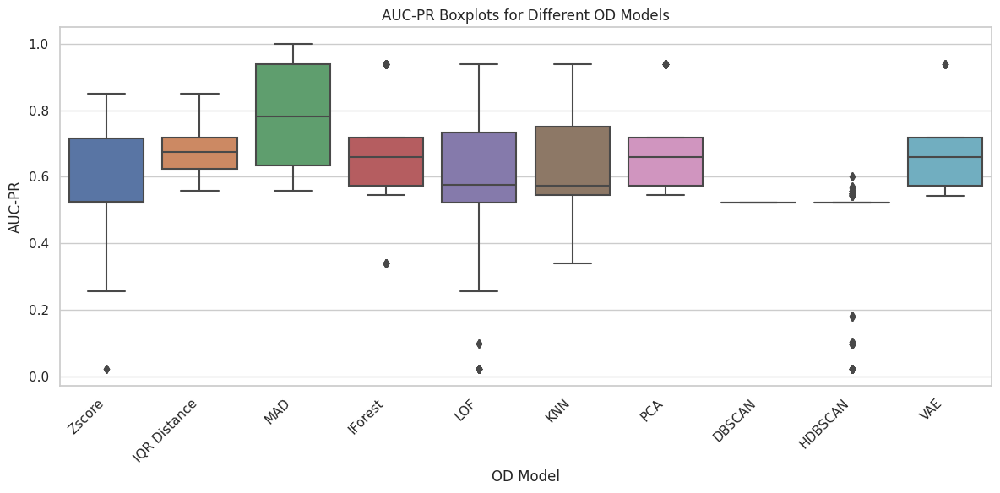

In [108]:
import matplotlib.pyplot as plt
import seaborn as sns

def create_boxplots(result_dfs):
    """
    Create boxplots for each OD model using AUC-PR values from result dataframes.

    Parameters:
    - result_dfs: A list of result dataframes for different OD models.

    Returns:
    - None (displays the boxplots).
    """
    # Initialize a list to store data for each model
    auc_pr_data = []

    # Initialize a list to store model names
    model_names = []

    for df in result_dfs:
        # Assuming 'pr_auc' and 'model_name' columns are present in each dataframe
        model_name = df['model_name'].values[0]
        pr_auc_values = df['pr_auc'].values
        auc_pr_data.append(pr_auc_values)
        model_names.append(model_name)

    # Create a boxplot
    plt.figure(figsize=(12, 6))
    sns.set(style="whitegrid")
    ax = sns.boxplot(data=auc_pr_data)
    ax.set_xticklabels(model_names, rotation=45, ha="right")
    plt.xlabel('OD Model')
    plt.ylabel('AUC-PR')
    plt.title('AUC-PR Boxplots for Different OD Models')
    plt.tight_layout()
    plt.show()

# Example usage:
result_dfs = [results_df_zscore, results_df_iqr_distance, results_df_mad,
              results_df_iforest, results_df_lof, results_df_knn,
              results_df_pca, results_df_dbscan, results_df_hdbscan,
              results_df_vae]  # List of result dataframes
create_boxplots(result_dfs)


##### AUC-ROC and AP

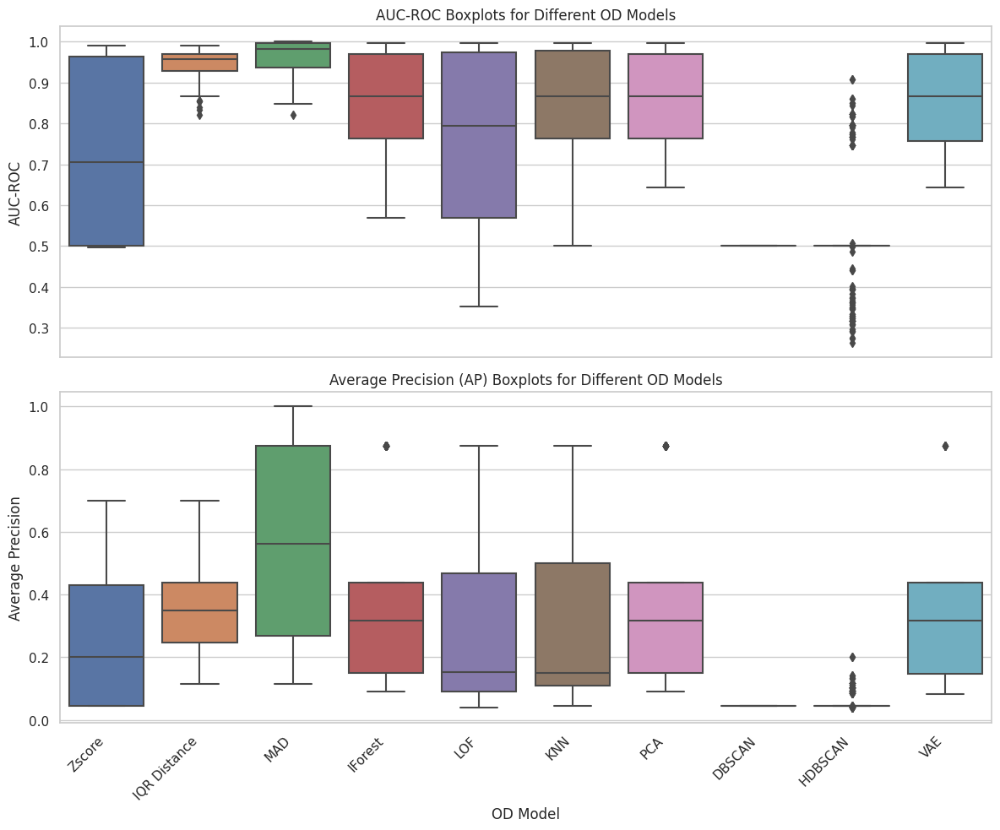

In [109]:
import matplotlib.pyplot as plt
import seaborn as sns

def create_boxplots_auc_roc_ap(result_dfs):
    """
    Create boxplots for AUC-ROC and AP values for each OD model from result dataframes.

    Parameters:
    - result_dfs: A list of result dataframes for different OD models.

    Returns:
    - None (displays the boxplots).
    """
    # Initialize lists to store data for each model
    auc_roc_data = []
    ap_data = []

    # Initialize a list to store model names
    model_names = []

    for df in result_dfs:
        # Assuming 'roc_auc', 'average_precision', and 'model_name' columns are present in each dataframe
        model_name = df['model_name'].values[0]
        roc_auc_values = df['roc_auc'].values
        ap_values = df['average_precision'].values
        auc_roc_data.append(roc_auc_values)
        ap_data.append(ap_values)
        model_names.append(model_name)

    # Create subplots for AUC-ROC and AP boxplots
    fig, axes = plt.subplots(2, 1, figsize=(12, 10))
    sns.set(style="whitegrid")

    # AUC-ROC boxplot
    ax1 = sns.boxplot(data=auc_roc_data, ax=axes[0])
    ax1.set_xticklabels([])
    ax1.set_xlabel('')
    ax1.set_ylabel('AUC-ROC')
    ax1.set_title('AUC-ROC Boxplots for Different OD Models')

    # AP boxplot
    ax2 = sns.boxplot(data=ap_data, ax=axes[1])
    ax2.set_xticklabels(model_names, rotation=45, ha="right")
    ax2.set_xlabel('OD Model')
    ax2.set_ylabel('Average Precision')
    ax2.set_title('Average Precision (AP) Boxplots for Different OD Models')

    plt.tight_layout()
    plt.show()

# Example usage:
result_dfs = [results_df_zscore, results_df_iqr_distance, results_df_mad,
              results_df_iforest, results_df_lof, results_df_knn,
              results_df_pca, results_df_dbscan, results_df_hdbscan,
              results_df_vae]  # List of result dataframes
create_boxplots_auc_roc_ap(result_dfs)


#### PCA Visualization

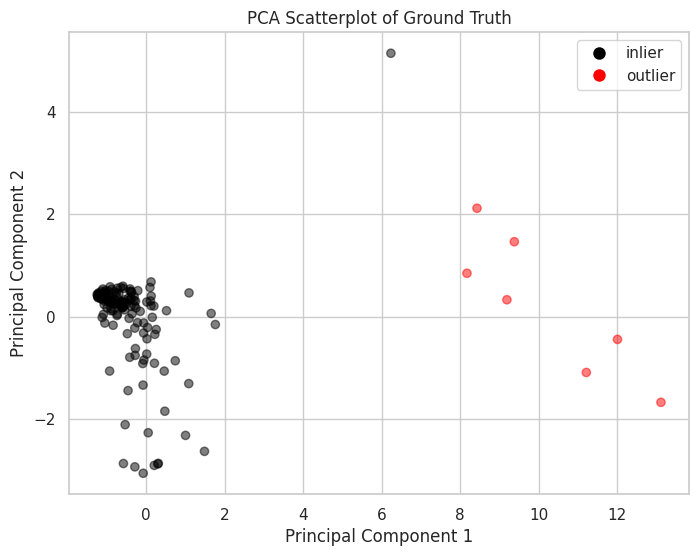

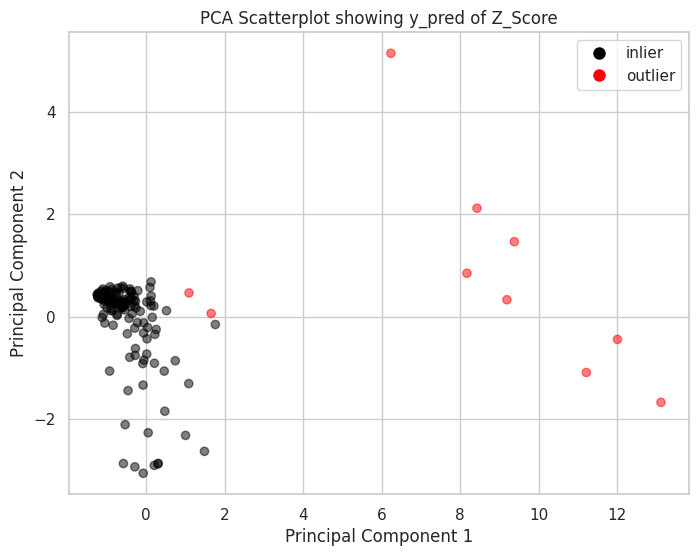

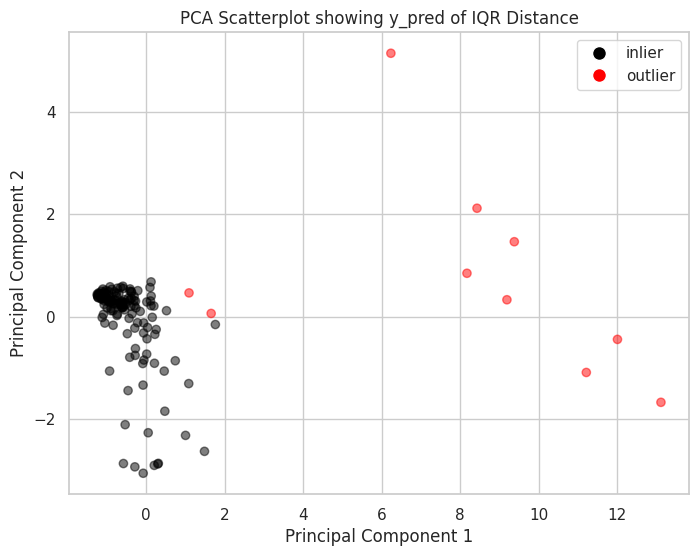

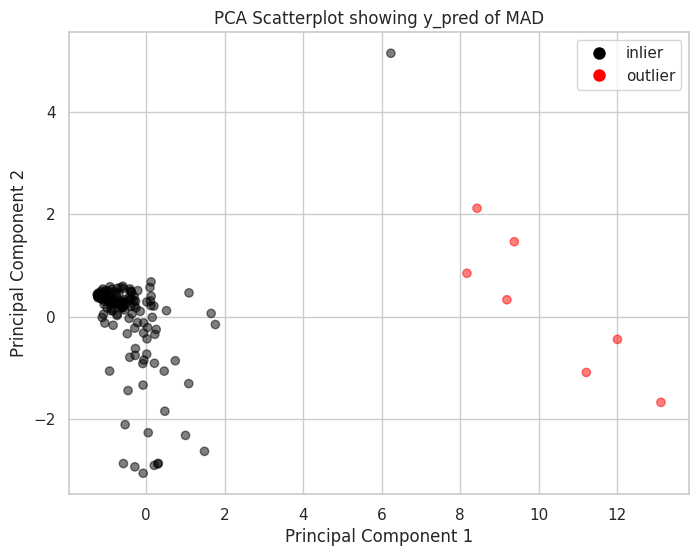

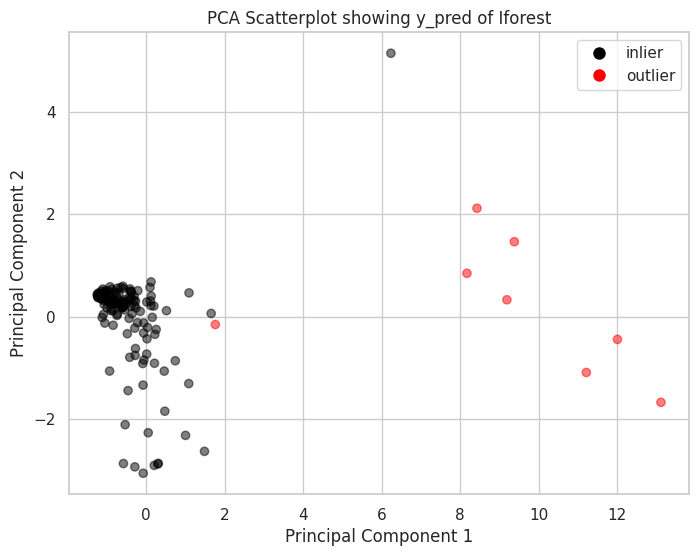

...

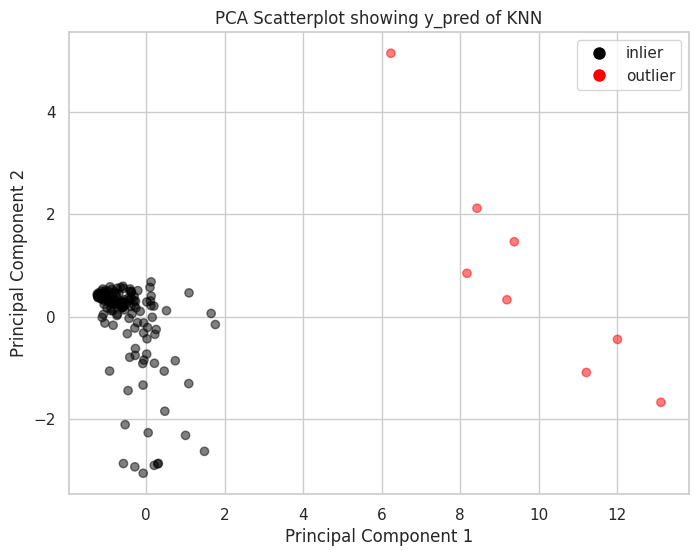

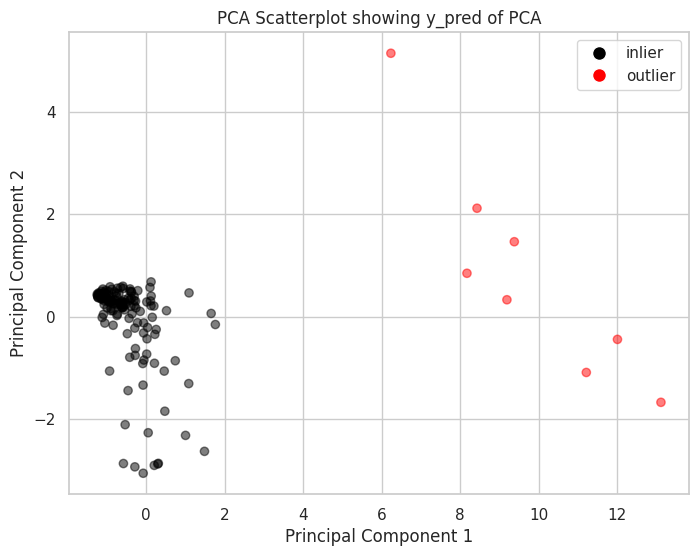

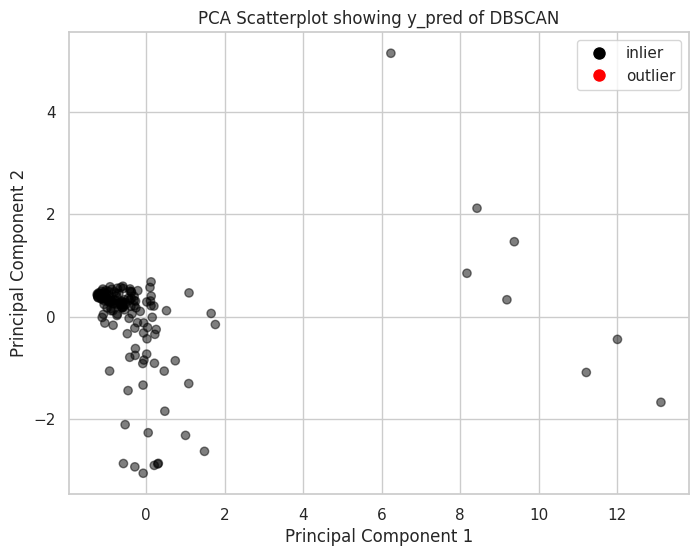

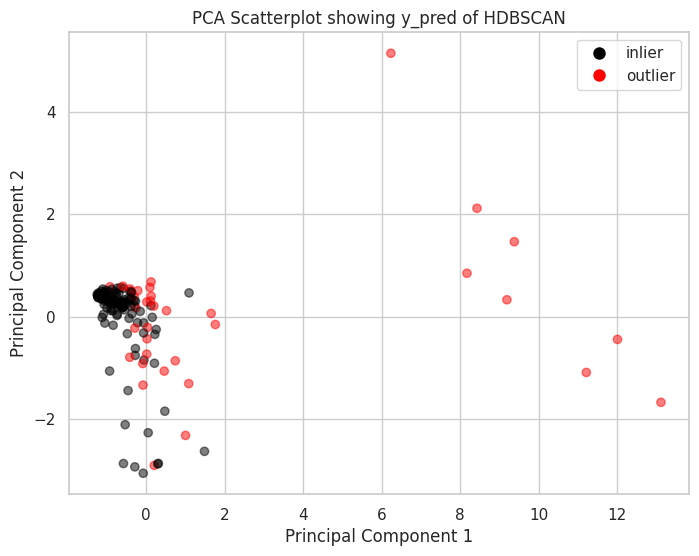

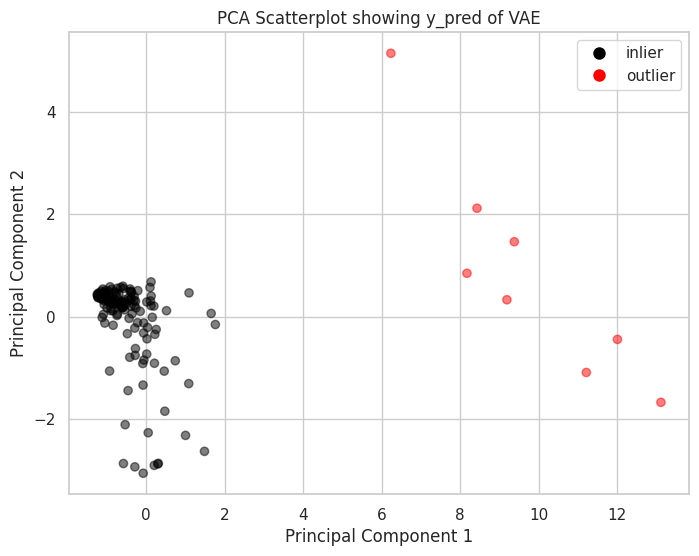

In [110]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA as PCAs
import seaborn as sns

def perform_pca(dataframee):
    """
    Perform Principal Component Analysis (PCA) on feature columns of a dataframe.

    Parameters:
    - dataframe: pandas DataFrame containing feature columns.

    Returns:
    - pca_components: DataFrame containing the PCA components.
    """

    dataframe = copy.deepcopy(dataframee)
    # Exclude 'y_truth' and 'y_pred' columns if present
    if 'y_truth' and 'y_pred' in dataframe.columns:
        features = dataframe.drop(['y_truth', 'y_pred'], axis=1)
    elif 'y_pred' in dataframe.columns:
        features = dataframe.drop(['y_pred'], axis=1)
    else:
      features = dataframe

    # Standardize the features (mean=0, std=1)
    standardized_features = (features - features.mean()) / features.std()

    # Perform PCA
    pca = PCAs()
    pca_components = pca.fit_transform(standardized_features)

    # Create a DataFrame to store the PCA components
    pca_columns = [f'PC{i}' for i in range(1, pca.n_components_ + 1)]
    pca_components_df = pd.DataFrame(data=pca_components, columns=pca_columns)

    return pca_components_df

def plot_pca_scatter(pca_components_df, y_truth, title="PCA Scatterplot of Ground Truth"):
    """
    Create a scatterplot of PCA components and color points based on y_truth.

    Parameters:
    - pca_components_df: DataFrame containing the PCA components.
    - y_truth: Series containing the ground truth labels (0 or 1).

    Returns:
    - None (displays the plot).
    """
    plt.figure(figsize=(8, 6))

    # Define colors based on y_truth (black if 0, red if 1)
    colors = ['black' if label == 0 else 'red' for label in y_truth]

    # Scatterplot the first two PCA components
    plt.scatter(pca_components_df['PC1'], pca_components_df['PC2'], c=colors, alpha=0.5)

    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title(title)
    plt.legend(handles=[plt.Line2D([0], [0], marker='o', color='w', label='inlier', markerfacecolor='black', markersize=10),
                        plt.Line2D([0], [0], marker='o', color='w', label='outlier', markerfacecolor='red', markersize=10)])

    plt.show()

pca_result = perform_pca(original_df_zscore)
plot_pca_scatter(pca_result, original_df_zscore['y_truth'])



original_dfs = [original_df_zscore, original_df_iqr_distance, original_df_mad,
              original_df_iforest, original_df_lof, original_df_knn,
              original_df_pca, original_df_dbscan, original_df_hdbscan,
              original_df_vae]  # List of result dataframes
od_model_names = ["Z_Score", "IQR Distance", "MAD",
                  'Iforest', 'LOF', 'KNN',
                  'PCA', 'DBSCAN', 'HDBSCAN',
                  'VAE']

for i in range(len(original_dfs)):
  plot_pca_scatter(pca_result, original_dfs[i]['y_pred'], title = f'PCA Scatterplot showing y_pred of {od_model_names[i]}')



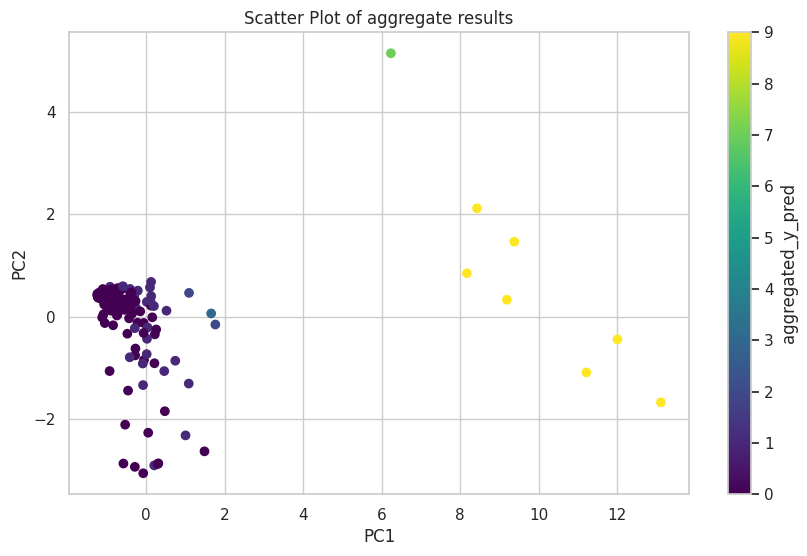

In [111]:
def aggregate_y_pred(dataframes):
  dataframes = dataframes

  # Create an empty dataframe to store aggregated y_pred
  combined_y_pred = pd.DataFrame()

  # Iterate through the list of dataframes and concatenate their y_pred columns
  for df in dataframes:
      if 'y_pred' in df.columns:
          combined_y_pred = pd.concat([combined_y_pred, df['y_pred']], axis=1)

  # Sum along columns to aggregate y_pred values
  aggregated_y_pred = combined_y_pred.sum(axis=1)

  # Assuming you want to create a new dataframe with y_pred values
  aggregated_y_pred_df = pd.DataFrame({'aggregated_y_pred': aggregated_y_pred})

  return aggregated_y_pred_df


def scatter_plot_with_color(dataframe1, x_feature, y_feature, dataframe2, color_feature, title="Scatter Plot"):
    """
    Create a scatter plot with points colored by a categorical feature.

    Parameters:
    - dataframe1: First dataframe containing the x and y features.
    - x_feature: Name of the x-axis feature in dataframe1.
    - y_feature: Name of the y-axis feature in dataframe1.
    - dataframe2: Second dataframe containing the categorical color feature.
    - color_feature: Name of the categorical feature in dataframe2 used for coloring points.
    - title: Title of the scatter plot (default is "Scatter Plot").

    Returns:
    - None (displays the scatter plot).
    """
    # Check if the provided features exist in the dataframes
    if x_feature not in dataframe1.columns or y_feature not in dataframe1.columns:
        raise ValueError("x_feature or y_feature not found in dataframe1 columns.")

    if color_feature not in dataframe2.columns:
        raise ValueError("color_feature not found in dataframe2 columns.")

    # Create a scatter plot
    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(dataframe1[x_feature], dataframe1[y_feature], c=dataframe2[color_feature], cmap='viridis')

    # Add colorbar
    plt.colorbar(scatter, label=color_feature)

    # Set labels and title
    plt.xlabel(x_feature)
    plt.ylabel(y_feature)
    plt.title(title)

    # Show the plot
    plt.show()


original_dfs = [original_df_zscore, original_df_iqr_distance, original_df_mad,
              original_df_iforest, original_df_lof, original_df_knn,
              original_df_pca, original_df_dbscan, original_df_hdbscan,
              original_df_vae]

aggregate_y_preds = aggregate_y_pred(original_dfs)

scatter_plot_with_color(pca_result, 'PC1', 'PC2', aggregate_y_preds, 'aggregated_y_pred', title="Scatter Plot of aggregate results")

### Fleiss Kappa

In [112]:
!pip install statsmodels

In [113]:
def merge_y_pred_columns(dataframes, model_names):
    """
    Merge the 'y_pred' columns from multiple dataframes into a single dataframe.

    Parameters:
    - dataframes: A list of dataframes, each containing a 'y_pred' column.
    - model_names: A list of model names corresponding to the dataframes.

    Returns:
    - A new dataframe containing 'y_pred' columns for each model.
    """
    # Create an empty dataframe to store merged 'y_pred' columns
    merged_df = pd.DataFrame()

    # Iterate through the dataframes and model names
    for df, model_name in zip(dataframes, model_names):
        # Rename the 'y_pred' column to 'y_pred_{model_name}'
        mdf = df.rename(columns={'y_pred': f'y_pred_{model_name}'})

        # Merge the 'y_pred' column into the merged dataframe
        if merged_df.empty:
            merged_df = mdf[[f'y_pred_{model_name}']]
        else:
            merged_df = pd.concat([merged_df, df[[f'y_pred_{model_name}']]], axis=1)

    return merged_df


original_dfs = [original_df_zscore, original_df_iqr_distance, original_df_mad,
              original_df_iforest, original_df_lof, original_df_knn,
              original_df_pca, original_df_dbscan, original_df_hdbscan,
              original_df_vae]  # List of result dataframes
od_model_names = ["Z_Score", "IQR Distance", "MAD",
                  'Iforest', 'LOF', 'KNN',
                  'PCA', 'DBSCAN', 'HDBSCAN',
                  'VAE']

merged_y_pred_df = merge_y_pred_columns(original_dfs, od_model_names)
merged_y_pred_df

,y_pred_Z_Score,y_pred_IQR Distance,y_pred_MAD,y_pred_Iforest,y_pred_LOF,y_pred_KNN,y_pred_PCA,y_pred_DBSCAN,y_pred_HDBSCAN,y_pred_VAE
0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...
152,1,1,1,1,1,1,1,0,1,1
153,1,1,1,1,1,1,1,0,1,1
154,1,1,1,1,1,1,1,0,1,1
155,1,1,1,1,1,1,1,0,1,1


In [114]:
from statsmodels.stats import inter_rater as irr


def fleiss_kappa(numpyndarray):
    numpy_array = irr.aggregate_raters(numpyndarray)[0]
    N, k = numpy_array.shape  # N = Number of subjects, k = Number of categories
    print(N,k)

    # Calculate the matrix of observed agreement (O)
    O = np.zeros((N, k))
    for i in range(N):
        for j in range(k):
            O[i, j] = np.sum(numpy_array[i, :] == j)

    # Calculate the proportion of agreement (P_e)
    P_e = np.sum((O ** 2).sum(axis=1) - O.sum(axis=1)) / (N * (N - 1))

    # Calculate the proportion of agreement by chance (P)
    P = np.sum((np.sum(O, axis=0) ** 2) - np.sum(O, axis=0)) / (N * (N - 1))

    # Calculate Fleiss' Kappa (Kappa)
    print(P, P_e)
    Kappa = (P - P_e) / (1 - P_e)

    return Kappa

# Example usage:
# Assuming 'data' is your numpy array
kappa_value = fleiss_kappa(merged_y_pred_df.values)
print("Fleiss' Kappa:", kappa_value)

157 2
0.6333496651967989 0.0
Fleiss' Kappa: 0.6333496651967989


## Testing Real Data by using best Hyperparameter

In [115]:
clean_df

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256


In [116]:
df_prep_real = copy.deepcopy(clean_df.drop(remove_df_col_list, axis = 1))
df_real = copy.deepcopy(clean_df)
df_prep_real

,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan
0,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000
1,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000
2,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072
3,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532
4,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000
...,...,...,...,...,...,...,...,...,...
145,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513
146,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339
147,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250
148,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256


In [117]:
df_real_pca = perform_pca(df_prep_real)

#### Z-Score

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


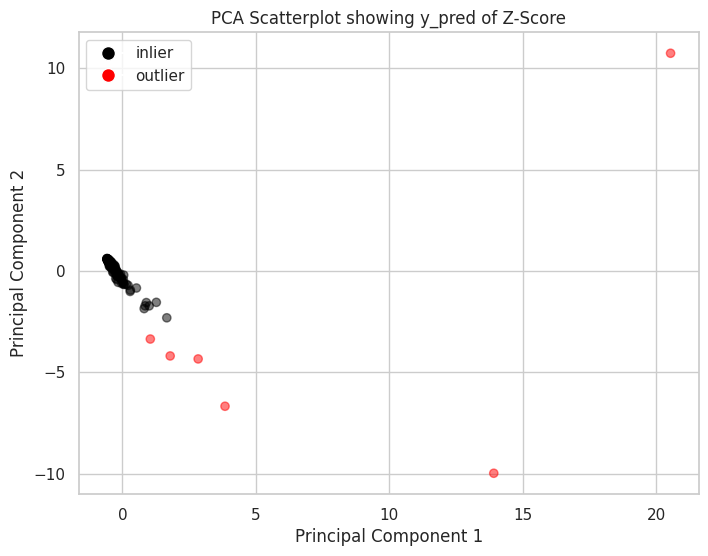

In [118]:
def zscore_outlier_detection(dataframe, dataframe_full, threshold=3.7):
    """
    Perform Z-Score outlier detection on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - threshold: Z-Score threshold for classifying outliers.

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Calculate Z-scores for the data
    z_scores = np.abs(zscore(dataframe))


    y_pred = (z_scores > threshold).any(axis=1).astype(int)

    # Apply the threshold to classify outliers
    y_pred = (z_scores > threshold).any(axis=1).astype(int)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred


    return [new_dataframe, new_dataframe_full]

real_zscore = zscore_outlier_detection(df_prep_real, df_real)
display(real_zscore[1])
plot_pca_scatter(df_real_pca, real_zscore[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of Z-Score')

harta_tanah_dan_bangunan


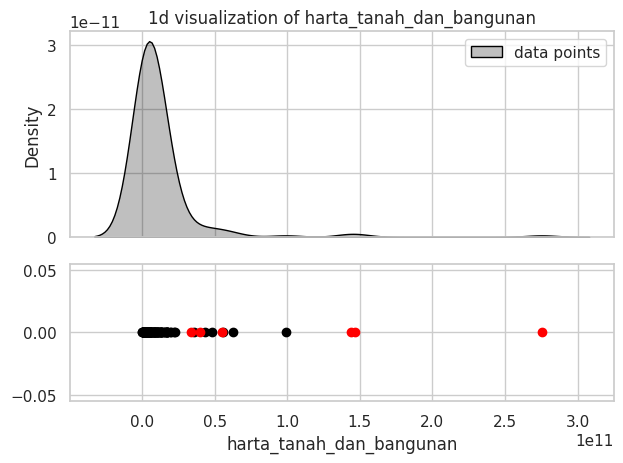

harta_alat_transportasi_dan_mesin


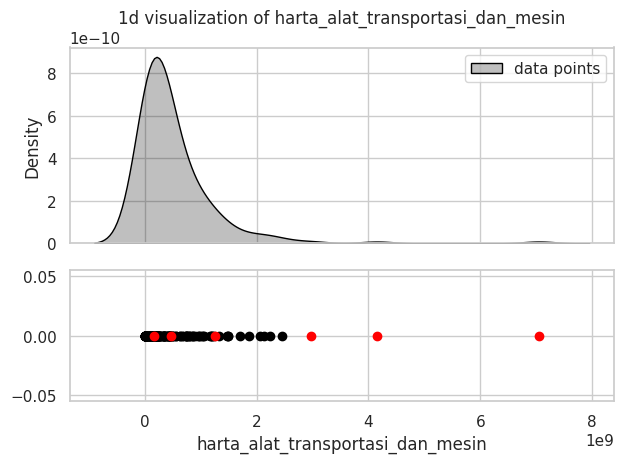

harta_bergerak_lainnya


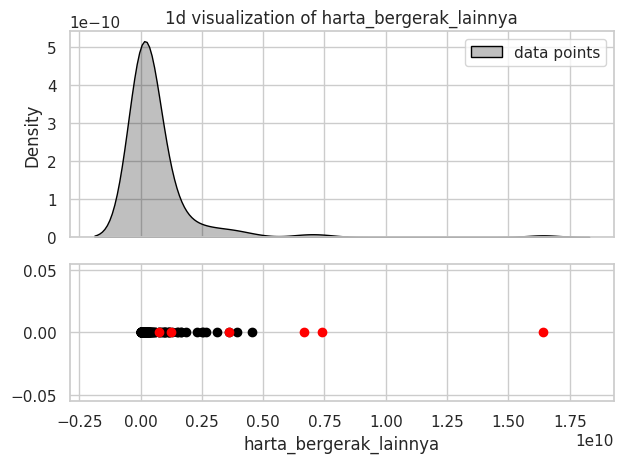

surat_berharga


In [ ]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_zscore[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_zscore[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### IQR Distance

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


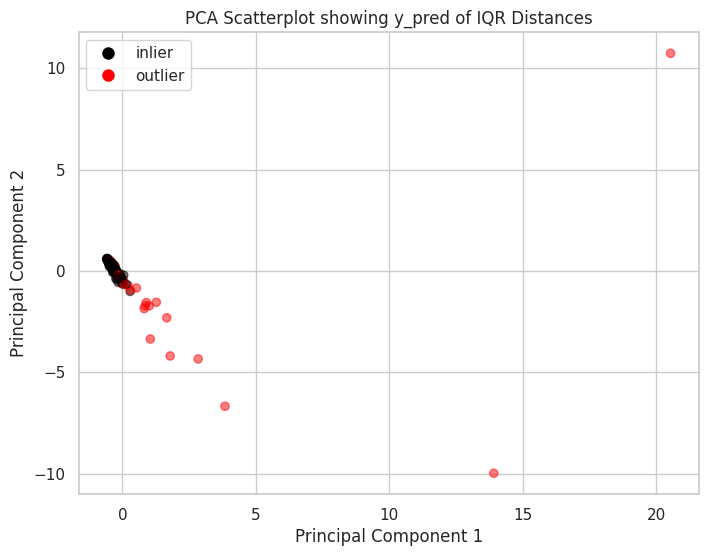

In [151]:
def iqr_outlier_detection(dataframe, dataframe_full, threshold_multiplier=8.4):
    """
    Perform IQR Score outlier detection on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: Original pandas DataFrame (without outlier detection).
    - threshold_multiplier: Multiplier for the IQR threshold.

    Returns:
    - A list containing two DataFrames:
      1. The original DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
      2. The full original DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Calculate the first quartile (Q1) and third quartile (Q3) for each column
    Q1 = dataframe.quantile(0.25)
    Q3 = dataframe.quantile(0.75)

    # Calculate the IQR (Interquartile Range) for each column
    IQR = Q3 - Q1

    # Define the lower and upper bounds for each column based on the IQR
    lower_bound = Q1 - threshold_multiplier * IQR
    upper_bound = Q3 + threshold_multiplier * IQR

    y_pred = (((dataframe < lower_bound) | (dataframe > upper_bound)).any(axis=1)).astype(int)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred

    return [new_dataframe, new_dataframe_full]

real_iqr_distance = iqr_outlier_detection(df_prep_real, df_real)
display(real_iqr_distance[1])
plot_pca_scatter(df_real_pca, real_iqr_distance[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of IQR Distances')

harta_tanah_dan_bangunan


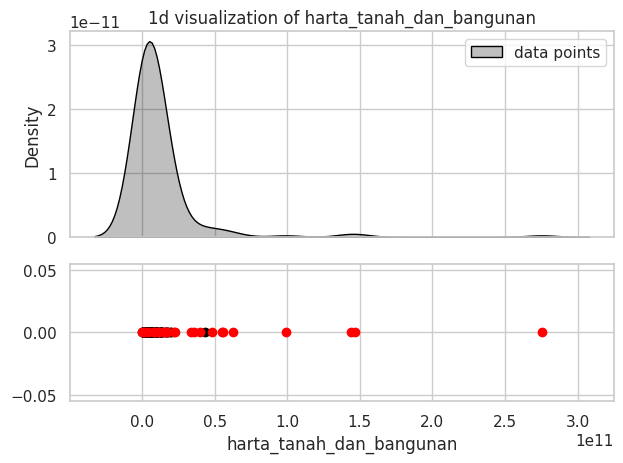

harta_alat_transportasi_dan_mesin


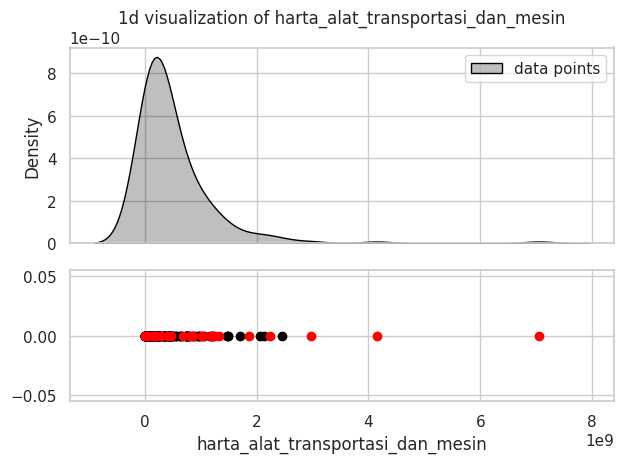

harta_bergerak_lainnya


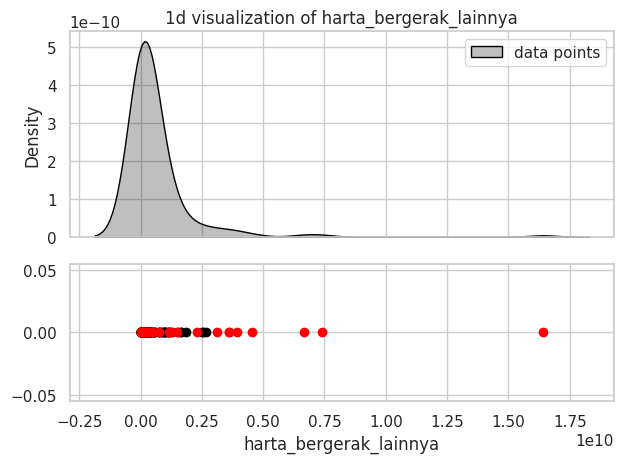

surat_berharga


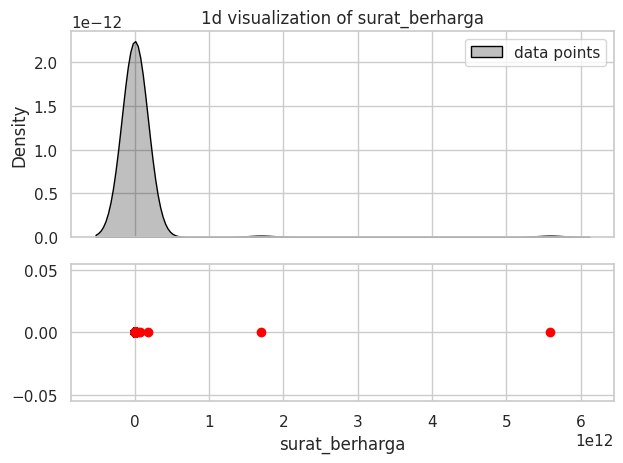

harta_kas_dan_setara_kas


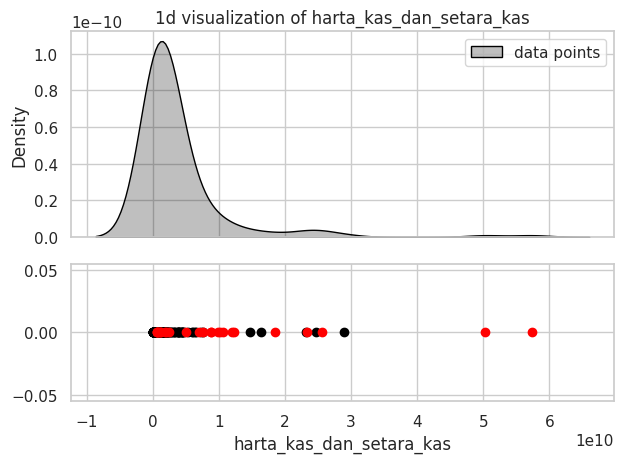

harta_lainnya


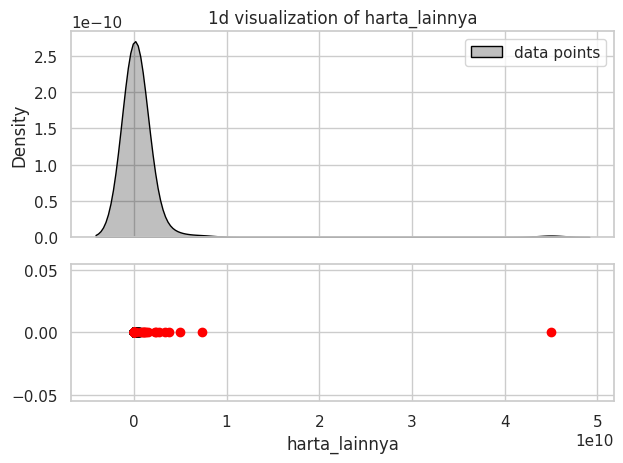

sub_total


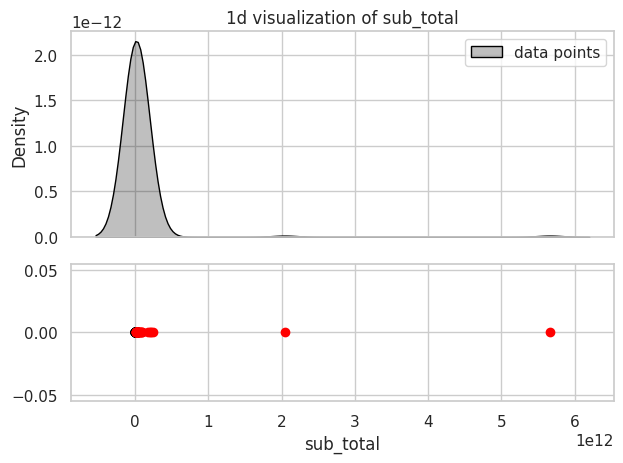

hutang


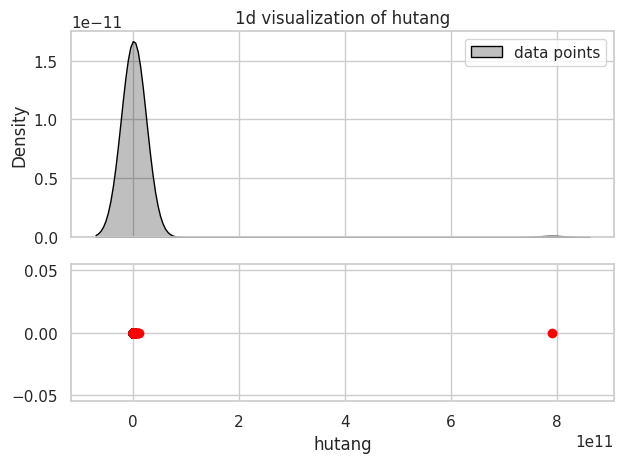

total_harta_kekayaan


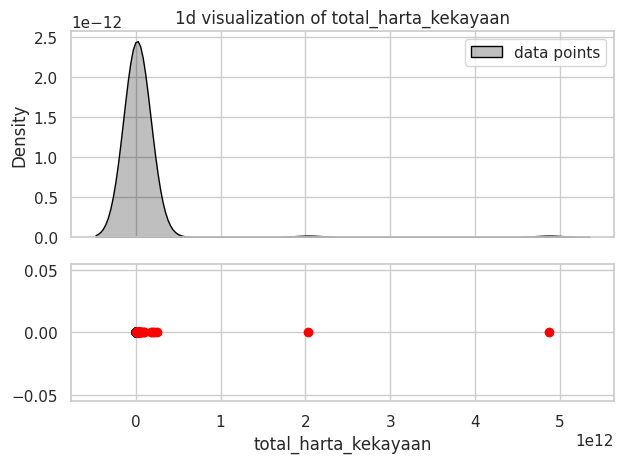

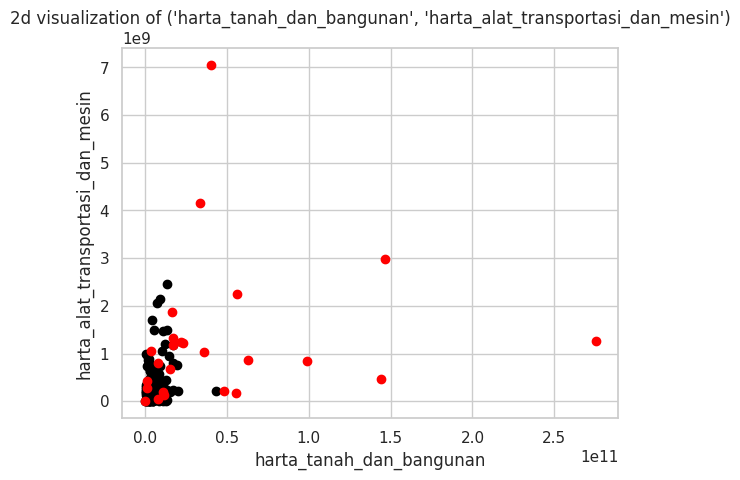

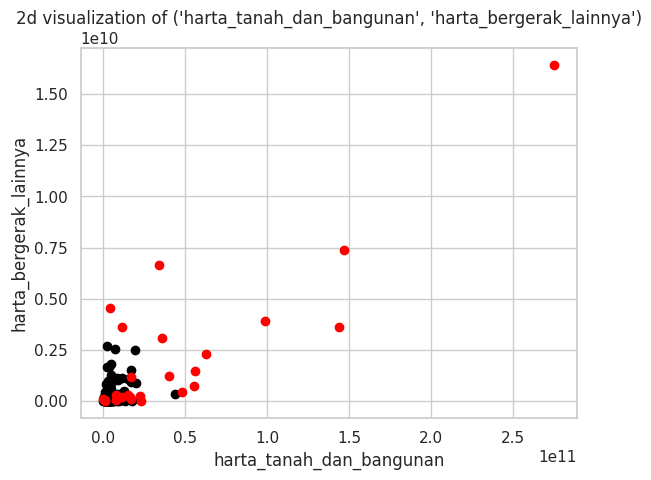

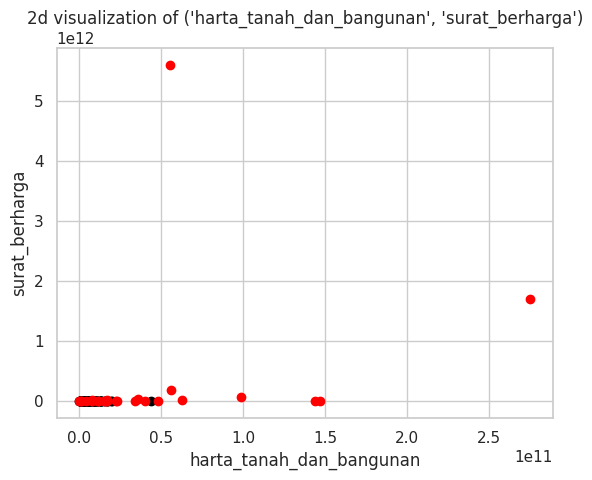

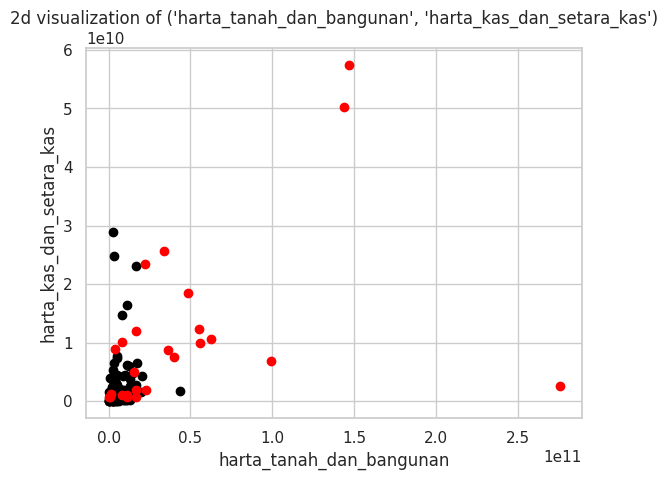

...

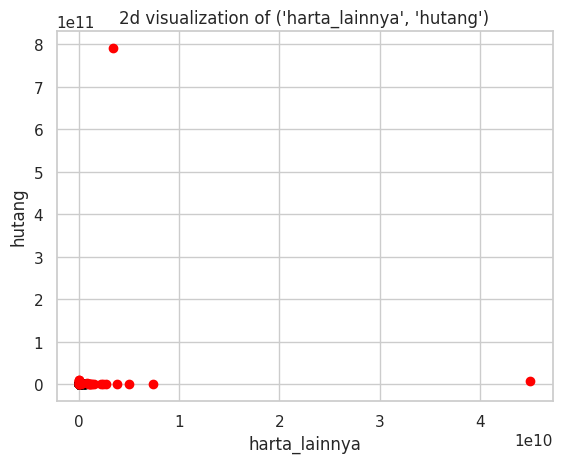

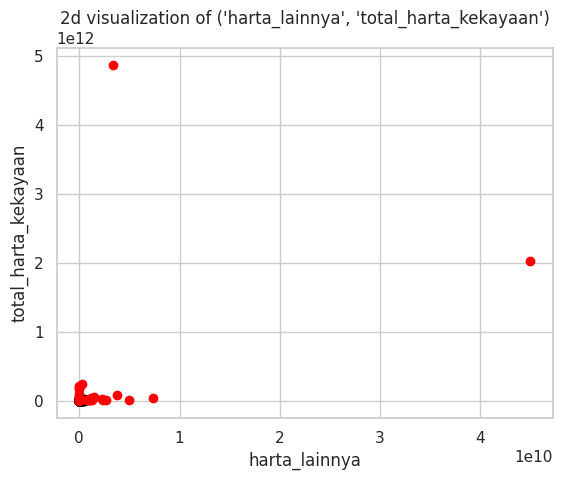

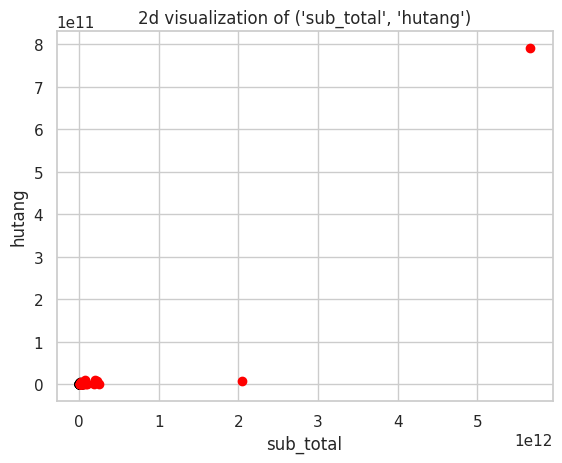

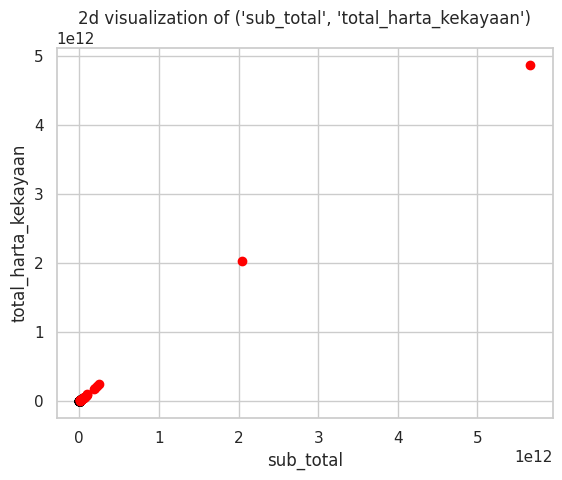

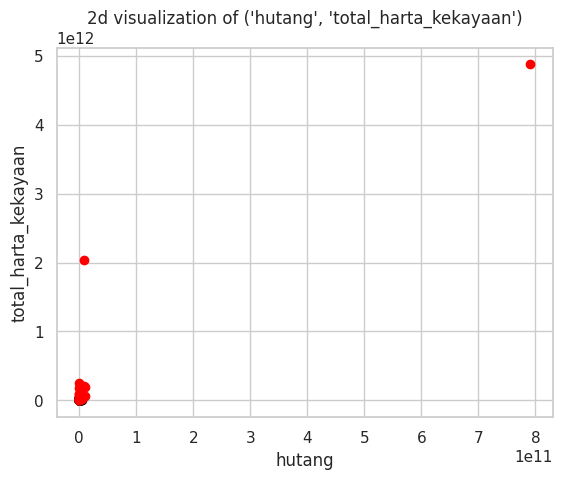

In [144]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_iqr_distance[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_iqr_distance[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### MAD

[2.77447250e+09 1.99500000e+08 1.45387790e+08 0.00000000e+00
 1.02783604e+09 0.00000000e+00 4.21367439e+09 0.00000000e+00
 4.16228202e+09]
[           nan            nan            nan            nan
            nan            nan 1.08193405e+00            nan
            nan            nan            nan            nan
            nan            nan            nan            nan
            nan            nan            nan            nan
            nan            nan 2.02721231e+01            nan
            nan            nan            nan            nan
            nan            nan            nan            nan
            nan            nan            nan            nan
            nan            nan 6.69958545e+00            nan
 1.05984298e+01            nan            nan            nan
            nan            nan            nan            nan
            nan            nan            nan            nan
            nan            nan            nan            nan
       

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,0
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


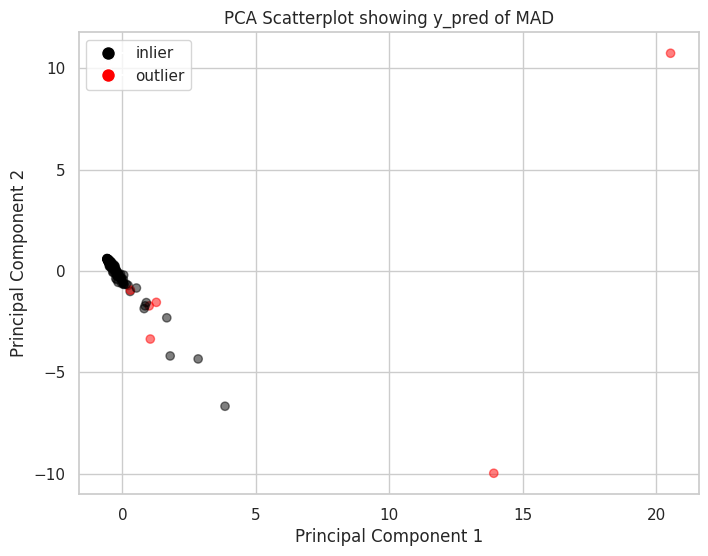

In [152]:
def mad_outlier_detection(dataframe, dataframe_full, threshold_multiplier=7.8):
    """
    Perform Median Absolute Deviation (MAD) outlier detection on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - threshold_multiplier: MAD threshold multiplier for classifying outliers.

    Returns:
    - A list of two DataFrames:
      1. The first DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
      2. The second DataFrame (dataframe_full) with the 'y_pred' column added.
    """

    # Calculate the median of each feature
    median_values = np.median(dataframe, axis=0)

    # Calculate the MAD (Median Absolute Deviation) for each feature
    mad_values = np.median(np.abs(dataframe - median_values), axis=0)
    print(mad_values)

    # Calculate the MAD-based anomaly scores for each data point
    mad_scores = np.median(np.abs(dataframe - median_values) / mad_values, axis=1)
    #mad_scores = np.abs(dataframe - median_values) / mad_values
    print(mad_scores)

    # Apply the threshold to classify outliers
    y_pred = (mad_scores > threshold_multiplier).astype(int)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred

    return [new_dataframe, new_dataframe_full]

real_mad = mad_outlier_detection(df_prep_real, df_real)
display(real_mad[1])
plot_pca_scatter(df_real_pca, real_mad[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of MAD')

harta_tanah_dan_bangunan


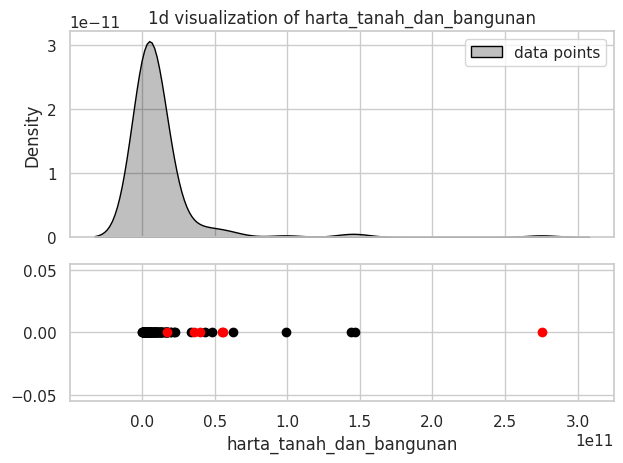

harta_alat_transportasi_dan_mesin


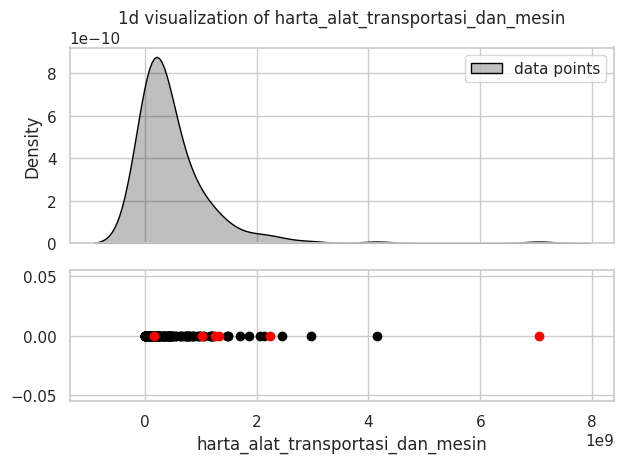

harta_bergerak_lainnya


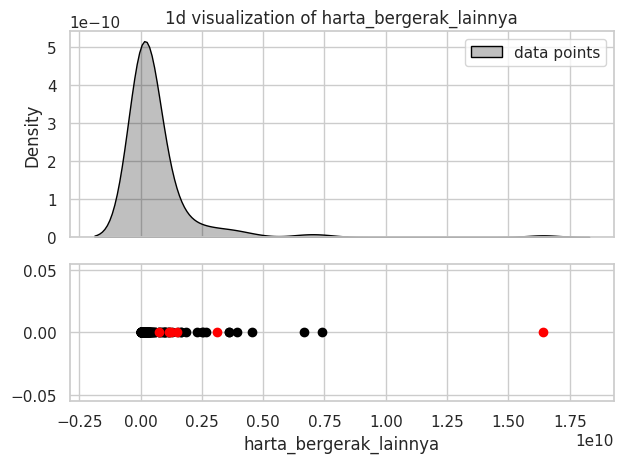

surat_berharga


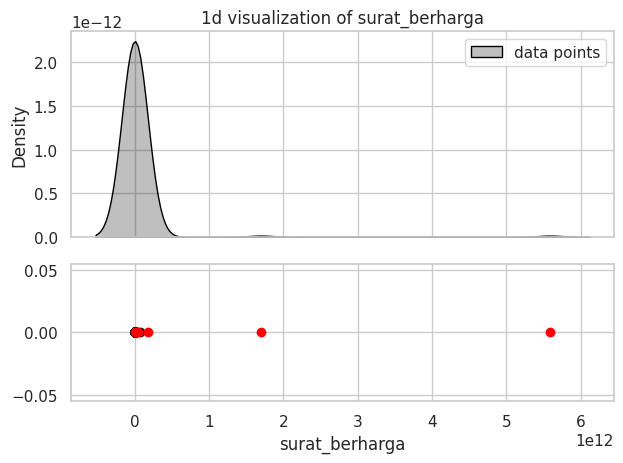

harta_kas_dan_setara_kas


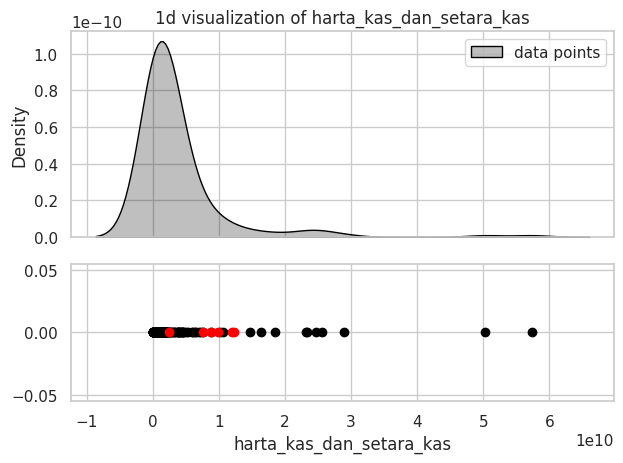

harta_lainnya


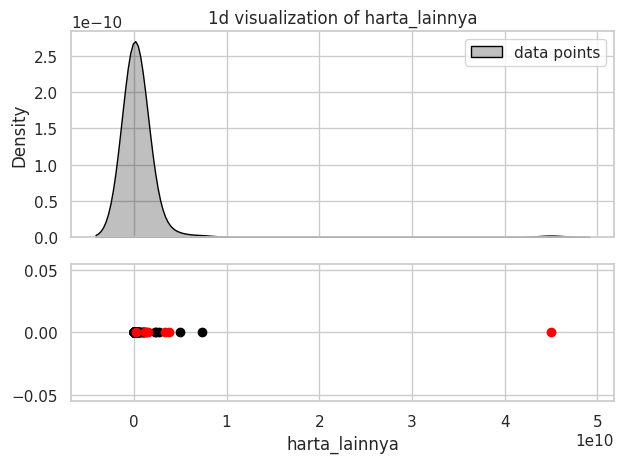

sub_total


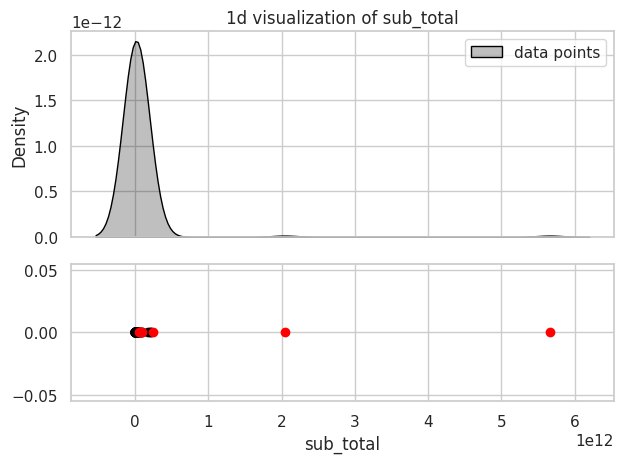

hutang


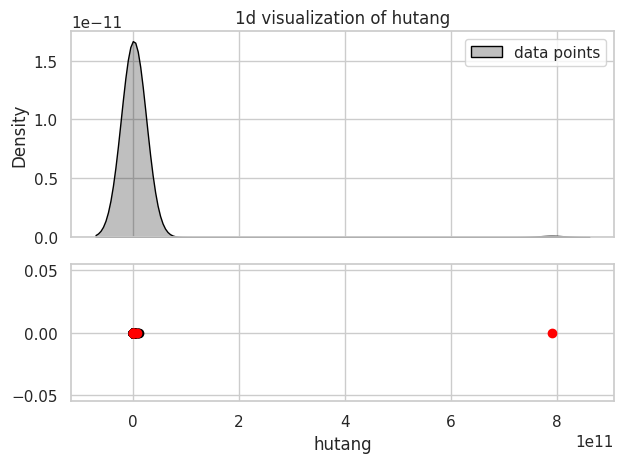

total_harta_kekayaan


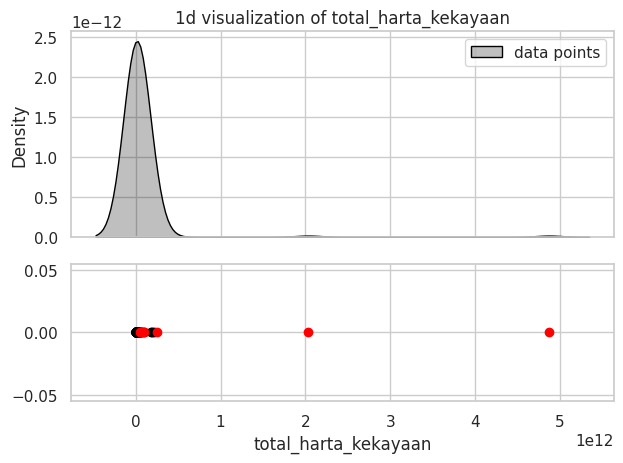

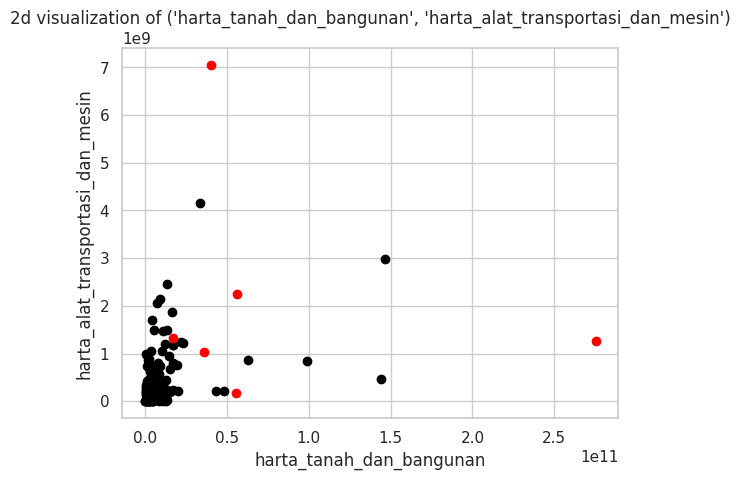

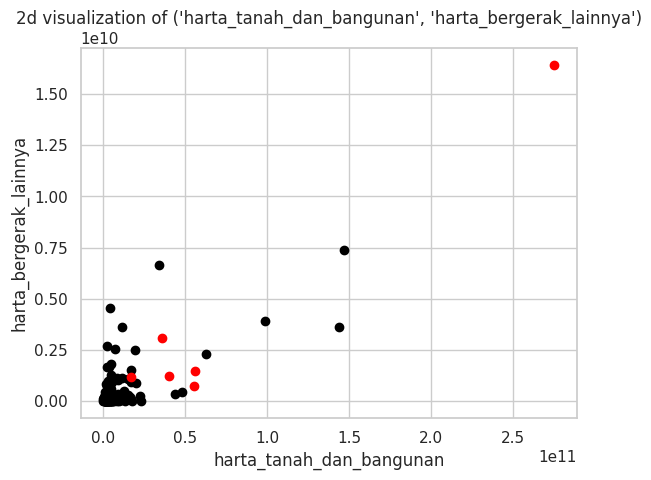

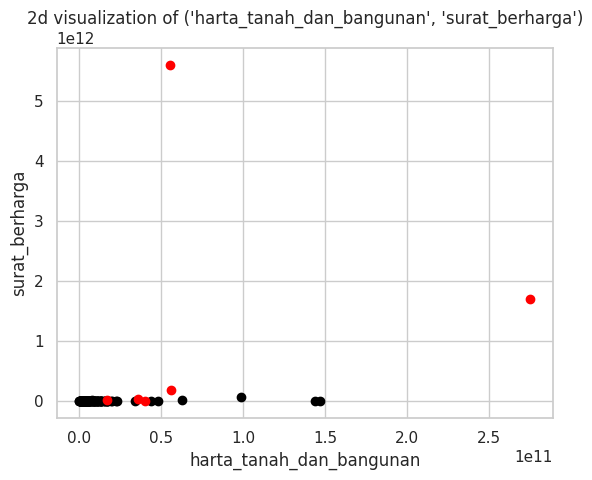

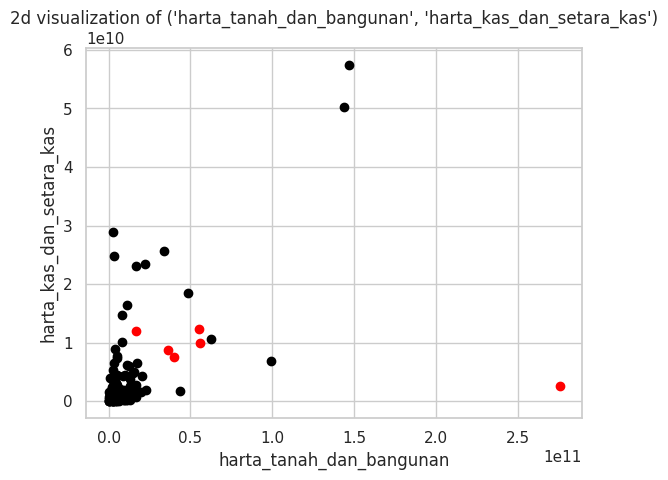

...

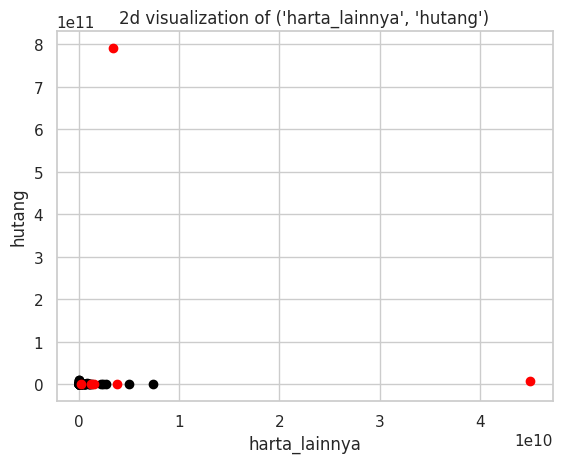

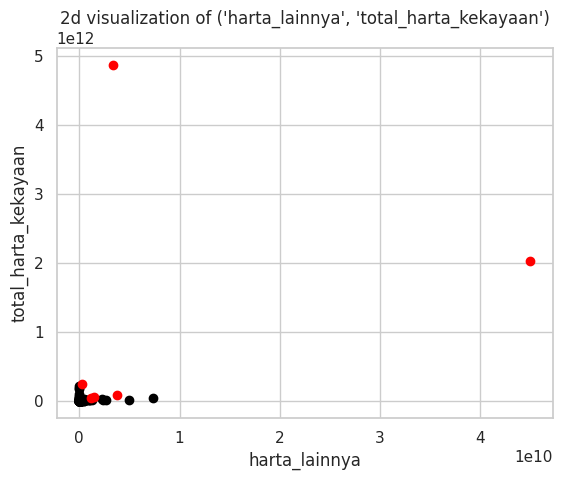

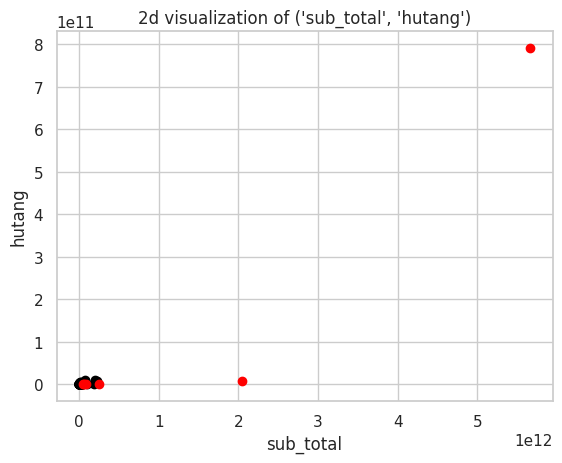

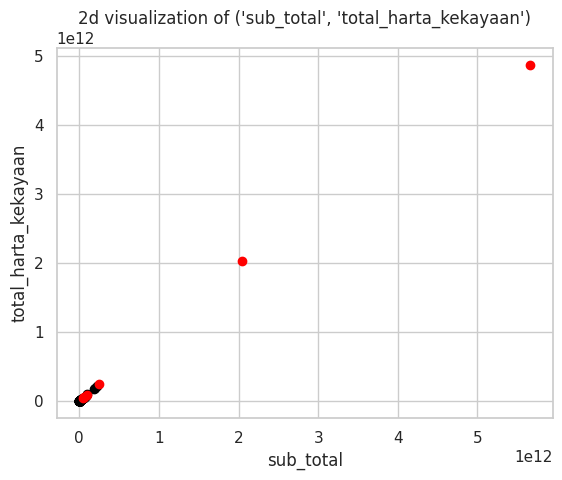

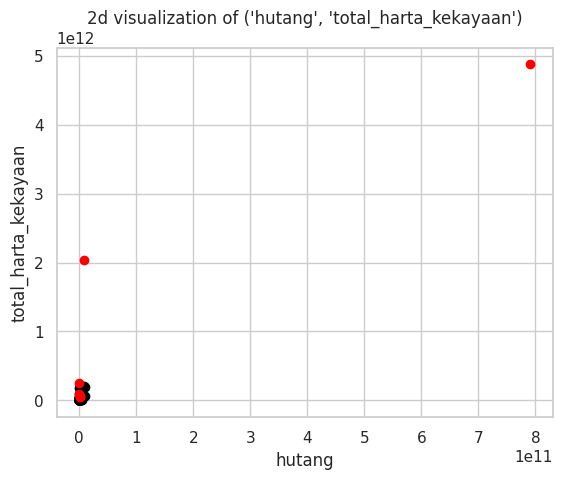

In [145]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_mad[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_mad[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### Isolation Forest

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


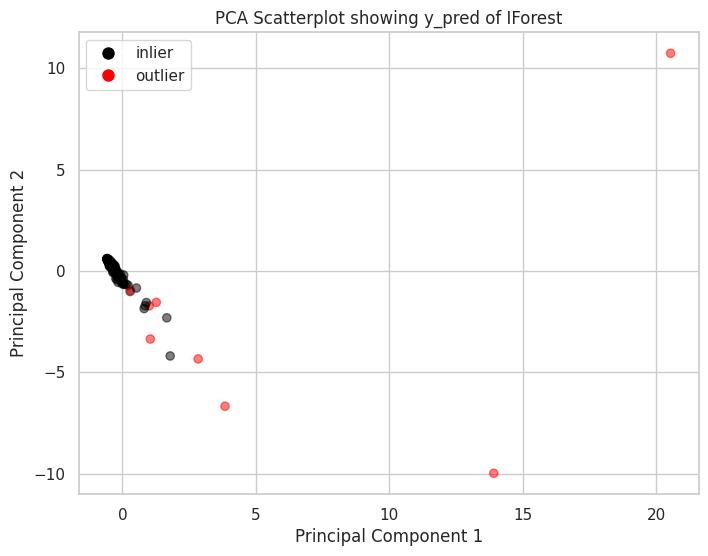

In [153]:
def isolation_forest_outlier_detection(dataframe, dataframe_full, n_estimators=10, max_features=0.1, contamination=0.05):
    """
    Perform Isolation Forest outlier detection using PyOD on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - n_estimators: The number of base estimators in the ensemble.
    - max_features: The number of features to draw from the total features when splitting a node.
    - contamination: The proportion of outliers in the data.

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Create and train the Isolation Forest model
    model = IForest(n_estimators=n_estimators, max_features=max_features, contamination=contamination, random_state=0)
    model.fit(dataframe.values)

    # Get predicted labels (y_pred) from the model
    y_pred = model.predict(dataframe.values)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred
    return [new_dataframe, new_dataframe_full]

real_Iforest = isolation_forest_outlier_detection(df_prep_real, df_real)
display(real_Iforest[1])
plot_pca_scatter(df_real_pca, real_Iforest[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of IForest')

harta_tanah_dan_bangunan


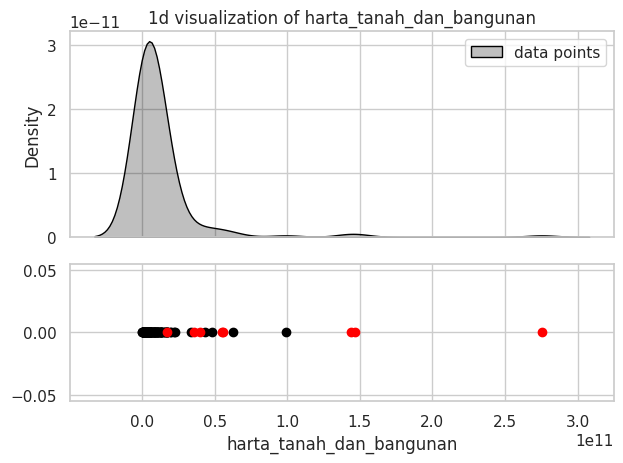

harta_alat_transportasi_dan_mesin


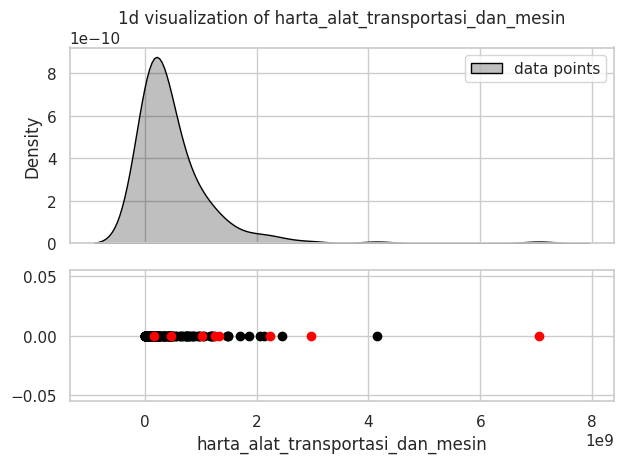

harta_bergerak_lainnya


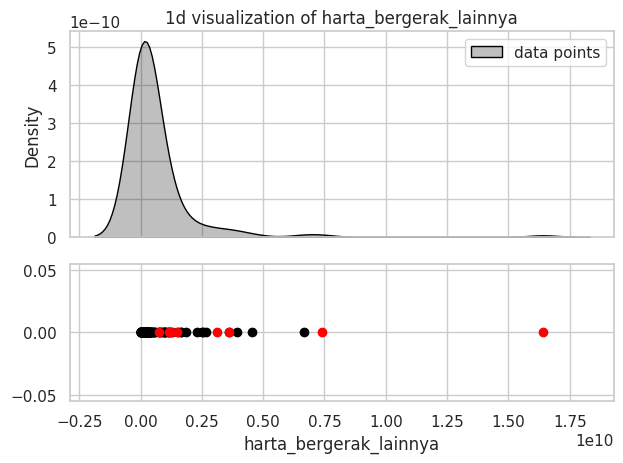

surat_berharga


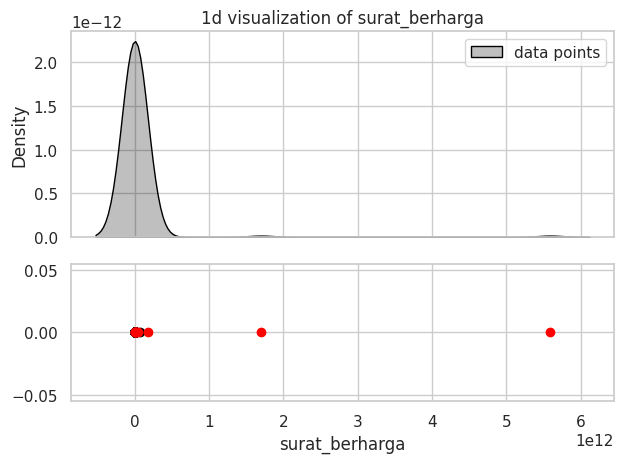

harta_kas_dan_setara_kas


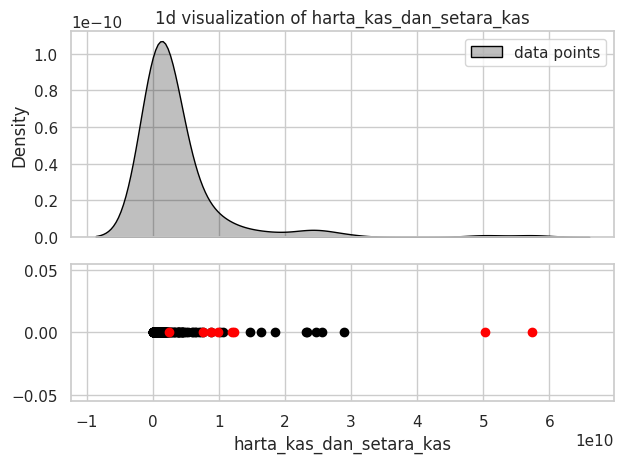

harta_lainnya


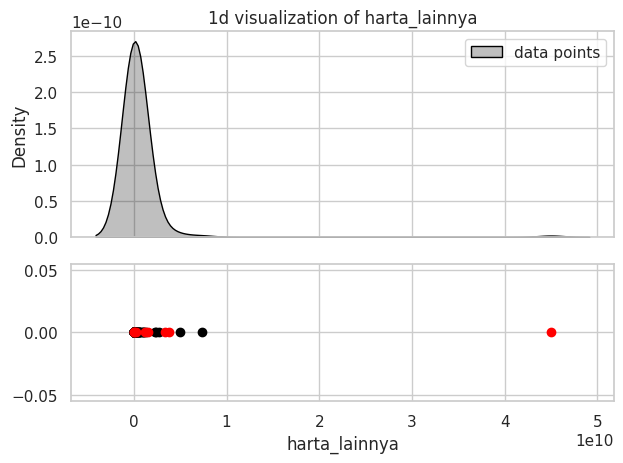

sub_total


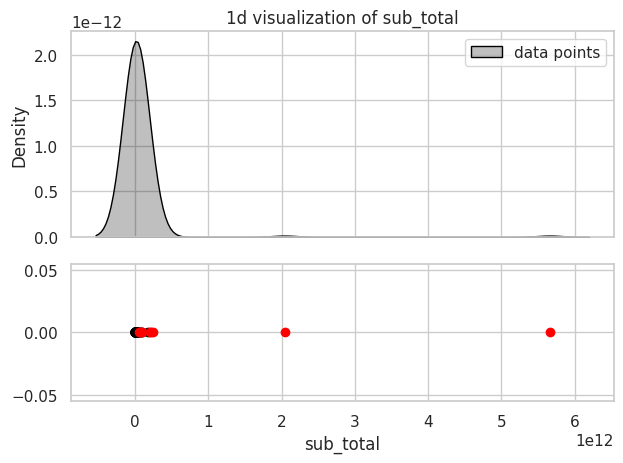

hutang


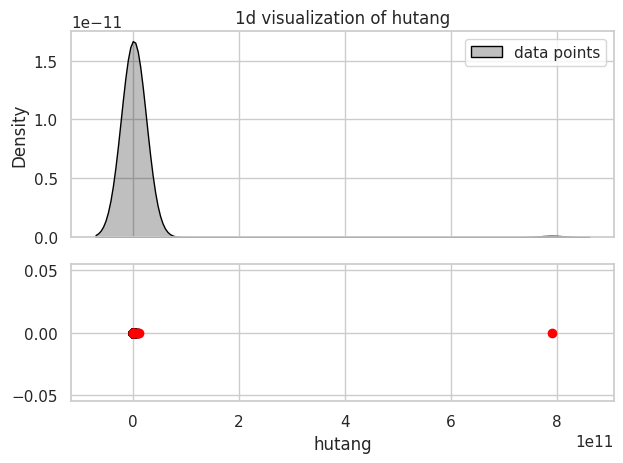

total_harta_kekayaan


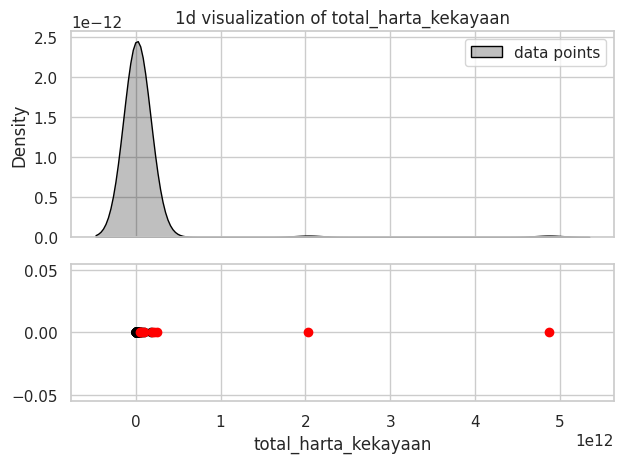

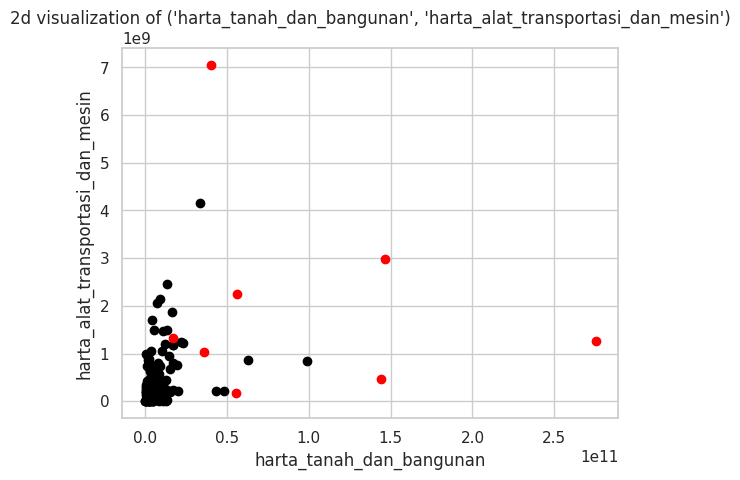

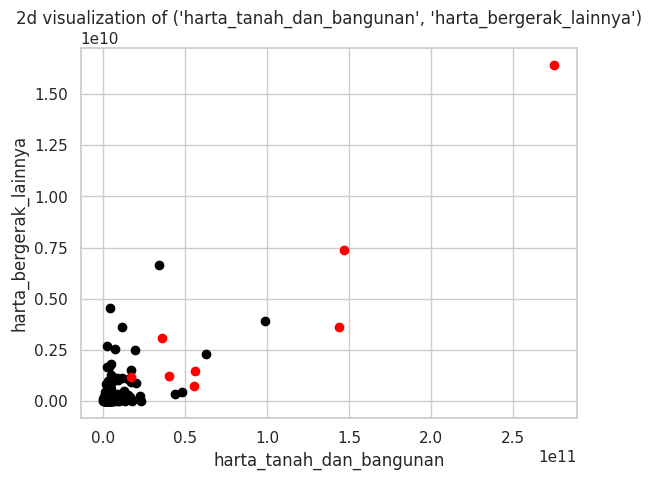

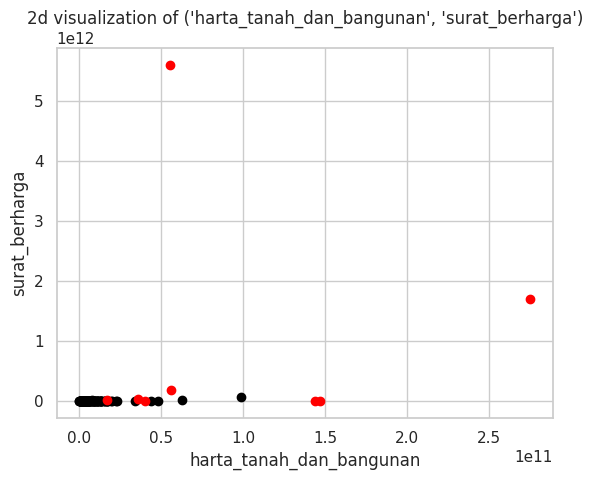

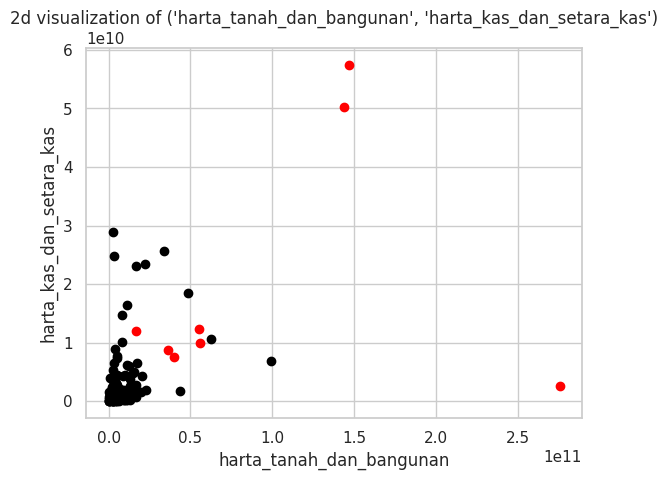

...

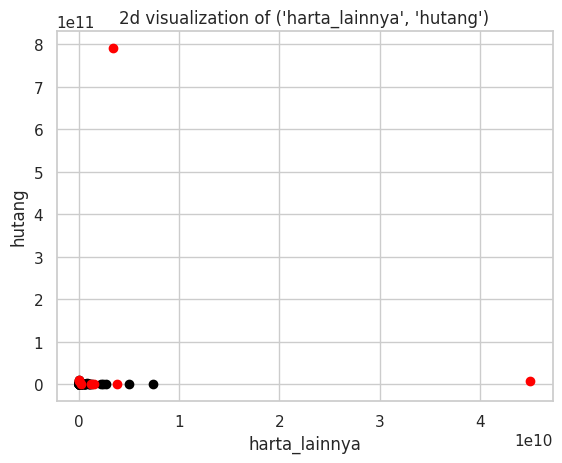

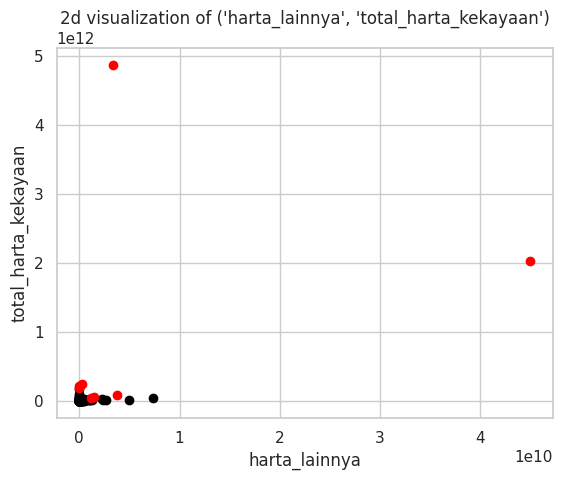

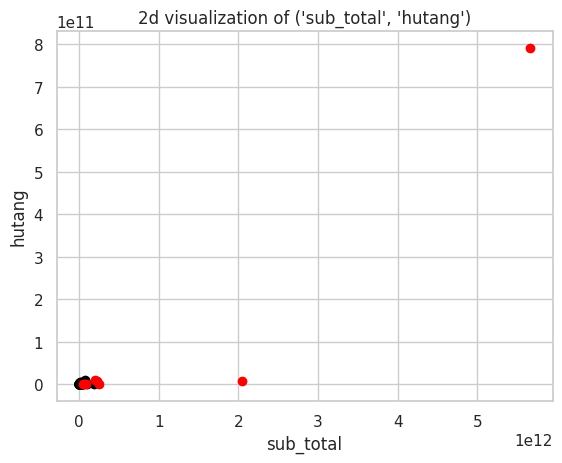

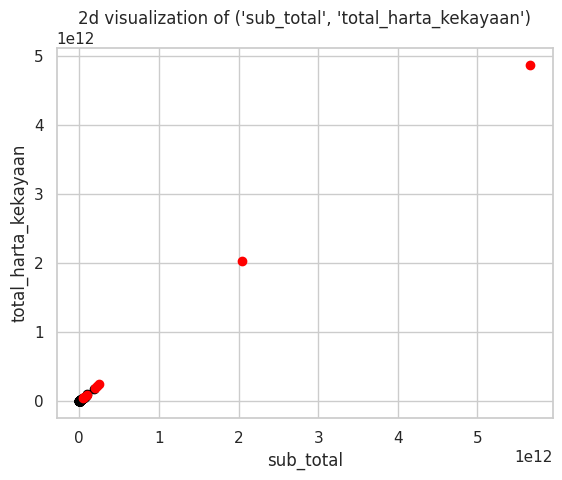

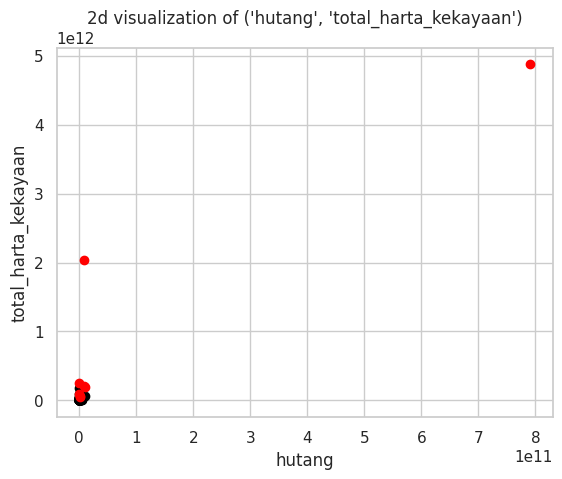

In [146]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_Iforest[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_Iforest[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### LOF

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


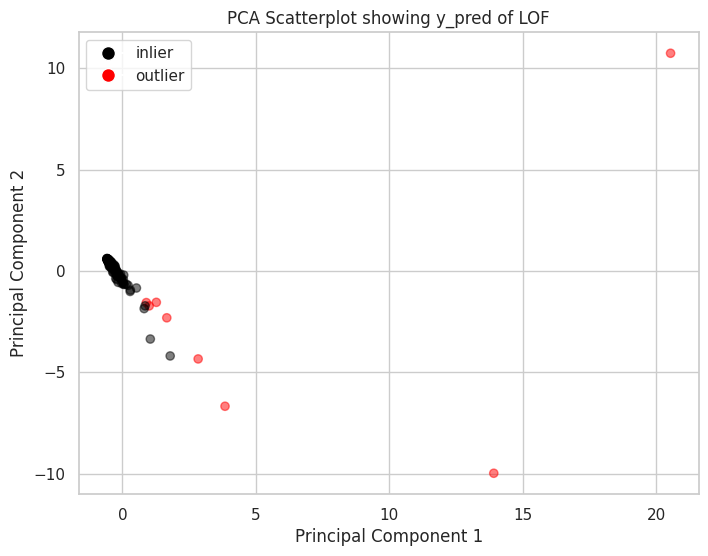

In [154]:
import pandas as pd
from pyod.models.lof import LOF

def lof_outlier_detection(dataframe, dataframe_full, n_neighbors=15, contamination=0.05, metric='manhattan'):
    """
    Perform Local Outlier Factor (LOF) outlier detection using PyOD on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - n_neighbors: The number of neighbors to consider for LOF.
    - contamination: The proportion of outliers in the data.
    - metric: The distance metric to use (e.g., 'minkowski', 'euclidean').

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Create and train the LOF model
    model = LOF(n_neighbors=n_neighbors, contamination=contamination, metric=metric)
    model.fit(dataframe.values)

    # Get predicted labels (y_pred) from the model
    y_pred = model.predict(dataframe.values)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred
    return [new_dataframe, new_dataframe_full]

real_LOF = lof_outlier_detection(df_prep_real, df_real)
display(real_LOF[1])
plot_pca_scatter(df_real_pca, real_LOF[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of LOF')

harta_tanah_dan_bangunan


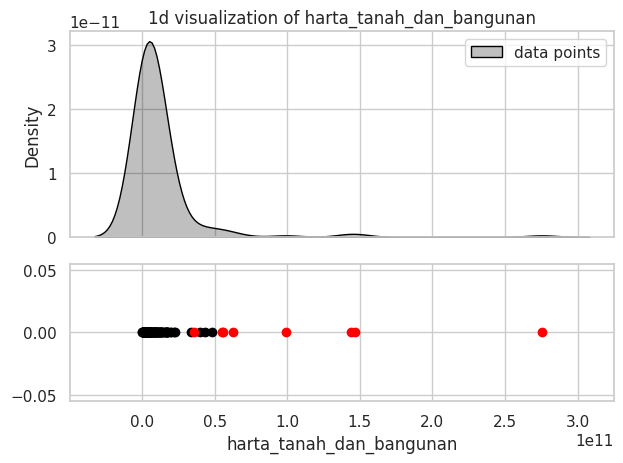

harta_alat_transportasi_dan_mesin


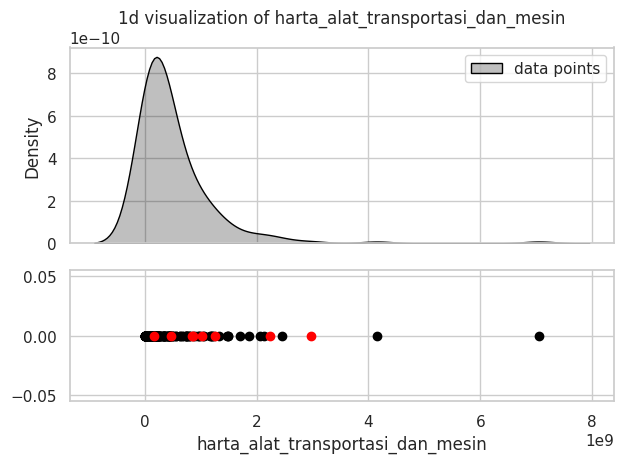

harta_bergerak_lainnya


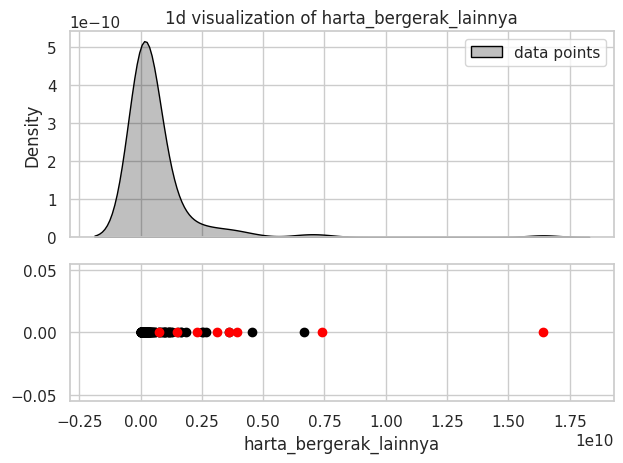

surat_berharga


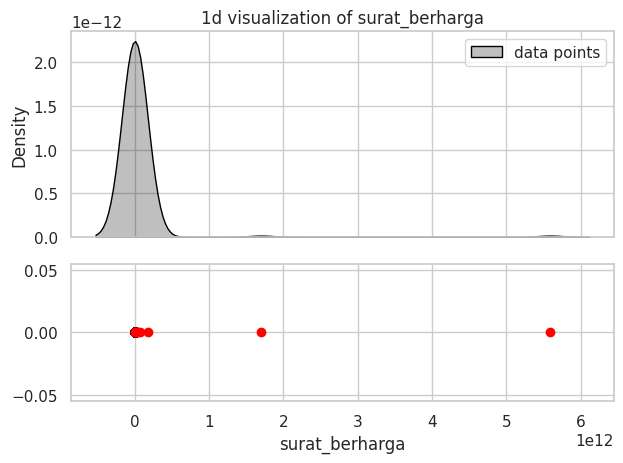

harta_kas_dan_setara_kas


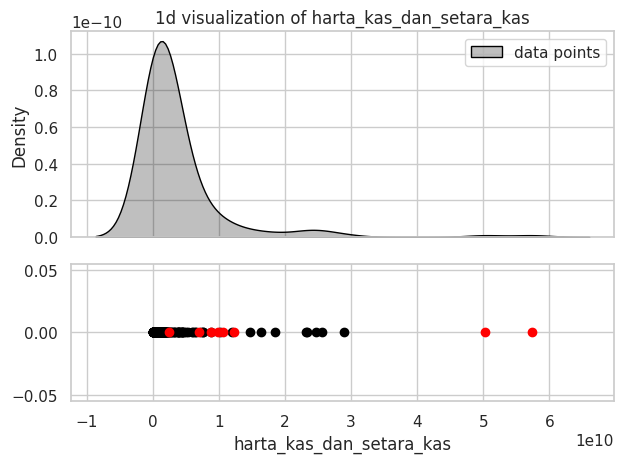

harta_lainnya


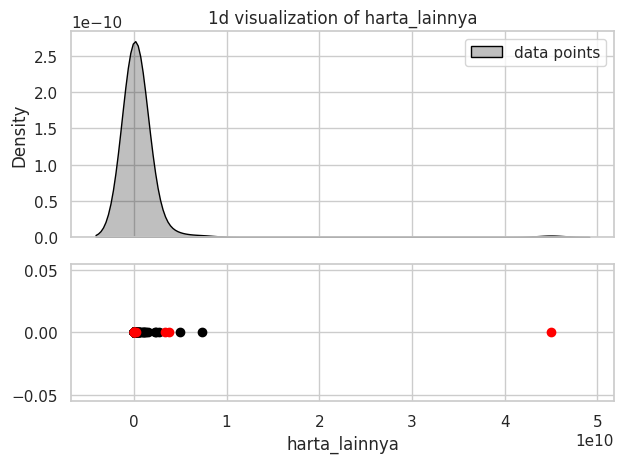

sub_total


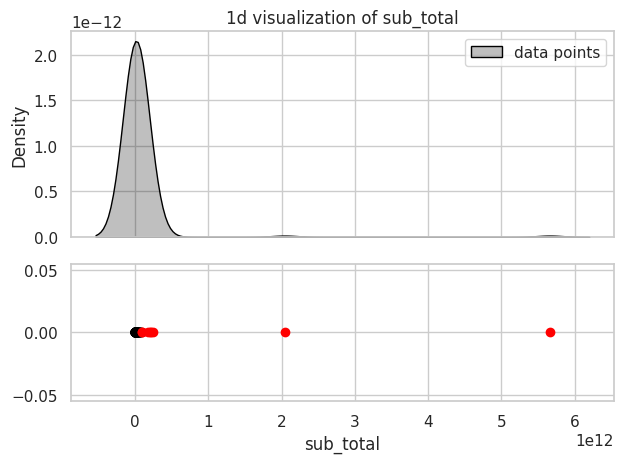

hutang


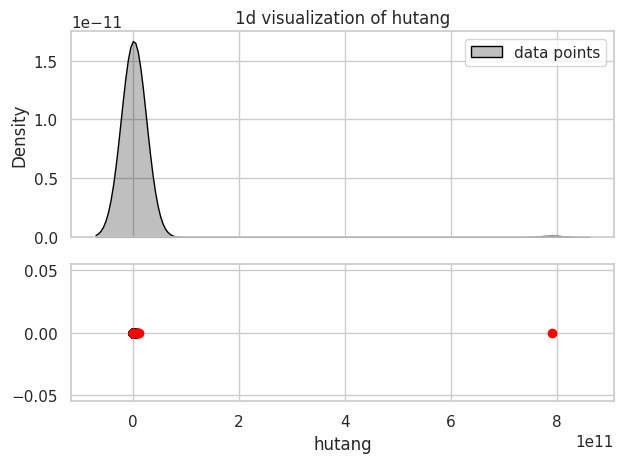

total_harta_kekayaan


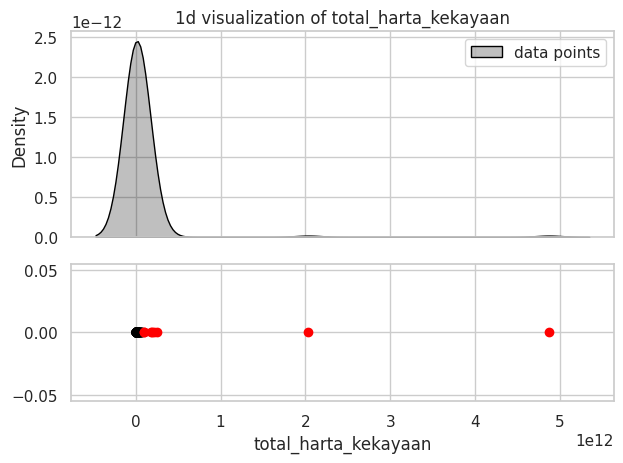

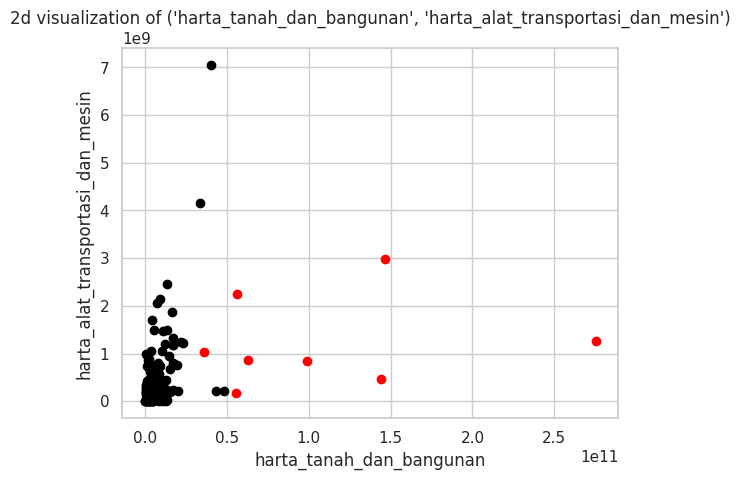

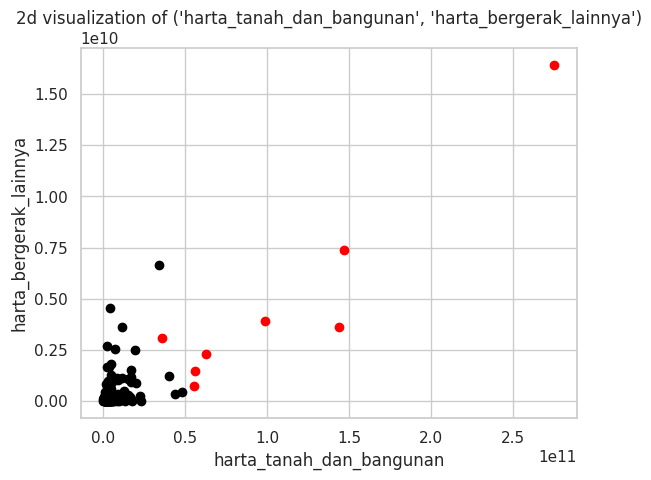

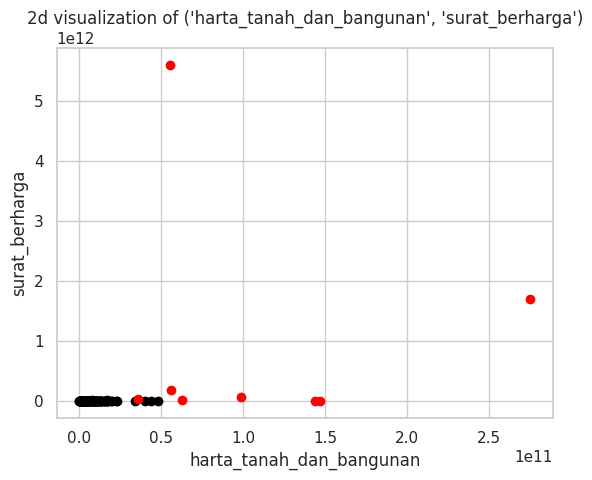

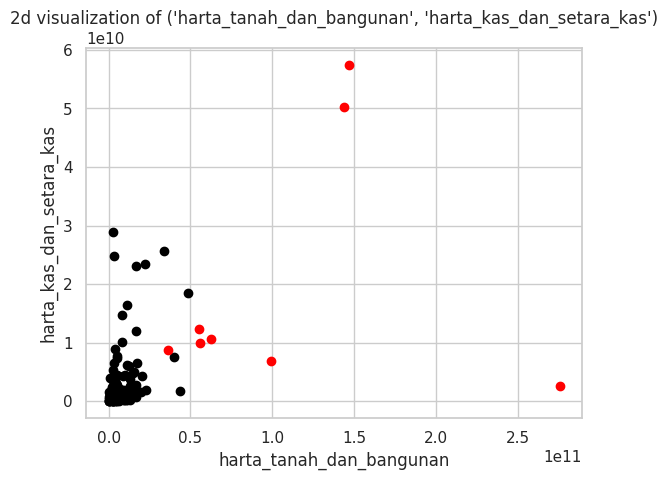

...

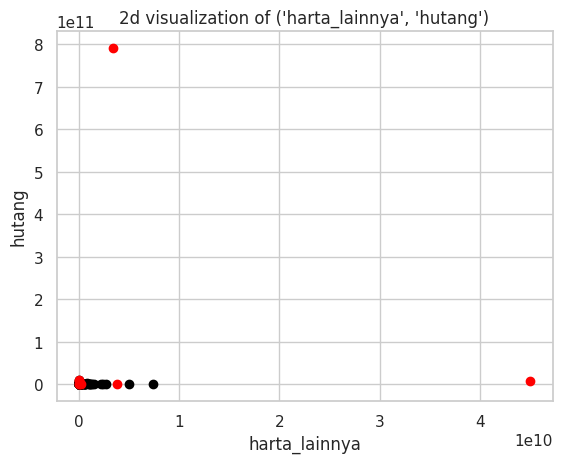

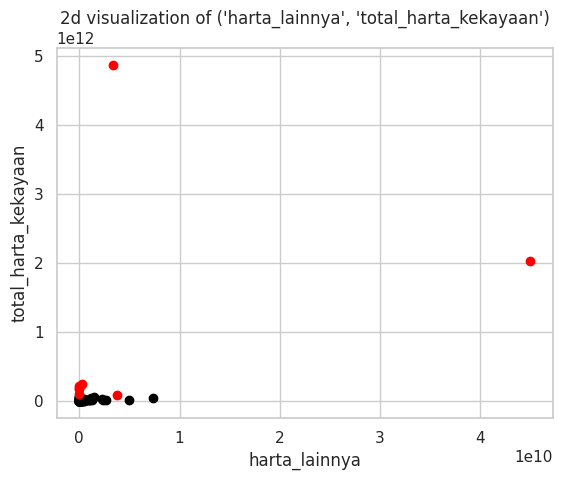

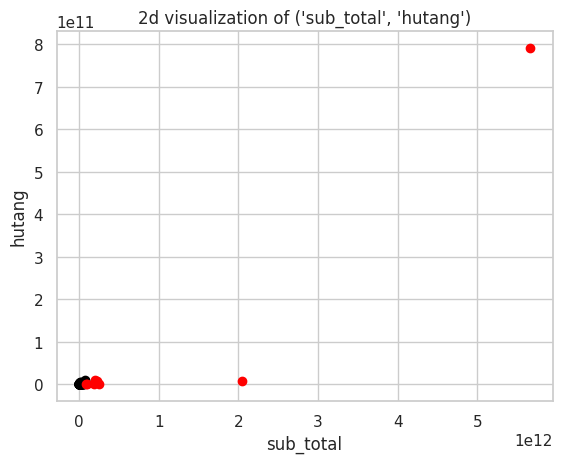

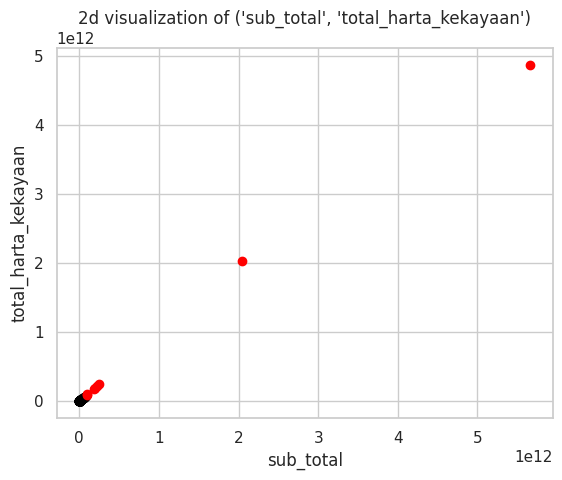

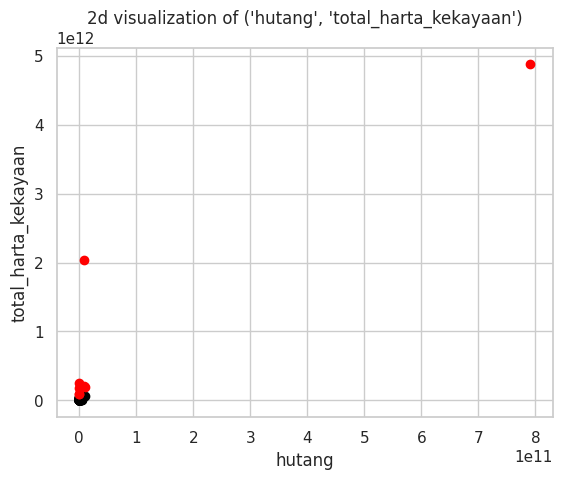

In [147]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_LOF[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_LOF[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### KNN

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


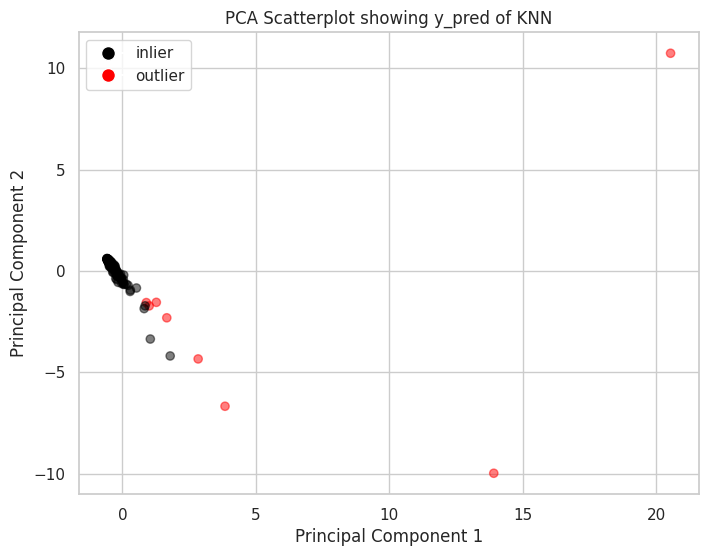

In [155]:
def knn_outlier_detection(dataframe, dataframe_full, n_neighbors=5, method='largest', contamination=0.05):
    """
    Perform K-Nearest Neighbors (KNN) outlier detection using PyOD on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - n_neighbors: The number of neighbors to consider.
    - method: The method to use for outlier score calculation ('largest', 'mean', 'median').
    - contamination: The proportion of outliers in the data.

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Create and train the KNN model
    model = KNN(n_neighbors=n_neighbors, method=method, contamination=contamination)
    model.fit(dataframe.values)

    # Get predicted labels (y_pred) from the model
    y_pred = model.predict(dataframe.values)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred
    return [new_dataframe, new_dataframe_full]

real_KNN = knn_outlier_detection(df_prep_real, df_real)
display(real_KNN[1])
plot_pca_scatter(df_real_pca, real_KNN[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of KNN')

harta_tanah_dan_bangunan


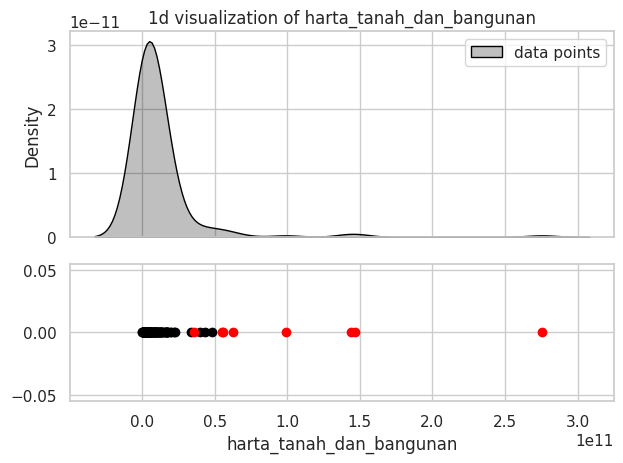

harta_alat_transportasi_dan_mesin


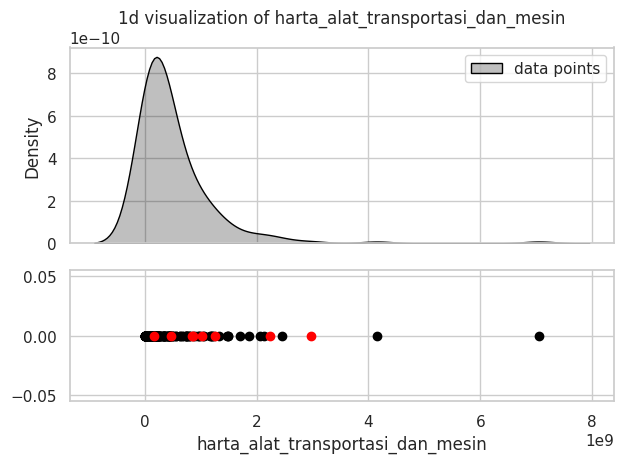

harta_bergerak_lainnya


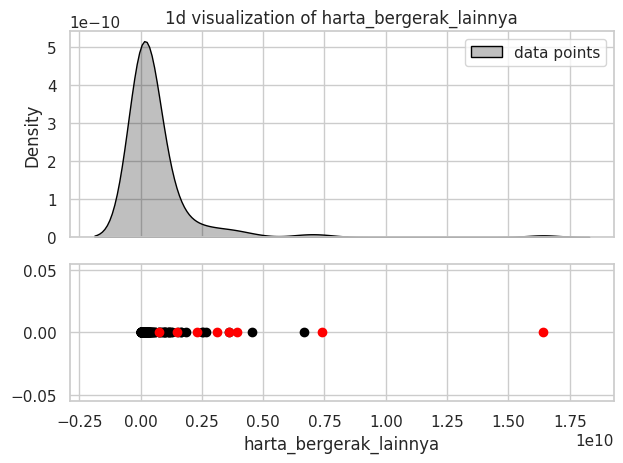

surat_berharga


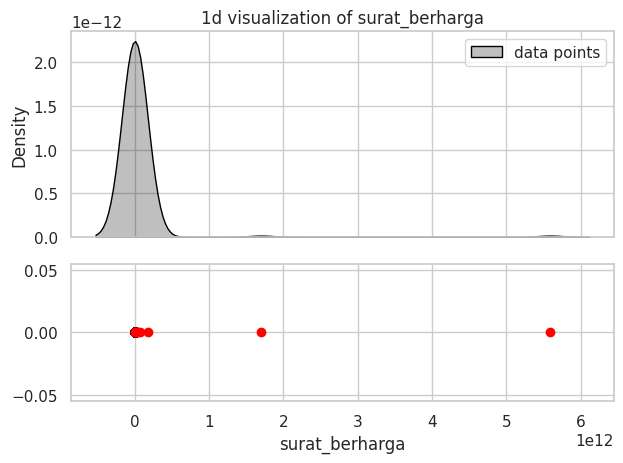

harta_kas_dan_setara_kas


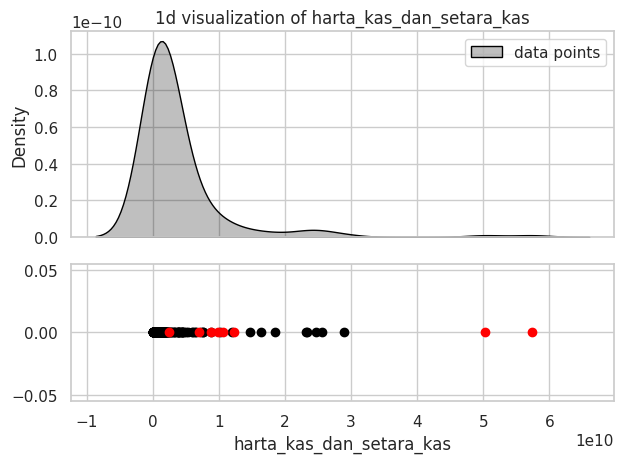

harta_lainnya


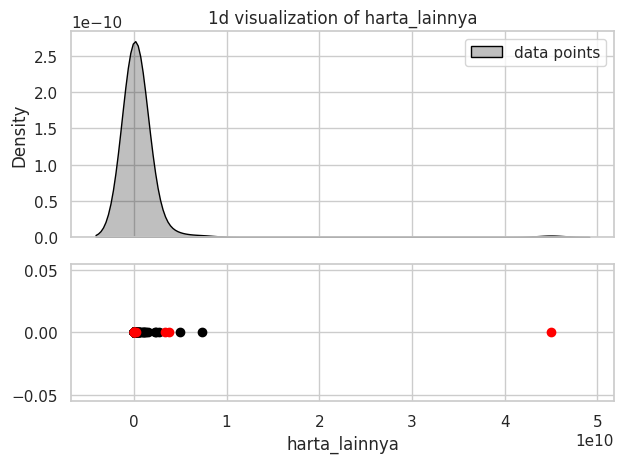

sub_total


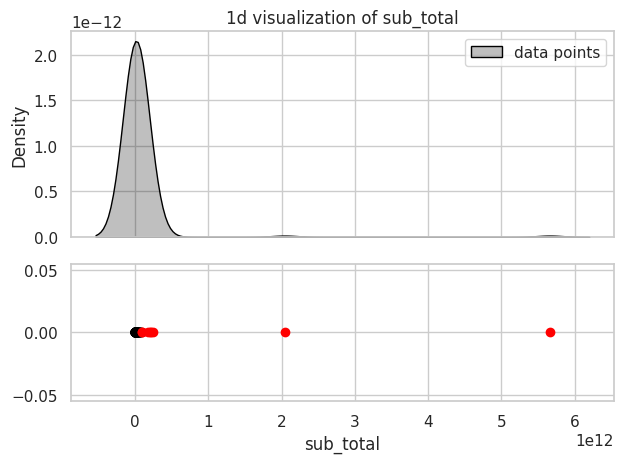

hutang


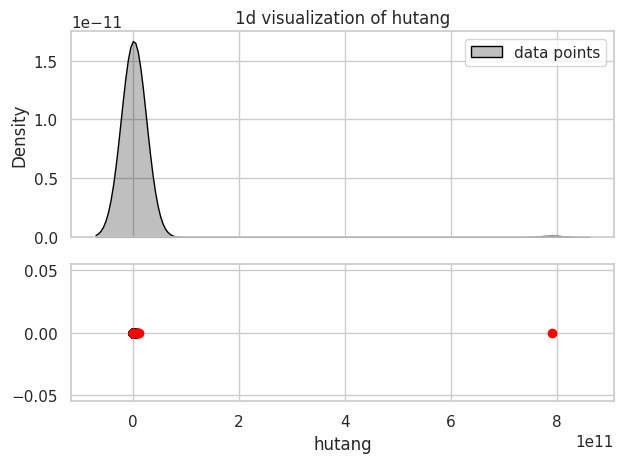

total_harta_kekayaan


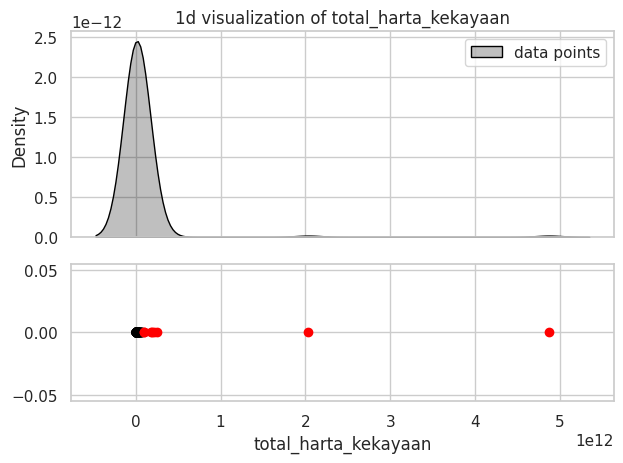

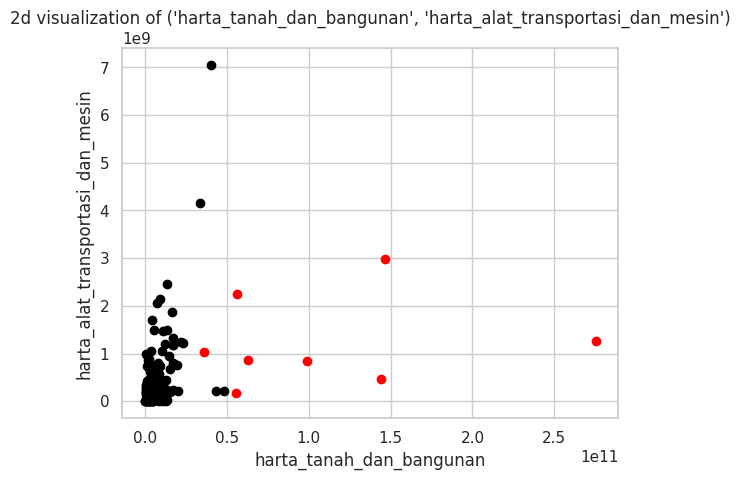

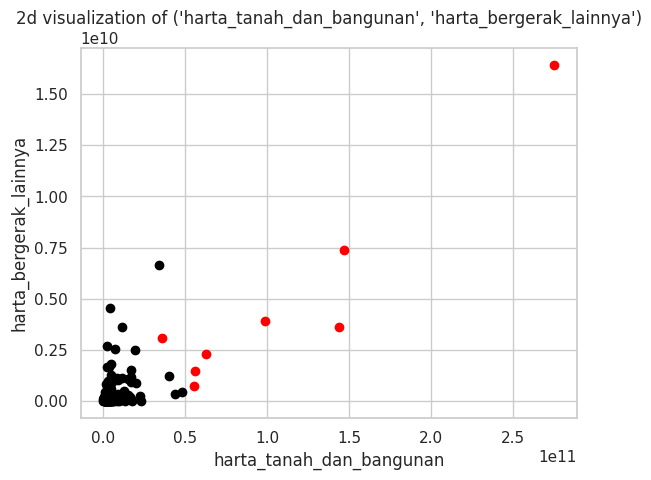

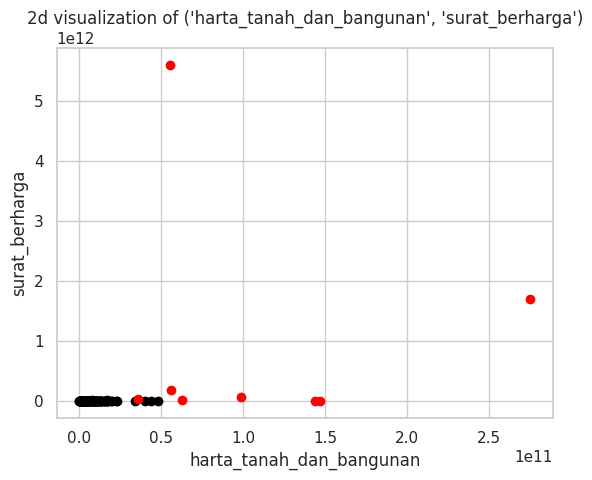

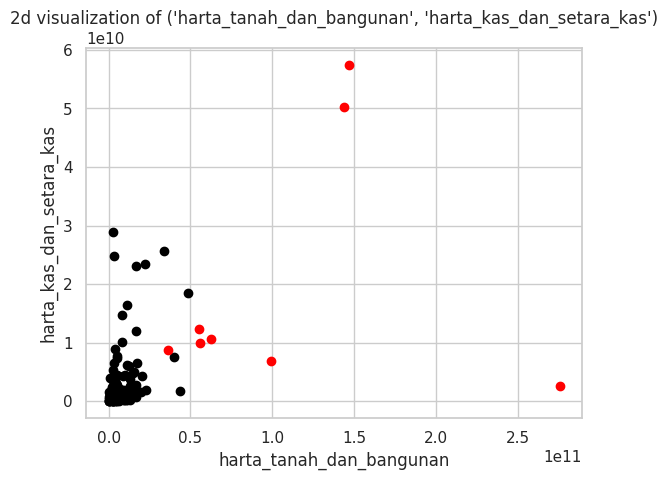

...

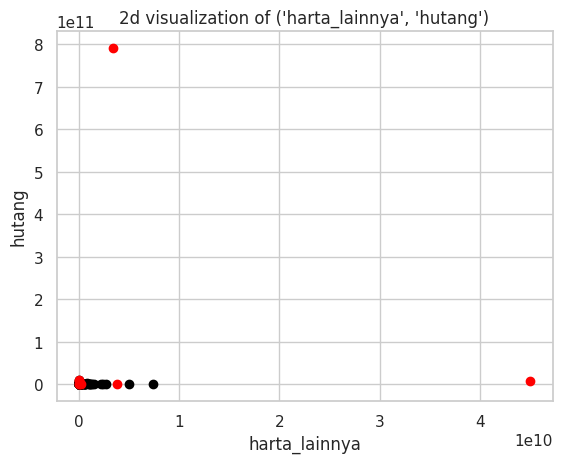

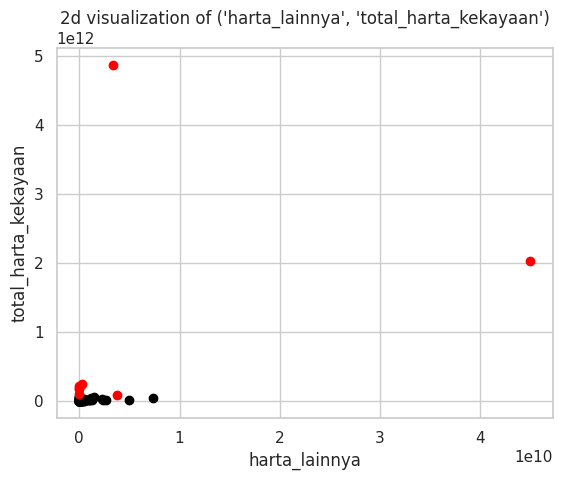

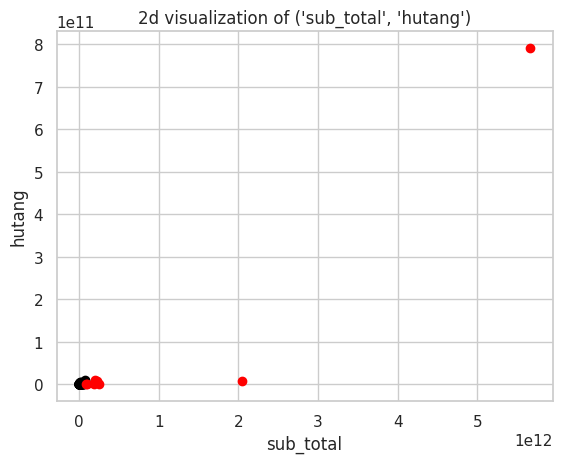

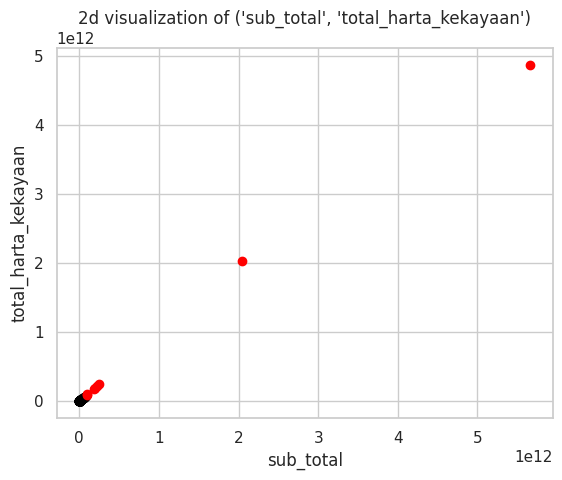

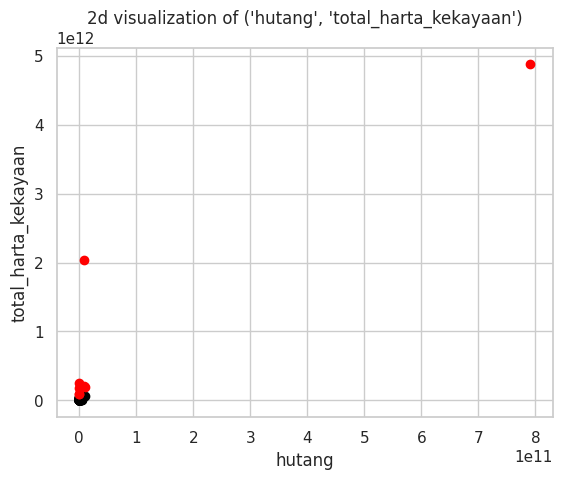

In [148]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_KNN[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_KNN[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### PCA

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


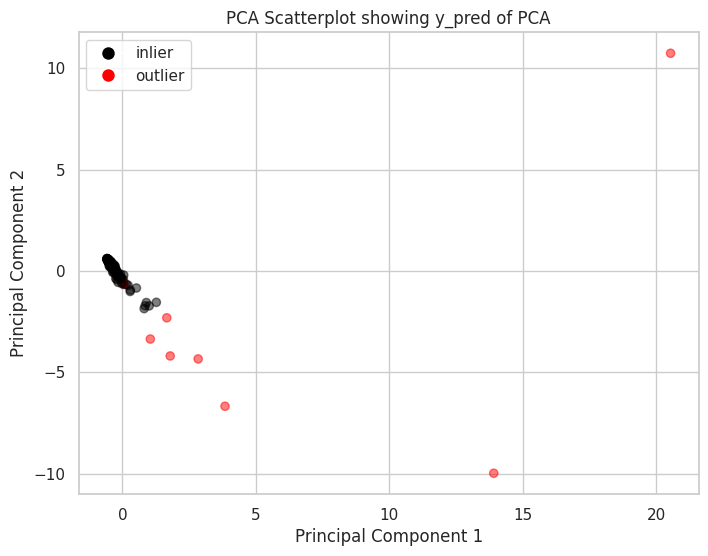

In [156]:
from pyod.models.pca import PCA
def pca_outlier_detection(dataframe, dataframe_full, n_components=1, contamination=0.05, svd_solver='full'):
    """
    Perform PCA-based outlier detection using PyOD on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - n_components: Number of components to keep.
    - contamination: The proportion of outliers in the data.
    - svd_solver: Algorithm to use for singular value decomposition (default is 'auto').

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Create and train the PCA model
    model = PCA(n_components=n_components, contamination=contamination, svd_solver=svd_solver)
    model.fit(dataframe.values)

    # Get predicted labels (y_pred) from the model
    y_pred = model.predict(dataframe.values)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred
    return [new_dataframe, new_dataframe_full]

real_PCA = pca_outlier_detection(df_prep_real, df_real)
display(real_PCA[1])
plot_pca_scatter(df_real_pca, real_PCA[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of PCA')

harta_tanah_dan_bangunan


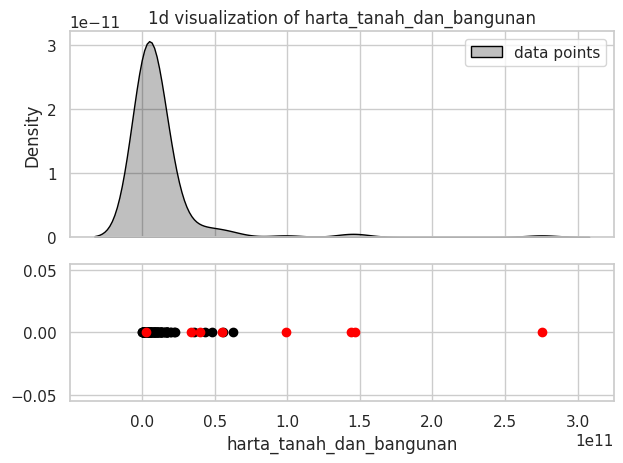

harta_alat_transportasi_dan_mesin


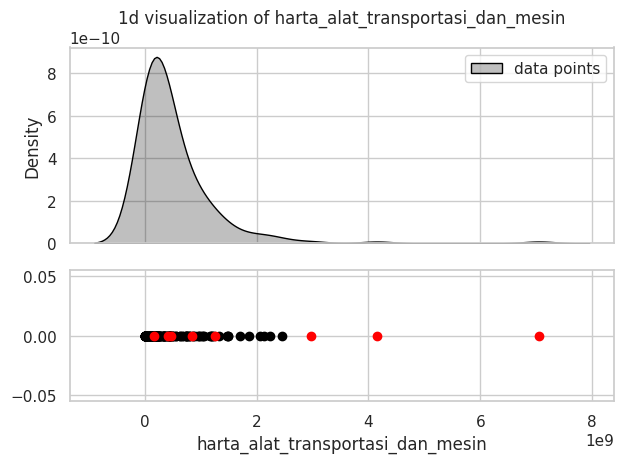

harta_bergerak_lainnya


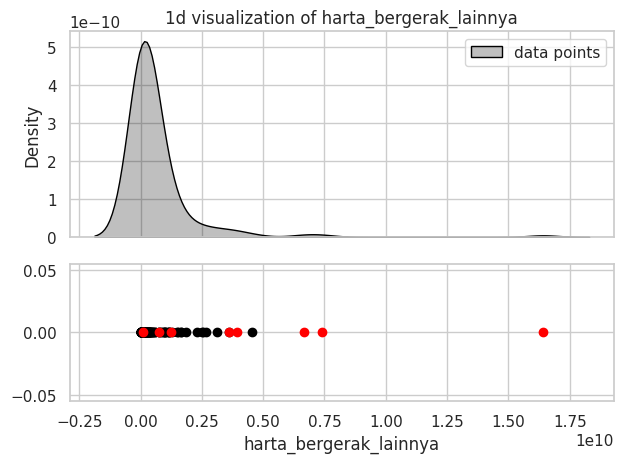

surat_berharga


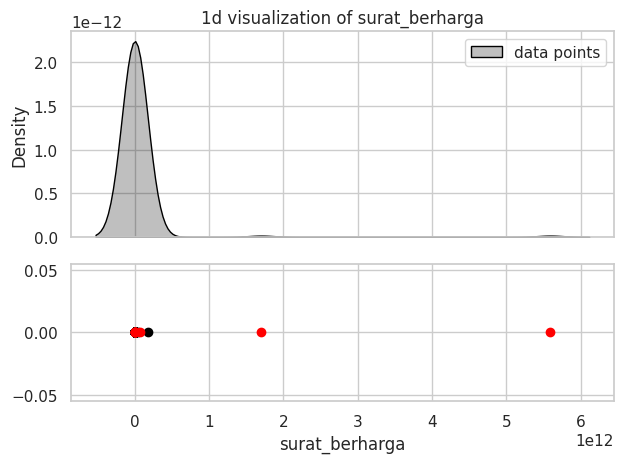

harta_kas_dan_setara_kas


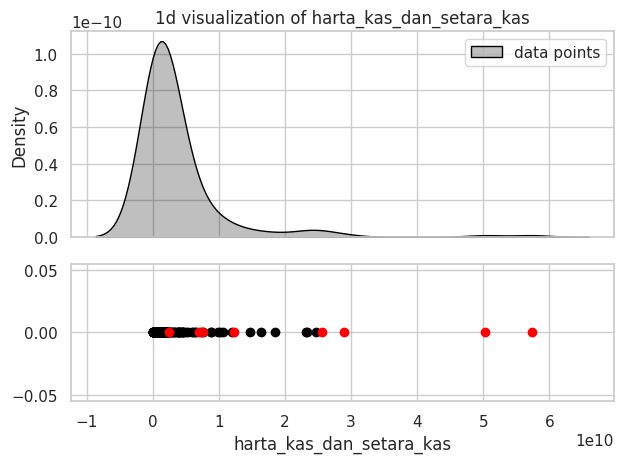

harta_lainnya


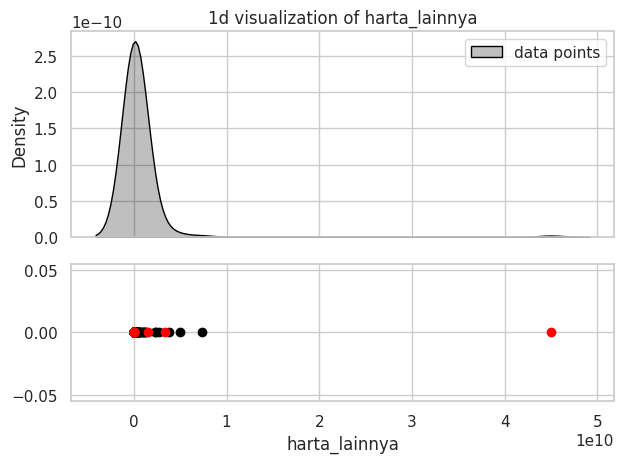

sub_total


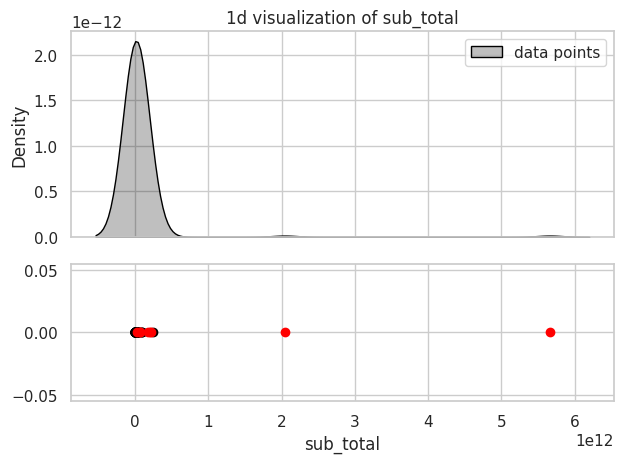

hutang


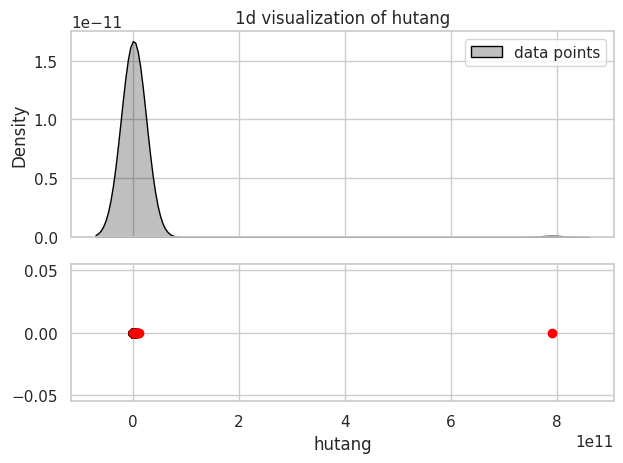

total_harta_kekayaan


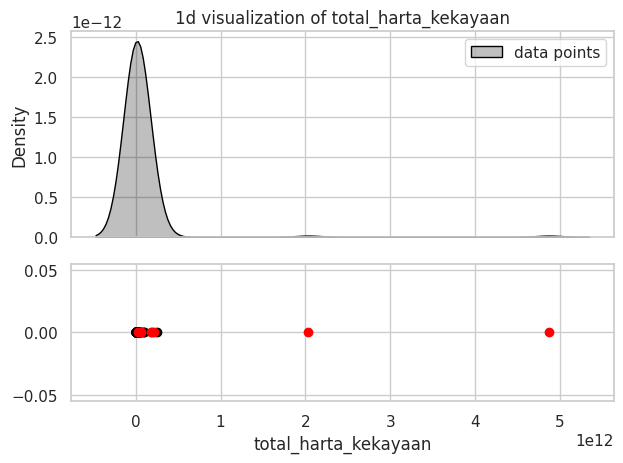

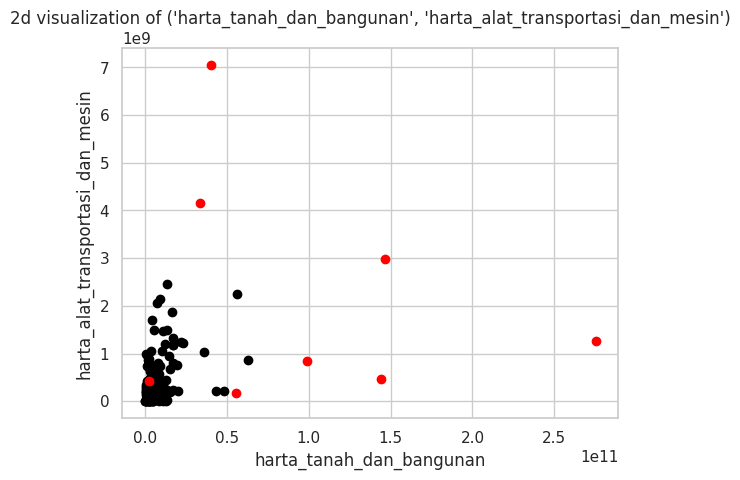

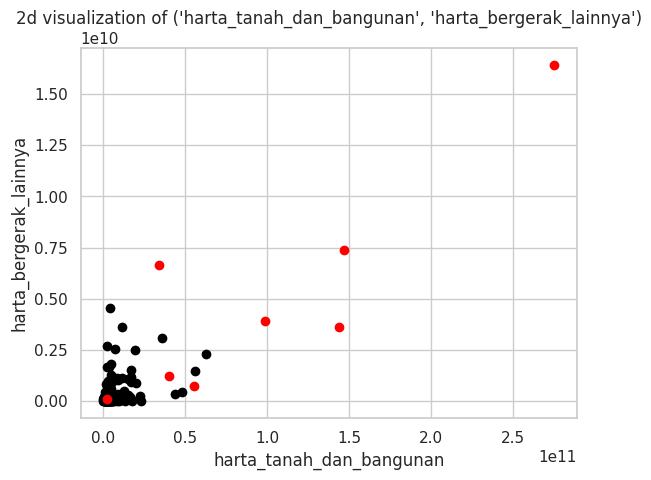

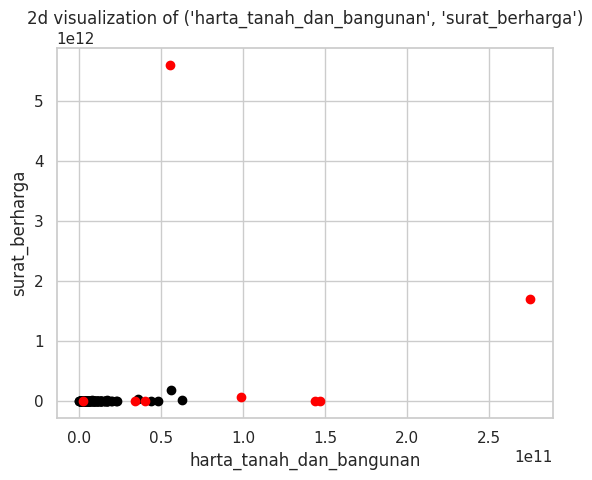

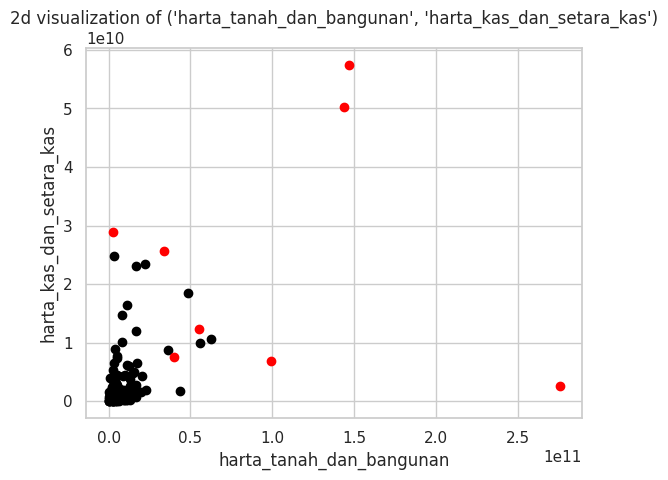

...

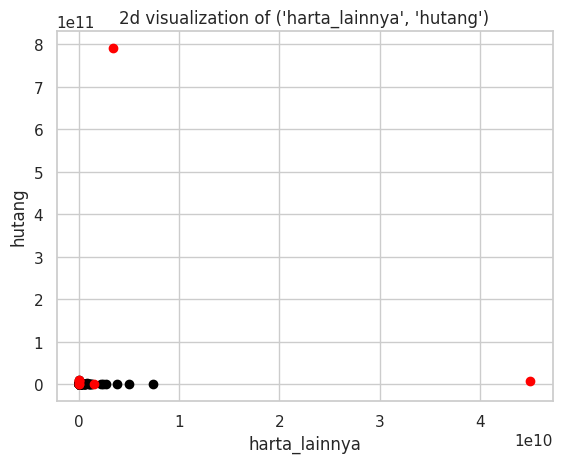

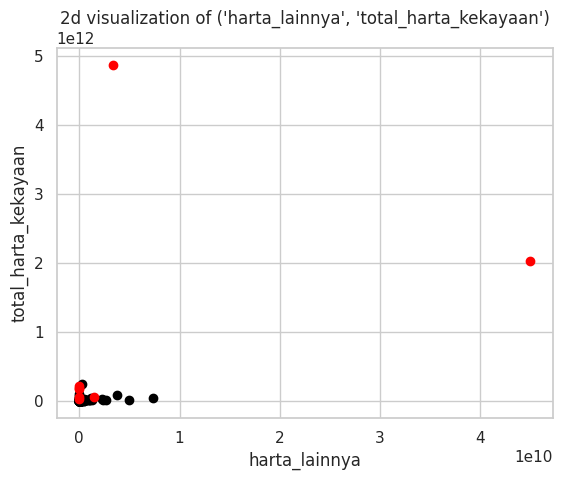

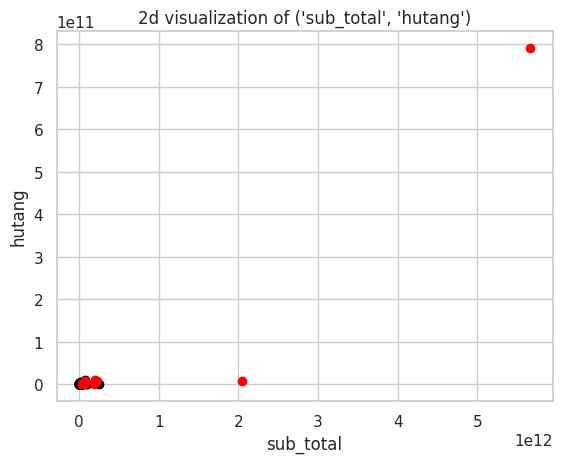

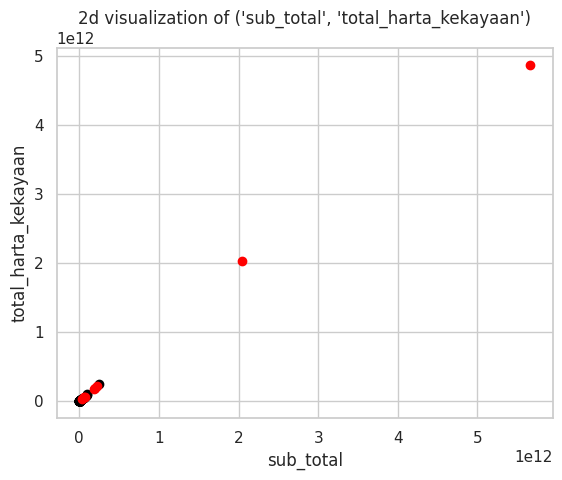

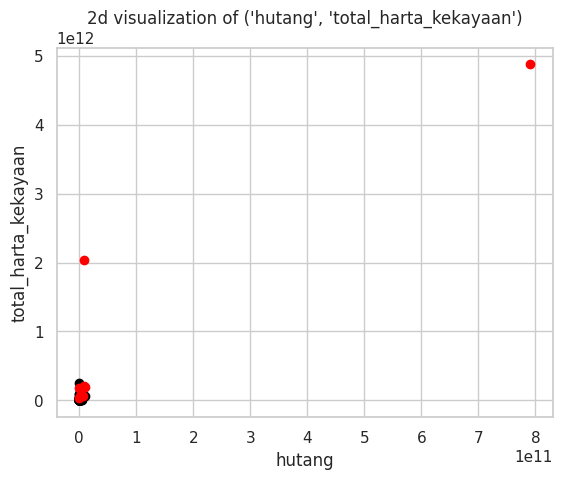

In [149]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_PCA[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_PCA[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### DBSCAN

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,0
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


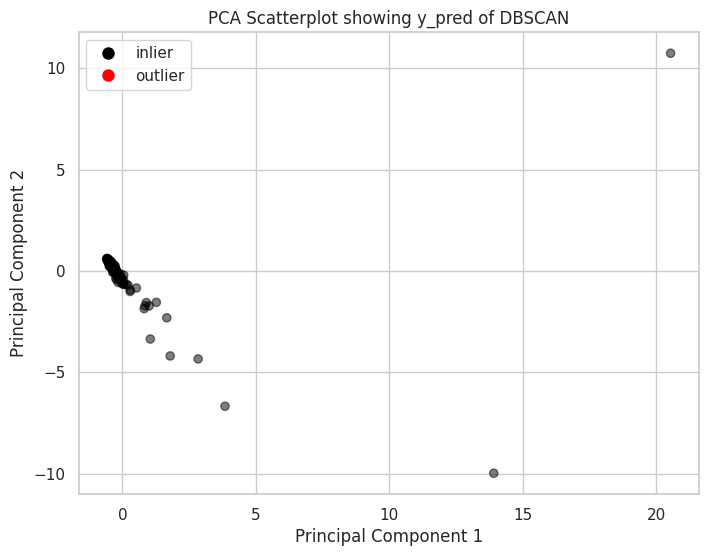

In [157]:
def dbscan_outlier_detection(dataframe, dataframe_full, eps=0.1, min_samples=1, metric='manhattan'):
    """
    Perform DBSCAN outlier detection using scikit-learn on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - eps: The maximum distance between two samples for one to be considered as in the neighborhood of the other.
    - min_samples: The number of samples (or total weight) in a neighborhood for a point to be considered as a core point.
    - metric: The metric to use when calculating distance between instances.

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Create and train the DBSCAN model
    model = DBSCAN(eps=eps, min_samples=min_samples, metric=metric)
    model.fit(dataframe.values)

    # DBSCAN assigns cluster labels (-1 for outliers)
    y_pred = (model.labels_ == -1).astype(int)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred
    return [new_dataframe, new_dataframe_full]

real_DBSCAN = dbscan_outlier_detection(df_prep_real, df_real)
display(real_DBSCAN[1])
plot_pca_scatter(df_real_pca, real_DBSCAN[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of DBSCAN')

harta_tanah_dan_bangunan


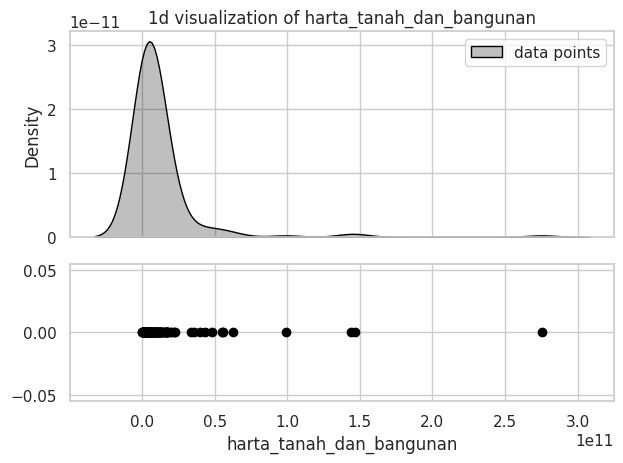

harta_alat_transportasi_dan_mesin


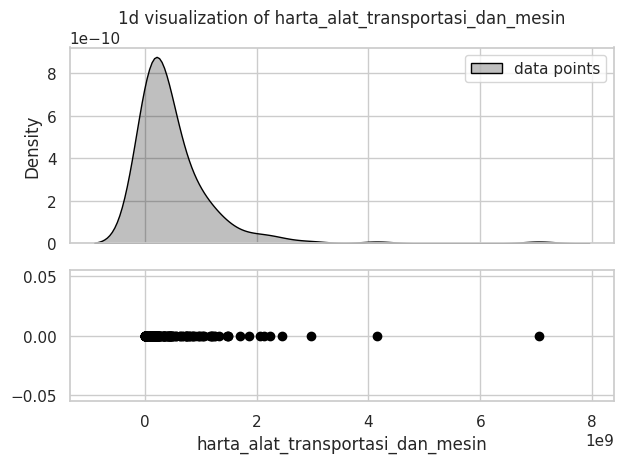

harta_bergerak_lainnya


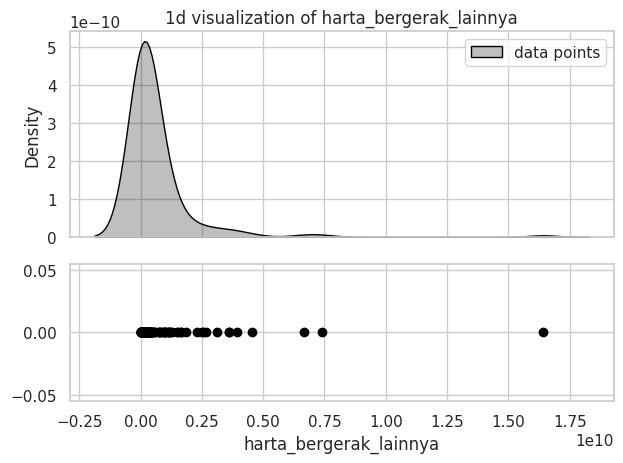

surat_berharga


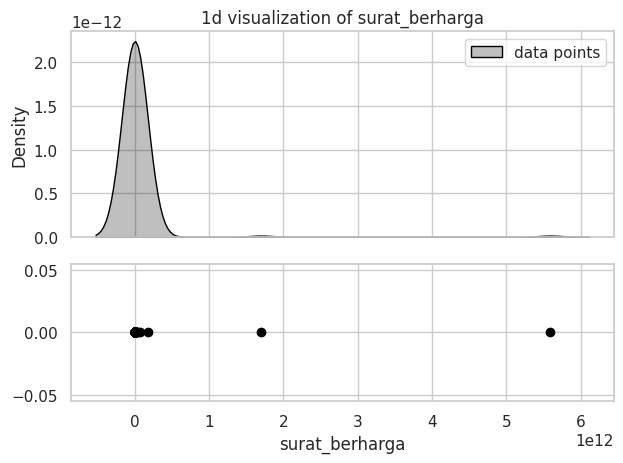

harta_kas_dan_setara_kas


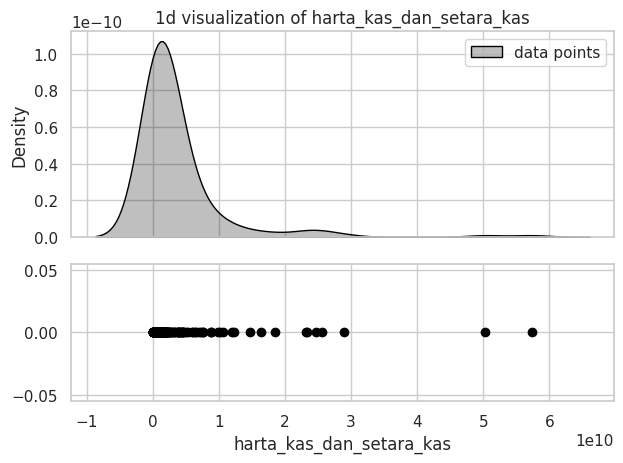

harta_lainnya


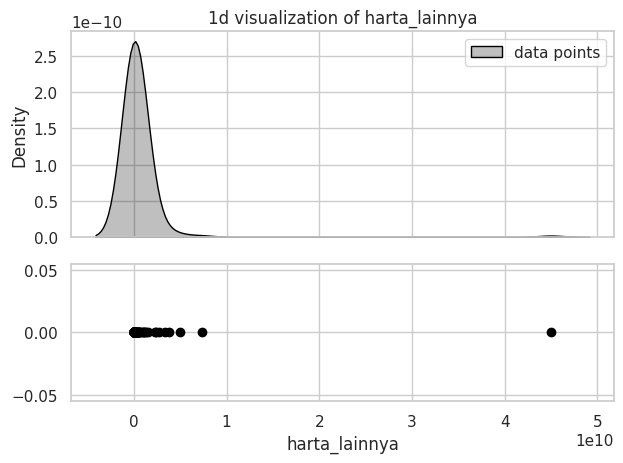

sub_total


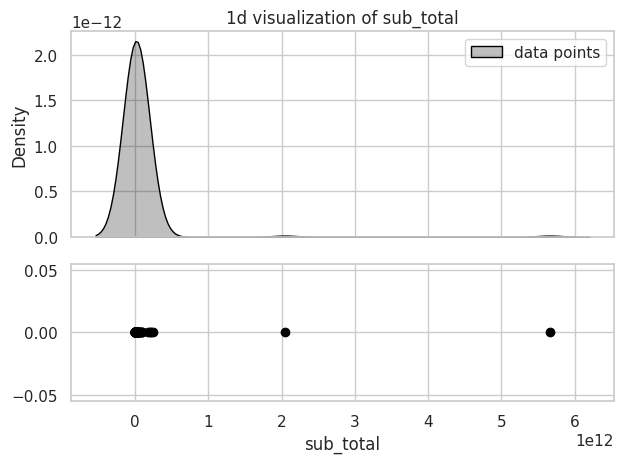

hutang


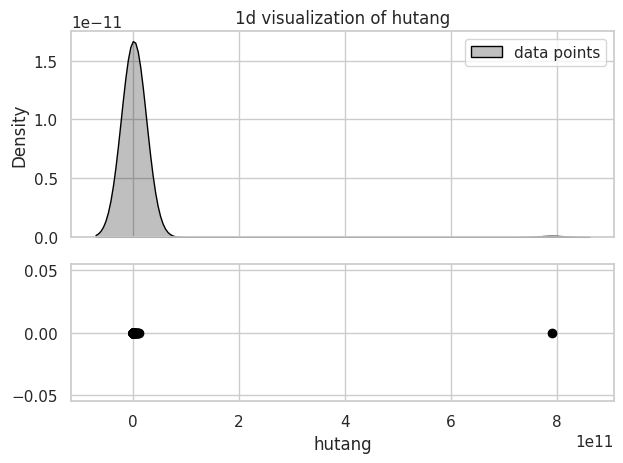

total_harta_kekayaan


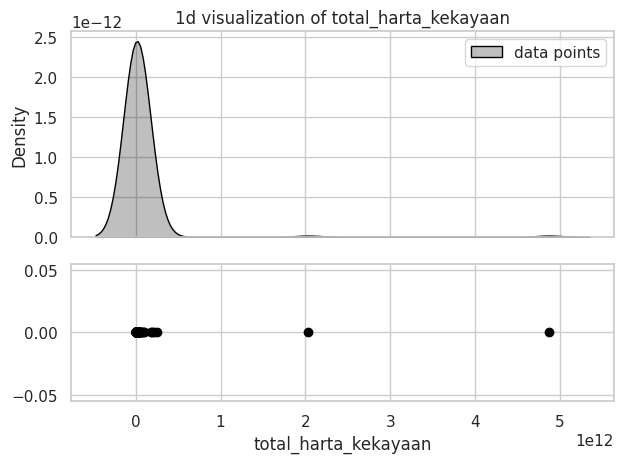

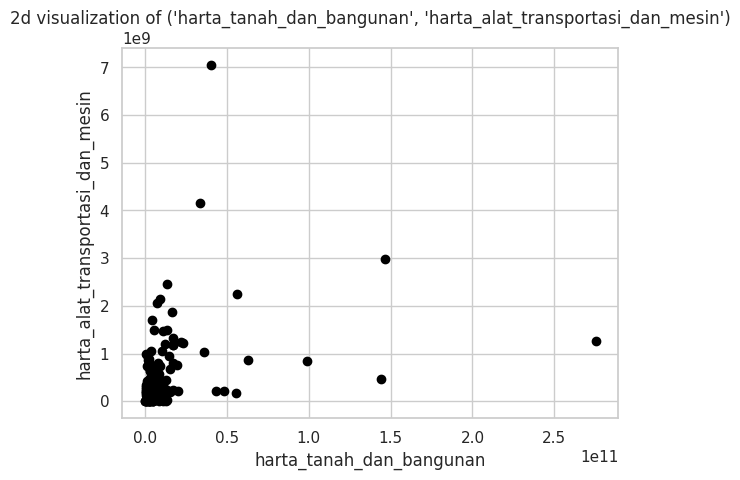

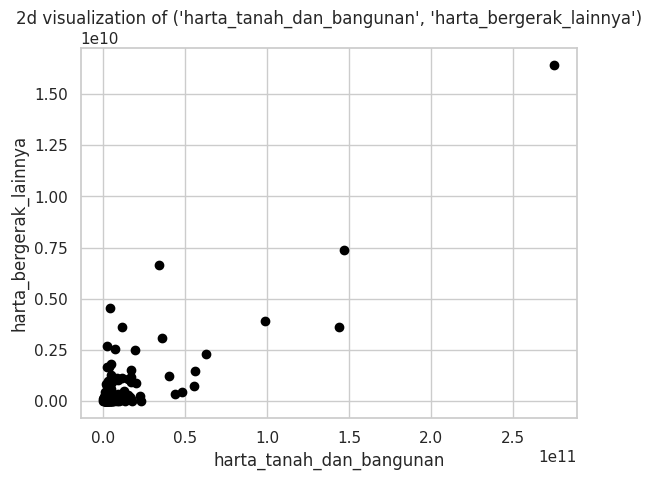

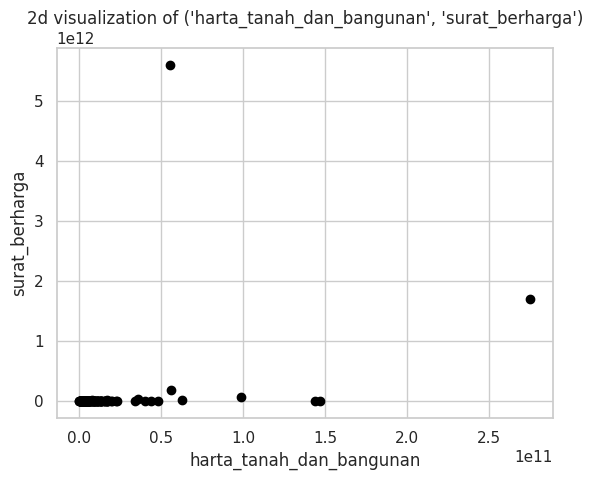

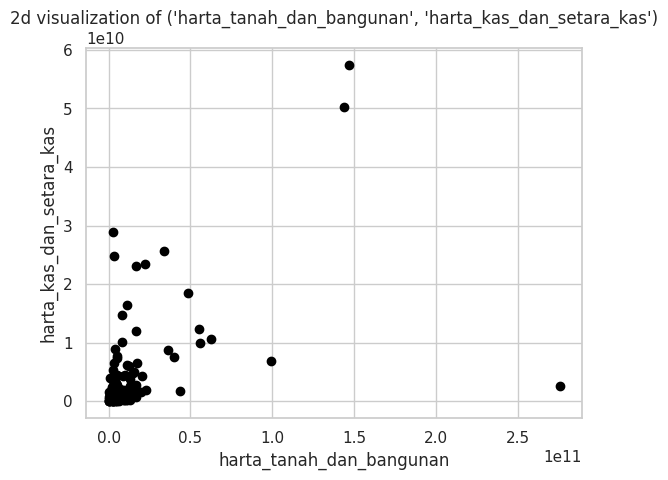

...

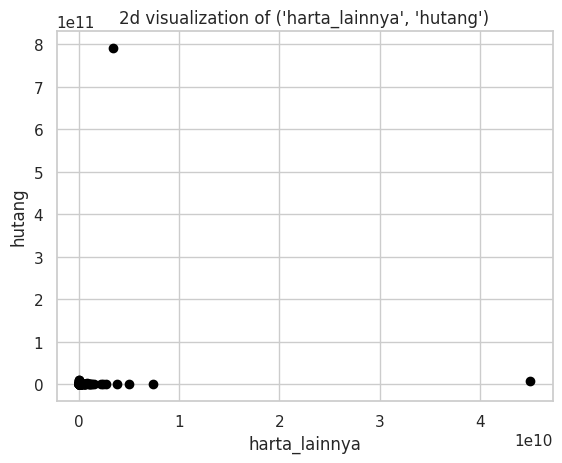

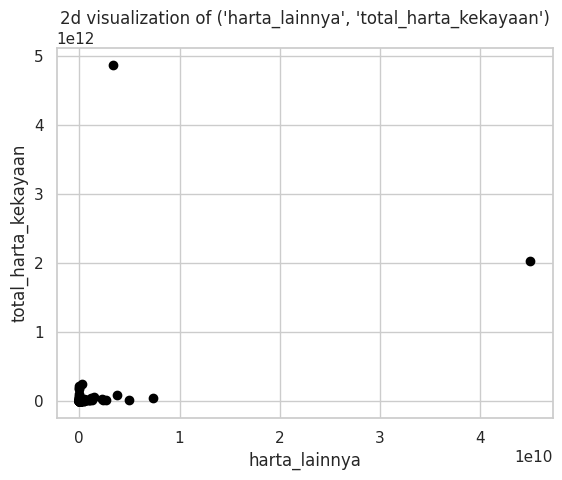

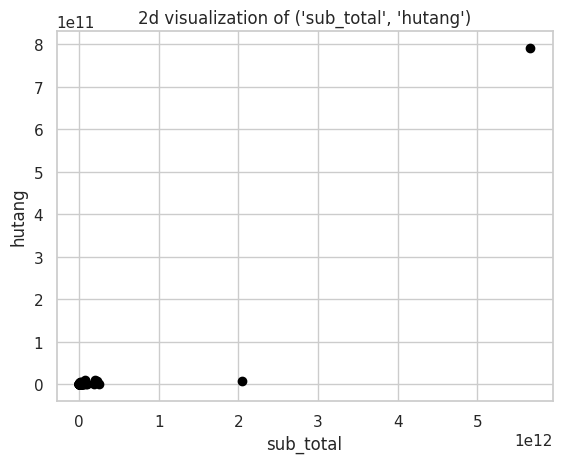

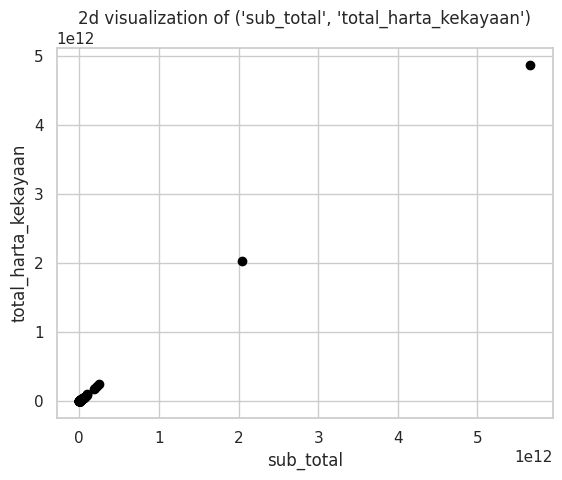

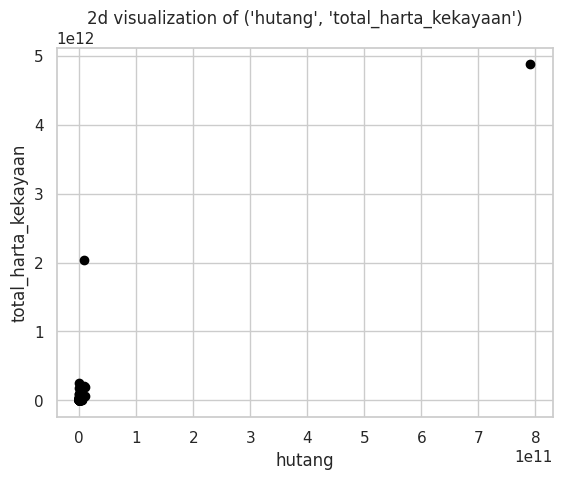

In [150]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_DBSCAN[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_DBSCAN[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### HDBSCAN

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,1
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,1
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,1
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,1
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,1
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,1
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,1


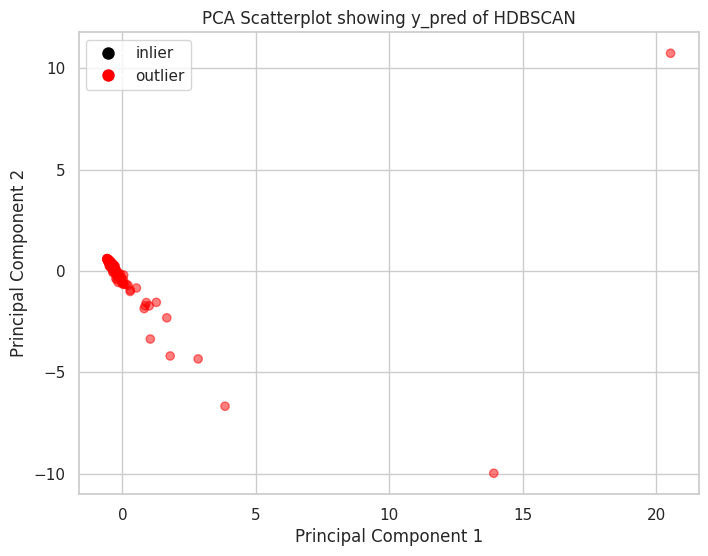

In [158]:
def hdbscan_outlier_detection(dataframe, dataframe_full, min_cluster_size=2, min_samples=30, metric='euclidean'):
    """
    Perform HDBSCAN outlier detection on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - min_cluster_size: The minimum size of clusters.
    - min_samples: The number of samples in a neighborhood for a point to be considered a core point.
    - metric: The metric used to compute distance between samples (e.g., 'euclidean').

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    # Create and train the HDBSCAN model
    model = hdbscan.HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples, metric=metric)
    model.fit(dataframe.values)

    # HDBSCAN assigns cluster labels (-1 for outliers)
    y_pred = (model.labels_ == -1).astype(int)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred

    return [new_dataframe, new_dataframe_full]

real_HDBSCAN = hdbscan_outlier_detection(df_prep_real, df_real)
display(real_HDBSCAN[1])
plot_pca_scatter(df_real_pca, real_HDBSCAN[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of HDBSCAN')

harta_tanah_dan_bangunan


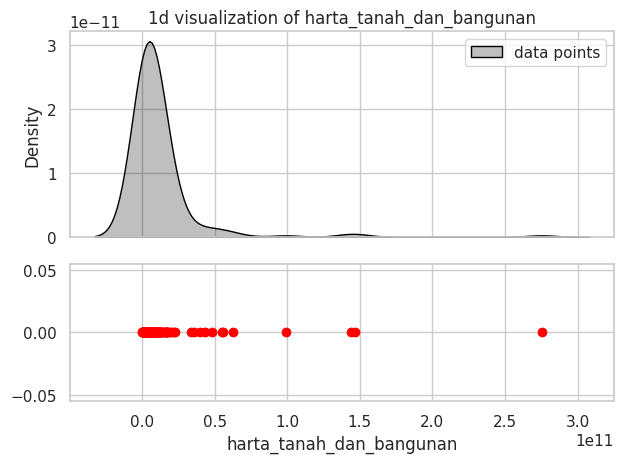

harta_alat_transportasi_dan_mesin


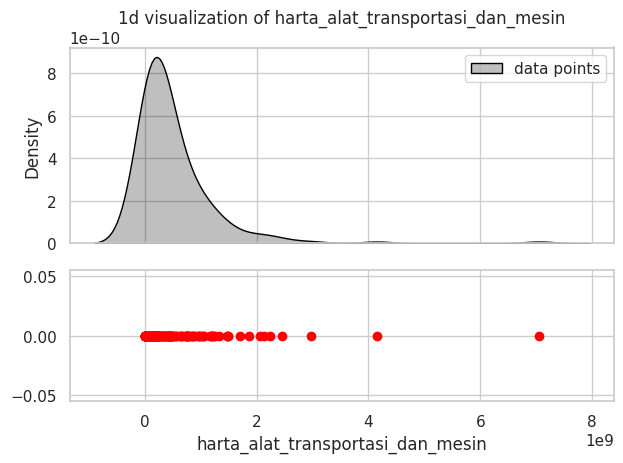

harta_bergerak_lainnya


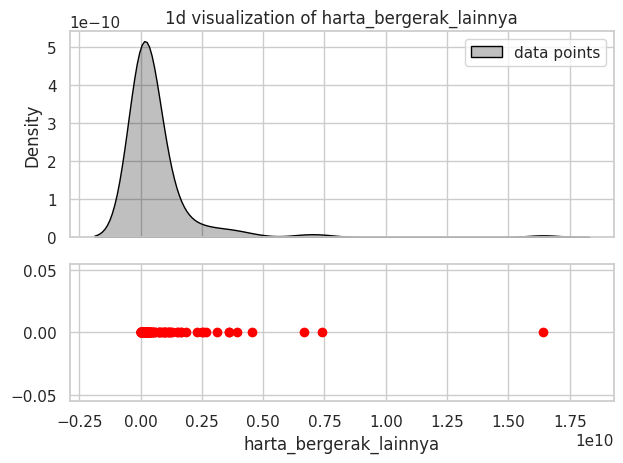

surat_berharga


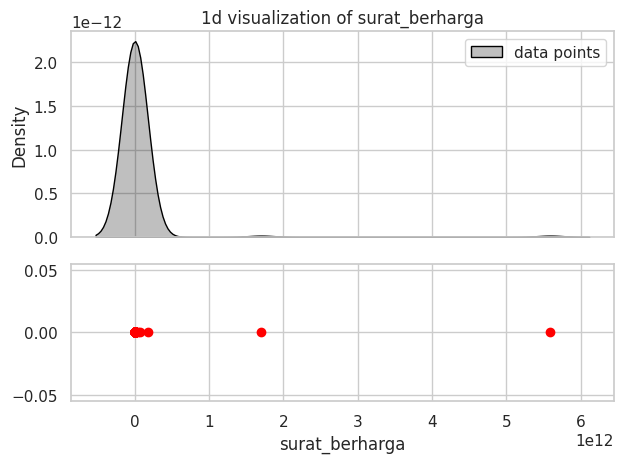

harta_kas_dan_setara_kas


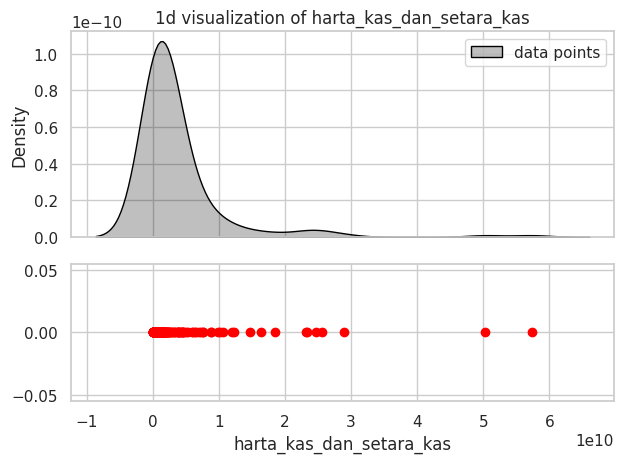

harta_lainnya


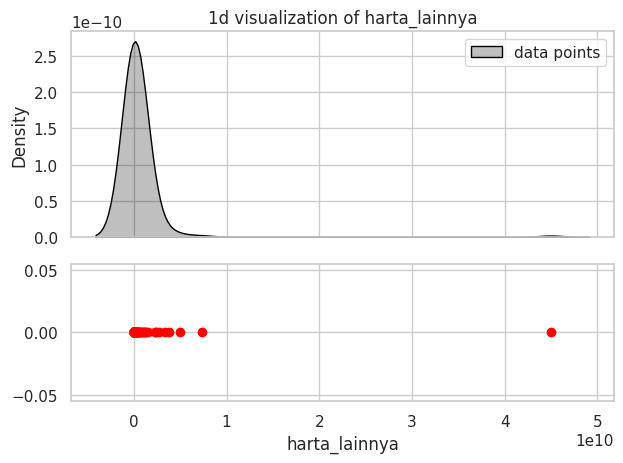

sub_total


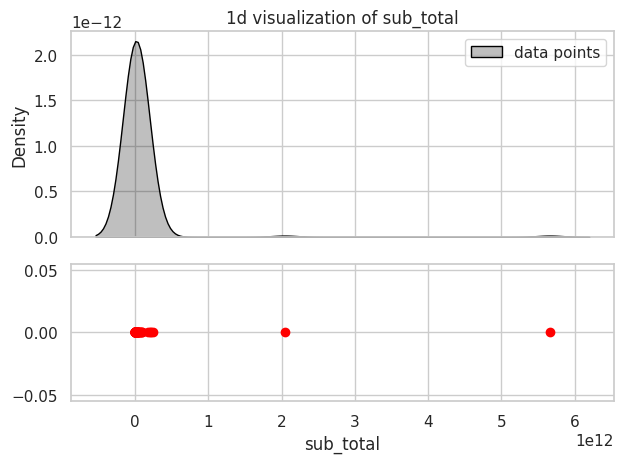

hutang


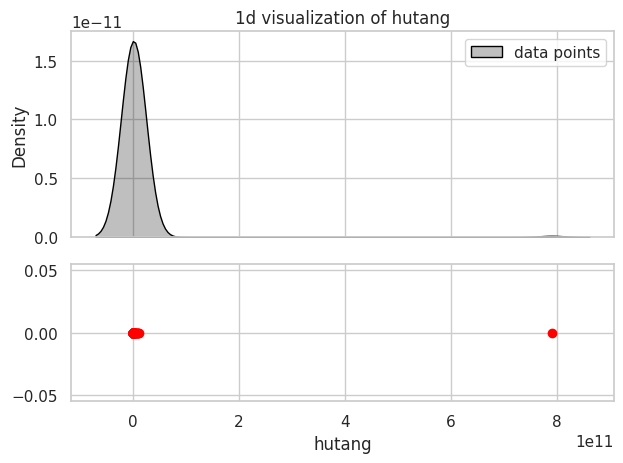

total_harta_kekayaan


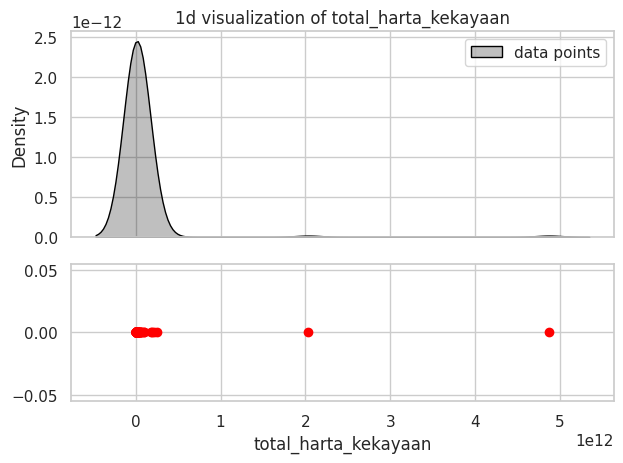

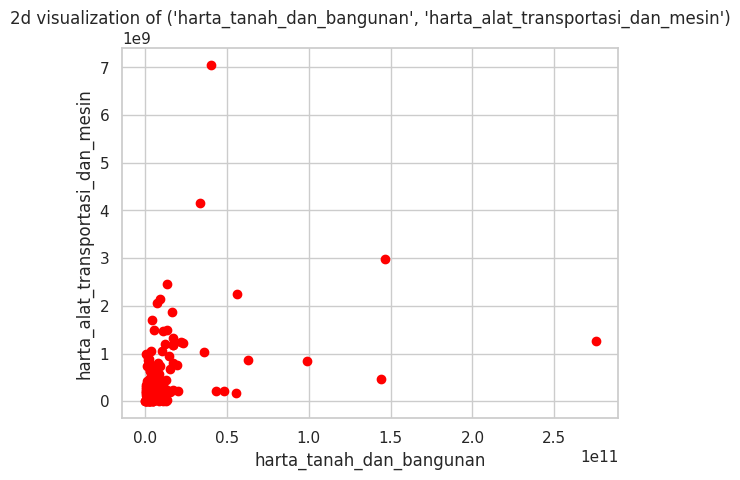

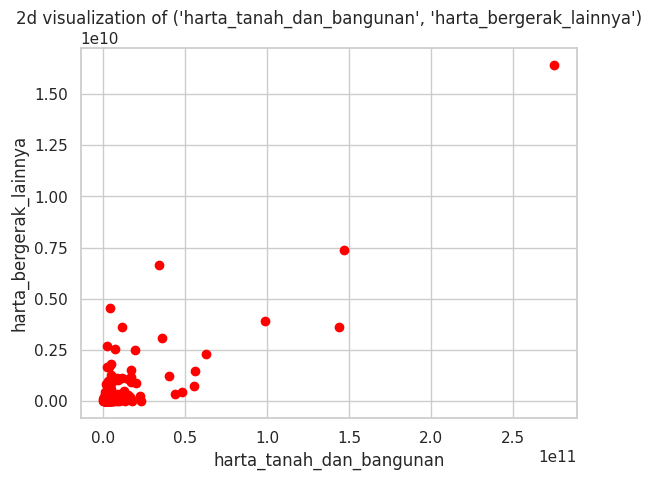

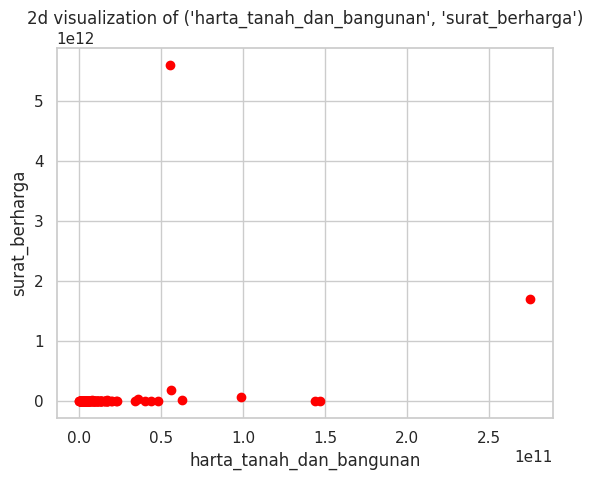

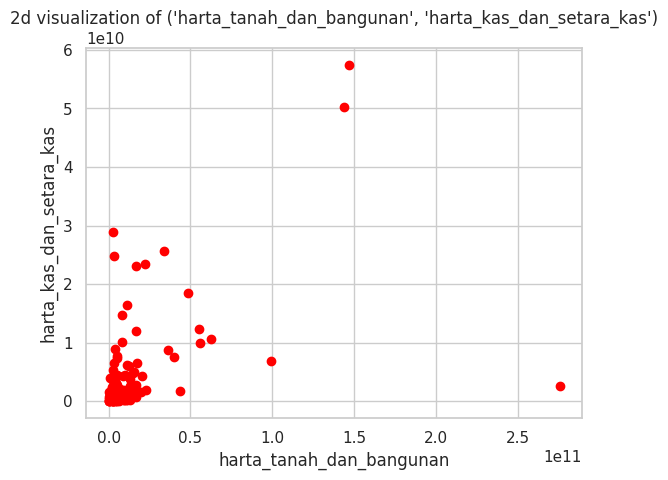

...

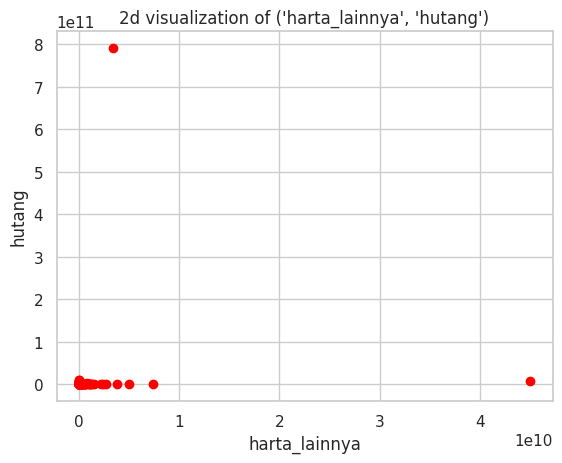

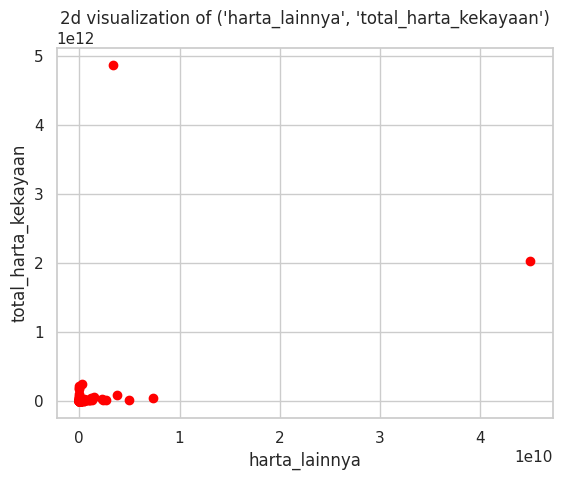

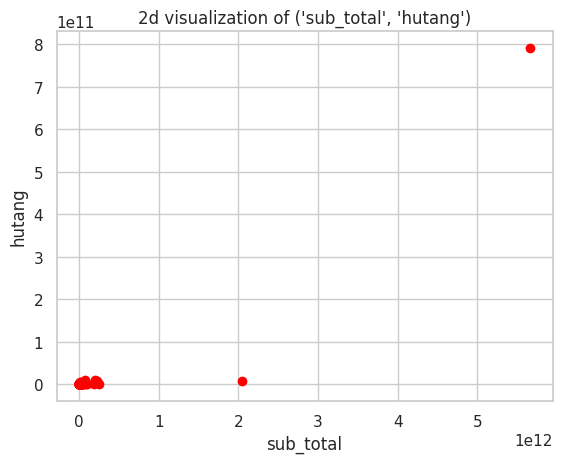

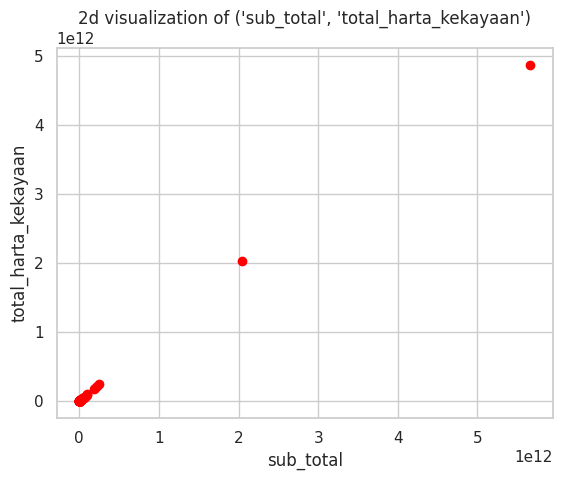

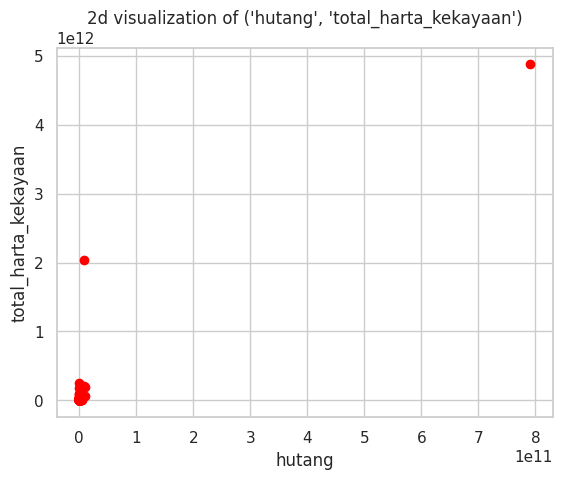

In [135]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_HDBSCAN[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_HDBSCAN[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### VAE

Model: "model_90"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_61 (InputLayer)       [(None, 9)]                  0         []                            
                                                                                                  
 dense_330 (Dense)           (None, 9)                    90        ['input_61[0][0]']            
                                                                                                  
 dense_331 (Dense)           (None, 6)                    60        ['dense_330[0][0]']           
                                                                                                  
 dropout_180 (Dropout)       (None, 6)                    0         ['dense_331[0][0]']           
                                                                                           

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,0


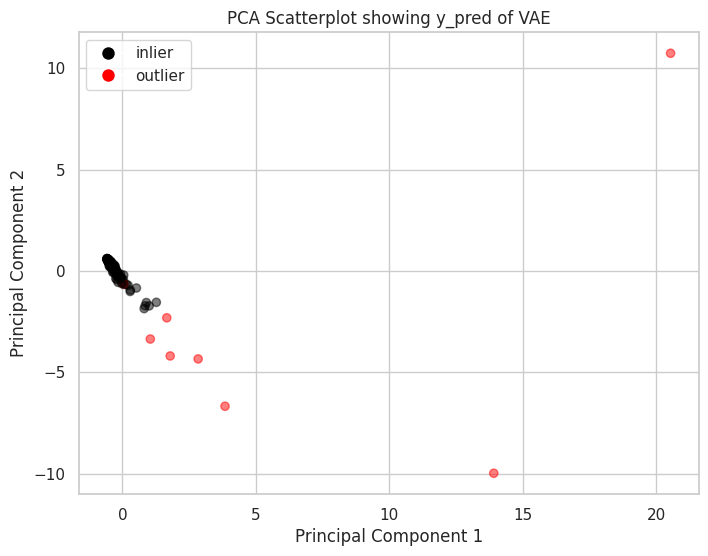

In [136]:
def vae_outlier_detection(dataframe, dataframe_full, hidden_activation='relu', loss=keras.losses.MeanSquaredError(reduction="sum_over_batch_size", name="mean_squared_error"), contamination=0.05):
    """
    Perform VAE (Variational Autoencoder) outlier detection using PyOD on a pandas DataFrame.

    Parameters:
    - dataframe: pandas DataFrame containing the data.
    - dataframe_full: pandas DataFrame containing the full data.
    - hidden_activation: Activation function to use for hidden layers.
    - loss: Loss function to use for the VAE.
    - contamination: The proportion of outliers in the data.

    Returns:
    - DataFrame with an additional 'y_pred' column containing 1 for outliers and 0 for inliers.
    """

    encoder_neurons= [6,4,2]
    decoder_neurons= [2,4,6]

    # Create and train the VAE model
    model = VAE(hidden_activation=hidden_activation, loss=loss, contamination=contamination,
                encoder_neurons=encoder_neurons, decoder_neurons=decoder_neurons, random_state=0)
    model.fit(dataframe.values)

    # Get predicted labels (y_pred) from the model
    y_pred = model.predict(dataframe.values)

    new_dataframe = copy.deepcopy(dataframe)
    new_dataframe_full = copy.deepcopy(dataframe_full)
    new_dataframe['y_pred'] = y_pred
    new_dataframe_full['y_pred'] = y_pred
    return [new_dataframe, new_dataframe_full]

real_VAE = vae_outlier_detection(df_prep_real, df_real)
display(real_VAE[1])
plot_pca_scatter(df_real_pca, real_VAE[1]['y_pred'], title = f'PCA Scatterplot showing y_pred of VAE')

harta_tanah_dan_bangunan


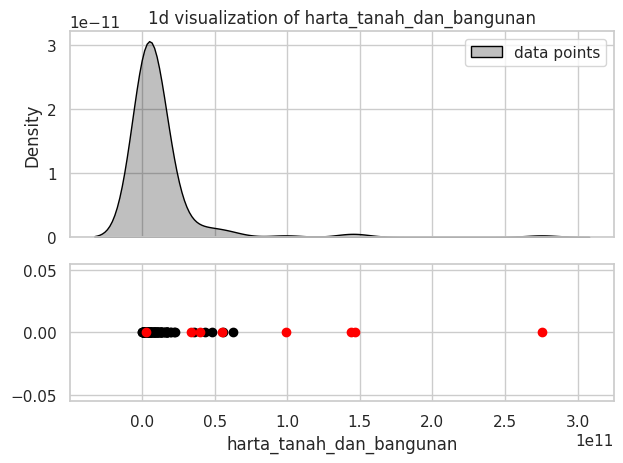

harta_alat_transportasi_dan_mesin


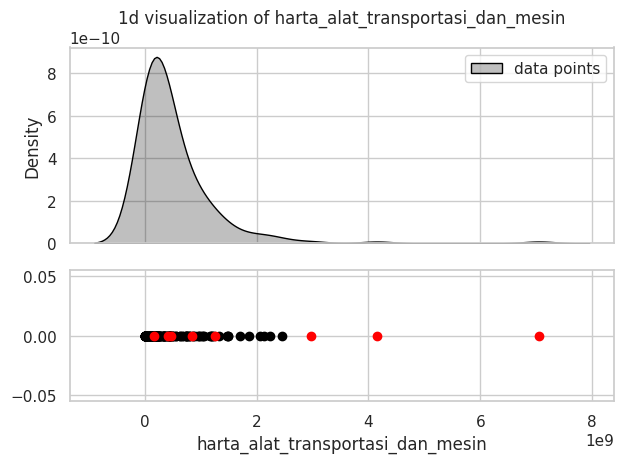

harta_bergerak_lainnya


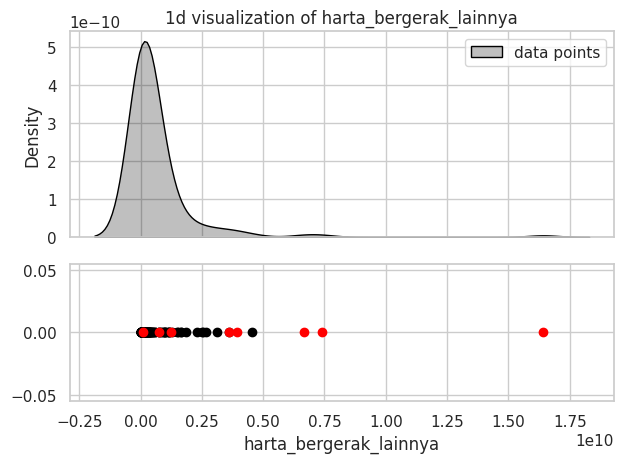

surat_berharga


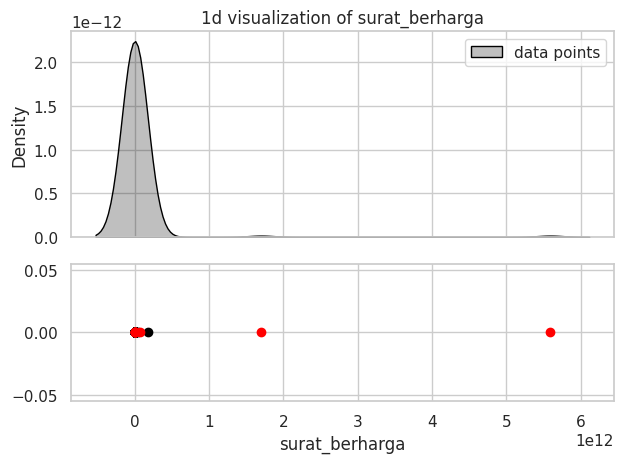

harta_kas_dan_setara_kas


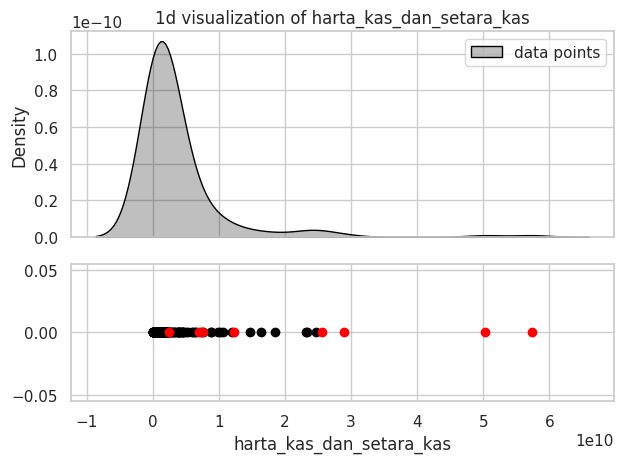

harta_lainnya


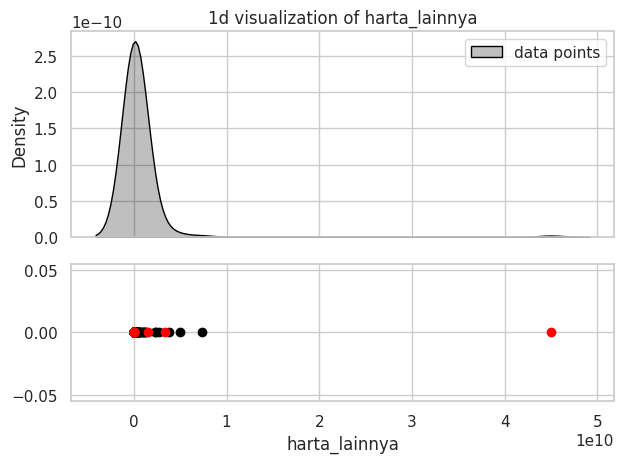

sub_total


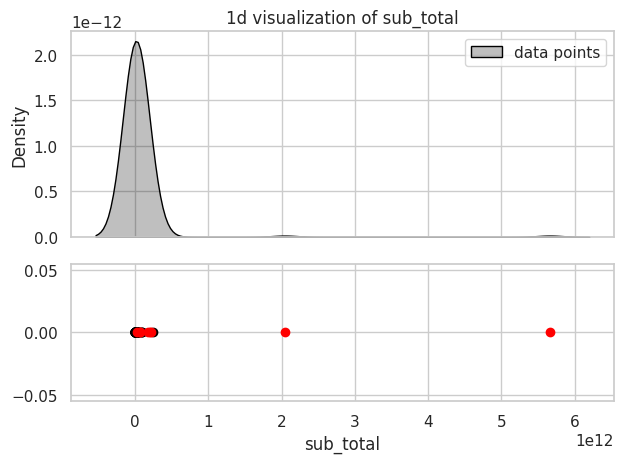

hutang


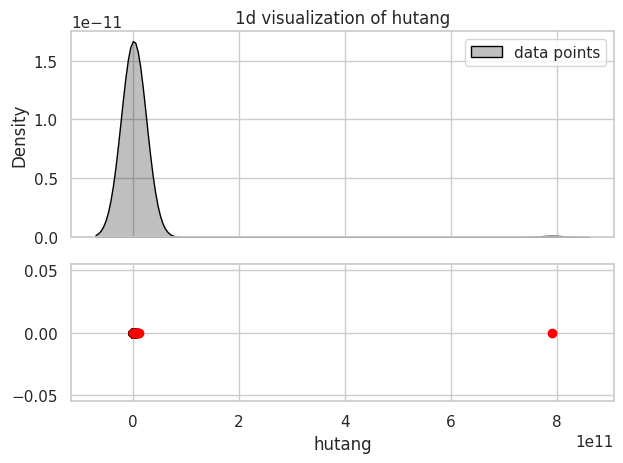

total_harta_kekayaan


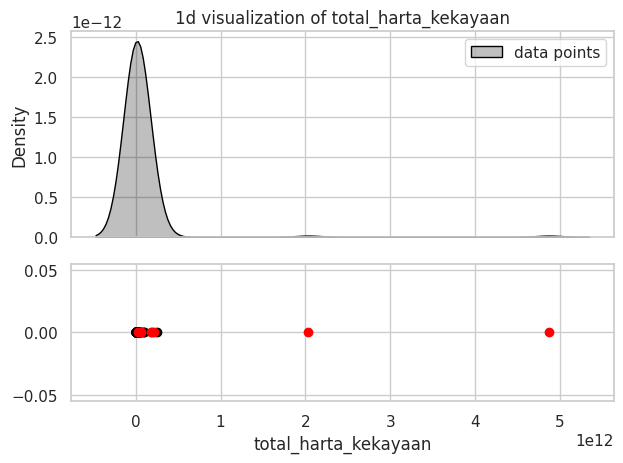

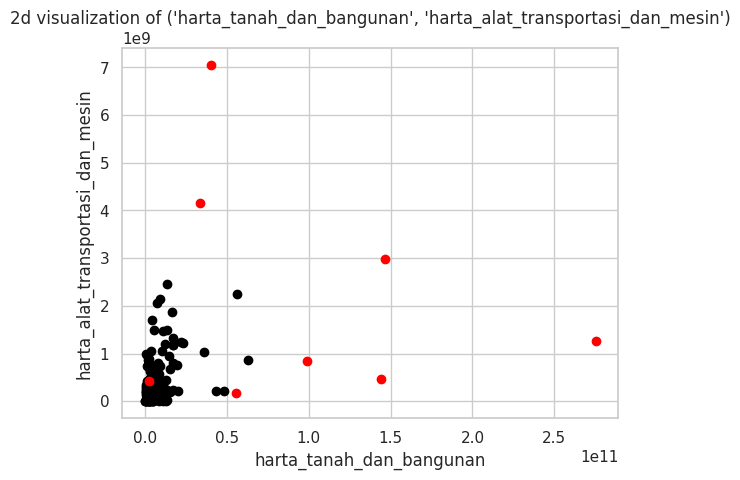

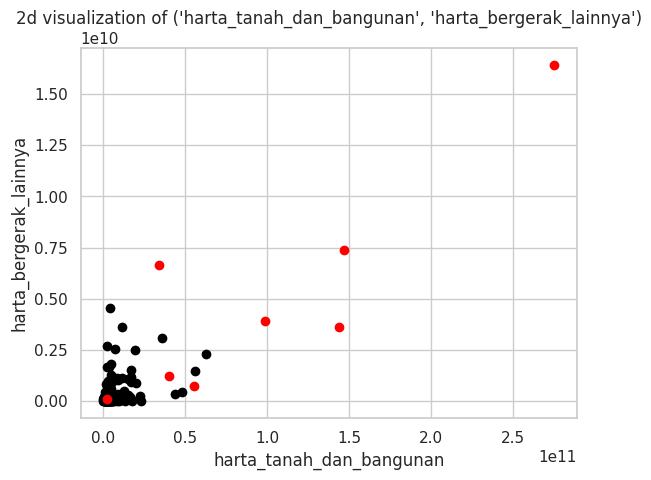

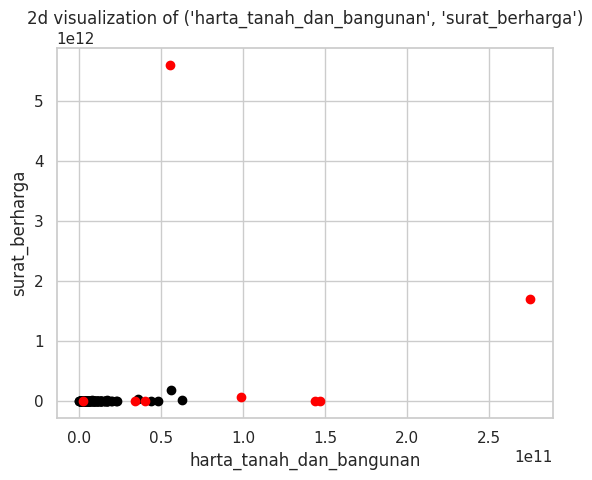

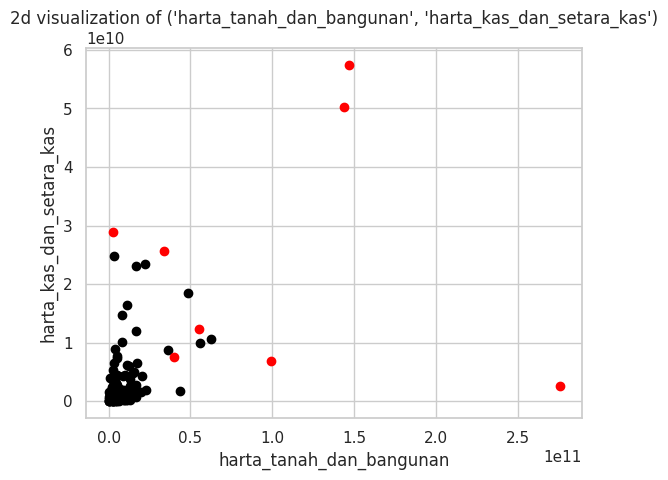

...

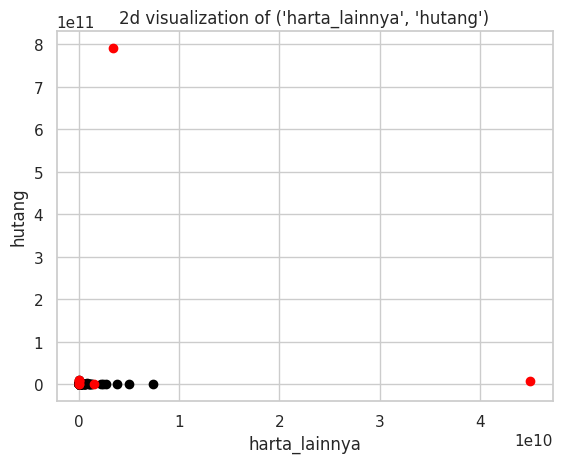

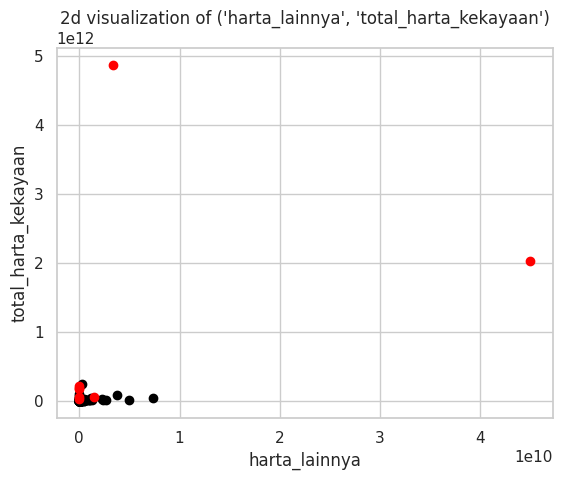

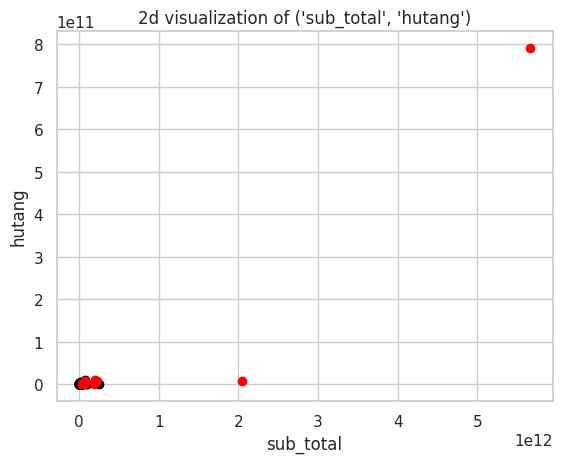

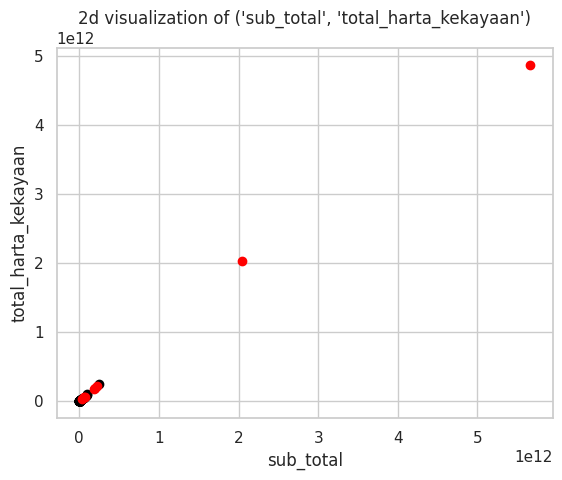

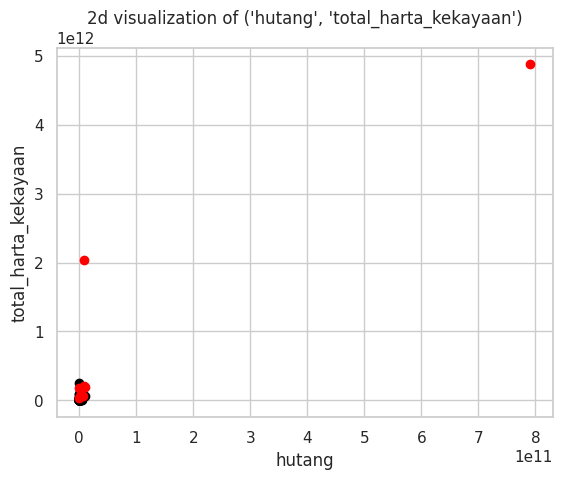

In [141]:
for i in clean_df_col_list:
  print(i)
  visualize_data_1d(real_VAE[1], feature=i, outlier_column= 'y_pred', no_legend=True, title = f"1d visualization of {i}")
for i in pairing_2d:
  visualize_data_2d(real_VAE[1], feature=i, outlier_column= 'y_pred', interactive = False, no_legend = True, hover = 'nama',  title = f"2d visualization of {i}")

#### Real Evaluation

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,harta_alat_transportasi_dan_mesin,harta_bergerak_lainnya,surat_berharga,harta_kas_dan_setara_kas,harta_lainnya,sub_total,hutang,total_harta_kekayaan,aggregated_y_pred
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,238000000,1000500000,300000000,5309000000,200000000,9631220000,0,9631220000,1
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,890000000,300000000,0,645000000,0,4559120000,0,4559120000,1
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,0,260000000,0,14725723072,0,23283464072,0,23283464072,1
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,473500000,3612000000,5213125000,50212419646,0,203513890532,10352000000,193161890532,8
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,1175000000,1525000000,100000000,2730000000,0,22530000000,870000000,21660000000,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,0,260000000,765000000,152736175,0,12177736175,1926577662,10251158513,1
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,1703500000,0,0,461773291,0,6415273291,3664800952,2750472339,1
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,2140000000,220754500,0,1851590750,0,13532845250,1000000000,12532845250,1
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,626000000,15000000,300000000,568180256,0,4509180256,0,4509180256,1


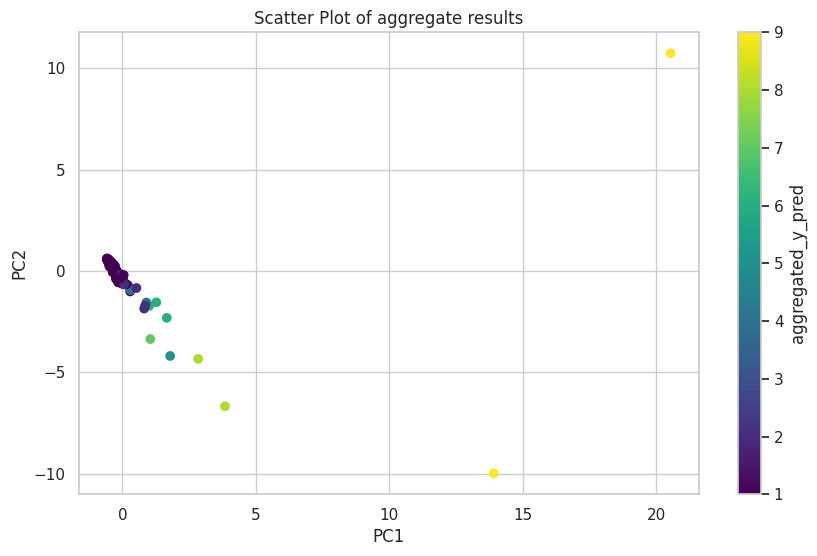

In [143]:
real_dfs = [real_zscore[1], real_iqr_distance[1], real_mad[1],
              real_Iforest[1], real_LOF[1], real_KNN[1],
              real_PCA[1], real_DBSCAN[1], real_HDBSCAN[1],
              real_VAE[1]]

aggregate_y_preds = aggregate_y_pred(real_dfs)

combined_df = pd.concat([df_real, aggregate_y_preds], axis=1)

display(combined_df)

scatter_plot_with_color(df_real_pca, 'PC1', 'PC2', aggregate_y_preds, 'aggregated_y_pred', title="Scatter Plot of aggregate results")

In [164]:
def merge_y_pred_columns(dataframes, model_names):
    """
    Merge the 'y_pred' columns from multiple dataframes into a single dataframe.

    Parameters:
    - dataframes: A list of dataframes, each containing a 'y_pred' column.
    - model_names: A list of model names corresponding to the dataframes.

    Returns:
    - A new dataframe containing 'y_pred' columns for each model.
    """
    # Create an empty dataframe to store merged 'y_pred' columns
    merged_df = pd.DataFrame()

    # Iterate through the dataframes and model names
    for df, model_name in zip(dataframes, model_names):
        # Rename the 'y_pred' column to 'y_pred_{model_name}'
        mdf = df.rename(columns={'y_pred': f'y_pred_{model_name}'})

        # Merge the 'y_pred' column into the merged dataframe
        if merged_df.empty:
            merged_df = mdf[[f'y_pred_{model_name}']]
        else:
            merged_df = pd.concat([merged_df, mdf[[f'y_pred_{model_name}']]], axis=1)

    return merged_df


real_dfs = [real_zscore[1], real_iqr_distance[1], real_mad[1],
              real_Iforest[1], real_LOF[1], real_KNN[1],
              real_PCA[1], real_DBSCAN[1], real_HDBSCAN[1],
              real_VAE[1]]
od_model_names = ["Z_Score", "IQR Distance", "MAD",
                  'Iforest', 'LOF', 'KNN',
                  'PCA', 'DBSCAN', 'HDBSCAN',
                  'VAE']

merged_y_pred_df_real = merge_y_pred_columns(real_dfs, od_model_names)
merged_y_pred_df_real

,y_pred_Z_Score,y_pred_IQR Distance,y_pred_MAD,y_pred_Iforest,y_pred_LOF,y_pred_KNN,y_pred_PCA,y_pred_DBSCAN,y_pred_HDBSCAN,y_pred_VAE
0,0,0,0,0,0,0,0,0,1,0
1,0,0,0,0,0,0,0,0,1,0
2,0,0,0,0,0,0,0,0,1,0
3,1,1,0,1,1,1,1,0,1,1
4,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...
145,0,0,0,0,0,0,0,0,1,0
146,0,0,0,0,0,0,0,0,1,0
147,0,0,0,0,0,0,0,0,1,0
148,0,0,0,0,0,0,0,0,1,0


In [169]:
# Example usage:
# Assuming 'data' is your numpy array
kappa_value = fleiss_kappa(merged_y_pred_df_real.values)
print("Fleiss' Kappa:", kappa_value)

AssertionError: ignored

In [170]:
from statsmodels.stats.inter_rater import fleiss_kappa

fleiss_table = []
for instance_predictions in merged_y_pred_df_real:
    count_non_outliers = np.count_nonzero(instance_predictions == 0)
    count_outliers = np.count_nonzero(instance_predictions == 1)
    fleiss_table.append([count_non_outliers, count_outliers])

# Calculate Fleiss' Kappa
fleiss_kappa_score = fleiss_kappa(fleiss_table)
fleiss_kappa_score

nan

In [171]:
combined_df_agg = pd.concat([df_real, merged_y_pred_df_real], axis=1)
combined_df_agg

,tanggal_penyampaian,jenis_laporan,tahun_laporan,bidang,lembaga,unit_kerja,nama,jabatan,nhk,harta_tanah_dan_bangunan,...,y_pred_Z_Score,y_pred_IQR Distance,y_pred_MAD,y_pred_Iforest,y_pred_LOF,y_pred_KNN,y_pred_PCA,y_pred_DBSCAN,y_pred_HDBSCAN,y_pred_VAE
0,16 Februari 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN LUAR NEGERI,DIREKTORAT JENDERAL PROTOKOL DAN KONSULER,ANDY RACHMIANTO,DIREKTUR JENDERAL PROTOKOL DAN KONSULER,210766,2583720000,...,0,0,0,0,0,0,0,0,1,0
1,30 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN HUKUM DAN HAK ASASI MANUSIA,DIREKTORAT JENDERAL PEMASYARAKATAN,REYNHARD SAUD POLTAK SILITONGA,DIREKTUR JENDERAL,754831,2724120000,...,0,0,0,0,0,0,0,0,1,0
2,15 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN DALAM NEGERI,PIMPINAN TERTINGGI,M. TITO KARNAVIAN,MENTERI DALAM NEGERI,191175,8297741000,...,0,0,0,0,0,0,0,0,1,0
3,29 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,PIMPINAN TERTINGGI,JOHNNY GERARD PLATE,MENTERI KOMUNIKASI DAN INFORMATIKA,211793,144002845886,...,1,1,0,1,1,1,1,0,1,1
4,14 September 2022,Khusus - Awal Menjabat,2022,EKSEKUTIF,KEMENTERIAN KETENAGAKERJAAN,WAKIL PIMPINAN,AFRIANSYAH NOOR,WAKIL MENTERI,870330,17000000000,...,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145,15 Maret 2023,Periodik,2022,EKSEKUTIF,"KEMENTERIAN PENDIDIKAN, KEBUDAYAAN, RISET, DAN...",SEKRETARIAT JENDERAL,MUHAMAD HEIKAL,STAF KHUSUS BIDANG KOMUNIKASI DAN MEDIA,800828,11000000000,...,0,0,0,0,0,0,0,0,1,0
146,13 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN PERTANIAN,DIREKTORAT JENDERAL PETERNAKAN DAN KESEHATAN H...,NASRULLAH,DIREKTUR JENDERAL,272857,4250000000,...,0,0,0,0,0,0,0,0,1,0
147,31 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN AGAMA,PIMPINAN TERTINGGI,YAQUT CHOLIL QOUMAS,MENTERI,36278,9320500000,...,0,0,0,0,0,0,0,0,1,0
148,20 Maret 2023,Periodik,2022,EKSEKUTIF,KEMENTERIAN KOMUNIKASI DAN INFORMATIKA,BADAN PENELITIAN DAN PENGEMBANGAN SUMBER DAYA ...,HARY BUDIARTO,KEPALA BADAN,163340,3000000000,...,0,0,0,0,0,0,0,0,1,0
